<a href="https://colab.research.google.com/github/RachelRamirez/CIFAR-10/blob/main/CombiningGroups_CIFAR10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Last changed 11/11 13:09
Reminder to self, please save over AllRuns.ipynb in github/rr/cifar10/collectionoftests

Description:  batches are mixing well, but horrible accuracy for certain images, maybe thats a "good" test result?  About to pass all the groups through the augmentation, maybe 1 hour * 10 groups?  

Still need to do the CSV output

### Imports

In [2]:
 # I don't want to accidentally restart my notebook so I have a break here. 
# I'm only working from the last part of the notebook where I import the results


#@title import libraries set time
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import copy
import os
import PIL
import PIL.Image
from tensorflow import keras 
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
# import keras.utils -- dont do this!! it causes problems, 
from tensorflow.keras.utils import to_categorical  #do this instead!!
import random
import sklearn
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import time
import pickle
from google.colab import files
import datetime # to display the current time hh:mm:ss



tic = time.time()  # Start the timer
initial_run = 0

AUTOTUNE = tf.data.experimental.AUTOTUNE
np.set_printoptions(precision=4)

#### Set Random Seeds

In [3]:
#@title
seed = 42
random.seed(seed)
tf.random.set_seed(seed)
np.random.seed()  # https://stackoverflow.com/questions/11526975/set-random-seed-programwide-in-python
shuffle_seed = seed

# Possibly Need IMGAUG to set seed in ALbumentations
# GitHub Issue: https://github.com/albumentations-team/albumentations/issues/93
import imgaug
imgaug.seed(123)


## ------------------

Set Logic-Values


In [4]:
run_model = False  #When Im looking at augmentations, I don't want to keep refitting a model, I want to just get the database of images loaded

Make Image Datasets

One of my biggest learning curves was learning how to load  the dataset with tdfs.load() and then filter on images by label.  

The second biggest was using the created model to make predictions on the test set.   

Current but "skipped" problem is trying to view misclassifeid images of results.


Another area of problems is rerunning when you've already specified a batch on your dataset creates another "batch" split so it can cause problems to rerun a cell that says how to define a dataset.  Unbatch may be needed first.    

# **1. Create All DataSets**

### Load Dataset

In [5]:
#@title


# A weird problem happened where it said the toronto website cant be reached, if that ever happens again make sure to go to SO for this advice https://stackoverflow.com/questions/36805640/this-error-while-downloading-datasets-valueerror-i-o-operation-on-closed-file

# How do I set IDs on: read_config.add_tfds_id = True
read_config = tfds.ReadConfig(shuffle_seed=seed) 
read_config.add_tfds_id = True  ## This didnt update ReadConfig 

dataset, info = tfds.load('cifar10', as_supervised=True, with_info=True, read_config=read_config)
x_test =  dataset["test"]
dataset  = dataset["train"]
assert isinstance(x_test, tf.data.Dataset)
#x_test = [(example.numpy(), label.numpy()) for example, label in x_test]
# once broken into numpy arrays, my model still doesn't handle it, it seems to be expecting a tensor
# So i think i have to break it into two tensors?  test_x, test_y?
# x_test[0][0]
# x_test[0][1]
# x_test = pd.DataFrame(x_test, columns=['example', 'label'])
# x_test = tf.data.Dataset.from_generator(lambda: x_test, (tf.int64, tf.int16))
# x_list = list(x_test.as_numpy_iterator())  # Crashes Google Colab!
# print(x_list[:5])


#  I got this from stack-overflow.  Need this code to define y_test, the labels of testset

def get_labels_from_tfdataset(tfdataset, batched=False):
    labels = list(map(lambda x: x[1], tfdataset)) # Get labels 
    if not batched:
        return tf.concat(labels, axis=0) # concat the list of batched labels
    return labels
y_test = get_labels_from_tfdataset(x_test)

# tfds.as_dataframe(dataset.take(5), info)  #does not display image ID :-( )

dataset_airplanes   = dataset.filter(lambda img, label: label == 0)
dataset_automobiles = dataset.filter(lambda img, label: label == 1)
dataset_birds       = dataset.filter(lambda img, label: label == 2)
dataset_cats        = dataset.filter(lambda img, label: label == 3)
dataset_deers       = dataset.filter(lambda img, label: label == 4)
dataset_dogs        = dataset.filter(lambda img, label: label == 5)
dataset_frogs       = dataset.filter(lambda img, label: label == 6)
dataset_horses      = dataset.filter(lambda img, label: label == 7)
dataset_ships       = dataset.filter(lambda img, label: label == 8)
dataset_trucks      = dataset.filter(lambda img, label: label == 9)

##  Ways to count the number of images in the sets:
print("There are ways to count and verify the number per training set which i have hidden because they are costly")
print("Entire Training Dataset was originally cardinality:", tf.data.experimental.cardinality(dataset).numpy()) #   prints 50,000, correct
print("Entire Airplane Training Dataset was originally cardinality:", tf.data.experimental.cardinality(dataset_airplanes).numpy()) #   prints -2 this is a "feature" in tf when a set takes too long to count
# print(dataset_airplanes.reduce(np.int64(0), lambda x,_ : x + 1).numpy()) #prints 5000, correct

##  This is a way of asserting that all the images have the same label in a set
# for img, label in dataset_dogs:
#   assert label == 5
 

There are ways to count and verify the number per training set which i have hidden because they are costly
Entire Training Dataset was originally cardinality: 50000
Entire Airplane Training Dataset was originally cardinality: -2


### Show Examples in the Three Train/Val/Test Sets.  Count CIFAR 10 Functions

In [6]:
#@title 'count_cifar10_class' { form-width: "1px" }
# define a fuction to count the numbre of each class
# I'm not going to worry about it now, but if i had time to cleanup code I would 
# Try to use this type of if/zip structure  https://stackoverflow.com/questions/57784643/if-statement-and-zip



 
def count_cifar10_class(datasetpassed):
  # takes the datasetpassed and returns the number of each category as a ten-tupple
  num_airplanes, num_automobiles, num_birds, num_cats, num_deers = 0,0,0,0,0
  num_dogs, num_frogs, num_horses, num_ships, num_trucks= 0, 0, 0,0,0


  # print("Unbatched?" , check_if_unbatched(datasetpassed))
  # print("Take?", check_if_take(datasetpassed))
  # print("Unbatched or Take?", ( check_if_unbatched(datasetpassed) or  check_if_take(datasetpassed)))

  if ( check_if_unbatched(datasetpassed) or  check_if_take(datasetpassed)):
    if check_if_take(datasetpassed):
      datasetpassed = make_unbatched(datasetpassed)

    for img, label in datasetpassed:
      if label == 0:
        num_airplanes += 1

      if label == 1:
        num_automobiles += 1

      if label == 2:
        num_birds +=1

      if label == 3:
        num_cats +=1

      if label ==4: 
        num_deers += 1

      if label == 5:
        num_dogs += 1 

      if label == 6:
          num_frogs += 1

      if label == 7:
        num_horses += 1

      if label == 8:
        num_ships +=1 

      if label == 9: 
        num_trucks +=1
    
    return num_airplanes, num_automobiles, num_birds, num_cats, num_deers, num_dogs, num_frogs, num_horses, num_ships, num_trucks 
  # else if the dataset is not batched or if one batch from take is being passed, proceed to counting thing below 
  else:
    print(" ** Dataset is batched, please pass 1 batch at a time to cifar10 to see metrics ** ")



  




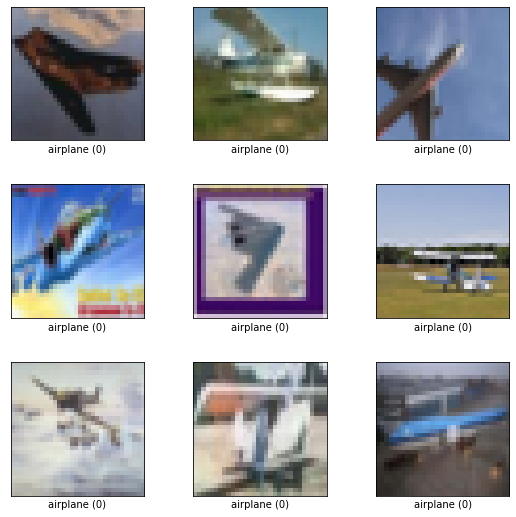

In [7]:
#@title ShowExamplesofDatasetAirplanes
## Tfds.show_examples is a matplotlib funnction that only works on image ds's, and you have to pass it the "info" for some reason
fig = tfds.show_examples(dataset_airplanes, info)

How to display one picture of a dataset using `next(iter(dataset)`

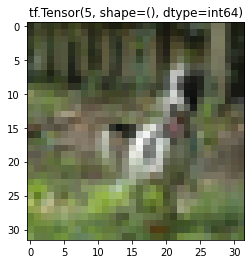

In [8]:
#@title ShowExampleofOneIterations of DatasetDogs { form-width: "20px" }
# I wish I could display ID!!

img, label = next(iter(dataset_dogs))
plt.title(str(label))
plt.imshow(img)

#0x7f6e309eff10?


## Create validation set of 10,000 images

In [9]:
#@title
# I want 10 un replicated samples from dataset_airplanes + dataset_automobiles... dataset_trucks.

# There are 5000 images of each Class 
# I want 10 equal sets A, B, C, D, ... J plus a validation set
# I want 10,000 total images in the validation set with 1000 of each class
# and I want 10 sets of training images  4000 total images, so 400 images in each class

N = 1000
dataset_airplanes_val   = dataset_airplanes.take(N)
dataset_automobiles_val  = dataset_automobiles.take(N)
dataset_birds_val       = dataset_birds.take(N)  
dataset_cats_val        = dataset_cats.take(N)
dataset_deers_val       = dataset_deers.take(N)
dataset_dogs_val        = dataset_dogs.take(N)
dataset_frogs_val       = dataset_frogs.take(N)
dataset_horses_val      = dataset_horses.take(N)
dataset_ships_val       = dataset_ships.take(N)
dataset_trucks_val      = dataset_trucks.take(N)


# Make sure to skip the next 1000 images in each data set before making training set
dataset_airplanes   = dataset_airplanes.skip(N)
dataset_automobiles  = dataset_automobiles.skip(N)
dataset_birds      = dataset_birds.skip(N)  
dataset_cats        = dataset_cats.skip(N)
dataset_deers       = dataset_deers.skip(N)
dataset_dogs        = dataset_dogs.skip(N)
dataset_frogs       = dataset_frogs.skip(N)
dataset_horses      = dataset_horses.skip(N)
dataset_ships       = dataset_ships.skip(N)
dataset_trucks      = dataset_trucks.skip(N)

# # Check that remaining dataset does not have validation data
# fig = tfds.show_examples(dataset_ships, info)
# fig = tfds.show_examples(dataset_ships_val, info)
# # I checked and they dont.


# NOW, How do I combine my val sets?

# Hint1 its not this... 
# val = dataset_airplanes_val + dataset_automobile_val + dataset_birds_val

# #  Hint2 its also not this implementation of zip because the info file doesn't match it
# val = tf.data.Dataset.zip((dataset_airplanes_val,
#                     dataset_automobile_val,
#                     dataset_birds_val,
#                     dataset_cats_val,
#                     dataset_deers_val,
#                     dataset_dogs_val,
#                     dataset_frogs_val,
#                     dataset_horses_val,
#                     dataset_ships_val,
#                     dataset_trucks_val ))
 
# fig = tfds.show_examples(val, info)   # Returns a warning that the info file is not compatible


# is it concatenate? YESSSSSSSSSSSSSSSSSSSSSS
val = dataset_airplanes_val.concatenate(dataset_automobiles_val)
# This is how I checked that it worked
# fig = tfds.show_examples(val.skip(999), info)    # shows 1 airplane and then 8 automobiles

val = val.concatenate(dataset_birds_val)
val = val.concatenate(dataset_cats_val)
val = val.concatenate(dataset_deers_val)
val = val.concatenate(dataset_dogs_val)
val = val.concatenate(dataset_frogs_val)
val = val.concatenate(dataset_horses_val)
val = val.concatenate(dataset_ships_val)
val = val.concatenate(dataset_trucks_val)
  
# print(val.reduce(np.int32(0), lambda x,_ : x + 1))  # this shows 10000! Thank goodness! :-)



## Create smaller training groups of each CIFAR Class sets (set Shard)

After removing the 10,000 validation set from the training-data, the remaining set has 40,000 images, 4000 images of each class.  To create smaller training-datasets of similar sizes, shard the dataset into equal pieces.

For the initial days of testing I decided on **250 images** per class for my first couple runs, which equates to 16 shards (40,000/16 = 250) .  When I wanted to study what was going on more beneath the hood for my augmentations, I decided to make the training set even more tiny so I could view all the images per training set I decided to try 1 image per class so I could easily view all the images augmeted and not augmented.  This meant I needed **4000 shards!** for troubleshooting.



In [10]:
SHARDS=16

 Airplanes (airplanes_A, ... airplanes_P)

In [11]:
#@title
# https://www.tensorflow.org/api_docs/python/tf/data/Dataset#shard

# Check that each of the remaining 10 datasets has only 4000 images 
# print(dataset_airplanes.reduce(np.int32(0), lambda x,_ : x + 1))  # 4000 check!

# Shard each of the remaining 10 datasets into 16 smaller groups
airplanes_A = dataset_airplanes.shard(num_shards=SHARDS, index = 0)
airplanes_B = dataset_airplanes.shard(num_shards=SHARDS, index = 1)
airplanes_C = dataset_airplanes.shard(num_shards=SHARDS, index = 2)
airplanes_D = dataset_airplanes.shard(num_shards=SHARDS, index = 3)
airplanes_E = dataset_airplanes.shard(num_shards=SHARDS, index = 4)
airplanes_F = dataset_airplanes.shard(num_shards=SHARDS, index = 5)
airplanes_G = dataset_airplanes.shard(num_shards=SHARDS, index = 6)
airplanes_H = dataset_airplanes.shard(num_shards=SHARDS, index = 7)
airplanes_I = dataset_airplanes.shard(num_shards=SHARDS, index = 8)
airplanes_J = dataset_airplanes.shard(num_shards=SHARDS, index = 9)
airplanes_K = dataset_airplanes.shard(num_shards=SHARDS, index = 10)
airplanes_L = dataset_airplanes.shard(num_shards=SHARDS, index = 11)
airplanes_M = dataset_airplanes.shard(num_shards=SHARDS, index = 12)
airplanes_N = dataset_airplanes.shard(num_shards=SHARDS, index = 13)
airplanes_O = dataset_airplanes.shard(num_shards=SHARDS, index = 14)
airplanes_P = dataset_airplanes.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(airplanes_M.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


 Automobiles

In [12]:
#@title
# dataset_automobile

# Check that each of the remaining 10 datasets has only 4000 images 
# print(dataset_automobile.reduce(np.int32(0), lambda x,_ : x + 1))  # 4000 check!

# Shard each of the remaining 10 datasets into 16 smaller groups
automobiles_A = dataset_automobiles.shard(num_shards=SHARDS, index = 0)
automobiles_B = dataset_automobiles.shard(num_shards=SHARDS, index = 1)
automobiles_C = dataset_automobiles.shard(num_shards=SHARDS, index = 2)
automobiles_D = dataset_automobiles.shard(num_shards=SHARDS, index = 3)
automobiles_E = dataset_automobiles.shard(num_shards=SHARDS, index = 4)
automobiles_F = dataset_automobiles.shard(num_shards=SHARDS, index = 5)
automobiles_G = dataset_automobiles.shard(num_shards=SHARDS, index = 6)
automobiles_H = dataset_automobiles.shard(num_shards=SHARDS, index = 7)
automobiles_I = dataset_automobiles.shard(num_shards=SHARDS, index = 8)
automobiles_J = dataset_automobiles.shard(num_shards=SHARDS, index = 9)
automobiles_K = dataset_automobiles.shard(num_shards=SHARDS, index = 10)
automobiles_L = dataset_automobiles.shard(num_shards=SHARDS, index = 11)
automobiles_M = dataset_automobiles.shard(num_shards=SHARDS, index = 12)
automobiles_N = dataset_automobiles.shard(num_shards=SHARDS, index = 13)
automobiles_O = dataset_automobiles.shard(num_shards=SHARDS, index = 14)
automobiles_P = dataset_automobiles.shard(num_shards=SHARDS, index = 15)


#check that a random airplane dataset only has 250 images
# print(airplanes_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Birds

In [13]:
#@title
# dataset_birds

# Shard each of the remaining 10 datasets into 16 smaller groups
birds_A = dataset_birds.shard(num_shards=SHARDS, index = 0)
birds_B = dataset_birds.shard(num_shards=SHARDS, index = 1)
birds_C = dataset_birds.shard(num_shards=SHARDS, index = 2)
birds_D = dataset_birds.shard(num_shards=SHARDS, index = 3)
birds_E = dataset_birds.shard(num_shards=SHARDS, index = 4)
birds_F = dataset_birds.shard(num_shards=SHARDS, index = 5)
birds_G = dataset_birds.shard(num_shards=SHARDS, index = 6)
birds_H = dataset_birds.shard(num_shards=SHARDS, index = 7)
birds_I = dataset_birds.shard(num_shards=SHARDS, index = 8)
birds_J = dataset_birds.shard(num_shards=SHARDS, index = 9)
birds_K = dataset_birds.shard(num_shards=SHARDS, index = 10)
birds_L = dataset_birds.shard(num_shards=SHARDS, index = 11)
birds_M = dataset_birds.shard(num_shards=SHARDS, index = 12)
birds_N = dataset_birds.shard(num_shards=SHARDS, index = 13)
birds_O = dataset_birds.shard(num_shards=SHARDS, index = 14)
birds_P = dataset_birds.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(airplanes_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Cats

In [14]:
#@title
# dataset_cats

# Shard each of the remaining 10 datasets into 16 smaller groups
cats_A = dataset_cats.shard(num_shards=SHARDS, index = 0)
cats_B = dataset_cats.shard(num_shards=SHARDS, index = 1)
cats_C = dataset_cats.shard(num_shards=SHARDS, index = 2)
cats_D = dataset_cats.shard(num_shards=SHARDS, index = 3)
cats_E = dataset_cats.shard(num_shards=SHARDS, index = 4)
cats_F = dataset_cats.shard(num_shards=SHARDS, index = 5)
cats_G = dataset_cats.shard(num_shards=SHARDS, index = 6)
cats_H = dataset_cats.shard(num_shards=SHARDS, index = 7)
cats_I = dataset_cats.shard(num_shards=SHARDS, index = 8)
cats_J = dataset_cats.shard(num_shards=SHARDS, index = 9)
cats_K = dataset_cats.shard(num_shards=SHARDS, index = 10)
cats_L = dataset_cats.shard(num_shards=SHARDS, index = 11)
cats_M = dataset_cats.shard(num_shards=SHARDS, index = 12)
cats_N = dataset_cats.shard(num_shards=SHARDS, index = 13)
cats_O = dataset_cats.shard(num_shards=SHARDS, index = 14)
cats_P = dataset_cats.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(cats_P.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Deer(s)

In [15]:
#@title
# dataset_deers
# Shard each of the remaining 10 datasets into 16 smaller groups
deers_A = dataset_deers.shard(num_shards=SHARDS, index = 0)
deers_B = dataset_deers.shard(num_shards=SHARDS, index = 1)
deers_C = dataset_deers.shard(num_shards=SHARDS, index = 2)
deers_D = dataset_deers.shard(num_shards=SHARDS, index = 3)
deers_E = dataset_deers.shard(num_shards=SHARDS, index = 4)
deers_F = dataset_deers.shard(num_shards=SHARDS, index = 5)
deers_G = dataset_deers.shard(num_shards=SHARDS, index = 6)
deers_H = dataset_deers.shard(num_shards=SHARDS, index = 7)
deers_I = dataset_deers.shard(num_shards=SHARDS, index = 8)
deers_J = dataset_deers.shard(num_shards=SHARDS, index = 9)
deers_K = dataset_deers.shard(num_shards=SHARDS, index = 10)
deers_L = dataset_deers.shard(num_shards=SHARDS, index = 11)
deers_M = dataset_deers.shard(num_shards=SHARDS, index = 12)
deers_N = dataset_deers.shard(num_shards=SHARDS, index = 13)
deers_O = dataset_deers.shard(num_shards=SHARDS, index = 14)
deers_P = dataset_deers.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(deers_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Dogs

In [16]:
#@title
# dataset_dogs
# Shard each of the remaining 10 datasets into 16 smaller groups
dogs_A = dataset_dogs.shard(num_shards=SHARDS, index = 0)
dogs_B = dataset_dogs.shard(num_shards=SHARDS, index = 1)
dogs_C = dataset_dogs.shard(num_shards=SHARDS, index = 2)
dogs_D = dataset_dogs.shard(num_shards=SHARDS, index = 3)
dogs_E = dataset_dogs.shard(num_shards=SHARDS, index = 4)
dogs_F = dataset_dogs.shard(num_shards=SHARDS, index = 5)
dogs_G = dataset_dogs.shard(num_shards=SHARDS, index = 6)
dogs_H = dataset_dogs.shard(num_shards=SHARDS, index = 7)
dogs_I = dataset_dogs.shard(num_shards=SHARDS, index = 8)
dogs_J = dataset_dogs.shard(num_shards=SHARDS, index = 9)
dogs_K = dataset_dogs.shard(num_shards=SHARDS, index = 10)
dogs_L = dataset_dogs.shard(num_shards=SHARDS, index = 11)
dogs_M = dataset_dogs.shard(num_shards=SHARDS, index = 12)
dogs_N = dataset_dogs.shard(num_shards=SHARDS, index = 13)
dogs_O = dataset_dogs.shard(num_shards=SHARDS, index = 14)
dogs_P = dataset_dogs.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(dogs_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


 Frogs

In [17]:
#@title
# dataset_frogs
# Shard each of the remaining 10 datasets into 16 smaller groups
frogs_A = dataset_frogs.shard(num_shards=SHARDS, index = 0)
frogs_B = dataset_frogs.shard(num_shards=SHARDS, index = 1)
frogs_C = dataset_frogs.shard(num_shards=SHARDS, index = 2)
frogs_D = dataset_frogs.shard(num_shards=SHARDS, index = 3)
frogs_E = dataset_frogs.shard(num_shards=SHARDS, index = 4)
frogs_F = dataset_frogs.shard(num_shards=SHARDS, index = 5)
frogs_G = dataset_frogs.shard(num_shards=SHARDS, index = 6)
frogs_H = dataset_frogs.shard(num_shards=SHARDS, index = 7)
frogs_I = dataset_frogs.shard(num_shards=SHARDS, index = 8)
frogs_J = dataset_frogs.shard(num_shards=SHARDS, index = 9)
frogs_K = dataset_frogs.shard(num_shards=SHARDS, index = 10)
frogs_L = dataset_frogs.shard(num_shards=SHARDS, index = 11)
frogs_M = dataset_frogs.shard(num_shards=SHARDS, index = 12)
frogs_N = dataset_frogs.shard(num_shards=SHARDS, index = 13)
frogs_O = dataset_frogs.shard(num_shards=SHARDS, index = 14)
frogs_P = dataset_frogs.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(frogs_A.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Horses

In [18]:
#@title
# dataset_horses
# Shard each of the remaining 10 datasets into 16 smaller groups
horses_A = dataset_horses.shard(num_shards=SHARDS, index = 0)
horses_B = dataset_horses.shard(num_shards=SHARDS, index = 1)
horses_C = dataset_horses.shard(num_shards=SHARDS, index = 2)
horses_D = dataset_horses.shard(num_shards=SHARDS, index = 3)
horses_E = dataset_horses.shard(num_shards=SHARDS, index = 4)
horses_F = dataset_horses.shard(num_shards=SHARDS, index = 5)
horses_G = dataset_horses.shard(num_shards=SHARDS, index = 6)
horses_H = dataset_horses.shard(num_shards=SHARDS, index = 7)
horses_I = dataset_horses.shard(num_shards=SHARDS, index = 8)
horses_J = dataset_horses.shard(num_shards=SHARDS, index = 9)
horses_K = dataset_horses.shard(num_shards=SHARDS, index = 10)
horses_L = dataset_horses.shard(num_shards=SHARDS, index = 11)
horses_M = dataset_horses.shard(num_shards=SHARDS, index = 12)
horses_N = dataset_horses.shard(num_shards=SHARDS, index = 13)
horses_O = dataset_horses.shard(num_shards=SHARDS, index = 14)
horses_P = dataset_horses.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(horses_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Ships

In [19]:
#@title
# dataset_ships
# Shard each of the remaining 10 datasets into 16 smaller groups
ships_A = dataset_ships.shard(num_shards=SHARDS, index = 0)
ships_B = dataset_ships.shard(num_shards=SHARDS, index = 1)
ships_C = dataset_ships.shard(num_shards=SHARDS, index = 2)
ships_D = dataset_ships.shard(num_shards=SHARDS, index = 3)
ships_E = dataset_ships.shard(num_shards=SHARDS, index = 4)
ships_F = dataset_ships.shard(num_shards=SHARDS, index = 5)
ships_G = dataset_ships.shard(num_shards=SHARDS, index = 6)
ships_H = dataset_ships.shard(num_shards=SHARDS, index = 7)
ships_I = dataset_ships.shard(num_shards=SHARDS, index = 8)
ships_J = dataset_ships.shard(num_shards=SHARDS, index = 9)
ships_K = dataset_ships.shard(num_shards=SHARDS, index = 10)
ships_L = dataset_ships.shard(num_shards=SHARDS, index = 11)
ships_M = dataset_ships.shard(num_shards=SHARDS, index = 12)
ships_N = dataset_ships.shard(num_shards=SHARDS, index = 13)
ships_O = dataset_ships.shard(num_shards=SHARDS, index = 14)
ships_P = dataset_ships.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(ships_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Trucks


In [20]:
#@title
# dataset_trucks
# Shard each of the remaining 10 datasets into 16 smaller groups
trucks_A = dataset_trucks.shard(num_shards=SHARDS, index = 0)
trucks_B = dataset_trucks.shard(num_shards=SHARDS, index = 1)
trucks_C = dataset_trucks.shard(num_shards=SHARDS, index = 2)
trucks_D = dataset_trucks.shard(num_shards=SHARDS, index = 3)
trucks_E = dataset_trucks.shard(num_shards=SHARDS, index = 4)
trucks_F = dataset_trucks.shard(num_shards=SHARDS, index = 5)
trucks_G = dataset_trucks.shard(num_shards=SHARDS, index = 6)
trucks_H = dataset_trucks.shard(num_shards=SHARDS, index = 7)
trucks_I = dataset_trucks.shard(num_shards=SHARDS, index = 8)
trucks_J = dataset_trucks.shard(num_shards=SHARDS, index = 9)
trucks_K = dataset_trucks.shard(num_shards=SHARDS, index = 10)
trucks_L = dataset_trucks.shard(num_shards=SHARDS, index = 11)
trucks_M = dataset_trucks.shard(num_shards=SHARDS, index = 12)
trucks_N = dataset_trucks.shard(num_shards=SHARDS, index = 13)
trucks_O = dataset_trucks.shard(num_shards=SHARDS, index = 14)
trucks_P = dataset_trucks.shard(num_shards=SHARDS, index = 15)


#check that a random airplane dataset only has 250 images
# print(trucks_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


### New Groups: A (trainA)
I discovered a better way to zip, batch, my training sets.


#### Admin functions

In [21]:
#@title
# #@title admin fxs to print out code  / future users wont need to rerun
# # here i create text that i can copy and paste into code-cells
# from itertools import cycle
# #https://stackoverflow.com/questions/19686533/how-to-zip-two-differently-sized-lists

# letter="A"
# def printoutlistofsubsets(letter):
#   listofobjects  = ("airplanes_", "automobiles_", "birds_", "cats_", "deers_", 
#                     "dogs_", "frogs_", "horses_", "ships_", "trucks_")
#   print("train", letter, "_subsets = ("   ,sep="" , end = "")
#   counter=0
#   for i in listofobjects:
#     counter+=1
#     if counter<10:
#       print( i,letter, ", " ,sep="", end="")
#     else:
#       print(i,letter , sep="", end=" ")
#   print(")"    )

# for i in list(["A", "B", "C", "D", "E", "F", "G", "H", "I", "J"]):
#   printoutlistofsubsets(i) #I  manually copy/paste the output to run as future code

Define Zip Function

it's defined as zip_9 below need to move it up here

In [22]:
 #@title def zip_9_sets()
def zip_9_sets(tuple_of_9_subsets_to_zip, opttext="9 Sets Zipped and Concatenated"):
  combined = tf.data.Dataset.zip((tuple_of_9_subsets_to_zip)).flat_map(
    lambda x0, x1, x2, x3, x4, x5,x6,x7,x8,x9:
     tf.data.Dataset.from_tensors(x0).concatenate(
        tf.data.Dataset.from_tensors(x1).concatenate(
            tf.data.Dataset.from_tensors(x2).concatenate(
                tf.data.Dataset.from_tensors(x3).concatenate(
                     tf.data.Dataset.from_tensors(x4).concatenate(
                          tf.data.Dataset.from_tensors(x5).concatenate(
                               tf.data.Dataset.from_tensors(x6).concatenate(
                                    tf.data.Dataset.from_tensors(x7).concatenate(
                                         tf.data.Dataset.from_tensors(x8).concatenate(
                                              tf.data.Dataset.from_tensors(x9))
                               )
                          )
                     )
                )
            )
          )
      )
    ))
  print(opttext)
  return combined



Define Zip2 Sets so I can Zip Together Alb+ No_Alb

In [23]:
#@title def zip_2_sets()
def zip_2_sets(tuple_of_2_subsets_to_zip, opttext="Two Sets Zipped and Concatenated"):
  combined = tf.data.Dataset.zip((tuple_of_2_subsets_to_zip)).flat_map(
    lambda x0, x1:
     tf.data.Dataset.from_tensors(x0).concatenate(
        tf.data.Dataset.from_tensors(x1)))
  
  print(opttext)
  return combined

In [24]:
# #@title admin fxs to print out code2  / future users wont need to rerun
# def printoutzip9sets(letter):
#   print("train", letter, " = zip_9_sets(train", letter, "_subsets,", " opttext= \"train", letter, " defined \" )",sep="" )
   
# for i in list(["A", "B", "C", "D", "E", "F", "G", "H", "I", "J"]):
#   printoutzip9sets(i) #I  manually copy/paste the output to run as future code



### Create subset tuples

In [25]:
trainA_subsets = (airplanes_A, automobiles_A, birds_A, cats_A, deers_A, dogs_A, frogs_A, horses_A, ships_A, trucks_A )
trainB_subsets = (airplanes_B, automobiles_B, birds_B, cats_B, deers_B, dogs_B, frogs_B, horses_B, ships_B, trucks_B )
trainC_subsets = (airplanes_C, automobiles_C, birds_C, cats_C, deers_C, dogs_C, frogs_C, horses_C, ships_C, trucks_C )
trainD_subsets = (airplanes_D, automobiles_D, birds_D, cats_D, deers_D, dogs_D, frogs_D, horses_D, ships_D, trucks_D )
trainE_subsets = (airplanes_E, automobiles_E, birds_E, cats_E, deers_E, dogs_E, frogs_E, horses_E, ships_E, trucks_E )
trainF_subsets = (airplanes_F, automobiles_F, birds_F, cats_F, deers_F, dogs_F, frogs_F, horses_F, ships_F, trucks_F )
trainG_subsets = (airplanes_G, automobiles_G, birds_G, cats_G, deers_G, dogs_G, frogs_G, horses_G, ships_G, trucks_G )
trainH_subsets = (airplanes_H, automobiles_H, birds_H, cats_H, deers_H, dogs_H, frogs_H, horses_H, ships_H, trucks_H )
trainI_subsets = (airplanes_I, automobiles_I, birds_I, cats_I, deers_I, dogs_I, frogs_I, horses_I, ships_I, trucks_I )
trainJ_subsets = (airplanes_J, automobiles_J, birds_J, cats_J, deers_J, dogs_J, frogs_J, horses_J, ships_J, trucks_J )

## Create Training Sets A through J, and AB, CD, EF, GH, ABCD, EFGH, ABCDEFGH

In [26]:
trainA = zip_9_sets(trainA_subsets, opttext= "trainA defined " )
trainB = zip_9_sets(trainB_subsets, opttext= "trainB defined " )
trainC = zip_9_sets(trainC_subsets, opttext= "trainC defined " )
trainD = zip_9_sets(trainD_subsets, opttext= "trainD defined " )
trainE = zip_9_sets(trainE_subsets, opttext= "trainE defined " )
trainF = zip_9_sets(trainF_subsets, opttext= "trainF defined " )
trainG = zip_9_sets(trainG_subsets, opttext= "trainG defined " )
trainH = zip_9_sets(trainH_subsets, opttext= "trainH defined " )
# trainI = zip_9_sets(trainI_subsets, opttext= "trainI defined " )
# trainJ = zip_9_sets(trainJ_subsets, opttext= "trainJ defined " )

#I decided I don' want to zip,  I rather concatenate, otherwise I'm going to be seeing the same image over and over again... plus its faster

trainAB = trainA.concatenate(trainB)
trainCD = trainC.concatenate(trainD)
trainEF = trainE.concatenate(trainF)
trainGH = trainG.concatenate(trainH)

# trainCD = zip_2_sets((trainC, trainD), opttext="trainCD defined")
# trainEF = zip_2_sets((trainE, trainF), opttext="trainEF defined")
# trainGH = zip_2_sets((trainG, trainH), opttext="trainGH defined")
# # trainIJ = zip_2_sets((trainI, trainJ), opttext="trainIJ defined")

trainABCD = trainAB.concatenate(trainCD)
trainEFGH = trainEF.concatenate(trainGH)

# trainABCD = zip_2_sets((trainAB, trainCD), opttext="trainABCD defined")
# trainEFGH = zip_2_sets((trainEF, trainGH), opttext="trainEFGH defined")

trainABCDEFGH = trainABCD.concatenate(trainEFGH)
# trainABCDEFGH = zip_2_sets((trainABCD, trainEFGH), opttext="trainABCDEFGH defined")



# trainAB = zip_2_sets((trainA, trainB), opttext="trainAB defined")
# trainCD = zip_2_sets((trainC, trainD), opttext="trainCD defined")
# trainEF = zip_2_sets((trainE, trainF), opttext="trainEF defined")
# trainGH = zip_2_sets((trainG, trainH), opttext="trainGH defined")
# # trainIJ = zip_2_sets((trainI, trainJ), opttext="trainIJ defined")

# trainABCD = zip_2_sets((trainAB, trainCD), opttext="trainABCD defined")
# trainEFGH = zip_2_sets((trainEF, trainGH), opttext="trainEFGH defined")

# trainABCDEFGH = zip_2_sets((trainABCD, trainEFGH), opttext="trainABCDEFGH defined")

trainA defined 
trainB defined 
trainC defined 
trainD defined 
trainE defined 
trainF defined 
trainG defined 
trainH defined 


Testing out whether I can see IDs again...

I added some code before the lines to load dataset, they are as follows#
from https://www.tensorflow.org/datasets/api_docs/python/tfds/load#args
and https://www.tensorflow.org/datasets/determinism



> read_config code added


```
read_config = tfds.ReadConfig(shuffle_seed=seed) 
read_config.add_tfds_id = True
dataset, info = tfds.load('cifar10', as_supervised=True, with_info=True, read_config=read_config)
```


I want to make sure the rest of my scripts run fine before any more tinkering!

In [27]:
# # I believe I need to define the shuffle number for the Train_A set by using the total number of images in it, not just an arbitrarily large number?
# # count = count_images(trainA)
# # unbatch_trainA = (tf.data.Dataset.unbatch(trainA))
# # count = count_images(unbatch_trainA)

# #this changes everytime i run it

# # for id, img, label in unbatch_trainA:
# #   print(label)  # this appears to be the labels of the image in unbatchtrainA (7, 6, 4, 2, 1, 3, 9, 5, 8, 0)
# #   #print(img)  # these are each of the images 32*32*3
# #   print(id)
 
# tfds.as_dataframe(dataset.take(5), info)  #it doesn't look like IDS is being returned in info

# print(info)


The result of running `print(info)`:

> CIFAR10 Info
```
tfds.core.DatasetInfo(    
    name='cifar10',
    version=3.0.2,    
    description='The CIFAR-10 dataset consists of 60000 32x32 colour images in 10 classes, with 6000 images per class. There are 50000 training images and 10000 test images.',   
    homepage='https://www.cs.toronto.edu/~kriz/cifar.html',   
    features=FeaturesDict({   
        'id': Text(shape=(), dtype=tf.string),   
        'image': Image(shape=(32, 32, 3), dtype=tf.uint8),   
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=10),   
    }),   
    total_num_examples=60000,   
    splits={   
        'test': 10000,   
        'train': 50000,   
    },   
    supervised_keys=('image', 'label'),   
    citation="""@TECHREPORT{Krizhevsky09learningmultiple,   
        author = {Alex Krizhevsky},   
        title = {Learning multiple layers of features from tiny images},   
        institution = {},  
        year = {2009}   
    }""",   
    redistribution_info=,   
)
```
 




## Define dataset functions to make (view_image(ds) function work

In [28]:
#@title define CLASSES
# The augmented data returns floats between 0 and 1
# The unaugmented data is integers uint8 between 0 and 255 
CLASSES = info.features['label'].names

# This may help mm one day with trying to get into the ID of each batch/mislabelled image
# info.features['id']


In [29]:
#@title def check_if_unbatched(ds): { form-width: "20px" }
def check_if_unbatched(ds):
  if (ds.__class__.__name__ !='BatchDataset') and (ds._input_dataset.__class__.__name__ != 'BatchDataset') :
     return True
  else:
    return False

In [30]:
#@title def check_if_batched(ds): { form-width: "20px" }
def check_if_batched(ds):
  if (ds.__class__.__name__ =='BatchDataset') or (ds._input_dataset.__class__.__name__ == 'BatchDataset')  :
     # the above statement will evaluate to True if three subsets of the original ds are not batched
      return True
  else:
    return False

In [31]:
#@title def check_if_take(ds): { form-width: "20px" }

def check_if_take(ds):
  if  (ds.__class__.__name__ =='TakeDataset'):
    return True
  else:
    return False

In [32]:
#@title def inprogress check_if_zipped(ds): { form-width: "20px" }

def check_if_zipped(ds):
  if  (ds.__class__.__name__ =='ZippedDataset'):
    return True
  else:
    return False
 

In [33]:
#@title def make_batched(ds, batchnum): { form-width: "20px" }

def make_batched(ds, batchnum):
  if check_if_unbatched(ds):
    # the above statement will evaluate to True if three subsets of the original ds are not batched
    return ds.batch(batchnum)
  else:
    return ds

In [34]:
#@title def unbatch_ds(batchedDataset): { form-width: "20px" }

def unbatch_ds(batchedDataset):
  unbatch_ds = (tf.data.Dataset.unbatch(batchedDataset))
  return unbatch_ds



In [35]:
#@title def make_unbatched(ds): { form-width: "20px" }
def make_unbatched(ds):
  if  check_if_batched(ds):
      # the above statement will evaluate to True if any of the three subsets are batched
      return unbatch_ds(ds)
  else:
    return ds

In [36]:
#@title def make_zipped_batched(ds, batchnum): { form-width: "20px" }
def make_zipped_batched(ds, batchnum):
  return ds.batch(batchnum)

In [37]:
#@title def count_images(ds, opttext)
def count_images(ds, opttext = ""):
  # The number of images present in the new trainA_alb set is equal to the original set
  num_images = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 10 bc no batches
  print(" There are ** ", num_images, "** total images in " ,  opttext)
  return num_images

## Define view_image functions

In [38]:
#@title def view_image(ds, opttext = ""):

def view_image(ds, opttext = ""):
# this function takes the dataset and automatically displays 10 figures
# the dataset has to be batched to see the images
  
    temp_ds  = make_batched(ds, 10)


    image, label = next(iter(temp_ds)) # extract 1 batch from the dataset
    image = image.numpy().astype("uint8")  #??  #if theres a better way to do this I'm all ears because it's costly
    label = label.numpy()   
    

    fig = plt.figure(figsize=(16, 16))
    for i in range(10):
      if i == 1:
          print("*"*20, " "*10, opttext, " "*10,  "*"*20)
      ax = fig.add_subplot(1, 10, i+1, xticks=[], yticks=[])
      ax.imshow(image[i])
      ax.set_title(f"Label: {label[i]}")
      if i == 9:
        plt.pause(0.05)  # heck yea

  


# view_image(val, opttext = "First 10 Validation Images")
# view_image(x_test, opttext = "First 10 Test Images")
# view_image(trainA, opttext = "First 10 Training Images from Group A / not yet batched or mixed")


To integrate `albumentations` into our tensorflow pipeline we can create two functions :  
- Pipeline to apply `augmentation`.
- a function that calls the above function and pass in our data through the pipeline.
We can then wrap our 2nd Function under `tf.numpy_function` .

#1 Pretty

In [39]:
#@title def pretty_display_of_dataset(ds, dstitle = "Dataset title", opttext = ""):  { form-width: "20px" }
 
def pretty_display_of_dataset(ds, dstitle = "Dataset title", opttext = "", troubleshooting=False):
  """ pretty_display_of_dataset counts number of entries,  displays first 10 images or first 5 batches 
  also counts the number of each class in each batch """
  if not(troubleshooting):
    num = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 25, but 25*100batches = 2500
    print("num:", num)  

    # view_image(ds, "Whole dataset first 10 images (not batched)") 

    # print("Total: ", num, " images in this dataset", opttext )
    # print("Total Class Count:", count_cifar10_class(ds), "\n")

    if check_if_batched(ds):
      print("Total: ", num, " batches in this dataset:", dstitle )

      if num > 5:
        num = 5
        print("Showing first 10 images of the first five batches of ", dstitle)
      
      batch1 = ds.take(1)
       
      view_image(batch1, str("Batch1 of "+dstitle)) 
      print("Batch ",1, "Class Count:", count_cifar10_class(batch1), "\n")  

      for i in range(2,num+1):      
        batch2 = ds.skip(i-1).take(1)
      
        name_of_batch = str("Batch" + str(i) +" of "+ dstitle)
        view_image(batch2, name_of_batch )


        print("Batch ", i, "Class Count:", count_cifar10_class(batch2), "\n")
        # do I need to clear out batch2 here?
    if check_if_unbatched(ds):
      ds_batch = make_batched(ds, 10)
      batch1 = ds_batch.take(1)
      view_image(batch1, str("First 10 pics of unbatched "+dstitle)) 
      batch2 = ds_batch.skip(10).take(1)
      view_image(batch2, str("Skip 10 batches/images, Showing next 10 pics of unbatched "+dstitle)) 


    print("**********************************************************************************************")

  else:
    num = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 25, but 25*100batches = 2500
    print("num:", num)  
    # batch1 = ds.take(1)
    # view_image(batch1, str("Batch1 of "+dstitle)) 
    # print("Batch ",1, "Class Count:", count_cifar10_class(batch1), "\n")
    view_40_images(make_unbatched(ds))


 

In [40]:
#@title def view_40_images(ds, num = 40): { form-width: "20px" }
# I don't know why the images looks so small 

def view_40_images(ds, num = 40):

  temp_ds = make_zipped_batched(ds, batchnum = num)

  # temp_ds = make_batched(ds, batchnum = num)

  image, label = next(iter(temp_ds)) # extract 1 batch from the dataset
  image = image.numpy().astype("uint8")  #??  #if theres a better way to do this I'm all ears because it's costly
  label = label.numpy()   
  
  fig =  plt.figure(figsize=(100, 100))
  fig2 = plt.figure(figsize=(100, 100))

  #if i want to display 40 pictures in 4 rows 10 columns i need a subplot(2,10,i)

 

  for i in range(num):
    if i <= 19:
      ax = fig.add_subplot(1, num, i+1, xticks=[], yticks=[])
      ax.imshow(image[i])
      ax.set_title(f"{CLASSES[label[i]][0:4]}")
    if i > 19 :
      new_i = i-10
      ax = fig2.add_subplot(1, num, new_i+1, xticks=[], yticks=[])
      # fig2.tight_layout()
      ax.imshow(image[i])
      ax.set_title(f"{CLASSES[label[i]][0:4]}")


# view_40_images(trainB, )

## Prepare the Google Colab environment for Albumentations



#### Install the latest version of Albumentations

Google Colab has an outdated version of Albumentations so we will install the latest stable version from PyPi.

In [41]:
#@title  instal augmentations
# !pip install -q -U albumentations
# !echo "$(pip freeze | grep albumentations) is successfully installed"

!pip install -U git+https://github.com/albumentations-team/albumentations -q
# necessary imports
from functools import partial
import albumentations as A
import cv2 as cv2

import tensorflow as tf
AUTOTUNE = tf.data.experimental.AUTOTUNE


## Define Augmentation Factors' Order and Levels

The following are 21 factors: 20 data-augmentation techniques and one regularization factor "*Dropout*" Percent Level, to compare with.  The order is what seemed to give each factor the most opportunity to add to the image, and more "destructive" factors were ordered later, like "ToGray" and Crop or ZoomIn since they take away image data permanently.  Zoom Out was order 11 because I wanted to make sure noise, blur, zoom, sharpen, contrast, did not have a over-magnified effect if after ZoomOut.  FlipHorizontal and FlipVertical are at the bottom not because they are destructive, but because I wanted to keep the categorical variables grouped as much as possible for consistent coding practices.

|Order | Factors | Role | Low | High |
| -: | :- | :-: | :-: | :-: |
1|*dropout*|Continuous|0.4  |0.6
2|shiftX|Continuous|0 | 0.1
3|shiftY|Continuous|0|  0.1
4|noise|Continuous|0  |24
5|blur|Continuous|0 | 7**
6|sharpen|Continuous|0 | 0.1
7|contrast|Continuous|0 | 0.2
8|brighten|Continuous|0|  0.2
9|darken (negative brightness)|Continuous|0 | -0.2 *
10|gamma|Continuous|100|  120
11|zoomOut (negative zoomin) |Continuous| 0 | -0.16*
12|rotate|Continuous|0|  14
13|crop|Continuous|32* | 24*
14|zoomin|Continuous|0  |0.16
15|flipH|Categorical|0 | 1
16|flipV|Categorical|0 | 1
17|fancyPCA|Categorical|0 | 1
18|equalize|Categorical|0 | 1
19|channelShuffle|Categorical|0 | 1
20|elasticTransform|Categorical|0 | 1
21|togray|Categorical|0 | 1

* Values with asterisks are for emphasis since they seem counterintuitive

** Blur values can only be odd so a center point will be rounded down from 3.5 to 3 - four center points were changed

A 50-run definitive screening design with 2 blocks is used to see which main effects are most important.  The JMP Metrics for this design are below:

 | Definitive Screening Design Diagnostics  | | 
| --- | --- | 
 | D Efficiency| 92.46019| 
| G Efficiency | 81.68744 | 
| A Efficiency | 91.32396 | 
| Average Variance of Prediction	 | 0.298038 |


##  Batches, Buffers, Shuffles and Caches to Val, and Test, but not TrainX yet

The following is necessary to run the datasets through the CNN models  Do not run the following more than once because it'll try to make an additional "batch" dimension in your datasets

In [42]:

if initial_run == 0: 
    
  # AUTOTUNE = tf.data.AUTOTUNE # results in -1 which i think is code for the whole database
  # trainA = trainA.cache().prefetch(buffer_size=AUTOTUNE)
  # trainA = trainA.shuffle(trainA_shuffle_num, reshuffle_each_iteration=False)  #, seed=seed)
  # trainA = trainA.batch(tran_A_batch_num)  
  val = val.batch(10)
  val = val.shuffle(10000)  #shuffle one time
  val = unbatch_ds(val)
  val = val.cache().prefetch(buffer_size=AUTOTUNE)
  val = val.batch(500)

  x_test = x_test.cache().prefetch(AUTOTUNE)
  x_test = x_test.batch(500)

else:
  pass

initial_run = initial_run+1

In [43]:
# look at some pictures
 

## Time required to create datasets:  294 seconds

it used to take 23 seconds, i guess zipping is more computationally expensive then concatenating

In [44]:
#@title

toc = time.time()  
print(f"Made datasets in {toc - tic:0.4f} seconds")
!mkdir -p saved_model


Made datasets in 15.0479 seconds


#  **2. Build Vanilla CNN**

## Define the makemodel and trainmodel functions   

 




In [45]:
#@title def makemodel(DROPOUT):{ form-width: "20px" }
# Make a Vanilla CNN
# One thing I'd like to add is residual connections, as Cholet mentions that is a standard practice in computer vision


def makemodel(DROPOUT):  #returns model
  num_classes = 10
  input_shape = (32, 32, 3)

  # For Reference these are the defaults
  # kernel_initializer="glorot_uniform",
  # bias_initializer="zeros",
  # padding="valid",  #valid = no padding
  # kernel_regularizer=None,
  # bias_regularizer=None,
  # activity_regularizer=None,

  initializer = tf.keras.initializers.HeUniform(seed)  #this alows the model to start from the same weights each time

  model = tf.keras.Sequential(
  [
      #keras.Input(),
      tf.keras.Input(shape=input_shape),

      layers.experimental.preprocessing.Rescaling(1./255),
      #data_augmentation,   
      layers.Conv2D(32, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer1"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool1"),
      layers.BatchNormalization(name="BN1"),
   
      layers.Conv2D(64, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer2"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool2"),
      layers.BatchNormalization(name="BN2"),
   
      layers.Conv2D(128, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer3"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool3"),
      layers.BatchNormalization(name="BN3"),
   
      layers.Flatten(),
      layers.Dropout(DROPOUT),
      layers.Dense(512, activation="relu", kernel_initializer=initializer),
      layers.Dropout(DROPOUT),
      layers.Dense(num_classes, activation="softmax")

  ])


  model.compile(
    optimizer='adam',
    loss=tf.losses.SparseCategoricalCrossentropy(),
    metrics=['accuracy'])  #changed, added to val_accuracy
  
  print(" ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ ")
  print("Dropout:  ", DROPOUT)
  model.save_weights('saved_model/blank_model')  # Enables a fresh-restart between runs
  model.load_weights('saved_model/blank_model')

  return model

# -----------------------------------------
# I need to understand tf.function better 
# @tf.function


In [46]:
#@title def trainmodel(MODEL, TRAININGDATA):{ form-width: "20px" }

def trainmodel(MODEL, TRAININGDATA):   # returns TRAINEDMODEL

  history = MODEL.fit(
    TRAININGDATA,
    validation_data=(val),
    epochs=100,
    callbacks = keras.callbacks.EarlyStopping(monitor= 'val_loss', patience=15, restore_best_weights=True), 
    verbose=0# 
  )

  # summarize history for loss
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()

  val_acc_array = history.history['val_accuracy']
  val_loss_array = history.history['val_loss']

  n_epochs_best = np.argmax(val_acc_array)
  n_epochs_bestloss = np.argmin(val_loss_array)
  print("Early-Stop is on Val-Loss with patience = 15")

  
  
  print("Early Stop Epoch was: ", n_epochs_bestloss, "when  Val Loss was: ", np.min(val_loss_array), ", and Val Acc happened to be", val_acc_array[n_epochs_bestloss])
  print("Additionally, the best val acc epoch happened to be ", n_epochs_best, "when val acc was: ",  val_acc_array[n_epochs_best], "and Val Loss happened to be ",  val_loss_array[n_epochs_best] )
  if (n_epochs_bestloss > 90) or (n_epochs_best >90 ) :
    print("This is a pretty high epoch number! ********************************")

  # model.save('saved_model/my_model')




  return MODEL  #important for evaluate and predict



In [47]:
#@title show_confusion_matrix_wo_diagonal { form-width: "2px" }
def show_confusion_matrix_wo_diagonal(test_labels, predictions, CLASSES, run=999):
    """Compute confusion matrix without diagonal."""
    confusion = sklearn.metrics.confusion_matrix(test_labels, predictions,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

    confusion_matrix_wo_diagonal= np.array(confusion)-np.identity(confusion.shape[0])*np.diag(confusion)

    axis_labels = CLASSES

    ax = sns.heatmap(
        confusion_matrix_wo_diagonal, xticklabels=axis_labels, yticklabels=axis_labels, 
        cmap='Blues', annot=True, square=True, fmt='.0f', cbar = False)

    plt.title(str("Confusion Matrix without Diagonal of Run " + str(run)))
    plt.ylabel("True label")
    plt.xlabel("Predicted label")
    plt.show()
    print("Summing down the rows, for Predictions of each Class that were wrong: ", confusion_matrix_wo_diagonal.sum(axis=0))

    # for i in range(10):
    print("For example, the model predicted a  label 4 (deer) on a true  ", np.argmax(confusion_matrix_wo_diagonal[:,4])," a total of ", max(confusion_matrix_wo_diagonal[:,4]), "times")

    print("Summing across the columns, for total number of that True Class misidentified: ", confusion_matrix_wo_diagonal.sum(axis=1))
    
    print("For example, the model misclassified true 4's (deer) as label  ", np.argmax(confusion_matrix_wo_diagonal[4,:]), CLASSES[np.argmax(confusion_matrix_wo_diagonal[4,:])], " a total of ", max(confusion_matrix_wo_diagonal[4,:]), "times")





#   **3. Augmentations**  


In [48]:
#@title Start Augmentations Timer
start_augmentations = time.time()

## Define Albumentations transforms 

In [49]:
#@title def augmentfunction(df_experimentalruns, run): { form-width: "20px" }
IMG_SIZE = 32

def augmentfunction(df_experimentalruns, run):
    
  # Instantiate augments

  cat_probability = 1
  cont_probability = 1
  random.seed(42)

  # Assign Continuous Factors Levels by Run -------------------------

  shift_limit_x_left =  df_experimentalruns.loc[run,"shiftX"]
  shift_limit_x_right = df_experimentalruns.loc[run,"shiftX"]  
  assert shift_limit_x_right >= shift_limit_x_left
  assert shift_limit_x_right <= 1  #more than one is damaging
  print("Shift X:  (", shift_limit_x_left, ",", shift_limit_x_right, ") or (",-shift_limit_x_right, ",", -shift_limit_x_left, ")" )

  shift_limit_y_left = df_experimentalruns.loc[run,"shiftY"]
  shift_limit_y_right = df_experimentalruns.loc[run,"shiftY"]  
  assert shift_limit_y_right >= shift_limit_y_left
  assert shift_limit_y_right < 1  #more than one is damaging
  print("Shift Y:  (", shift_limit_y_left, ",", shift_limit_y_right, ")or (", -shift_limit_y_right, ",", -shift_limit_y_left, ")")


  gamma_left =  df_experimentalruns.loc[run,"gamma"]     
  gamma_right = df_experimentalruns.loc[run,"gamma"]  
  assert gamma_right >= gamma_left
  print("Gamma:    (", gamma_left, ",", gamma_right, ")")

  zoom_out_left = -df_experimentalruns.loc[run,"zoomOut"]  
  zoom_out_right = -df_experimentalruns.loc[run,"zoomOut"] 
  assert zoom_out_right >= zoom_out_left
  print("ZoomOut:  (", zoom_out_left, ",", zoom_out_right, ")")


  zoom_in_left = df_experimentalruns.loc[run,"zoomin"]
  zoom_in_right = df_experimentalruns.loc[run,"zoomin"]
  assert zoom_in_right >= zoom_in_left
  assert zoom_in_right < 1.0
  print("ZoomIn:   (", zoom_in_left, ",", zoom_in_right, ")")



  noise_left = df_experimentalruns.loc[run,"noise"]             # df_factors["Noise"][df_experimentalruns.loc[run,"Noise"]])
  noise_right = df_experimentalruns.loc[run,"noise"]         #  need to change noise to larger number
  assert noise_right >= noise_left
  print("Noise:    (", noise_left, ",", noise_right, ")")


  ## Is blur of 7 too high? :-\ 
  if df_experimentalruns.loc[run,"blur"] == 0:
    blur_probability = 0
    # print("blur is 0")
    blur_left = 0
    blur_right = 0+1
  else:
    # print("blur is not 0")
    blur_probability = 1
    blur_left = df_experimentalruns.loc[run,"blur"]
    blur_right = df_experimentalruns.loc[run,"blur"]
  assert blur_right >= blur_left
  assert blur_right > 0  # must be an integer  #I can't see a dfference using 7 and 9!
  print("blur:     (", blur_left, ",", blur_right, ")")


  # Need to add Sharp to the menu of options
  sharp_left = df_experimentalruns.loc[run,"sharpen"]
  sharp_right = df_experimentalruns.loc[run,"sharpen"]
  assert sharp_right >= sharp_left
  print("sharp:    (", sharp_left, ",", sharp_right, ")")


  contrast_limit_left = df_experimentalruns.loc[run,"contrast"]
  contrast_limit_right = df_experimentalruns.loc[run,"contrast"]
  assert contrast_limit_right >= contrast_limit_left
  print("Contrast: (", contrast_limit_left, ",", contrast_limit_right, ")")


  brightness_limit_left = df_experimentalruns.loc[run,"brighten"]
  brightness_limit_right = df_experimentalruns.loc[run,"brighten"] 
  assert brightness_limit_right >= brightness_limit_left
  print("Bright:   (", brightness_limit_left, ",", brightness_limit_right, ")")

  darkness_limit_left = -df_experimentalruns.loc[run,"darken"] 
  darkness_limit_right = -df_experimentalruns.loc[run,"darken"]
  assert darkness_limit_right >= darkness_limit_left
  print("Darken:   (", darkness_limit_left, ",", darkness_limit_right, ")")


  rotate_left  = df_experimentalruns.loc[run,"rotate"]
  rotate_right = df_experimentalruns.loc[run,"rotate"]
  assert rotate_right >= rotate_left
  print("Rotate:   (", rotate_left, ",", rotate_right, ") or (",-rotate_right, ",", -rotate_left, ")" )


  crop_value = 32-df_experimentalruns.loc[run,"crop"]


  # Assign Categorical Factors Probabilities to make "on" or "off" -------------------------
  pHorizontalFlip =   df_experimentalruns.loc[run,"flipH"]
  print("pHorizontalFlip:   ", pHorizontalFlip)

  pVerticalFlip =     df_experimentalruns.loc[run,"flipV"]
  print("pVerticalFlip:     ", pVerticalFlip)

  pEqualize =          df_experimentalruns.loc[run,"equalize"]
  print("pEqualize:         ", pEqualize)

  pFancyPCA =          df_experimentalruns.loc[run,"fancyPCA"]
  print("pFancyPCA:         ", pFancyPCA)

  pChannelShuffle =   df_experimentalruns.loc[run,"channelShuffle"]
  print("pChannelShuffle:   ", pChannelShuffle)

  pElasticTransform =  df_experimentalruns.loc[run,"elasticTransform"]
  print("pElasticTransform: ", pElasticTransform)

  pToGray =            df_experimentalruns.loc[run,"togray"]
  print("pToGray:           ", pToGray)

  background_value = 0


  print(" ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ \n\n")


  #transforms = A.Compose([
  list_of_transforms = [


      #1. Shift Horizontally Right or Shift Horizontally Left
      A.OneOf([
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, 
                                                  shift_limit_x=(shift_limit_x_left,shift_limit_x_right), 
                                                  scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value),    
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, 
                                                  shift_limit_x=(-shift_limit_x_right,-shift_limit_x_left), 
                                                  scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value)], 
              p=cont_probability),
      
      
      # 2 Shift VERTICALLY  up or down 
      A.OneOf([
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=(shift_limit_y_left,shift_limit_y_right), shift_limit_x=0, scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value),   
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=(-shift_limit_y_right, -shift_limit_y_left), shift_limit_x=0, scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value)], 
              p =cont_probability),
      
      #3 NOISE ---------------------------------
      A.transforms.GaussNoise(var_limit=(noise_left,noise_right), p=cont_probability),  

      #4 BLUR
      A.transforms.GaussianBlur(blur_limit=(blur_left,blur_right), sigma_limit=(0.5,0.05), p=blur_probability),  #Blur
      
      #5 Sharpen 
      A.transforms.Sharpen(alpha=(sharp_left,sharp_right), lightness=(0.0, 0.0), p=cont_probability),  #AntiBlur keep lightness constant at 0?
        
      #6 Contrast
      A.transforms.RandomBrightnessContrast(brightness_limit=(0,0), contrast_limit=(contrast_limit_left,contrast_limit_right), p=cont_probability),       

      #7 Brightness
      A.transforms.RandomBrightnessContrast(brightness_limit=(brightness_limit_left,brightness_limit_right), contrast_limit=(0,0), p=cont_probability),      
      
      #8 Darkness
      A.transforms.RandomBrightnessContrast(brightness_limit=(darkness_limit_left,darkness_limit_right), contrast_limit=(0,0), p=cont_probability),  #darkness

      #9 GAMMA
      A.transforms.RandomGamma(gamma_limit=(gamma_left,gamma_right), p=cont_probability),  
      

      #10 Zoom Out
      A.geometric.ShiftScaleRotate(rotate_limit=0,  shift_limit_y=0, shift_limit_x=0, scale_limit=(zoom_out_left,zoom_out_right), border_mode=cv2.BORDER_CONSTANT, value=background_value, p=cont_probability),    #Zoom Out safe: scale_limit=(-0.15,-0.1)

      #11  Rotate CW or CCW
      A.OneOf([
                    A.geometric.SafeRotate(limit=(rotate_left,rotate_right), border_mode=cv2.BORDER_CONSTANT, value=background_value),
                    A.geometric.SafeRotate(limit=(-rotate_right,-rotate_left), border_mode=cv2.BORDER_CONSTANT, value=background_value)], p=1),
      
      #12  Crop then Pad
      A.crops.transforms.CenterCrop(height=crop_value, width=crop_value,  p=cont_probability),       # Crop 24,24 is the extreme
      A.transforms.PadIfNeeded(min_height=32, min_width=32,  border_mode=cv2.BORDER_CONSTANT, value=background_value, p=1),

      # 13 ZoomIn
      A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, shift_limit_x=0,
                                    scale_limit=(zoom_in_left,zoom_in_right), border_mode=cv2.BORDER_CONSTANT, value=background_value, p=cont_probability),  

      # 14 FlipH
      A.HorizontalFlip(p=pHorizontalFlip),
      
      # 15 FlipVert
      A.VerticalFlip(p=pVerticalFlip),
      
      #16 FANCY PCA
      A.transforms.FancyPCA(alpha=0.1, p=pFancyPCA),                    # FancyPCA Amount to perturn eigenvalues not Categorical
      
      #17 Elastic Transform
      A.geometric.ElasticTransform(alpha=0.1, sigma=0.001, alpha_affine=0.001, 
                                    same_dxdy=True, border_mode=cv2.BORDER_CONSTANT, 
                                    value=background_value, p=pElasticTransform),    #Seems more like a blur than a transform?
      
      # #Resize to 32x32 for crop
      # A.geometric.Resize(height=32, width=32, p=1),

      #18 Histogram Equalizer
      A.transforms.Equalize(p=pEqualize),  

      #19 CHANNELSHUFFLE
      A.transforms.ChannelShuffle(p=pChannelShuffle),  #this is prob going to ruin accuracy


      #20 Turn Everything Gray
      A.transforms.ToGray(p=pToGray)

    ] 
    
  return list_of_transforms

global no_transforms 

no_transforms = A.Compose([
         A.transforms.NoOp()
])

In [50]:
#@title aug_fn(image, img_size ):

#this function is being referenced a lot

def aug_fn(image, img_size ):
    data = {"image":image}
    
    aug_data = transforms(**data)
    
    aug_img = aug_data["image"]
    # aug_img = tf.cast(aug_img/255.0, tf.float32)
    # aug_img = tf.cast(aug_img/1.0, tf.float32)    #attempt
    aug_img = tf.image.resize(aug_img, size=[img_size, img_size])
    # aug_img = tf.cast(aug_img*255.0, tf.float32)

    return aug_img



In [51]:
#@title no_aug_fn(image, img_size ):

def no_aug_fn(image, img_size):
    data = {"image":image}

    aug_data = no_transforms(**data)

    aug_img = aug_data["image"]
    # aug_img = tf.cast(img/255.0, tf.float32)  
    # aug_img = tf.cast(img/1.0, tf.float32)      #new attempt
    aug_img = tf.image.resize(aug_img, size=[img_size, img_size])
    # aug_img = tf.cast(aug_img*255.0, tf.float32)
    return aug_img

In [52]:
#@title process_data { form-width: "20px" }
def process_data(image, label, img_size,):
    aug_img = tf.numpy_function(func=aug_fn, inp=[image, img_size], Tout=tf.float32)  # was tf.float32
    return aug_img, label


In [53]:
#@title no_process_data { form-width: "20px" }
def no_process_data(image, label, img_size,):
    no_aug_img = tf.numpy_function(func=no_aug_fn, inp=[image, img_size], Tout=tf.float32)   # was tf.float32
    return no_aug_img, label
    

 Restoring dataset shapes. \\
 
The datasets loses its shape after applying a tf.numpy_function, so this is necessary for the sequential model and when inheriting from the model class.

In [54]:
#@title def set_shapes { form-width: "20px" }
IMG_SIZE = 32
def set_shapes(img, label, img_shape=(IMG_SIZE,IMG_SIZE,3)):
    img.set_shape(img_shape)
    label.set_shape([])
    return img, label

`Note`: 
Some `API's` of `tensorflow.keras.Model` might not work, if you dont map the dataset with the set_shapes function.

In [55]:
#@title def augment_data(dataset, process, dataset_text=""): { form-width: "20px" }
def augment_data(dataset, process, dataset_text=""):
  dataset_new = dataset.map(partial(process, img_size=IMG_SIZE,))
  dataset_new = dataset_new.map(set_shapes)
  # dataset_new = dataset_new.batch(batchsize)
  # get_min_max(dataset,      text= dataset_text)
  # get_min_max(dataset_new,  text=str("New" + dataset_text))
  return dataset_new



## Create New Training Group Data by Merging Un-Augmented with Augmented Data


In [56]:
 
# trainA_noalb = augment_data(dataset = unbatch_trainA, 
#                              process= no_process_data,
#                             #  batchsize=100,
#                              dataset_text = "trainA_noalb")

# #@title View No Augmentation Dataset { form-width: "20%" }
# trainB_noalb = augment_data(dataset = make_unbatched(trainB), 
#                              process= no_process_data,
#                             #  batchsize=100,
#                              dataset_text = "trainA_noalb")
# pretty_display_of_dataset(trainB_noalb)


## Function that creates the dataset when the two datasets are combined.

I need to examine this further since my understanding of reshuffle_each_iteration True versus False and the other parameters in .shuffle and its relation with other variables is sometimes shaky.  Also Prefetch and Cache, how does that effect batch order?

This was my original code when running allRuns successfully the first time.  
 


```
Review my Code:  
def minibatch_shuffle_unbatch_cache_prefetch_bigbatch(train_tf, SHUFFLE=5000, batch = 0, SEED = 42):
    # I choose to shuffle the entire deck, which probably adds time, but I want to ensure mixed unaugmented and augmented
    train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=False)  # I took out seed=seed to get variety with each reshuffle
    # as of 11/10/21 9 pm I changed reshuffle_each_iteration to False, because I think that will ensure I get at least all of the dataset images in a batch
    # as of 11/11/21 4 Am I changed reshuffle_each_iteration back to True, because train_B imagesdidnt look sufficiently shuffled in a batch

    train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
    if batch != 0:
      train_tf = train_tf.batch(batch)  # ??moved Batch to inside ModelTraining loop to prevent Double-Batching-Weirdness
    return train_tf 
```



#### Defining minibatch_shuffle_unbatch_cache_prefetch_bigbatch 

In [57]:
#@title mb_s_u_c_p_bb(train_tf, groupnum,  batch = 0, SEED = 42, zip=True):{ form-width: "4px" }
# The long name is to help clarify the order of things


def minibatch_shuffle_unbatch_cache_prefetch_bigbatch(train_tf, groupnum,  batch = 100, SEED = 42, zip=True):
    # I choose to shuffle the entire deck, which probably adds time, but I want to ensure mixed unaugmented and augmented
    assert groupnum == 1 or 2 or 4 or 8 #GroupNum must be 1 for single, 2 for double, 4 for quadruple, or 8 for full trainingset
  
    if groupnum==1:
      #Single group parameters ----
      SHUFFLE = 5000  #2500unaugmented+2500augmented
      batchnumSMALL = 10   #to get one of each class in the small dataset
      batchnumBIG =  batch
      assert batchnumBIG%batchnumSMALL ==0  

    if groupnum==2:
      #AB, CD, EF, GH parameters ----
      SHUFFLE = 10000  #5000unaugmented+5000augmented
      batchnumSMALL = 10   #to get one of each class in the small dataset
      batchnumBIG =  batch
      assert batchnumBIG%batchnumSMALL ==0   

    if groupnum==4:
        #ABCD, EFGH parameters ----
        SHUFFLE = 20000  #5000unaugmented+5000augmented
        batchnumSMALL = 10   #to get one of each class in the small dataset
        batchnumBIG =  batch
        assert batchnumBIG%batchnumSMALL ==0

    if  groupnum==8:
        #ABCDEFGH parameters ----
        SHUFFLE = 40000  #5000unaugmented+5000augmented
        batchnumSMALL = 10   #to get one of each class in the small dataset
        batchnumBIG =  batch
        assert batchnumBIG%batchnumSMALL ==0   



    if zip:
      train_tf = make_zipped_batched(train_tf, batchnum= batchnumSMALL)
      train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=True, seed=seed )  # I took out seed=seed to get variety with each reshuffle
      train_tf = make_unbatched(train_tf)
      train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
      train_tf = make_zipped_batched(train_tf, batchnum= batchnumBIG)
      return train_tf
    # as of 11/10/21 9 pm I changed reshuffle_each_iteration to False, because I think that will ensure I get at least all of the dataset images in a batch
    # as of 11/11/21 4 Am I changed reshuffle_each_iteration back to True, because train_B imagesdidnt look sufficiently shuffled in a batch

    # train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
    if batch != 0:
      train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=True, seed=seed )  # I took out seed=seed to get variety with each reshuffle
      train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
      train_tf = train_tf.batch(batch)  # ??moved Batch to inside ModelTraining loop to prevent Double-Batching-Weirdness
    
    return train_tf 

# #test with a zipped batch
# trainB_cacheprefetchshufflebatch_test = minibatch_shuffle_unbatch_cache_prefetch_bigbatch(trainB, groupnum=1, batch = 100)
# view_image(trainB_cacheprefetchshufflebatch_test )


#### Make Sorted Test Accuracy Dictionary  Functions

In [58]:
#@title def make_accuracy_dictionary(cm_norm)
# define function to print out all the labels amd accuracies on the diagonal of the confusion matrix
def make_accuracy_dictionary(cm_norm):
  dictionary = {}
  for i in range(10):
    dictionary[CLASSES[i]] = cm_norm[i,i]
    
  # sort the values - ty SO https://stackoverflow.com/questions/613183/how-do-i-sort-a-dictionary-by-value/613218#613218
  for w in sorted(dictionary, key=dictionary.get, reverse=True):
    print(w, dictionary[w])
  return dictionary 


Get min-max values of dataset to see whata the range is

In [59]:

def get_min_max(tfdata, text):
  print(str(text), "is ", tfdata)
  image, _ = next(iter(tfdata))
  print("test")
  print(np.min(image[0]), np.max(image[0]), "\n")


# I've decided to hide the following code, which was merely to let me see what the range of the pixel values were, and it was usually around 2-253 or so
# get_min_max(trainA, "trainA")
# get_min_max(x_test, "x_test")
# get_min_max(val, "val")



# **4. Experiment**

## Display Randomized Definitive Screening Design 

**Block 1**
 
 xRun|Block|dropout|shiftX|shiftY|noise|blur|sharpen|contrast|brighten|darken|gamma|zoomOut|rotate|crop|zoomin|flipH|flipV|fancyPCA|equalize|channelShuffle|elasticTransform|togray
:-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-
1|1|0.4|0.1|0|24|7|0.1|0.2|0.2|-0.2|100|-0.08|14|24|0.16|1|1|0|1|0|1|0
2|1|0.4|0.1|0|24|7|0|0|0|0|100|-0.16|0|32|0|1|1|1|1|1|1|0
3|1|0.5|0|0|24|7|0.1|0|0.2|-0.2|100|-0.16|14|32|0.16|0|0|0|0|1|0|1
4|1|0.4|0|0.1|24|3|0.1|0|0|-0.2|100|0|0|32|0|1|1|0|0|0|1|1
5|1|0.6|0|0|0|0|0|0.2|0.2|-0.2|100|0|0|32|0.16|1|1|1|0|1|0|0
6|1|0.6|0.1|0|24|0|0.1|0.2|0|-0.2|120|-0.16|0|24|0.08|1|0|1|0|0|1|1
7|1|0.4|0|0|0|7|0|0.2|0.2|0|120|0|7|24|0|0|1|0|0|0|1|1
8|1|0.4|0.1|0.1|0|0|0.1|0.2|0.2|-0.2|100|0|0|32|0|0|0|1|1|1|1|1
9|1|0.6|0|0|24|7|0|0|0|0|120|-0.16|14|24|0.16|1|1|0|0|0|0|0
10|1|0.5|0.05|0.05|12|3|0.05|0.1|0.1|-0.1|110|-0.08|7|28|0.08|0|0|0|0|0|0|0
11|1|0.4|0|0|24|7|0.1|0.2|0.1|-0.2|120|0|0|24|0|0|0|1|1|1|0|0
12|1|0.4|0.1|0.1|24|0|0|0.2|0.2|-0.2|120|-0.16|0|32|0.16|0|1|0|1|0|0|0
13|1|0.6|0|0|0|7|0.1|0|0|0|100|0|14|24|0|1|0|1|0|1|1|1
14|1|0.6|0.05|0.1|24|7|0.1|0.2|0.2|0|120|0|14|32|0.16|1|1|1|1|1|1|1
15|1|0.4|0|0|0|7|0|0|0.2|-0.2|120|-0.16|0|32|0.16|1|0|1|1|0|1|1
16|1|0.4|0.05|0|0|0|0|0|0|-0.2|100|-0.16|0|24|0|0|0|0|0|0|0|0
17|1|0.4|0.1|0.1|24|7|0.1|0|0|0|120|-0.16|14|24|0|0|0|0|1|0|1|1
18|1|0.6|0.1|0.1|24|0|0.1|0|0|-0.2|100|-0.16|7|32|0.16|1|0|1|1|1|0|0
19|1|0.6|0|0.1|0|0|0|0|0|0|120|-0.08|0|32|0|0|0|1|0|1|0|1
20|1|0.6|0|0.1|0|0|0.1|0.2|0.2|-0.2|120|0|14|24|0.16|0|0|0|0|0|0|1
21|1|0.6|0.1|0.1|0|0|0|0|0.1|0|100|-0.16|14|32|0.16|1|1|0|0|0|1|1
22|1|0.5|0.05|0.05|12|3|0.05|0.1|0.1|-0.1|110|-0.08|7|28|0.08|1|1|1|1|1|1|1
23|1|0.6|0.1|0.1|24|0|0.1|0.2|0|0|100|0|14|24|0|0|1|0|0|1|0|0
24|1|0.6|0.1|0|0|3|0|0.2|0.2|0|120|-0.16|14|24|0.16|0|0|1|1|1|0|0
25|1|0.5|0.1|0.1|0|0|0|0.2|0|0|120|0|0|24|0|1|1|1|1|0|1|0
26|1|0.4|0|0.1|0|7|0|0|0.2|0|100|0|14|32|0.08|0|1|0|1|1|0|0


**Block 2**

xRun|Block|dropout|shiftX|shiftY|noise|blur|sharpen|contrast|brighten|darken|gamma|zoomOut|rotate|crop|zoomin|flipH|flipV|fancyPCA|equalize|channelShuffle|elasticTransform|togray
:-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-
27|2|0.6|0.1|0|12|6|0.1|0.2|0.2|0|100|-0.16|0|32|0|0|1|1|0|0|0|1
28|2|0.6|0.1|0|0|6|0|0.2|0|-0.2|100|0|14|32|0|1|0|0|1|0|0|1
29|2|0.4|0|0|24|0|0.05|0.2|0|0|100|0|14|32|0.16|0|0|1|0|0|1|0
30|2|0.6|0.1|0|24|0|0|0|0.2|0|100|0|0|24|0.16|0|0|0|1|1|1|1
31|2|0.6|0|0.1|24|6|0|0.2|0.2|-0.1|100|-0.16|0|24|0|1|0|0|0|1|1|0
32|2|0.6|0|0.1|24|6|0|0.1|0|-0.2|100|0|0|24|0.16|0|1|1|1|0|0|1
33|2|0.4|0.1|0.1|0|6|0|0.2|0|-0.2|100|-0.16|14|24|0.16|0|1|1|0|1|1|1
34|2|0.4|0|0.1|0|6|0.1|0.2|0|-0.2|120|-0.16|14|32|0|1|1|1|0|0|0|0
35|2|0.4|0.1|0.05|24|6|0|0.2|0|0|120|0|0|32|0.16|1|0|0|0|1|0|1
36|2|0.6|0|0|24|0|0.1|0|0.2|0|120|0|0|32|0|1|0|0|1|0|0|0
37|2|0.6|0.1|0.1|24|6|0|0|0.2|-0.2|120|0|14|32|0|0|0|1|0|0|1|0
38|2|0.6|0|0.1|0|6|0.1|0.2|0|0|110|-0.16|0|32|0.16|0|0|0|1|0|1|0
39|2|0.6|0|0.05|0|0|0.1|0|0.2|-0.2|100|-0.16|14|24|0|0|1|1|1|0|1|0
40|2|0.4|0|0.1|12|0|0|0|0|-0.2|120|0|14|24|0.16|1|0|0|1|1|1|0
41|2|0.6|0.1|0.1|0|6|0.05|0|0.2|-0.2|120|-0.16|0|24|0|1|1|0|1|1|0|1
42|2|0.4|0|0.1|24|0|0.1|0|0.2|0|120|-0.16|0|24|0.16|0|1|1|0|1|1|0
43|2|0.4|0.1|0|0|0|0.1|0.1|0.2|0|120|-0.16|14|32|0|1|0|0|0|1|1|0
44|2|0.4|0|0|0|0|0.1|0.2|0|0|100|-0.16|0|24|0.16|1|1|0|1|1|0|1
45|2|0.4|0.1|0|0|0|0.1|0|0|-0.1|120|0|14|32|0.16|0|1|1|1|0|0|1
46|2|0.4|0.1|0.1|0|6|0.1|0|0.2|0|100|0|0|24|0.16|1|0|1|0|0|0|0
47|2|0.4|0|0.1|24|0|0|0.2|0.2|0|100|-0.16|14|28|0|1|0|1|1|0|0|1
48|2|0.4|0.1|0|24|0|0|0|0.2|-0.2|110|0|14|24|0|1|1|1|0|1|0|1
49|2|0.6|0.1|0|0|6|0.1|0|0|-0.2|120|0|0|28|0.16|0|1|0|0|1|1|0
50|2|0.6|0|0|24|0|0|0.2|0|-0.2|120|-0.16|14|32|0|0|1|0|1|1|1|1

## Define Randomized Definitive Screening Design Experimental Run Order DataFrame (51 rows)

In [60]:
#@title create run dataframe 
ls_all_factors = ['xRun', 'Block', 'dropout', 'shiftX', 'shiftY', 'noise', 'blur', 'sharpen', 'contrast', 'brighten', 'darken', 'gamma', 'zoomOut', 'rotate', 'crop', 'zoomin', 'flipH', 'flipV', 'fancyPCA', 'equalize', 'channelShuffle', 'elasticTransform', 'togray']

#because i added a do-nothing run, the runs really do start at index zero now, so i have delete some lines in  my for loops about run=run+1


df_experimentalruns = pd.DataFrame(	[
[0, 1, 0.5, 0, 0, 0, 0, 0, 0, 0, 0.0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], # do nothing run, watch out for mild Gamma effect
[1, 1, 0.6, 0, 0, 24, 7, 0, 0, 0, 0.2, 120, 0, 14, 0, 0.16, 1, 1, 0, 0, 0, 0, 0],
[2, 1, 0.6, 0.1, 0, 0, 3, 0, 0.2, 0.2, 0.2, 120, 0, 14, 0, 0.16, 0, 0, 1, 1, 1, 0, 0],
[3, 1, 0.4, 0.1, 0.1, 0, 0, 0.1, 0.2, 0.2, 0, 100, 0.16, 0, 8, 0, 0, 0, 1, 1, 1, 1, 1],
[4, 1, 0.5, 0.05, 0.05, 12, 3, 0.05, 0.1, 0.1, 0.1, 110, 0.08, 7, 4, 0.08, 1, 1, 1, 1, 1, 1, 1],
[5, 1, 0.4, 0, 0.1, 0, 7, 0, 0, 0.2, 0.2, 100, 0.16, 14, 8, 0.08, 0, 1, 0, 1, 1, 0, 0],
[6, 1, 0.4, 0.1, 0.1, 24, 7, 0.1, 0, 0, 0.2, 120, 0, 14, 0, 0, 0, 0, 0, 1, 0, 1, 1],
[7, 1, 0.6, 0.1, 0.1, 24, 0, 0.1, 0, 0, 0, 100, 0, 7, 8, 0.16, 1, 0, 1, 1, 1, 0, 0],
[8, 1, 0.4, 0.1, 0, 24, 7, 0, 0, 0, 0.2, 100, 0, 0, 8, 0, 1, 1, 1, 1, 1, 1, 0],
[9, 1, 0.5, 0.05, 0.05, 12, 3, 0.05, 0.1, 0.1, 0.1, 110, 0.08, 7, 4, 0.08, 0, 0, 0, 0, 0, 0, 0],
[10, 1, 0.5, 0, 0, 24, 7, 0.1, 0, 0.2, 0, 100, 0, 14, 8, 0.16, 0, 0, 0, 0, 1, 0, 1],
[11, 1, 0.6, 0, 0, 0, 7, 0.1, 0, 0, 0.2, 100, 0.16, 14, 0, 0, 1, 0, 1, 0, 1, 1, 1],
[12, 1, 0.4, 0.1, 0, 24, 7, 0.1, 0.2, 0.2, 0, 100, 0.08, 14, 0, 0.16, 1, 1, 0, 1, 0, 1, 0],
[13, 1, 0.6, 0, 0.1, 0, 0, 0, 0, 0, 0.2, 120, 0.08, 0, 8, 0, 0, 0, 1, 0, 1, 0, 1],
[14, 1, 0.4, 0.05, 0, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
[15, 1, 0.6, 0.05, 0.1, 24, 7, 0.1, 0.2, 0.2, 0.2, 120, 0.16, 14, 8, 0.16, 1, 1, 1, 1, 1, 1, 1],
[16, 1, 0.4, 0, 0.1, 24, 3, 0.1, 0, 0, 0, 100, 0.16, 0, 8, 0, 1, 1, 0, 0, 0, 1, 1],
[17, 1, 0.6, 0.1, 0.1, 24, 0, 0.1, 0.2, 0, 0.2, 100, 0.16, 14, 0, 0, 0, 1, 0, 0, 1, 0, 0],
[18, 1, 0.4, 0, 0, 24, 7, 0.1, 0.2, 0.1, 0, 120, 0.16, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0],
[19, 1, 0.6, 0, 0.1, 0, 0, 0.1, 0.2, 0.2, 0, 120, 0.16, 14, 0, 0.16, 0, 0, 0, 0, 0, 0, 1],
[20, 1, 0.6, 0, 0, 0, 0, 0, 0.2, 0.2, 0, 100, 0.16, 0, 8, 0.16, 1, 1, 1, 0, 1, 0, 0],
[21, 1, 0.6, 0.1, 0.1, 0, 0, 0, 0, 0.1, 0.2, 100, 0, 14, 8, 0.16, 1, 1, 0, 0, 0, 1, 1],
[22, 1, 0.4, 0, 0, 0, 7, 0, 0, 0.2, 0, 120, 0, 0, 8, 0.16, 1, 0, 1, 1, 0, 1, 1],
[23, 1, 0.6, 0.1, 0, 24, 0, 0.1, 0.2, 0, 0, 120, 0, 0, 0, 0.08, 1, 0, 1, 0, 0, 1, 1],
[24, 1, 0.4, 0, 0, 0, 7, 0, 0.2, 0.2, 0.2, 120, 0.16, 7, 0, 0, 0, 1, 0, 0, 0, 1, 1],
[25, 1, 0.5, 0.1, 0.1, 0, 0, 0, 0.2, 0, 0.2, 120, 0.16, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0],
[26, 1, 0.4, 0.1, 0.1, 24, 0, 0, 0.2, 0.2, 0, 120, 0, 0, 8, 0.16, 0, 1, 0, 1, 0, 0, 0],
[27, 2, 0.6, 0, 0.1, 24, 7, 0, 0.1, 0, 0, 100, 0.16, 0, 0, 0.16, 0, 1, 1, 1, 0, 0, 1],
[28, 2, 0.6, 0.1, 0, 0, 7, 0.1, 0, 0, 0, 120, 0.16, 0, 4, 0.16, 0, 1, 0, 0, 1, 1, 0],
[29, 2, 0.4, 0, 0.1, 24, 0, 0.1, 0, 0.2, 0.2, 120, 0, 0, 0, 0.16, 0, 1, 1, 0, 1, 1, 0],
[30, 2, 0.4, 0, 0, 24, 0, 0.05, 0.2, 0, 0.2, 100, 0.16, 14, 8, 0.16, 0, 0, 1, 0, 0, 1, 0],
[31, 2, 0.6, 0.1, 0.1, 24, 7, 0, 0, 0.2, 0, 120, 0.16, 14, 8, 0, 0, 0, 1, 0, 0, 1, 0],
[32, 2, 0.4, 0.1, 0, 0, 0, 0.1, 0, 0, 0.1, 120, 0.16, 14, 8, 0.16, 0, 1, 1, 1, 0, 0, 1],
[33, 2, 0.6, 0, 0, 24, 0, 0, 0.2, 0, 0, 120, 0, 14, 8, 0, 0, 1, 0, 1, 1, 1, 1],
[34, 2, 0.6, 0, 0, 24, 0, 0.1, 0, 0.2, 0.2, 120, 0.16, 0, 8, 0, 1, 0, 0, 1, 0, 0, 0],
[35, 2, 0.4, 0, 0.1, 12, 0, 0, 0, 0, 0, 120, 0.16, 14, 0, 0.16, 1, 0, 0, 1, 1, 1, 0],
[36, 2, 0.4, 0.1, 0, 0, 0, 0.1, 0.1, 0.2, 0.2, 120, 0, 14, 8, 0, 1, 0, 0, 0, 1, 1, 0],
[37, 2, 0.6, 0.1, 0.1, 0, 7, 0.05, 0, 0.2, 0, 120, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1],
[38, 2, 0.6, 0, 0.1, 24, 7, 0, 0.2, 0.2, 0.1, 100, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0],
[39, 2, 0.4, 0, 0.1, 0, 7, 0.1, 0.2, 0, 0, 120, 0, 14, 8, 0, 1, 1, 1, 0, 0, 0, 0],
[40, 2, 0.4, 0, 0.1, 24, 0, 0, 0.2, 0.2, 0.2, 100, 0, 14, 4, 0, 1, 0, 1, 1, 0, 0, 1],
[41, 2, 0.6, 0.1, 0, 0, 7, 0, 0.2, 0, 0, 100, 0.16, 14, 8, 0, 1, 0, 0, 1, 0, 0, 1],
[42, 2, 0.4, 0.1, 0.1, 0, 7, 0.1, 0, 0.2, 0.2, 100, 0.16, 0, 0, 0.16, 1, 0, 1, 0, 0, 0, 0],
[43, 2, 0.4, 0.1, 0.1, 0, 7, 0, 0.2, 0, 0, 100, 0, 14, 0, 0.16, 0, 1, 1, 0, 1, 1, 1],
[44, 2, 0.4, 0.1, 0, 24, 0, 0, 0, 0.2, 0, 110, 0.16, 14, 0, 0, 1, 1, 1, 0, 1, 0, 1],
[45, 2, 0.4, 0, 0, 0, 0, 0.1, 0.2, 0, 0.2, 100, 0, 0, 0, 0.16, 1, 1, 0, 1, 1, 0, 1],
[46, 2, 0.6, 0.1, 0, 24, 0, 0, 0, 0.2, 0.2, 100, 0.16, 0, 0, 0.16, 0, 0, 0, 1, 1, 1, 1],
[47, 2, 0.4, 0.1, 0.05, 24, 7, 0, 0.2, 0, 0.2, 120, 0.16, 0, 8, 0.16, 1, 0, 0, 0, 1, 0, 1],
[48, 2, 0.6, 0, 0.1, 0, 7, 0.1, 0.2, 0, 0.2, 110, 0, 0, 8, 0.16, 0, 0, 0, 1, 0, 1, 0],
[49, 2, 0.6, 0.1, 0, 12, 7, 0.1, 0.2, 0.2, 0.2, 100, 0, 0, 8, 0, 0, 1, 1, 0, 0, 0, 1],
[50, 2, 0.6, 0, 0.05, 0, 0, 0.1, 0, 0.2, 0, 100, 0, 14, 0, 0, 0, 1, 1, 1, 0, 1, 0]
],

index=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50], 
columns = ls_all_factors)
	
# I had to make some changes to shift x and y values bc i noticed my images were blurry from simple shifts

df_experimentalruns.loc[df_experimentalruns["shiftX"]==0.1,"shiftX"] = 0.125  #this is 4/32
df_experimentalruns.loc[df_experimentalruns["shiftX"]==0.05,"shiftX"] = 0.0625  #this is 2/32
df_experimentalruns["shiftX"]

df_experimentalruns.loc[df_experimentalruns["shiftY"]==0.1,"shiftY"] = 0.125  #this is 4/32
df_experimentalruns.loc[df_experimentalruns["shiftY"]==0.05,"shiftY"] = 0.0625  #this is 2/32  

#  Sigh of RELIEF.  Changing the percentage to "divisible" values of 32 made it so that theres no blur happening in the pictures, yay! 

Original Working Code for Train_A before it became a function:

In [61]:
#@title old code for just Train_A
 
# # ---------------------------------------------------------------------------
# # Create Training-Group-Specific Dictionary to collect important metrics at the end of all runs 
# # ----------------------------------------------------------------------------
# Group_A_Runs = {}   #dictionary

# # Group_A_Runs[run] = {'TestAccuracy': 0}


# # ---------------------------------------------------------------------------
# # When in troubleshooting or refining/code mode, I only run 5 experimental runs but
# # when running the full design matrix, ensure ENDRUNS = 51  (50 + baseline run)
# # the for loop will go through each run like this: df_experimentalruns.loc[run, "WhateverFactors"]:
# # ----------------------------------------------------------------------------

# ENDRUNS = 51
# # assert ENDRUNS == 50

# for run in range(0,ENDRUNS): 

#   # run = run + 1  # commented out after I added a Do-Nothing Run, I now have a real index 0 in the test-run-matrix  
#   print("\n", (str(run) + " ")*50)
#   print("\n   Begin Run: ", run)
#   print("\n", (str(run) + " ")*50)
  

#   #Use my vanilla CNN model function to build a  model with a certain dropout level
#   model = makemodel(DROPOUT=df_experimentalruns.loc[run,'dropout'])

# # ------------------------------------
# # Create Run-Specific Transformations 
# # ------------------------------------

#   # build  Albumentations list of transformations by passing each run's required parameters 
#   list_of_transforms = augmentfunction( df_experimentalruns, run )

#   # pass the list of transforms to Albumentations Compose function
#   transforms = A.Compose(transforms = list_of_transforms)
  
# # ------------------------------------
# # Create Augmented Dataset trainA_alb 
# # ------------------------------------
  
#   # Augment the unbatched Training_Group_A through the Process_Data Function to create trainA_alb (albu = albumentations/augmentations)
#   trainA_alb = augment_data(dataset = unbatch_trainA, process= process_data, dataset_text = "Augmented Dataset")
  
# # ------------------------------------
# # Print the number of total images in each unbatched dataset trainA_alb, and trainA_noalb 
# # -----------------------------------

#   # The number of images present in the new trainA_alb set is equal to the original set
#   # num_alb = count_images(trainA_alb, opttext="Augmented-train-a, before batching")
#   # print("Train_A_Alb has class count:", count_cifar10_class(trainA_alb))
#   # pretty_display_of_dataset(trainA_noalb, "Train Set A - NO Augmentations", opttext = "before batching")


#   # The number of images present in the new trainA_alb set is equal to the original set
#   # count_images(trainA_noalb, "Not-Augmented Train_A, before batching")
#   # print("Train_A_No_Augmentations has class count:", count_cifar10_class(trainA_noalb))
#   # pretty_display_of_dataset(trainA_alb, "Train Set A - Augmentations", opttext = "before batching")


#   # ------------------------------------
#   # Merge/Concatenate Augmented and Non-Augmented into dataset: NEW_TRAIN_A,  then return the total count of images 
#   # ------------------------------------
#   new_trainA = trainA_noalb.concatenate(trainA_alb)
#   # at 9pm I switched the order of these because I think I'm not seeing no_aug until the very last batches? I need to shuffle the batches....
#   #pretty_display_of_dataset(new_trainA, "New Training Set A - Merged with the Augmented, and Non-Augmented", opttext = "before batching")

# # ------------------------------------
# # Batch Consolidated Dataset  
# # ------------------------------------
#   new_trainA_batch = 250 
#   tot_new_trainA = 5000 # should be 250*10*2 = 5000

#   new_trainA = minibatch_shuffle_unbatch_cache_prefetch_bigbatch(new_trainA,  SHUFFLE=tot_new_trainA, batch=new_trainA_batch, SEED = seed)

# # ------------------------------------
# # Send Consolidated Dataset through Model & View Model Training Statistics Output 
# # ------------------------------------
#   # take the created model from passing dropout, and pass the training data through it
#   modeltrained = trainmodel(MODEL = model, TRAININGDATA= new_trainA)

# # ------------------------------------
# # See pictures that were sent through model, up to five batches
# # ------------------------------------
#   pretty_display_of_dataset(ds= new_trainA, dstitle="New Training Set A", opttext= "after Shuffling and Batching") 


# # ------------------------------------
# # Test Statistics for Model 
# # ------------------------------------
#   # Retrieve the TEst Loss and Accuracy after training is complete
#   loss, acc = modeltrained.evaluate(x_test, verbose=0) 
#   print("TestLoss: ", loss, " TestAcc:", acc)



# # ------------------------------------
# # Get Predictions from Test Set to use in Confusion Matrix
# # ------------------------------------

#   #Get the predictions of Y_hat from passing X_Test into the model
#   y_pred = modeltrained.predict(x_test)

#   # The Y_Hats are y_pred of continuous probabilities into a 1-coded label vectors
#   y_pred_1hot = np.argmax(y_pred, axis=1)
#   cm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] ) 
#   cm_norm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], normalize ='true' ) 
#   # disp = ConfusionMatrixDisplay(cm, display_labels=['airplane', 'automobile','bird','cat','deer','dog','frog','horse','ship','truck']).plot()
#   make_accuracy_dictionary(cm_norm)

#   # confusion_matrix(y_true = y_test, y_pred = y_pred_1hot )
#   # show_confusion_matrix(y_test, y_pred_1hot, CLASSES = CLASSES)

# # ------------------------------------
# # Save every 10 runs and final file
# # ------------------------------------
#   Group_A_Runs[run] = {'TestAccuracy': acc, 'TestLoss': loss, 'CM': cm, 'CM_norm': cm_norm}
  
#   if run != 0:
#     if run == 50:      
# # ------------------------------------
# # Save  final file
# # ------------------------------------  
#       with open('runs_groupA_final.pkl', 'wb') as fid:
#           pickle.dump(Group_A_Runs, fid)
#           files.download('runs_groupA_final.pkl')
          
#           timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
#           print("Final Download attempted : ", timetoprint, " (subtract 3-hours from Hour), and file is called runs_groupA_final.pkl ")
# # ------------------------------------
# # Save  intermittent files
# # ------------------------------------  

#     if run%12 == 0:  #When i =12,24,36, save/download file
#       with open('runs_groupA.pkl', 'wb') as fid:
#           pickle.dump(Group_A_Runs, fid)
#           files.download('runs_groupA.pkl')
          
#           timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
#           print("Download attempted : ", timetoprint, " (subtract 3-hours from Hour), and file is called runs_groupA.pkl ")

 

## Defining all the no_augmentation groups before model-building-and-testing

In [62]:
#@title define all no_augmentations groups

# I am having trouble defining no_augmentation datasets inside the for-loop so i decided to define them outside the for-loop
# ------------------------------------
# Create Non-Augmented Dataset trainA_noalb 
# ------------------------------------
# until i figure out a better way , this is my way of ensuring that the unaugmented dataset is compatible datatype with that augmented one
def make_noalb(ds, dstitle):
  trainX_noalb = augment_data(dataset = (ds), process= no_process_data, dataset_text = str("TrainingGroup" + dstitle+ "NotAugmented"),)
  print("train", dstitle, "_noalb made", sep="")
  return trainX_noalb
 



trainA_noalb = make_noalb(trainA, "A")

# troubleshooting
# view_40_images(trainA) #that works
#make_unbatched(trainA) #doesn't work because checkz zip for "batch attributes"
# unbatch_ds(trainA) # also doesn't work
augment_data(trainA, no_process_data, "A_noabl") # works

trainB_noalb = make_noalb(trainB, "B")

trainC_noalb = make_noalb(trainC, "C")
trainD_noalb = make_noalb(trainD, "D")

trainE_noalb = make_noalb(trainE, "E")
trainF_noalb = make_noalb(trainF, "F")

trainG_noalb = make_noalb(trainG, "G")
trainH_noalb = make_noalb(trainH, "H")

# trainI_noalb = make_noalb(trainI, "I")
# trainJ_noalb = make_noalb(trainJ, "J")

trainAB_noalb =  make_noalb(trainAB, "AB")
trainCD_noalb =  make_noalb(trainCD, "CD")
trainEF_noalb =  make_noalb(trainEF, "EF")
trainGH_noalb =  make_noalb(trainGH, "GH")
# trainIJ_noalb =  make_noalb(trainIJ, "IJ")







trainA_noalb made
trainB_noalb made
trainC_noalb made
trainD_noalb made
trainE_noalb made
trainF_noalb made
trainG_noalb made
trainH_noalb made
trainAB_noalb made
trainCD_noalb made
trainEF_noalb made
trainGH_noalb made


code explorations in date/time

In [63]:
# # datetime object containing current date and time
# import pytz
# from datetime import date
# from datetime import datetime 


# date = date.today()
# now = datetime.now()
# dt_string = now.strftime("%m/%d/%Y %H-%M-%S")
# print("utc current date and time =", dt_string)


# tz_NY = pytz.timezone('America/New_York') 
# datetime_NY = datetime.now(tz_NY)
# datetime_NY_format =  datetime_NY.strftime("%m-%d_%H:%M")

 
# import csv
# toCSV = [{'name':'bob','age':25,'weight':[1,2,3,200]},
#          {'name':'jim','age':31,'weight':[1,3, 2, 180]}]
# header=['name','age','weight']     
# try:
#    with open('output_'+(datetime_NY_format)+'.csv',mode='w',encoding='utf8',newline='') as output_to_csv:
#        dict_csv_writer = csv.DictWriter(output_to_csv, fieldnames=header,dialect='excel')
#        dict_csv_writer.writeheader()
#        dict_csv_writer.writerows(toCSV)
#    print('\nData exported to csv succesfully and sample data')
# except IOError as io:
#     print('\n',io)


# #how do i make the weight-list spread out into more columns?

Creating a dataframe with the right amount of columns

In [75]:
#@title The Mother of All Code { form-width: "80px" }
def run_through_runs(ds, ds_noalb, dstitle = "X", groupnum=1, showpictures=True, troubleshooting=False):
  
  # ## --- Troubleshooting!! ----
  # ds = trainAB
  # ds_noalb = trainAB_noalb
  # dstitle="AB"
  # groupnum=2
  # showpictures=True
  # ## --- Troubleshooting!! ----



  filename = "runs_Group" + dstitle
  print("filename will be: ", filename, ".pkl")
  originalfilename = filename
  # ---------------------------------------------------------------------------
  # Create Training-Group-Specific Dictionary to collect important metrics at the end of all runs 
  # ----------------------------------------------------------------------------
  # Is there any way to improve this from instead of a dictionary to maybe a dataframe to go to a CSV file easier?

  Group_X_Runs = {}   #dictionary
  header=['Run','TestAccuracy','TestLoss', 'CM', 'CM_norm']

  # ---------------------------------------------------------------------------
  # For Loop of Runs
  # when running the full design matrix, ensure ENDRUNS = 51  (50 + baseline run)
  # the for loop will go through each run like this: df_experimentalruns.loc[run, "WhateverFactors"]:
  # ----------------------------------------------------------------------------

  ENDRUNS = 51
  # assert ENDRUNS == 51

  for run in range(0,ENDRUNS): 
    filename = originalfilename  #reset so you dont get Downloading "runs_GroupA.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl"


    # run = run + 1  # commented out after I added a Do-Nothing Run, I now have a real index 0 in the test-run-matrix  
    print("\n", (str(run) + " ")*50)
    print("\n   Begin Run: ", run, "on Dataset", (dstitle))
    print("\n", (str(run) + " ")*50, "\n")
    

    #Use my vanilla CNN model function to build a  model with a certain dropout level
    model = makemodel(DROPOUT=df_experimentalruns.loc[run,'dropout'])

    # ------------------------------------
    # Create Run-Specific Transformations 
    # ------------------------------------
    if run != 0:
      # build  Albumentations list of transformations by passing each run's required parameters 
      list_of_transforms = augmentfunction( df_experimentalruns, run )

      # pass the list of transforms to Albumentations Compose function
      global transforms 
      transforms = A.Compose(list_of_transforms)

      
      # ------------------------------------
      # Create Augmented Dataset trainA_alb 
      # ------------------------------------
      
      # Augment the unbatched Training_Group_A through the Process_Data Function to create trainA_alb (albu = albumentations/augmentations)
      trainX_alb = augment_data(dataset = ds, process= process_data, dataset_text = "Augmented Dataset", )
      # print("trainX_alb created")
      # title = "Augmentations for Run " + str(run) + " on Dataset " + str(dstitle)
      # pretty_display_of_dataset(trainX_alb, dstitle = dstitle,  opttext=title)
  
      # # ------------------------------------
      # # Create Non-Augmented Dataset trainA_noalb 
      # # ------------------------------------

      # moved outside of for-loop because problems

      # ------------------------------------
      # Print the number of total images in each unbatched dataset trainA_alb, and trainA_noalb 
      # -----------------------------------
      # removed because counting the items in a dataset is insanely time-expensive, unfortunately



      # ------------------------------------
      # Merge/Concatenate Augmented and Non-Augmented into dataset: NEW_TRAIN_A,  then return the total count of images 
      # ------------------------------------

      # new_trainX = ds_noalb.concatenate(trainX_alb)

      new_trainX = zip_2_sets(tuple_of_2_subsets_to_zip=(ds_noalb, trainX_alb), opttext="NoAlb+Alb")
      # print("new_trainX created from noalb and alb zipped together")
      # print("new_trainX type is, ", new_trainX, " a flat, non-batched ds")

      # pretty_display_of_dataset(new_trainX, "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 
      # pretty_display_of_dataset(make_zipped_batched(new_trainX, batchnum=1), "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 

      # at 9pm I switched the order of these because I think I'm not seeing no_aug until the very last batches? I need to shuffle the batches....
      #pretty_display_of_dataset(new_trainA, "New Training Set A - Merged with the Augmented, and Non-Augmented", opttext = "before batching")

      # ------------------------------------
      # Batch Consolidated Dataset  
      # ------------------------------------
      new_trainX_batch = 10*groupnum  # to ensure you get all 10 categories  
      tot_new_trainX =   5000*groupnum # should be 250*10*2 = 5000  #for FIRST groups but not COMBINED GROUP RUNS = 10000
      print("Batch for Grouped Alb+NoAlb=", new_trainX_batch, "and total images to shuffle is=", tot_new_trainX)
      # pretty_display_of_dataset(make_zipped_batched(new_trainX, batchnum=1), "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 
      
      # new_trainX_batched = make_zipped_batched(new_trainX, batchnum=20)
      new_trainX_batched_shuffle = minibatch_shuffle_unbatch_cache_prefetch_bigbatch(
          new_trainX, batch=new_trainX_batch, groupnum=groupnum, SEED = seed)
      # print("new_trainX_ds_batched_shuffle created")

      #! comment all model training --------------------------------
      # ------------------------------------
      # Send Consolidated Dataset through Model & View Model Training Statistics Output 
      # ------------------------------------
      # take the created model from passing dropout, and pass the training data through it
      print("sending new dataset through Training Model... ")
      modeltrained = trainmodel(MODEL = model, TRAININGDATA= new_trainX_batched_shuffle)

      # ------------------------------------
      # See pictures that were sent through model, up to five batches
      # ------------------------------------
      if showpictures == True:
        pretty_display_of_dataset(ds = new_trainX_batched_shuffle, dstitle=dstitle, opttext= str(("newTrainX batched and shuffled using groupnum=") + str(groupnum)), troubleshooting=troubleshooting) 
    else:
      ds = ds.cache()
      modeltrained = trainmodel(MODEL = model, TRAININGDATA= make_batched(ds,100))


    # ------------------------------------
    # Test Statistics for Model 
    # ------------------------------------
    # Retrieve the TEst Loss and Accuracy after training is complete
    loss, acc = modeltrained.evaluate(x_test, verbose=0) 
    print("TestLoss: ", loss, " TestAcc:", acc)



    # ------------------------------------
    # Get Predictions from Test Set to use in Confusion Matrix
    # ------------------------------------

    #Get the predictions of Y_hat from passing X_Test into the model
    y_pred = modeltrained.predict(x_test)

    # The Y_Hats are y_pred of continuous probabilities into a 1-coded label vectors
    y_pred_1hot = np.argmax(y_pred, axis=1)
    cm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] ) 
    cm_norm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], normalize ='true' ) 
    # disp = ConfusionMatrixDisplay(cm, display_labels=['airplane', 'automobile','bird','cat','deer','dog','frog','horse','ship','truck']).plot()
    make_accuracy_dictionary(cm_norm)

    # confusion_matrix(y_true = y_test, y_pred = y_pred_1hot )
    #def show_confusion_matrix_wo_diagonal(test_labels, predictions, CLASSES):
    show_confusion_matrix_wo_diagonal(y_test, y_pred_1hot, CLASSES = CLASSES, run=run)

    # ------------------------------------
    # Save every 10 runs and final file
    # ------------------------------------
    Group_X_Runs[run] = {'TestAccuracy': acc, 'TestLoss': loss, 'CM': cm, 'CM_norm': cm_norm}    
 
    # I cannot figure out why it downloads my files twice
    if run != 0:

      if run == 50: 
        # print("run == 50 is true")    
        filename = originalfilename + "_final.pkl"   
        with open(filename, 'wb') as fid:
          pickle.dump(Group_X_Runs, fid)
          files.download(filename)
          try:
            timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
            print("Final Download attempted : ", timetoprint, " (subtract ~5-hours for local Hour), and file is called ", filename)
          except IOError as io:
            print('\n',io)
  

### Before you hit go, be sure to follow the instructions from the very helpful 2LT




1.      Go to and open the current Google Colab file you wish to run
2.      Click CTRL+SHIFT+I

        1.      The java console should open on your screen

3.      Once the console is open, copy and paste the function in the attached text file and click ENTER.

```
function ClickConnect(){
console.log("Working"); 
document
  .querySelector('#top-toolbar > colab-connect-button')
  .shadowRoot.querySelector('#connect')
  .click() 
}
setInterval(ClickConnect,60000)
```



## 4.1:  Do all experimental runs for all Single Groups A, B, C ... J: 

This is the bulk of the time spent: 51*10 = 510 runs, ~10 hours.  **bold text**

filename will be:  runs_GroupA .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset A

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5


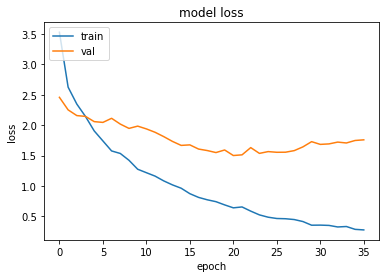

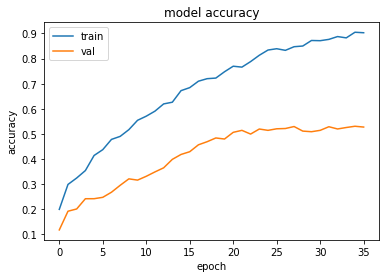

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.4998708963394165 , and Val Acc happened to be 0.5065000057220459
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5307000279426575 and Val Loss happened to be  1.7472003698349
TestLoss:  1.4513089656829834  TestAcc: 0.5128999948501587
ship 0.785
horse 0.637
frog 0.634
truck 0.63
automobile 0.535
deer 0.503
airplane 0.479
dog 0.344
cat 0.343
bird 0.239


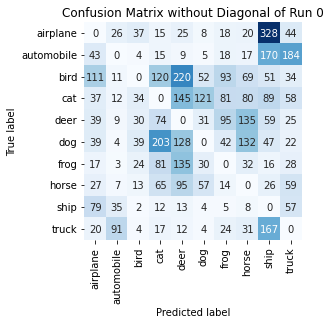

Summing down the rows, for Predictions of each Class that were wrong:  [412. 198. 187. 602. 782. 312. 390. 524. 953. 511.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  220.0 times
Summing across the columns, for total number of that True Class misidentified:  [521. 465. 761. 657. 497. 656. 366. 363. 215. 370.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  135.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1 on Dataset A

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Brigh

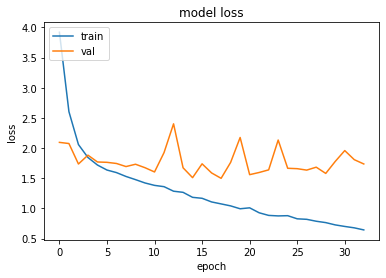

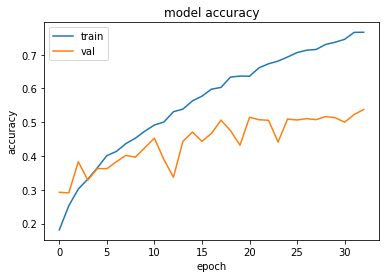

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.4976041316986084 , and Val Acc happened to be 0.5059999823570251
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5376999974250793 and Val Loss happened to be  1.735451579093933
TestLoss:  1.476464033126831  TestAcc: 0.5131000280380249
frog 0.736
truck 0.679
horse 0.645
automobile 0.588
dog 0.534
ship 0.532
deer 0.501
airplane 0.441
bird 0.302
cat 0.173


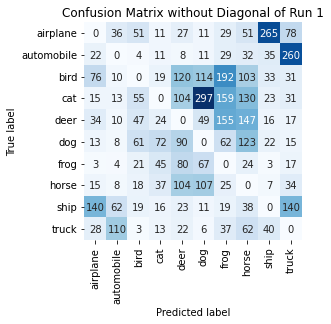

Summing down the rows, for Predictions of each Class that were wrong:  [346. 261. 279. 248. 578. 673. 707. 710. 444. 623.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  120.0 times
Summing across the columns, for total number of that True Class misidentified:  [559. 412. 698. 827. 499. 466. 264. 355. 468. 321.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  155.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2 on Dataset A

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )


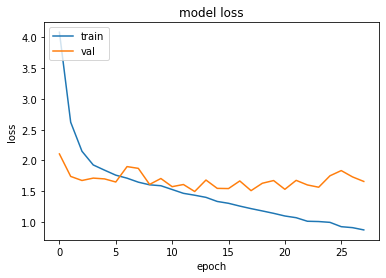

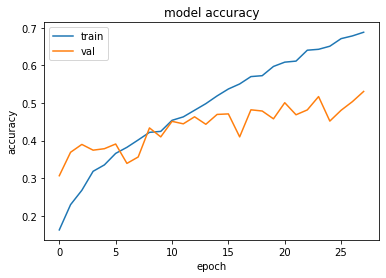

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4959827661514282 , and Val Acc happened to be 0.46320000290870667
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5307000279426575 and Val Loss happened to be  1.659433364868164
TestLoss:  1.484273076057434  TestAcc: 0.4657999873161316
dog 0.74
truck 0.693
frog 0.625
horse 0.62
ship 0.545
automobile 0.493
deer 0.34
airplane 0.294
bird 0.198
cat 0.11


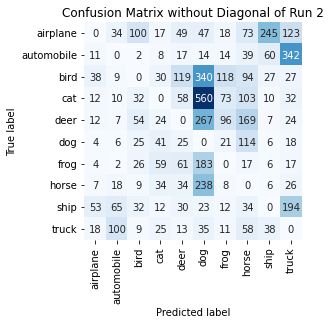

Summing down the rows, for Predictions of each Class that were wrong:  [ 159.  251.  289.  250.  406. 1707.  371.  701.  405.  803.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  119.0 times
Summing across the columns, for total number of that True Class misidentified:  [706. 507. 802. 890. 660. 260. 375. 380. 455. 307.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  267.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3 on Dataset A

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contras

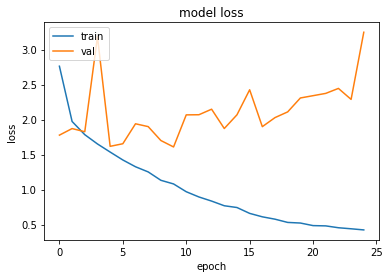

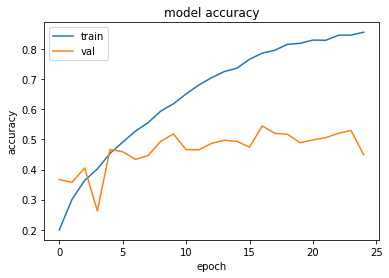

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.6089884042739868 , and Val Acc happened to be 0.5182999968528748
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.544700026512146 and Val Loss happened to be  1.8992139101028442
TestLoss:  1.6054441928863525  TestAcc: 0.5181999802589417
frog 0.806
ship 0.662
truck 0.652
dog 0.636
horse 0.58
automobile 0.547
deer 0.525
airplane 0.347
bird 0.277
cat 0.15


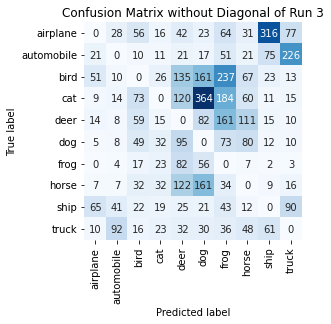

Summing down the rows, for Predictions of each Class that were wrong:  [182. 212. 334. 197. 674. 915. 883. 437. 524. 460.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  135.0 times
Summing across the columns, for total number of that True Class misidentified:  [653. 453. 723. 850. 475. 364. 194. 420. 338. 348.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  161.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4 on Dataset A

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
Co

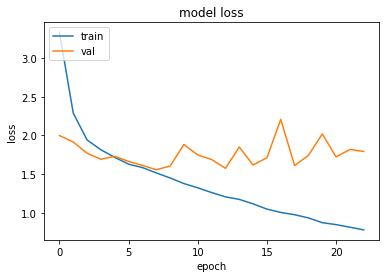

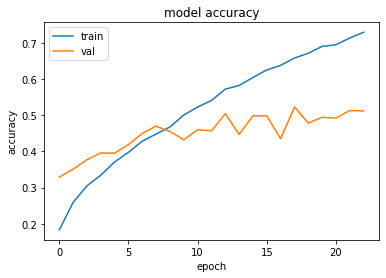

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.5559109449386597 , and Val Acc happened to be 0.46950000524520874
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.522599995136261 and Val Loss happened to be  1.608839988708496
TestLoss:  1.5424976348876953  TestAcc: 0.47209998965263367
frog 0.799
dog 0.62
ship 0.59
truck 0.58
automobile 0.566
horse 0.54
deer 0.458
airplane 0.272
cat 0.208
bird 0.088


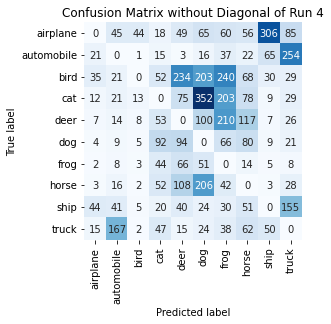

Summing down the rows, for Predictions of each Class that were wrong:  [ 143.  342.   83.  393.  684. 1041.  926.  548.  484.  635.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  234.0 times
Summing across the columns, for total number of that True Class misidentified:  [728. 434. 912. 792. 542. 380. 201. 460. 410. 420.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  210.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5 on Dataset A

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 

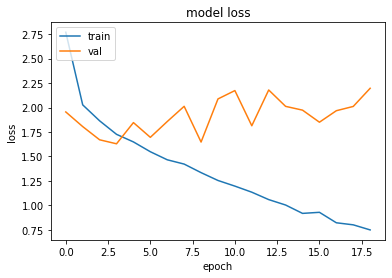

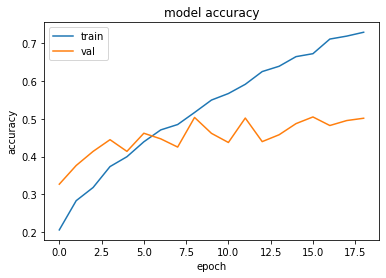

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6294176578521729 , and Val Acc happened to be 0.444599986076355
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5045999884605408 and Val Loss happened to be  1.8501132726669312
TestLoss:  1.6173478364944458  TestAcc: 0.43959999084472656
ship 0.728
frog 0.679
truck 0.631
horse 0.583
dog 0.578
automobile 0.355
deer 0.311
airplane 0.304
bird 0.117
cat 0.11


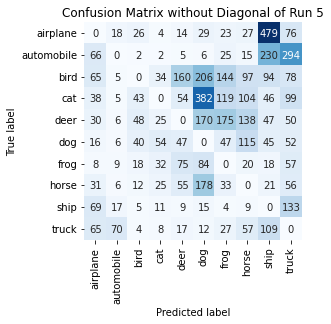

Summing down the rows, for Predictions of each Class that were wrong:  [ 388.  142.  198.  195.  436. 1082.  597.  582. 1089.  895.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  160.0 times
Summing across the columns, for total number of that True Class misidentified:  [696. 645. 883. 890. 689. 422. 321. 417. 272. 369.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  175.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6 on Dataset A

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contra

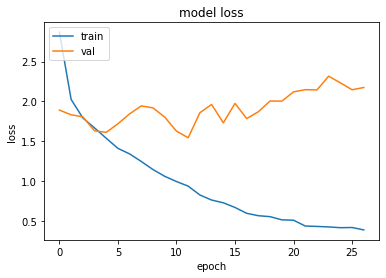

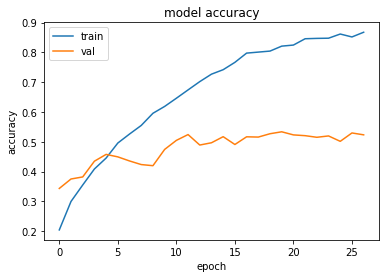

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.5450981855392456 , and Val Acc happened to be 0.524399995803833
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5336999893188477 and Val Loss happened to be  2.0033740997314453
TestLoss:  1.5474400520324707  TestAcc: 0.5270000100135803
ship 0.705
frog 0.701
horse 0.689
truck 0.654
automobile 0.595
dog 0.488
deer 0.417
airplane 0.403
bird 0.392
cat 0.226


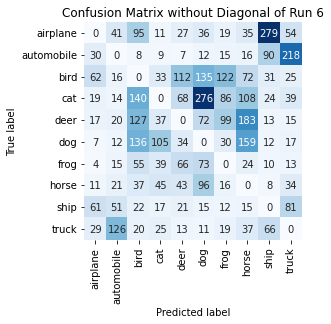

Summing down the rows, for Predictions of each Class that were wrong:  [240. 316. 640. 321. 391. 726. 418. 649. 533. 496.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [597. 405. 608. 774. 583. 512. 299. 311. 295. 346.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  183.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7 on Dataset A

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0

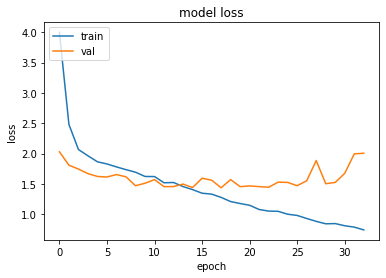

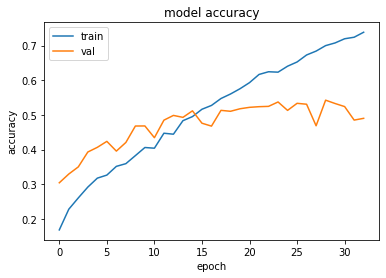

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.4372906684875488 , and Val Acc happened to be 0.5130000114440918
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5424000024795532 and Val Loss happened to be  1.504028081893921
TestLoss:  1.4145208597183228  TestAcc: 0.5133000016212463
truck 0.761
ship 0.759
horse 0.755
dog 0.572
frog 0.536
deer 0.496
airplane 0.454
automobile 0.404
bird 0.314
cat 0.082


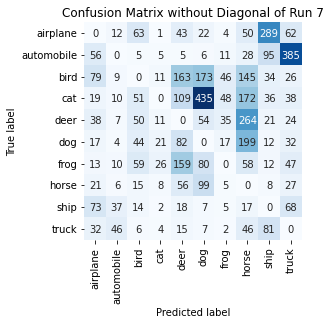

Summing down the rows, for Predictions of each Class that were wrong:  [348. 141. 307.  89. 650. 883. 173. 979. 588. 709.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  163.0 times
Summing across the columns, for total number of that True Class misidentified:  [546. 596. 686. 918. 504. 428. 464. 245. 241. 239.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  264.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8 on Dataset A

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )

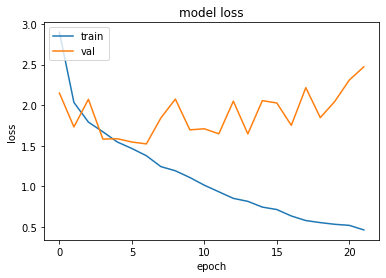

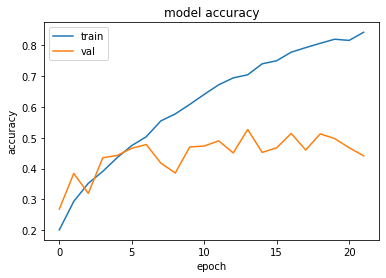

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.523322343826294 , and Val Acc happened to be 0.47780001163482666
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.5264000296592712 and Val Loss happened to be  1.6467411518096924
TestLoss:  1.5227571725845337  TestAcc: 0.4754999876022339
ship 0.703
horse 0.667
truck 0.642
dog 0.639
frog 0.638
automobile 0.433
airplane 0.347
bird 0.327
deer 0.305
cat 0.054


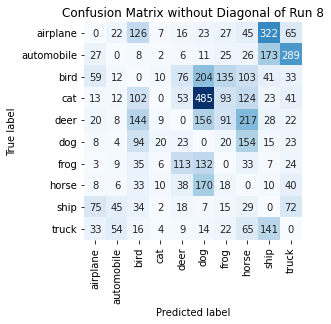

Summing down the rows, for Predictions of each Class that were wrong:  [ 246.  172.  592.   70.  352. 1202.  446.  796.  760.  609.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  113.0 times
Summing across the columns, for total number of that True Class misidentified:  [653. 567. 673. 946. 695. 361. 362. 333. 297. 358.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  217.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9 on Dataset A

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 

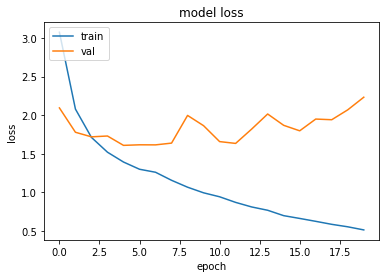

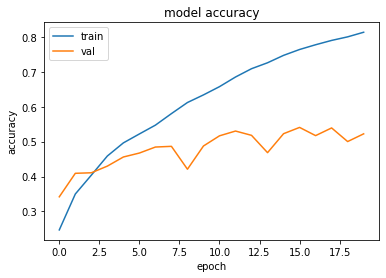

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6090738773345947 , and Val Acc happened to be 0.4560000002384186
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5407000184059143 and Val Loss happened to be  1.7974779605865479
TestLoss:  1.600503921508789  TestAcc: 0.4496000111103058
frog 0.829
truck 0.661
dog 0.602
horse 0.563
ship 0.528
deer 0.338
airplane 0.335
bird 0.301
automobile 0.221
cat 0.118


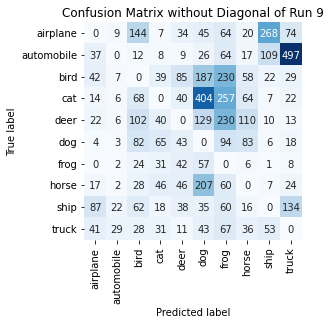

Summing down the rows, for Predictions of each Class that were wrong:  [ 264.   86.  550.  285.  348. 1133. 1126.  410.  483.  819.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  85.0 times
Summing across the columns, for total number of that True Class misidentified:  [665. 779. 699. 882. 662. 398. 171. 437. 472. 339.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  230.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10 on Dataset A

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

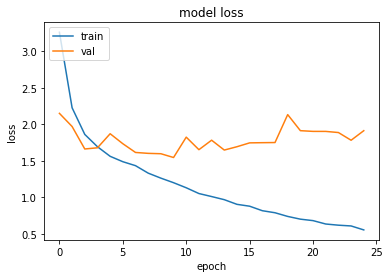

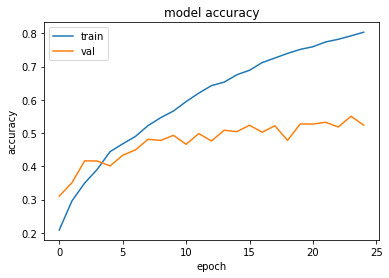

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.5475749969482422 , and Val Acc happened to be 0.49320000410079956
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.550599992275238 and Val Loss happened to be  1.784035325050354
TestLoss:  1.5350074768066406  TestAcc: 0.48809999227523804
truck 0.779
frog 0.744
horse 0.706
dog 0.489
ship 0.483
automobile 0.482
deer 0.466
airplane 0.327
bird 0.241
cat 0.164


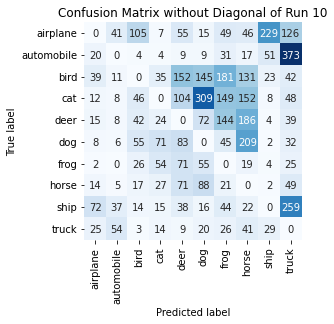

Summing down the rows, for Predictions of each Class that were wrong:  [207. 170. 312. 251. 592. 729. 690. 823. 352. 993.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  152.0 times
Summing across the columns, for total number of that True Class misidentified:  [673. 518. 759. 836. 534. 511. 256. 294. 517. 221.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  186.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11 on Dataset A

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 

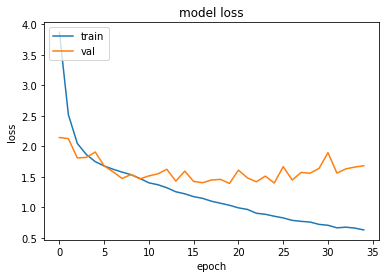

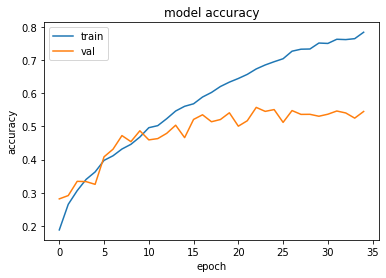

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.3943800926208496 , and Val Acc happened to be 0.5411999821662903
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5575000047683716 and Val Loss happened to be  1.4214738607406616
TestLoss:  1.3834595680236816  TestAcc: 0.5460000038146973
frog 0.745
ship 0.734
automobile 0.708
truck 0.653
horse 0.532
dog 0.52
deer 0.464
bird 0.424
airplane 0.347
cat 0.333


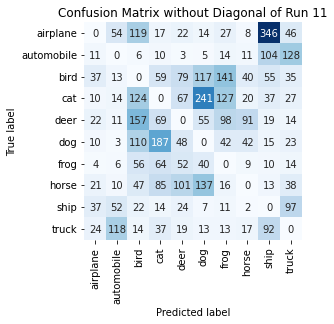

Summing down the rows, for Predictions of each Class that were wrong:  [176. 281. 655. 542. 415. 629. 489. 240. 691. 422.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  101.0 times
Summing across the columns, for total number of that True Class misidentified:  [653. 292. 576. 667. 536. 480. 255. 468. 266. 347.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  157.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12 on Dataset A

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   (

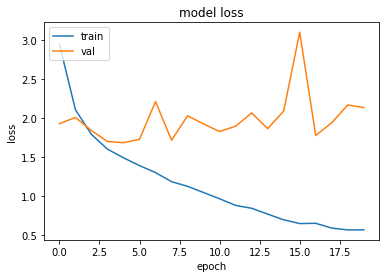

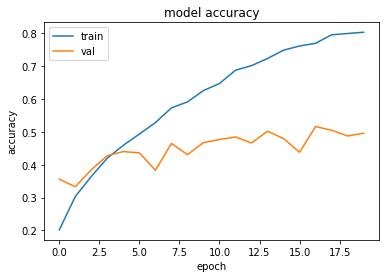

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.685518741607666 , and Val Acc happened to be 0.4399999976158142
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5162000060081482 and Val Loss happened to be  1.7775425910949707
TestLoss:  1.6711140871047974  TestAcc: 0.4422000050544739
frog 0.759
ship 0.754
truck 0.57
horse 0.565
dog 0.503
automobile 0.392
airplane 0.333
deer 0.274
bird 0.26
cat 0.012


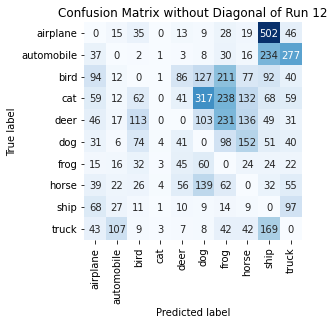

Summing down the rows, for Predictions of each Class that were wrong:  [ 432.  234.  364.   17.  302.  780.  954.  607. 1221.  667.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  86.0 times
Summing across the columns, for total number of that True Class misidentified:  [667. 608. 740. 988. 726. 497. 241. 435. 246. 430.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  231.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13 on Dataset A

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
Zo

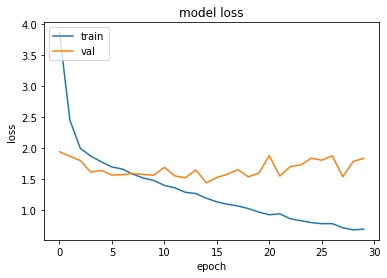

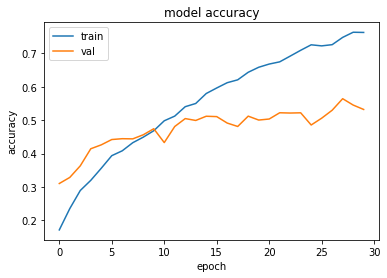

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.4340928792953491 , and Val Acc happened to be 0.5117999911308289
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.564300000667572 and Val Loss happened to be  1.5323446989059448
TestLoss:  1.4119977951049805  TestAcc: 0.5091999769210815
dog 0.719
ship 0.699
truck 0.693
frog 0.621
horse 0.616
deer 0.436
automobile 0.405
bird 0.377
airplane 0.333
cat 0.193


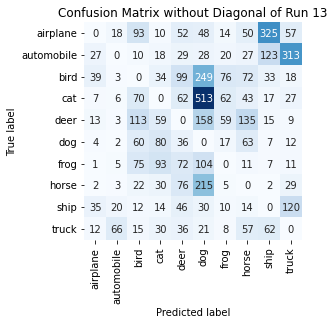

Summing down the rows, for Predictions of each Class that were wrong:  [ 140.  126.  470.  368.  508. 1366.  271.  472.  591.  596.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  99.0 times
Summing across the columns, for total number of that True Class misidentified:  [667. 595. 623. 807. 564. 281. 379. 384. 301. 307.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  158.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14 on Dataset A

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Z

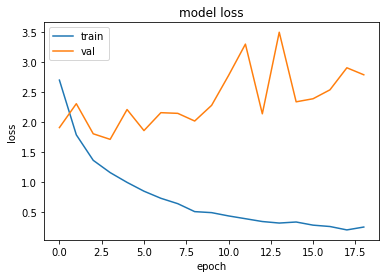

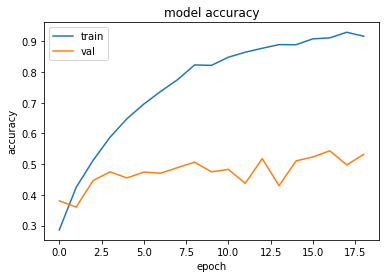

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.7095986604690552 , and Val Acc happened to be 0.4749999940395355
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5436000227928162 and Val Loss happened to be  2.5338051319122314
TestLoss:  1.707655429840088  TestAcc: 0.4733999967575073
ship 0.676
horse 0.667
frog 0.654
truck 0.642
dog 0.607
automobile 0.476
airplane 0.392
deer 0.346
bird 0.176
cat 0.098


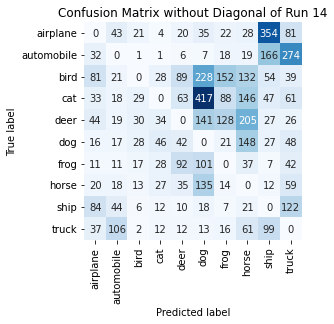

Summing down the rows, for Predictions of each Class that were wrong:  [ 358.  297.  147.  192.  369. 1095.  466.  797.  793.  752.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  92.0 times
Summing across the columns, for total number of that True Class misidentified:  [608. 524. 824. 902. 654. 393. 346. 333. 324. 358.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  205.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15 on Dataset A

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16

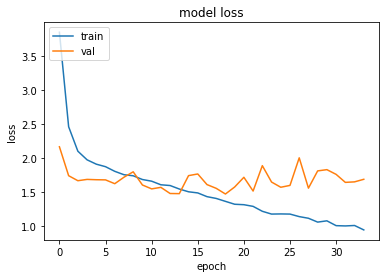

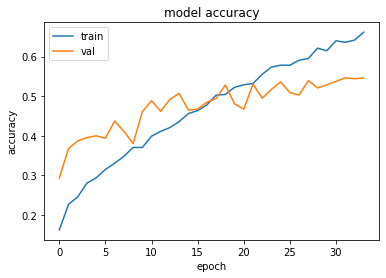

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.4697983264923096 , and Val Acc happened to be 0.5281999707221985
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5460000038146973 and Val Loss happened to be  1.6408568620681763
TestLoss:  1.4493266344070435  TestAcc: 0.5307000279426575
frog 0.747
horse 0.692
truck 0.684
ship 0.632
dog 0.629
automobile 0.539
deer 0.497
airplane 0.422
bird 0.285
cat 0.18


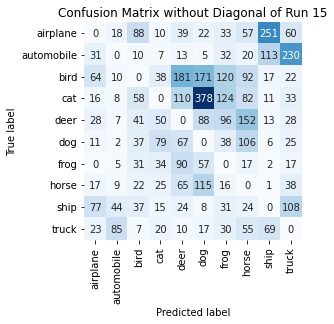

Summing down the rows, for Predictions of each Class that were wrong:  [267. 188. 331. 278. 599. 861. 520. 605. 483. 561.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  181.0 times
Summing across the columns, for total number of that True Class misidentified:  [578. 461. 715. 820. 503. 371. 253. 308. 368. 316.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  152.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16 on Dataset A

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

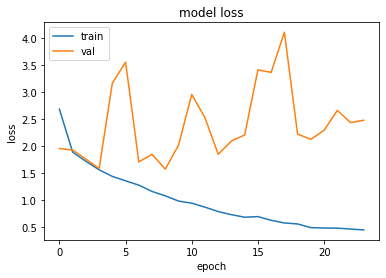

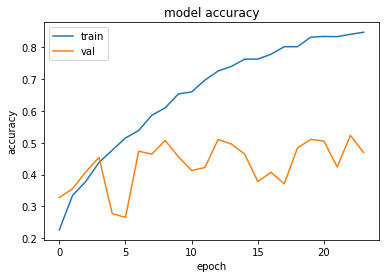

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.5704013109207153 , and Val Acc happened to be 0.507099986076355
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5230000019073486 and Val Loss happened to be  2.430588722229004
TestLoss:  1.5666567087173462  TestAcc: 0.501800000667572
frog 0.767
truck 0.72
dog 0.648
ship 0.64
automobile 0.454
horse 0.436
deer 0.432
airplane 0.404
bird 0.292
cat 0.225


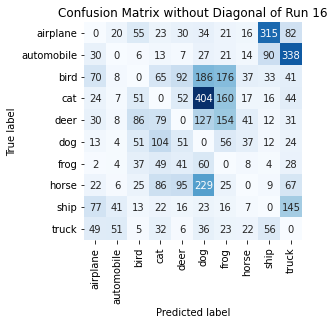

Summing down the rows, for Predictions of each Class that were wrong:  [ 317.  149.  329.  473.  390. 1126.  652.  199.  547.  800.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  95.0 times
Summing across the columns, for total number of that True Class misidentified:  [596. 546. 708. 775. 568. 352. 233. 564. 360. 280.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  154.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17 on Dataset A

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0

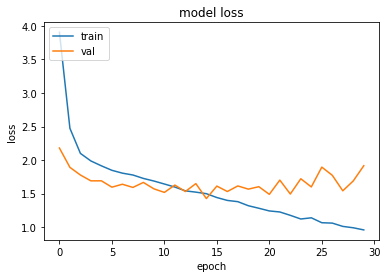

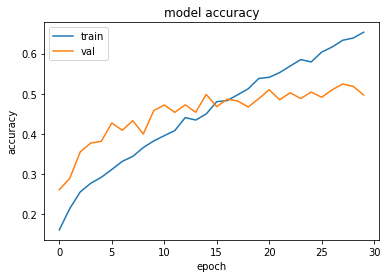

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.426550269126892 , and Val Acc happened to be 0.4984000027179718
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5242999792098999 and Val Loss happened to be  1.5422425270080566
TestLoss:  1.4127942323684692  TestAcc: 0.4966000020503998
truck 0.722
ship 0.706
frog 0.696
horse 0.626
dog 0.594
automobile 0.492
deer 0.399
airplane 0.302
cat 0.265
bird 0.164


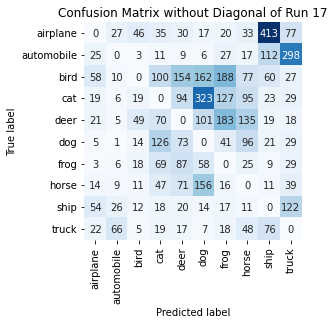

Summing down the rows, for Predictions of each Class that were wrong:  [221. 156. 177. 495. 555. 844. 637. 537. 744. 668.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  154.0 times
Summing across the columns, for total number of that True Class misidentified:  [698. 508. 836. 735. 601. 406. 304. 374. 294. 278.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  183.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18 on Dataset A

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0

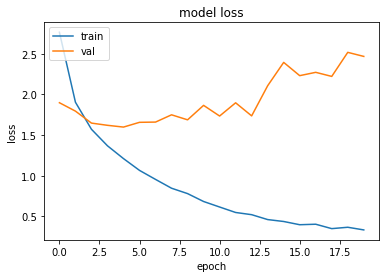

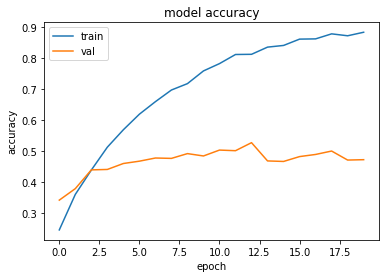

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5984176397323608 , and Val Acc happened to be 0.4609000086784363
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.5281000137329102 and Val Loss happened to be  1.7362722158432007
TestLoss:  1.5745635032653809  TestAcc: 0.47049999237060547
horse 0.723
frog 0.708
ship 0.637
dog 0.581
truck 0.581
deer 0.431
automobile 0.397
airplane 0.337
bird 0.24
cat 0.07


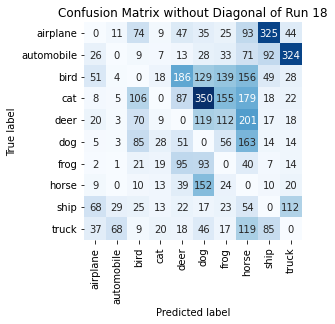

Summing down the rows, for Predictions of each Class that were wrong:  [ 226.  124.  409.  136.  558.  969.  584. 1076.  617.  596.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  186.0 times
Summing across the columns, for total number of that True Class misidentified:  [663. 603. 760. 930. 569. 419. 292. 277. 363. 419.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  201.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19 on Dataset A

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )


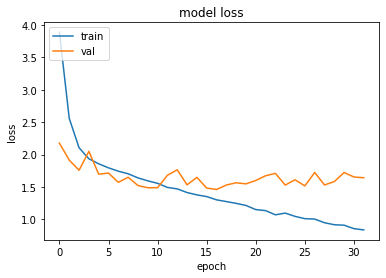

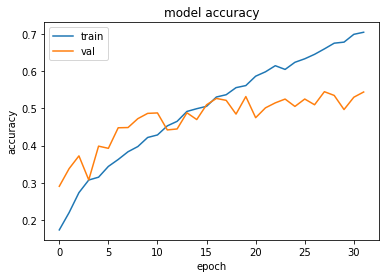

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.4608322381973267 , and Val Acc happened to be 0.5267999768257141
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5449000000953674 and Val Loss happened to be  1.5304449796676636
TestLoss:  1.4377492666244507  TestAcc: 0.5260999798774719
truck 0.706
frog 0.694
automobile 0.681
horse 0.649
ship 0.627
dog 0.607
deer 0.416
cat 0.369
airplane 0.355
bird 0.157


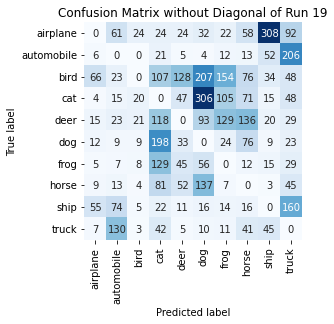

Summing down the rows, for Predictions of each Class that were wrong:  [179. 355.  94. 742. 350. 861. 478. 499. 501. 680.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  128.0 times
Summing across the columns, for total number of that True Class misidentified:  [645. 319. 843. 631. 584. 393. 306. 351. 373. 294.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  136.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20 on Dataset A

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 ,

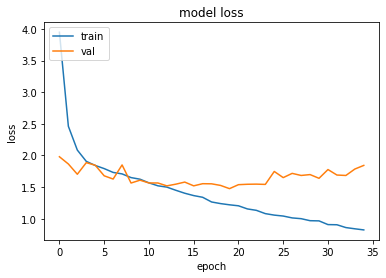

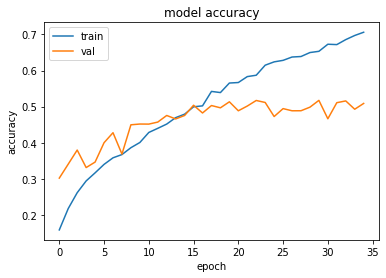

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.474923014640808 , and Val Acc happened to be 0.5134000182151794
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5174000263214111 and Val Loss happened to be  1.6384798288345337
TestLoss:  1.4384171962738037  TestAcc: 0.508400022983551
horse 0.678
frog 0.65
ship 0.645
dog 0.631
automobile 0.563
airplane 0.503
truck 0.489
deer 0.424
bird 0.343
cat 0.158


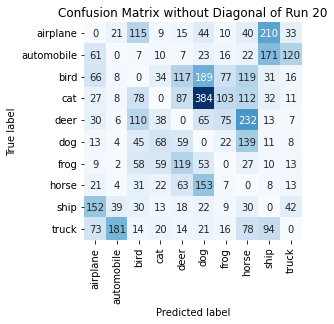

Summing down the rows, for Predictions of each Class that were wrong:  [452. 273. 488. 273. 499. 954. 335. 799. 580. 263.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  119.0 times
Summing across the columns, for total number of that True Class misidentified:  [497. 437. 657. 842. 576. 369. 350. 322. 355. 511.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  232.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21 on Dataset A

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

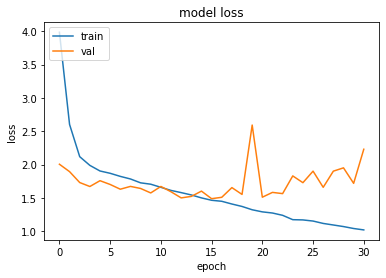

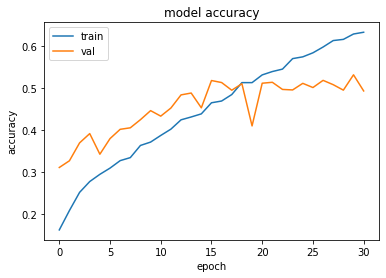

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.4898117780685425 , and Val Acc happened to be 0.5185999870300293
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5321999788284302 and Val Loss happened to be  1.7198477983474731
TestLoss:  1.4730054140090942  TestAcc: 0.5067999958992004
frog 0.78
ship 0.712
dog 0.651
automobile 0.632
truck 0.61
horse 0.548
airplane 0.402
deer 0.323
bird 0.307
cat 0.103


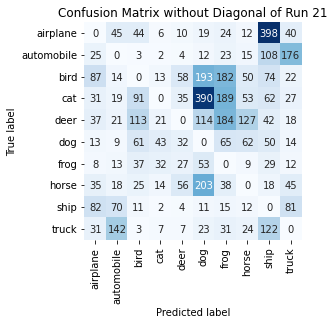

Summing down the rows, for Predictions of each Class that were wrong:  [ 349.  351.  388.  140.  233. 1018.  751.  364.  903.  435.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  58.0 times
Summing across the columns, for total number of that True Class misidentified:  [598. 368. 693. 897. 677. 349. 220. 452. 288. 390.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  184.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22 on Dataset A

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

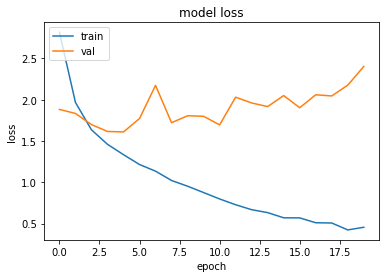

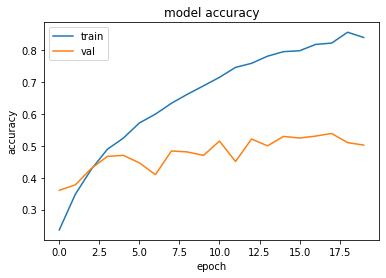

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6098555326461792 , and Val Acc happened to be 0.4700999855995178
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5386000275611877 and Val Loss happened to be  2.0451772212982178
TestLoss:  1.6033048629760742  TestAcc: 0.46880000829696655
horse 0.725
frog 0.721
ship 0.708
dog 0.583
truck 0.547
automobile 0.497
airplane 0.335
deer 0.248
cat 0.198
bird 0.126


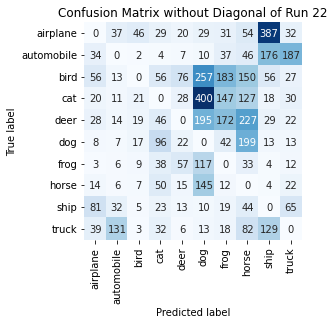

Summing down the rows, for Predictions of each Class that were wrong:  [ 283.  257.  129.  374.  244. 1176.  661.  962.  816.  410.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  76.0 times
Summing across the columns, for total number of that True Class misidentified:  [665. 503. 874. 802. 752. 417. 279. 275. 292. 453.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  227.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23 on Dataset A

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

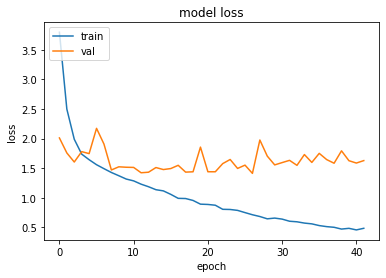

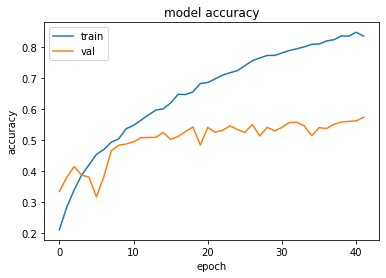

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.411163330078125 , and Val Acc happened to be 0.5501000285148621
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5728999972343445 and Val Loss happened to be  1.6271920204162598
TestLoss:  1.3685206174850464  TestAcc: 0.5656999945640564
truck 0.744
ship 0.721
frog 0.673
horse 0.642
deer 0.638
automobile 0.633
dog 0.583
airplane 0.351
cat 0.349
bird 0.323


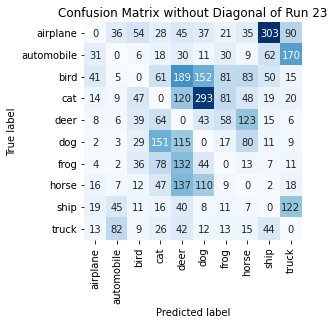

Summing down the rows, for Predictions of each Class that were wrong:  [148. 195. 243. 489. 850. 710. 321. 413. 513. 461.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  189.0 times
Summing across the columns, for total number of that True Class misidentified:  [649. 367. 677. 651. 362. 417. 327. 358. 279. 256.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  123.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24 on Dataset A

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 

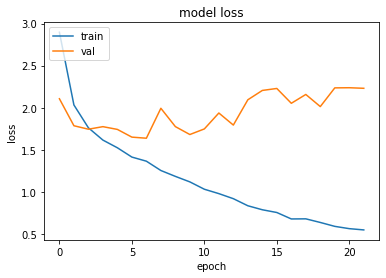

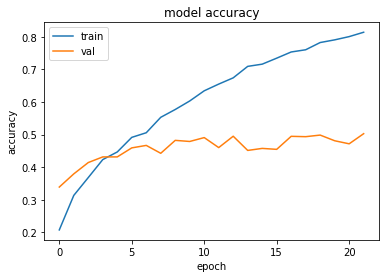

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.6375998258590698 , and Val Acc happened to be 0.4666999876499176
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5026999711990356 and Val Loss happened to be  2.2307159900665283
TestLoss:  1.5921931266784668  TestAcc: 0.48190000653266907
frog 0.789
horse 0.686
truck 0.654
dog 0.516
automobile 0.507
ship 0.454
airplane 0.403
deer 0.331
bird 0.25
cat 0.229


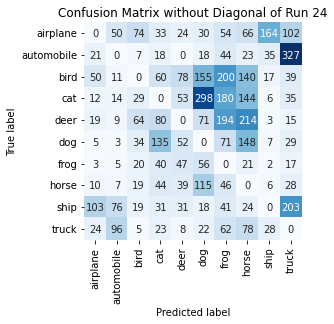

Summing down the rows, for Predictions of each Class that were wrong:  [247. 271. 271. 464. 332. 783. 892. 858. 268. 795.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  78.0 times
Summing across the columns, for total number of that True Class misidentified:  [597. 493. 750. 771. 669. 484. 211. 314. 546. 346.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  214.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25 on Dataset A

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

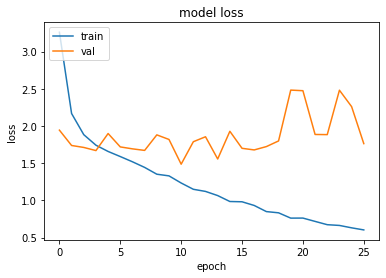

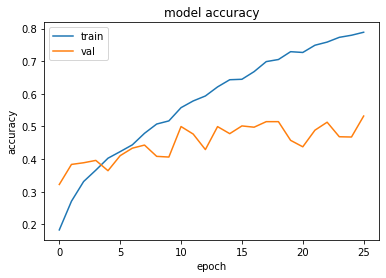

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.4862260818481445 , and Val Acc happened to be 0.49970000982284546
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5318999886512756 and Val Loss happened to be  1.7626210451126099
TestLoss:  1.482330560684204  TestAcc: 0.4884999990463257
dog 0.756
ship 0.743
truck 0.708
frog 0.658
horse 0.541
automobile 0.492
deer 0.323
airplane 0.307
bird 0.216
cat 0.141


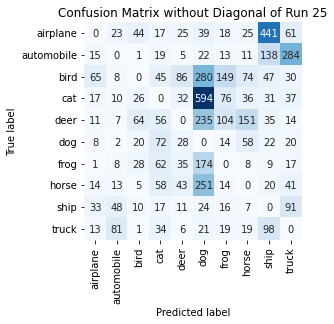

Summing down the rows, for Predictions of each Class that were wrong:  [ 177.  200.  199.  380.  271. 1640.  423.  389.  841.  595.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  86.0 times
Summing across the columns, for total number of that True Class misidentified:  [693. 508. 784. 859. 677. 244. 342. 459. 257. 292.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  235.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26 on Dataset A

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0

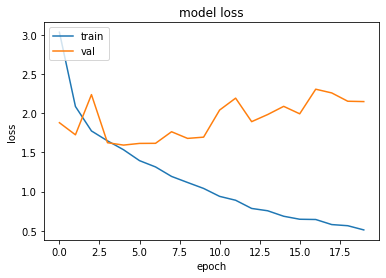

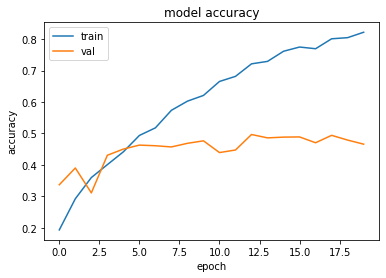

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5939744710922241 , and Val Acc happened to be 0.450300008058548
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.4966000020503998 and Val Loss happened to be  1.893322467803955
TestLoss:  1.5782763957977295  TestAcc: 0.45320001244544983
dog 0.717
frog 0.684
ship 0.575
automobile 0.562
truck 0.558
horse 0.531
airplane 0.283
deer 0.259
cat 0.209
bird 0.154


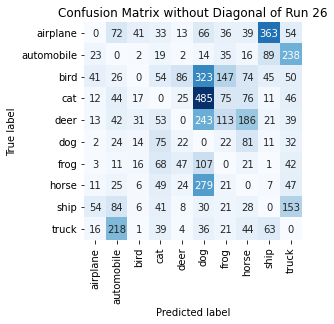

Summing down the rows, for Predictions of each Class that were wrong:  [ 175.  546.  134.  431.  231. 1583.  491.  565.  611.  701.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  86.0 times
Summing across the columns, for total number of that True Class misidentified:  [717. 438. 846. 791. 741. 283. 316. 469. 425. 442.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  243.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27 on Dataset A

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

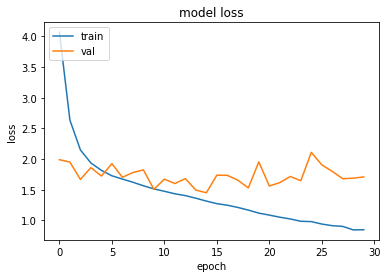

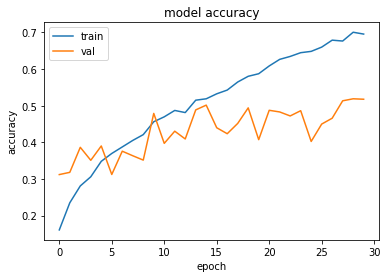

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.4511278867721558 , and Val Acc happened to be 0.5015000104904175
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5188000202178955 and Val Loss happened to be  1.6884227991104126
TestLoss:  1.4485070705413818  TestAcc: 0.501800000667572
frog 0.822
ship 0.676
truck 0.676
dog 0.618
automobile 0.56
horse 0.56
deer 0.342
airplane 0.329
cat 0.225
bird 0.21


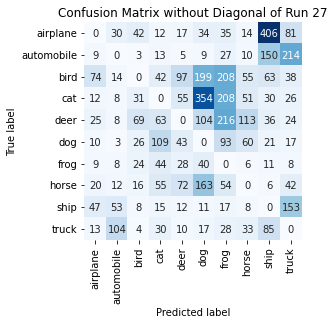

Summing down the rows, for Predictions of each Class that were wrong:  [219. 240. 223. 383. 339. 931. 886. 350. 808. 603.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  97.0 times
Summing across the columns, for total number of that True Class misidentified:  [671. 440. 790. 775. 658. 382. 178. 440. 324. 324.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  216.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28 on Dataset A

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 

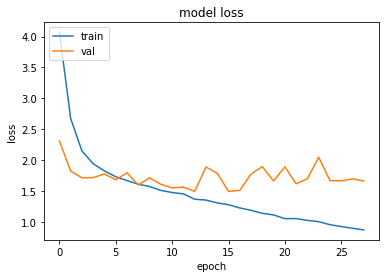

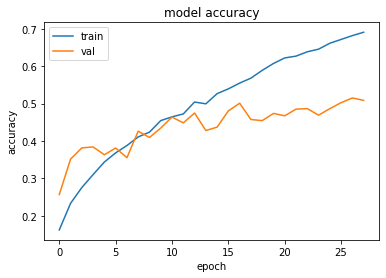

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4925282001495361 , and Val Acc happened to be 0.4747999906539917
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5149999856948853 and Val Loss happened to be  1.6945284605026245
TestLoss:  1.4550049304962158  TestAcc: 0.48669999837875366
frog 0.733
automobile 0.63
deer 0.615
truck 0.57
dog 0.553
horse 0.553
ship 0.55
airplane 0.364
bird 0.233
cat 0.066


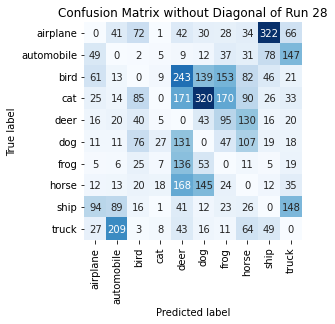

Summing down the rows, for Predictions of each Class that were wrong:  [300. 416. 339.  81. 984. 770. 588. 575. 573. 507.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  243.0 times
Summing across the columns, for total number of that True Class misidentified:  [636. 370. 767. 934. 385. 447. 267. 447. 450. 430.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  130.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29 on Dataset A

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

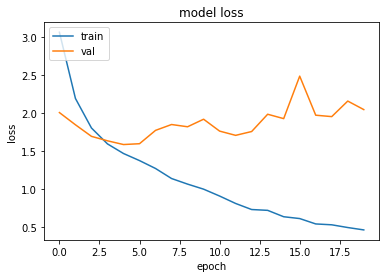

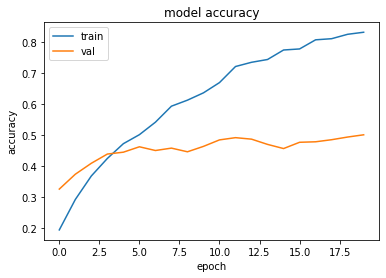

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5895171165466309 , and Val Acc happened to be 0.44519999623298645
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5012000203132629 and Val Loss happened to be  2.0496442317962646
TestLoss:  1.567582368850708  TestAcc: 0.4456999897956848
frog 0.774
dog 0.768
ship 0.614
horse 0.561
truck 0.504
airplane 0.384
automobile 0.331
deer 0.242
bird 0.222
cat 0.057


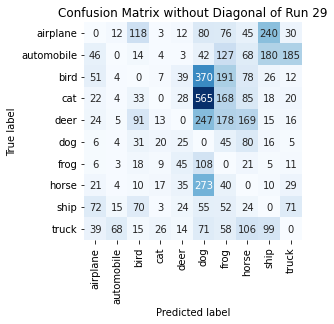

Summing down the rows, for Predictions of each Class that were wrong:  [ 287.  119.  400.  102.  225. 1811.  935.  676.  609.  379.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  45.0 times
Summing across the columns, for total number of that True Class misidentified:  [616. 669. 778. 943. 758. 232. 226. 439. 386. 496.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  247.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30 on Dataset A

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

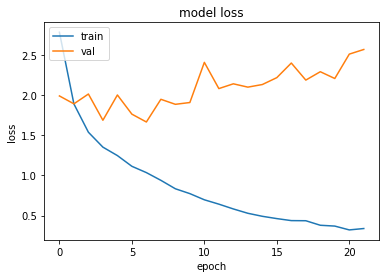

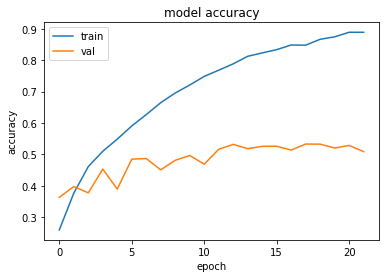

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.6634601354599 , and Val Acc happened to be 0.48660001158714294
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.532800018787384 and Val Loss happened to be  2.184124231338501
TestLoss:  1.6551777124404907  TestAcc: 0.48030000925064087
truck 0.732
frog 0.703
horse 0.674
dog 0.607
ship 0.592
automobile 0.53
deer 0.398
airplane 0.273
bird 0.18
cat 0.114


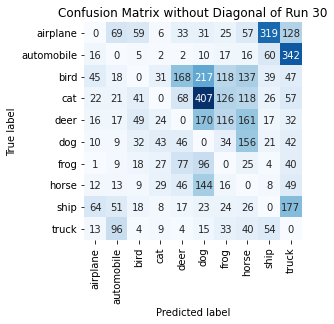

Summing down the rows, for Predictions of each Class that were wrong:  [ 199.  303.  235.  179.  461. 1113.  509.  736.  548.  914.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  168.0 times
Summing across the columns, for total number of that True Class misidentified:  [727. 470. 820. 886. 602. 393. 297. 326. 408. 268.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  170.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31 on Dataset A

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0

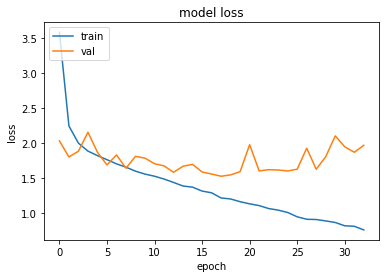

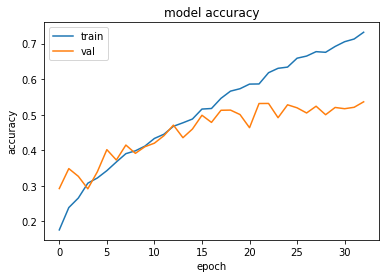

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.5298491716384888 , and Val Acc happened to be 0.5123999714851379
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5361999869346619 and Val Loss happened to be  1.971693754196167
TestLoss:  1.5140016078948975  TestAcc: 0.5127000212669373
frog 0.816
ship 0.733
truck 0.657
dog 0.639
horse 0.612
automobile 0.583
deer 0.427
bird 0.294
airplane 0.286
cat 0.08


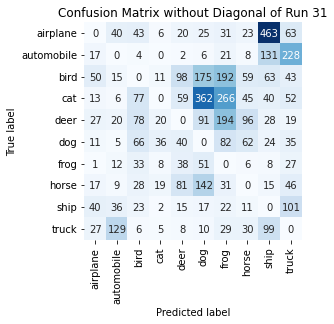

Summing down the rows, for Predictions of each Class that were wrong:  [203. 272. 358. 107. 361. 879. 868. 340. 871. 614.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  98.0 times
Summing across the columns, for total number of that True Class misidentified:  [714. 417. 706. 920. 573. 361. 184. 388. 267. 343.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  194.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32 on Dataset A

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 

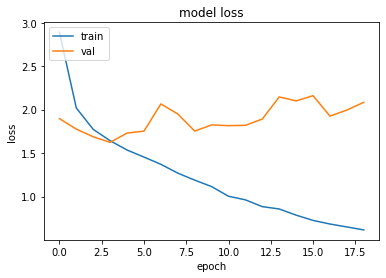

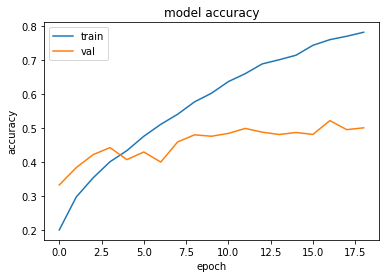

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6235994100570679 , and Val Acc happened to be 0.44359999895095825
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5230000019073486 and Val Loss happened to be  1.9252843856811523
TestLoss:  1.591006875038147  TestAcc: 0.4514999985694885
frog 0.805
truck 0.655
dog 0.616
horse 0.575
ship 0.515
airplane 0.392
automobile 0.357
deer 0.301
bird 0.194
cat 0.105


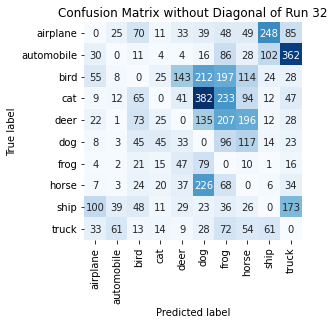

Summing down the rows, for Predictions of each Class that were wrong:  [ 268.  154.  370.  170.  376. 1140. 1043.  688.  480.  796.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  143.0 times
Summing across the columns, for total number of that True Class misidentified:  [608. 643. 806. 895. 699. 384. 195. 425. 485. 345.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  207.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33 on Dataset A

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   (

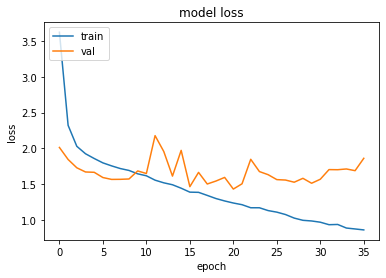

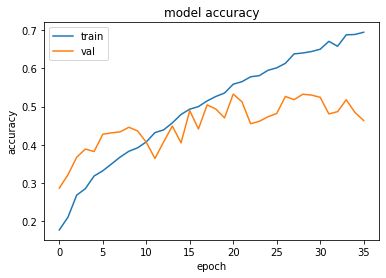

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.430463194847107 , and Val Acc happened to be 0.532800018787384
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.532800018787384 and Val Loss happened to be  1.430463194847107
TestLoss:  1.436790943145752  TestAcc: 0.5292999744415283
frog 0.748
ship 0.746
dog 0.673
truck 0.633
automobile 0.572
horse 0.522
deer 0.504
airplane 0.33
bird 0.296
cat 0.269


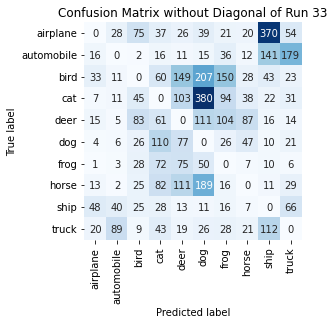

Summing down the rows, for Predictions of each Class that were wrong:  [ 157.  195.  318.  509.  584. 1028.  491.  267.  735.  423.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  149.0 times
Summing across the columns, for total number of that True Class misidentified:  [670. 428. 704. 731. 496. 327. 252. 478. 254. 367.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  111.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34 on Dataset A

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

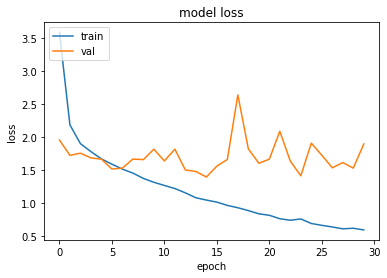

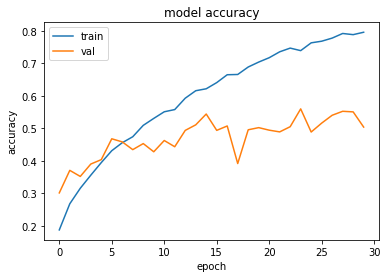

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.3935858011245728 , and Val Acc happened to be 0.5440999865531921
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5598999857902527 and Val Loss happened to be  1.4127131700515747
TestLoss:  1.370019793510437  TestAcc: 0.5501000285148621
ship 0.774
frog 0.772
truck 0.693
horse 0.628
dog 0.581
automobile 0.524
deer 0.512
airplane 0.472
bird 0.283
cat 0.262


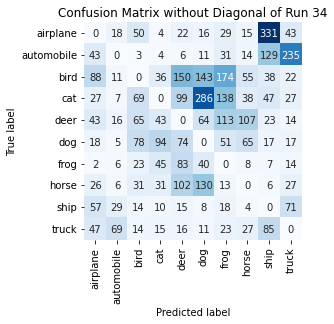

Summing down the rows, for Predictions of each Class that were wrong:  [351. 167. 347. 282. 567. 709. 590. 333. 683. 470.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  150.0 times
Summing across the columns, for total number of that True Class misidentified:  [528. 476. 717. 738. 488. 419. 228. 372. 226. 307.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  113.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35 on Dataset A

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

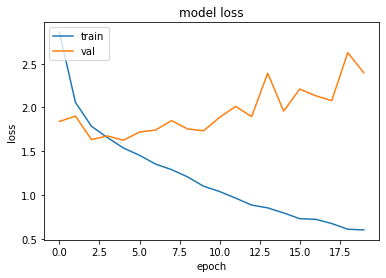

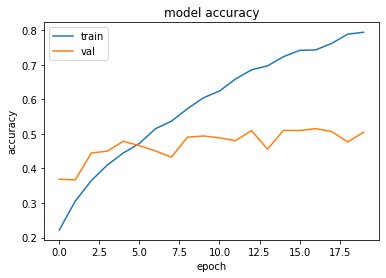

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6266995668411255 , and Val Acc happened to be 0.478300005197525
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5149000287055969 and Val Loss happened to be  2.1338350772857666
TestLoss:  1.5959746837615967  TestAcc: 0.4796000123023987
frog 0.739
truck 0.687
horse 0.686
ship 0.672
dog 0.485
automobile 0.438
airplane 0.413
deer 0.364
bird 0.26
cat 0.052


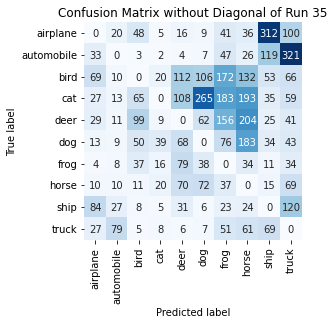

Summing down the rows, for Predictions of each Class that were wrong:  [296. 187. 326. 124. 494. 572. 786. 893. 673. 853.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [587. 562. 740. 948. 636. 515. 261. 314. 328. 313.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  204.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36 on Dataset A

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

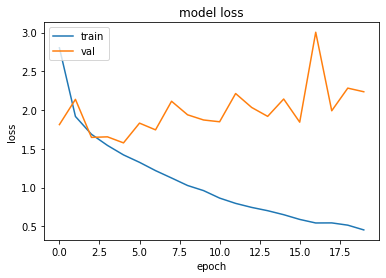

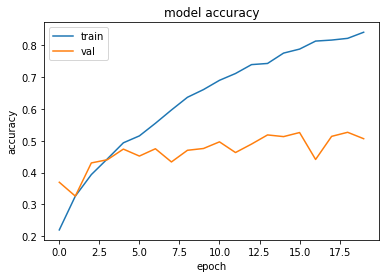

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.576167106628418 , and Val Acc happened to be 0.4740000069141388
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5268999934196472 and Val Loss happened to be  2.2828831672668457
TestLoss:  1.5408705472946167  TestAcc: 0.47530001401901245
frog 0.727
truck 0.703
ship 0.62
dog 0.593
horse 0.482
deer 0.472
automobile 0.401
airplane 0.302
bird 0.255
cat 0.198


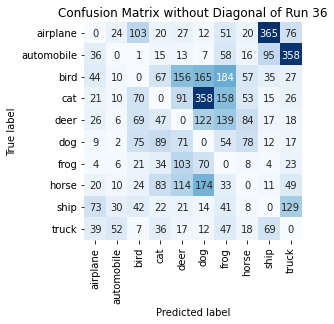

Summing down the rows, for Predictions of each Class that were wrong:  [272. 150. 412. 413. 613. 934. 765. 342. 623. 723.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  156.0 times
Summing across the columns, for total number of that True Class misidentified:  [698. 599. 745. 802. 528. 407. 273. 518. 380. 297.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  139.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37 on Dataset A

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomI

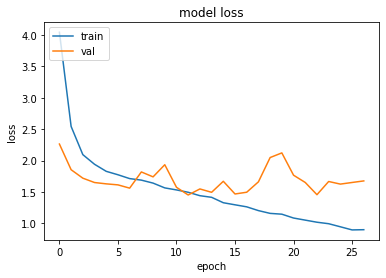

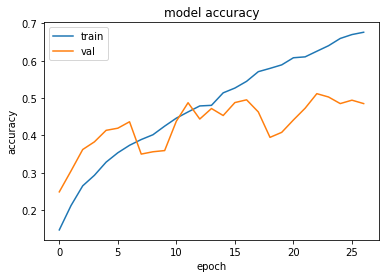

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.4529573917388916 , and Val Acc happened to be 0.4875999987125397
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5117999911308289 and Val Loss happened to be  1.4576754570007324
TestLoss:  1.44536292552948  TestAcc: 0.4814999997615814
frog 0.798
horse 0.671
ship 0.65
dog 0.625
automobile 0.561
truck 0.534
deer 0.403
airplane 0.38
bird 0.143
cat 0.05


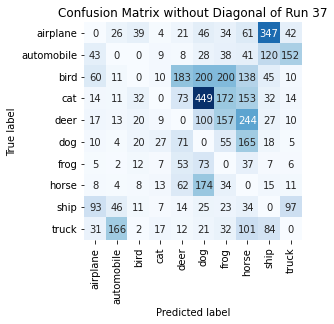

Summing down the rows, for Predictions of each Class that were wrong:  [ 281.  283.  144.  103.  497. 1116.  745.  974.  695.  347.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  183.0 times
Summing across the columns, for total number of that True Class misidentified:  [620. 439. 857. 950. 597. 375. 202. 329. 350. 466.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  244.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38 on Dataset A

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

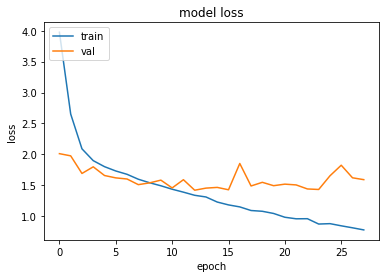

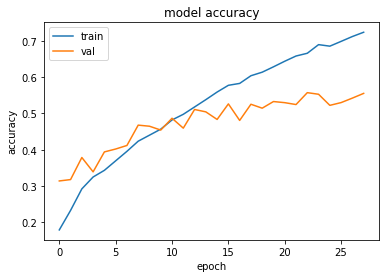

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4178961515426636 , and Val Acc happened to be 0.5109000205993652
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5572999715805054 and Val Loss happened to be  1.4382213354110718
TestLoss:  1.4271222352981567  TestAcc: 0.5097000002861023
ship 0.762
frog 0.761
horse 0.667
dog 0.656
truck 0.622
automobile 0.614
deer 0.345
airplane 0.305
bird 0.185
cat 0.18


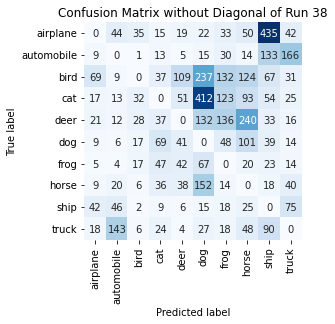

Summing down the rows, for Predictions of each Class that were wrong:  [ 199.  297.  144.  287.  315. 1079.  552.  715.  892.  423.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  109.0 times
Summing across the columns, for total number of that True Class misidentified:  [695. 386. 815. 820. 655. 344. 239. 333. 238. 378.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  240.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39 on Dataset A

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

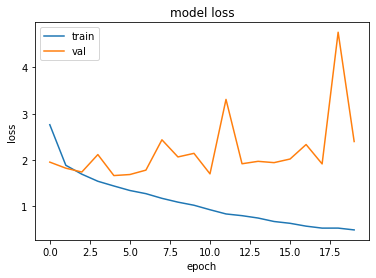

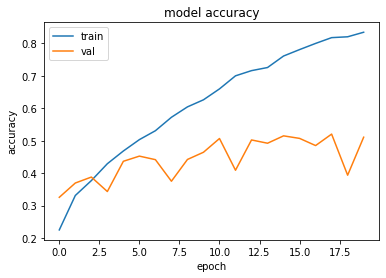

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6657090187072754 , and Val Acc happened to be 0.43650001287460327
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5202000141143799 and Val Loss happened to be  1.9170429706573486
TestLoss:  1.6423066854476929  TestAcc: 0.4309000074863434
horse 0.732
ship 0.652
frog 0.628
truck 0.552
deer 0.482
dog 0.447
airplane 0.396
automobile 0.238
bird 0.16
cat 0.022


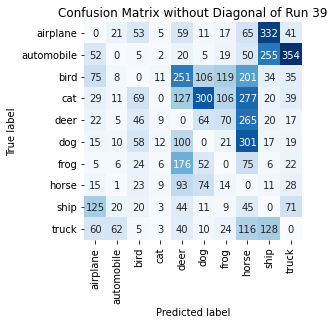

Summing down the rows, for Predictions of each Class that were wrong:  [ 398.  144.  303.   60.  910.  633.  399. 1395.  823.  626.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  251.0 times
Summing across the columns, for total number of that True Class misidentified:  [604. 762. 840. 978. 518. 553. 372. 268. 348. 448.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  265.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40 on Dataset A

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

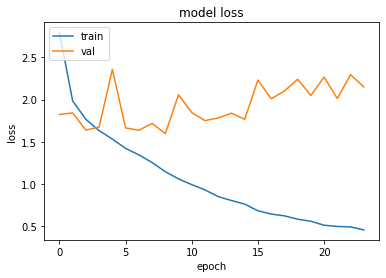

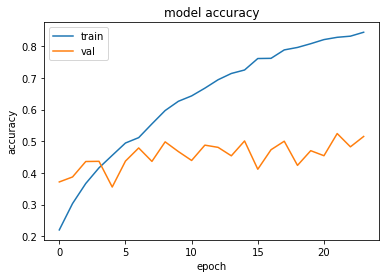

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.5967528820037842 , and Val Acc happened to be 0.49810001254081726
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5242999792098999 and Val Loss happened to be  2.0133256912231445
TestLoss:  1.5974204540252686  TestAcc: 0.49079999327659607
frog 0.748
truck 0.71
ship 0.67
dog 0.642
horse 0.538
automobile 0.513
cat 0.299
airplane 0.288
deer 0.268
bird 0.232


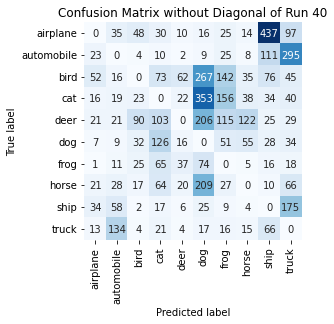

Summing down the rows, for Predictions of each Class that were wrong:  [ 188.  331.  245.  509.  179. 1176.  566.  296.  803.  799.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  62.0 times
Summing across the columns, for total number of that True Class misidentified:  [712. 487. 768. 701. 732. 358. 252. 462. 330. 290.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  206.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41 on Dataset A

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

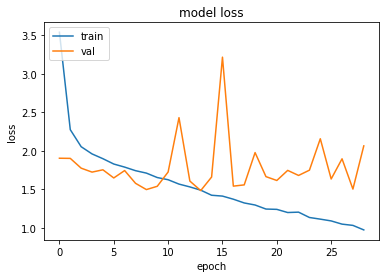

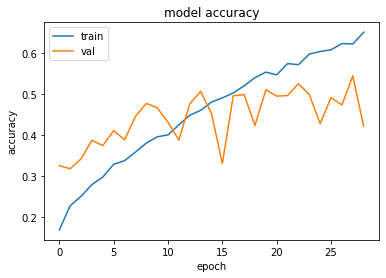

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.4857491254806519 , and Val Acc happened to be 0.5062999725341797
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5440999865531921 and Val Loss happened to be  1.505001425743103
TestLoss:  1.4723122119903564  TestAcc: 0.49790000915527344
frog 0.767
dog 0.75
ship 0.725
horse 0.651
automobile 0.578
truck 0.577
bird 0.328
airplane 0.323
deer 0.235
cat 0.045


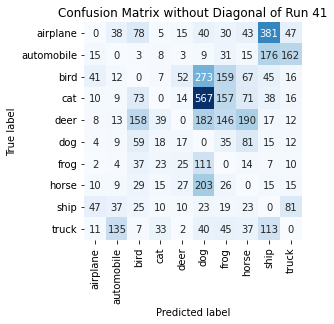

Summing down the rows, for Predictions of each Class that were wrong:  [ 148.  266.  469.  158.  165. 1448.  648.  541.  807.  371.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  52.0 times
Summing across the columns, for total number of that True Class misidentified:  [677. 422. 672. 955. 765. 250. 233. 349. 275. 423.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  190.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42 on Dataset A

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -

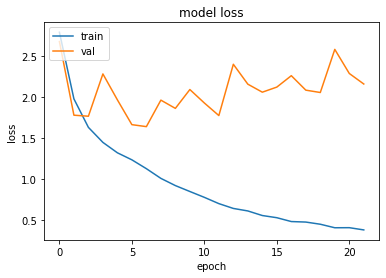

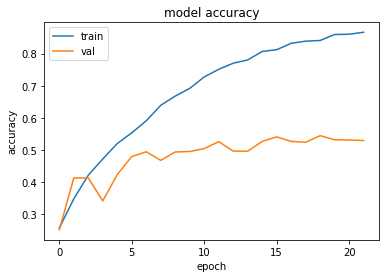

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.6359113454818726 , and Val Acc happened to be 0.4943000078201294
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5443999767303467 and Val Loss happened to be  2.052361249923706
TestLoss:  1.6268208026885986  TestAcc: 0.49239999055862427
truck 0.69
ship 0.686
frog 0.633
dog 0.612
horse 0.606
automobile 0.489
deer 0.427
cat 0.32
airplane 0.289
bird 0.172


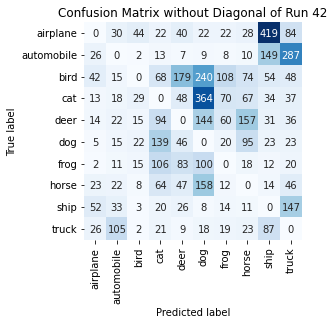

Summing down the rows, for Predictions of each Class that were wrong:  [ 203.  271.  140.  547.  485. 1063.  333.  483.  823.  728.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  179.0 times
Summing across the columns, for total number of that True Class misidentified:  [711. 511. 828. 680. 573. 388. 367. 394. 314. 310.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  157.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43 on Dataset A

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -

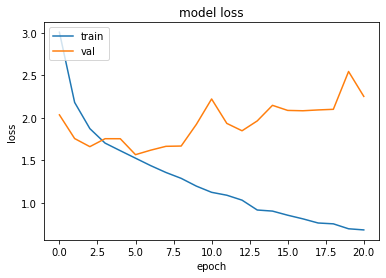

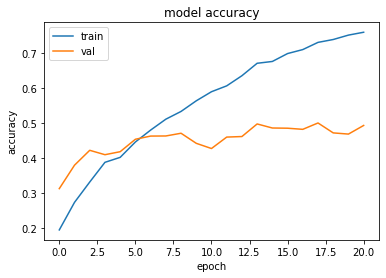

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5664972066879272 , and Val Acc happened to be 0.4546000063419342
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5012000203132629 and Val Loss happened to be  2.092820405960083
TestLoss:  1.564088225364685  TestAcc: 0.451200008392334
dog 0.676
frog 0.666
ship 0.654
automobile 0.61
horse 0.602
truck 0.527
deer 0.275
airplane 0.224
bird 0.186
cat 0.092


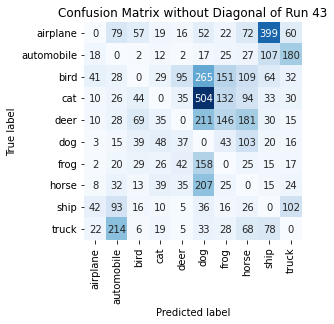

Summing down the rows, for Predictions of each Class that were wrong:  [ 156.  535.  275.  237.  272. 1483.  588.  705.  761.  476.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  95.0 times
Summing across the columns, for total number of that True Class misidentified:  [776. 390. 814. 908. 725. 324. 334. 398. 346. 473.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  211.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44 on Dataset A

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

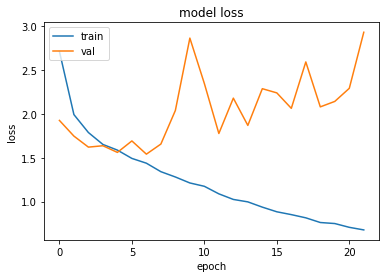

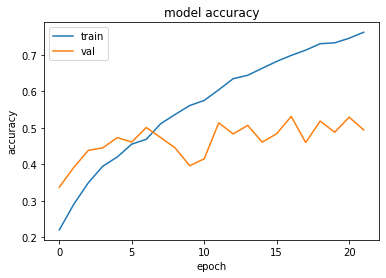

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.539947509765625 , and Val Acc happened to be 0.5008999705314636
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5311999917030334 and Val Loss happened to be  2.0606937408447266
TestLoss:  1.5143579244613647  TestAcc: 0.4984000027179718
frog 0.742
truck 0.636
dog 0.62
ship 0.615
horse 0.529
automobile 0.522
airplane 0.454
deer 0.336
bird 0.305
cat 0.225


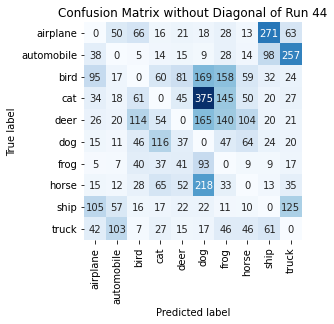

Summing down the rows, for Predictions of each Class that were wrong:  [ 375.  295.  383.  406.  329. 1086.  636.  369.  548.  589.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  81.0 times
Summing across the columns, for total number of that True Class misidentified:  [546. 478. 695. 775. 664. 380. 258. 471. 385. 364.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  165.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45 on Dataset A

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

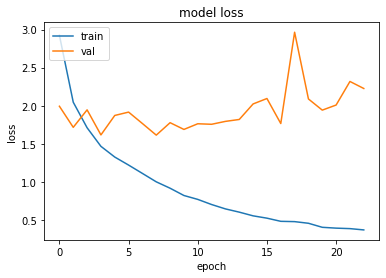

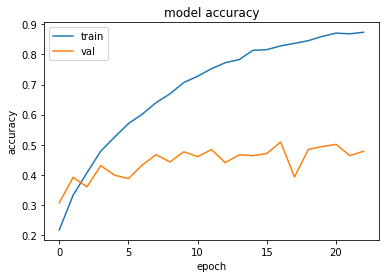

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.6129869222640991 , and Val Acc happened to be 0.46720001101493835
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5091999769210815 and Val Loss happened to be  1.7653443813323975
TestLoss:  1.6160725355148315  TestAcc: 0.4586000144481659
frog 0.766
dog 0.708
ship 0.701
horse 0.537
truck 0.499
automobile 0.485
deer 0.285
airplane 0.271
bird 0.212
cat 0.122


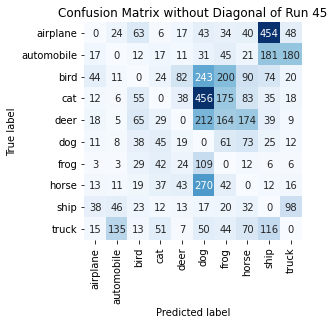

Summing down the rows, for Predictions of each Class that were wrong:  [ 171.  249.  317.  263.  254. 1431.  785.  595.  942.  407.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  82.0 times
Summing across the columns, for total number of that True Class misidentified:  [729. 515. 788. 878. 715. 292. 234. 463. 299. 501.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  212.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46 on Dataset A

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

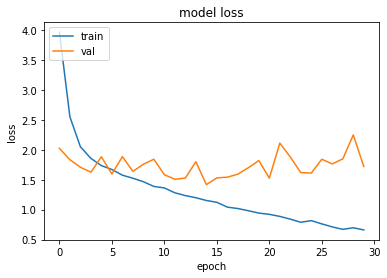

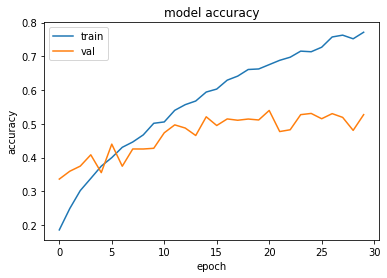

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.4183601140975952 , and Val Acc happened to be 0.5206000208854675
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5393999814987183 and Val Loss happened to be  1.5273855924606323
TestLoss:  1.3949233293533325  TestAcc: 0.5289000272750854
frog 0.764
ship 0.72
truck 0.668
dog 0.64
horse 0.64
automobile 0.548
bird 0.407
deer 0.367
airplane 0.364
cat 0.171


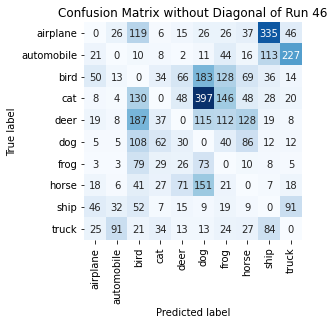

Summing down the rows, for Predictions of each Class that were wrong:  [195. 188. 747. 244. 286. 978. 560. 430. 642. 441.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  71.0 times
Summing across the columns, for total number of that True Class misidentified:  [636. 452. 593. 829. 633. 360. 236. 360. 280. 332.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  187.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47 on Dataset A

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )


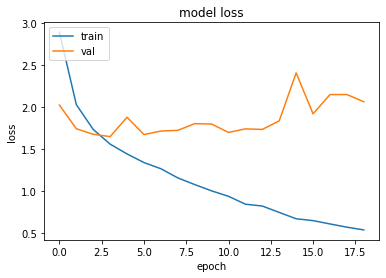

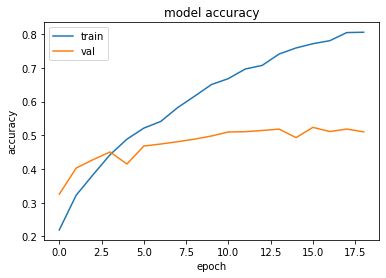

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6512984037399292 , and Val Acc happened to be 0.4505000114440918
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5234000086784363 and Val Loss happened to be  1.9222002029418945
TestLoss:  1.6331899166107178  TestAcc: 0.444599986076355
frog 0.74
ship 0.656
horse 0.648
truck 0.535
automobile 0.52
dog 0.479
deer 0.384
bird 0.249
airplane 0.204
cat 0.031


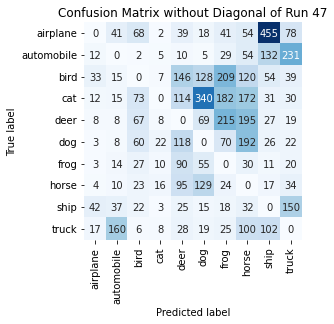

Summing down the rows, for Predictions of each Class that were wrong:  [134. 308. 348.  81. 665. 778. 813. 949. 855. 623.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  146.0 times
Summing across the columns, for total number of that True Class misidentified:  [796. 480. 751. 969. 616. 521. 260. 352. 344. 465.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  215.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48 on Dataset A

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

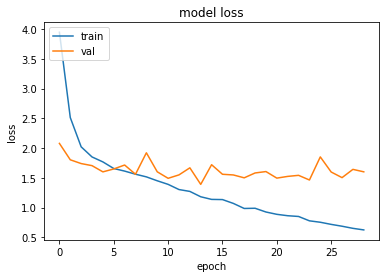

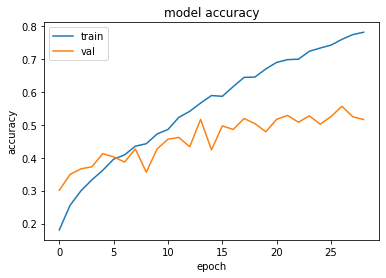

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.389929175376892 , and Val Acc happened to be 0.5163000226020813
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5561000108718872 and Val Loss happened to be  1.5031859874725342
TestLoss:  1.3739687204360962  TestAcc: 0.5174000263214111
frog 0.765
automobile 0.745
dog 0.713
ship 0.698
truck 0.557
horse 0.487
deer 0.378
bird 0.295
airplane 0.269
cat 0.267


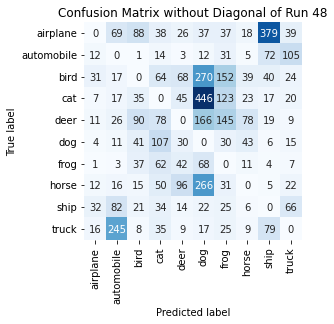

Summing down the rows, for Predictions of each Class that were wrong:  [ 126.  486.  336.  482.  333. 1304.  599.  232.  621.  307.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  96.0 times
Summing across the columns, for total number of that True Class misidentified:  [731. 255. 705. 733. 622. 287. 235. 513. 302. 443.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  166.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49 on Dataset A

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomI

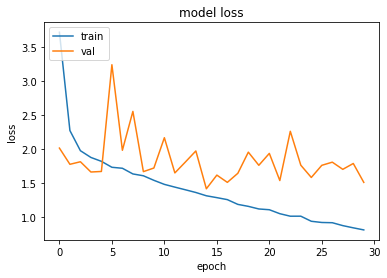

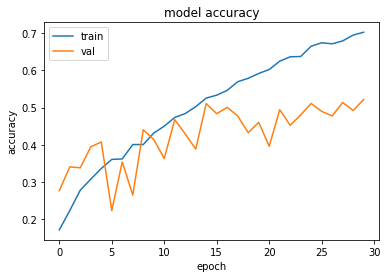

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.417572021484375 , and Val Acc happened to be 0.510699987411499
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5213000178337097 and Val Loss happened to be  1.5114257335662842
TestLoss:  1.4152791500091553  TestAcc: 0.5105000138282776
ship 0.752
dog 0.713
frog 0.696
truck 0.605
automobile 0.565
horse 0.553
deer 0.442
airplane 0.309
bird 0.269
cat 0.201


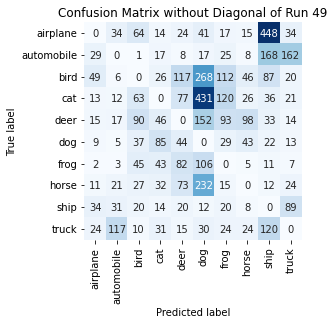

Summing down the rows, for Predictions of each Class that were wrong:  [ 186.  246.  357.  308.  460. 1289.  455.  273.  937.  384.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  117.0 times
Summing across the columns, for total number of that True Class misidentified:  [691. 435. 731. 799. 558. 287. 304. 447. 248. 395.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  152.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50 on Dataset A

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )


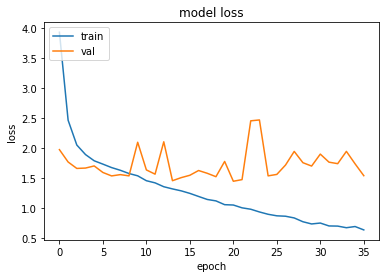

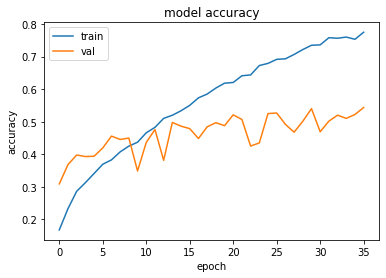

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.449892520904541 , and Val Acc happened to be 0.5213000178337097
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5436999797821045 and Val Loss happened to be  1.5426971912384033
TestLoss:  1.4259475469589233  TestAcc: 0.5067999958992004
frog 0.787
dog 0.764
ship 0.732
automobile 0.649
horse 0.508
deer 0.468
truck 0.458
airplane 0.376
bird 0.254
cat 0.072


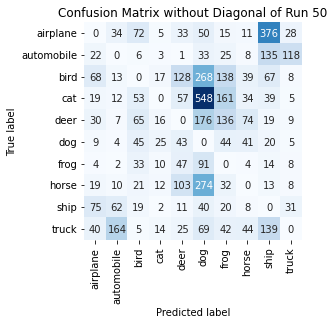

Summing down the rows, for Predictions of each Class that were wrong:  [ 286.  308.  319.  104.  448. 1549.  613.  263.  822.  220.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  128.0 times
Summing across the columns, for total number of that True Class misidentified:  [624. 351. 746. 928. 532. 236. 213. 492. 268. 542.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  176.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 18 November 2021 16:47:42  (subtract ~5-hours for local Hour), and file is called  runs_GroupA_final.pkl


In [76]:
run_through_runs(ds=trainA, ds_noalb=trainA_noalb, dstitle = "A", showpictures=False, troubleshooting=False)

filename will be:  runs_GroupB .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset B

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5


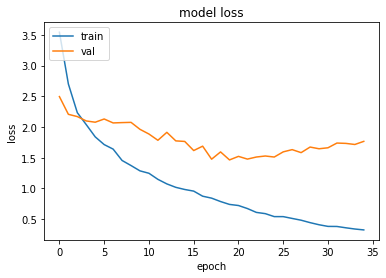

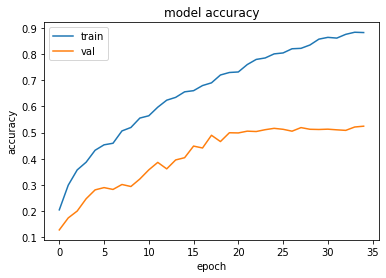

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.46425199508667 , and Val Acc happened to be 0.49939998984336853
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5245000123977661 and Val Loss happened to be  1.7664614915847778
TestLoss:  1.421408772468567  TestAcc: 0.5102999806404114
frog 0.76
airplane 0.621
truck 0.603
ship 0.596
deer 0.541
horse 0.528
automobile 0.509
bird 0.364
dog 0.359
cat 0.222


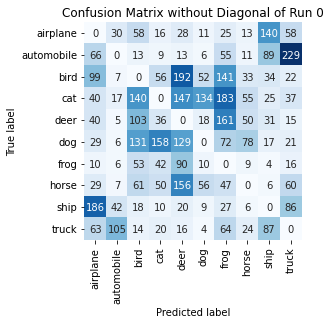

Summing down the rows, for Predictions of each Class that were wrong:  [562. 225. 591. 397. 791. 300. 775. 279. 433. 544.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  192.0 times
Summing across the columns, for total number of that True Class misidentified:  [379. 491. 636. 778. 459. 641. 240. 472. 404. 397.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  161.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1 on Dataset B

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright

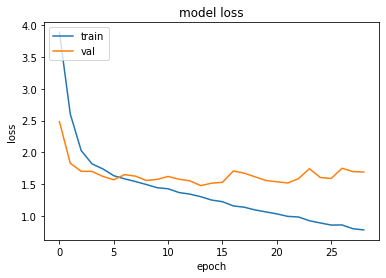

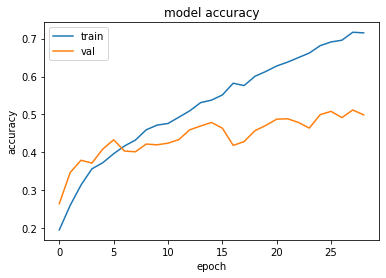

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.4755874872207642 , and Val Acc happened to be 0.46950000524520874
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5117999911308289 and Val Loss happened to be  1.6969884634017944
TestLoss:  1.4601941108703613  TestAcc: 0.47519999742507935
ship 0.707
truck 0.687
dog 0.68
frog 0.565
horse 0.565
automobile 0.534
airplane 0.322
bird 0.274
cat 0.22
deer 0.198


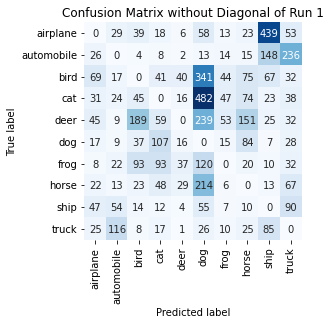

Summing down the rows, for Predictions of each Class that were wrong:  [ 290.  293.  452.  403.  151. 1548.  209.  477.  817.  608.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  40.0 times
Summing across the columns, for total number of that True Class misidentified:  [678. 466. 726. 780. 802. 320. 435. 435. 293. 313.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  239.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2 on Dataset B

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 

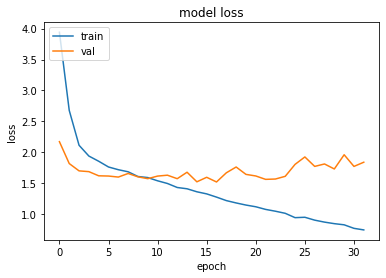

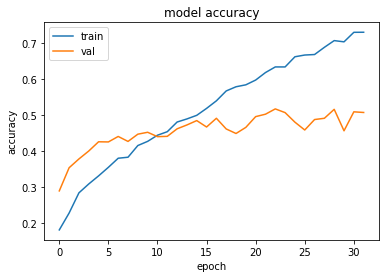

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.5187207460403442 , and Val Acc happened to be 0.4912000000476837
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5171999931335449 and Val Loss happened to be  1.566392421722412
TestLoss:  1.4843193292617798  TestAcc: 0.4846000075340271
ship 0.749
frog 0.748
dog 0.677
automobile 0.585
horse 0.514
truck 0.484
airplane 0.458
deer 0.31
cat 0.222
bird 0.099


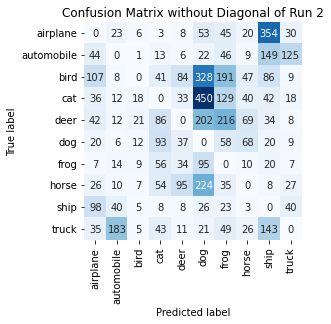

Summing down the rows, for Predictions of each Class that were wrong:  [ 415.  308.   84.  397.  316. 1421.  792.  292.  856.  273.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  95.0 times
Summing across the columns, for total number of that True Class misidentified:  [542. 415. 901. 778. 690. 323. 252. 486. 251. 516.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  216.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3 on Dataset B

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contras

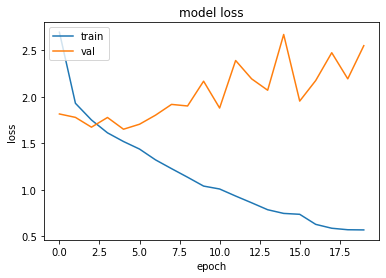

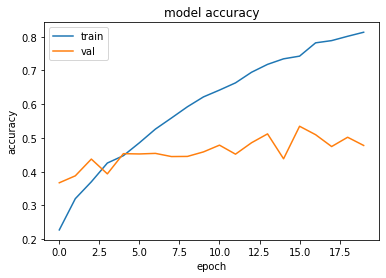

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6516191959381104 , and Val Acc happened to be 0.45339998602867126
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.534600019454956 and Val Loss happened to be  1.954093337059021
TestLoss:  1.6521146297454834  TestAcc: 0.4507000148296356
automobile 0.762
ship 0.729
dog 0.671
frog 0.656
horse 0.589
truck 0.308
airplane 0.289
bird 0.212
cat 0.161
deer 0.13


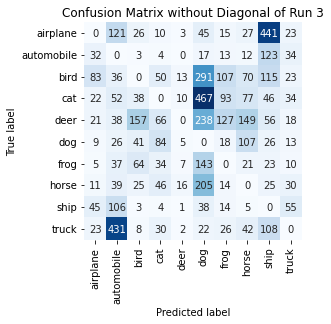

Summing down the rows, for Predictions of each Class that were wrong:  [ 251.  886.  365.  328.   57. 1466.  427.  510.  963.  240.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  16.0 times
Summing across the columns, for total number of that True Class misidentified:  [711. 238. 788. 839. 870. 329. 344. 411. 271. 692.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  238.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4 on Dataset B

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0

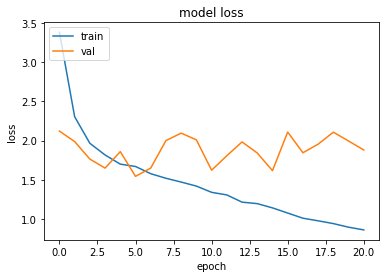

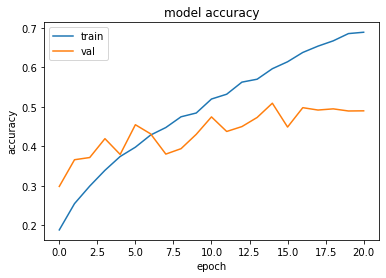

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5428248643875122 , and Val Acc happened to be 0.4546999931335449
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.5091999769210815 and Val Loss happened to be  1.6158291101455688
TestLoss:  1.525523066520691  TestAcc: 0.4560999870300293
frog 0.78
automobile 0.659
horse 0.608
ship 0.579
dog 0.551
truck 0.452
airplane 0.306
deer 0.306
cat 0.233
bird 0.087


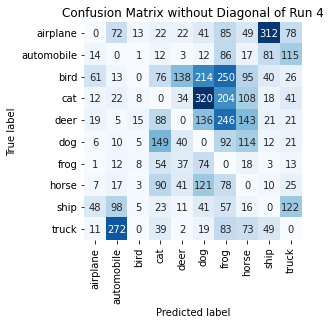

Summing down the rows, for Predictions of each Class that were wrong:  [ 179.  521.   58.  553.  328.  978. 1181.  633.  546.  462.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  138.0 times
Summing across the columns, for total number of that True Class misidentified:  [694. 341. 913. 767. 694. 449. 220. 392. 421. 548.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  246.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5 on Dataset B

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 

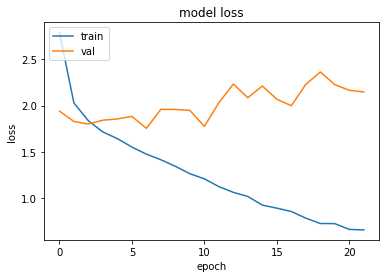

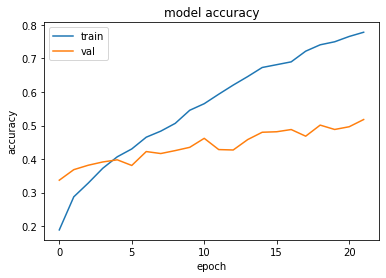

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.7551664113998413 , and Val Acc happened to be 0.42239999771118164
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.517799973487854 and Val Loss happened to be  2.1481118202209473
TestLoss:  1.6889517307281494  TestAcc: 0.42570000886917114
dog 0.699
ship 0.602
horse 0.592
truck 0.517
airplane 0.465
automobile 0.45
frog 0.382
cat 0.246
bird 0.188
deer 0.116


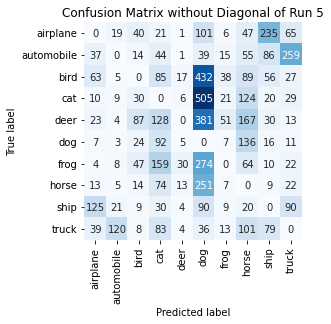

Summing down the rows, for Predictions of each Class that were wrong:  [ 321.  194.  273.  716.   81. 2109.  167.  803.  541.  538.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  30.0 times
Summing across the columns, for total number of that True Class misidentified:  [535. 550. 812. 754. 884. 301. 618. 408. 398. 483.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  381.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6 on Dataset B

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contrast

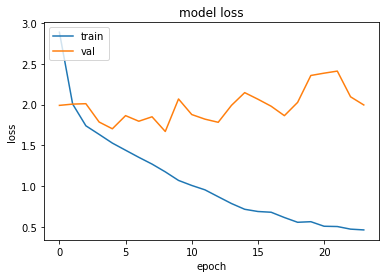

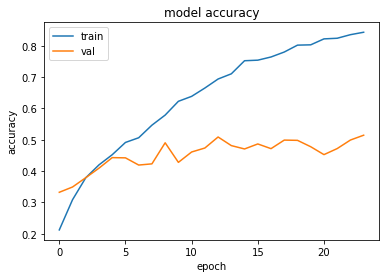

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.6707755327224731 , and Val Acc happened to be 0.4902999997138977
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5145000219345093 and Val Loss happened to be  1.9953901767730713
TestLoss:  1.6378172636032104  TestAcc: 0.490200012922287
horse 0.734
frog 0.705
airplane 0.678
ship 0.671
dog 0.555
truck 0.482
automobile 0.434
deer 0.283
bird 0.188
cat 0.172


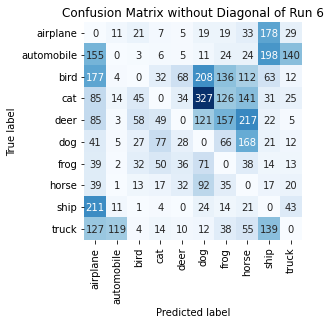

Summing down the rows, for Predictions of each Class that were wrong:  [959. 170. 204. 256. 218. 885. 615. 809. 683. 299.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  68.0 times
Summing across the columns, for total number of that True Class misidentified:  [322. 566. 812. 828. 717. 445. 295. 266. 329. 518.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  217.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7 on Dataset B

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.

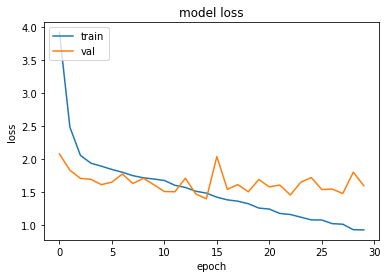

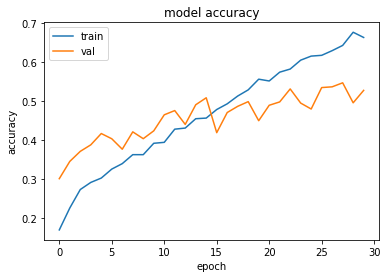

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.3956668376922607 , and Val Acc happened to be 0.5092999935150146
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5476999878883362 and Val Loss happened to be  1.4752103090286255
TestLoss:  1.373602271080017  TestAcc: 0.5083000063896179
frog 0.757
ship 0.739
truck 0.691
automobile 0.593
dog 0.564
horse 0.548
cat 0.376
airplane 0.318
bird 0.284
deer 0.213


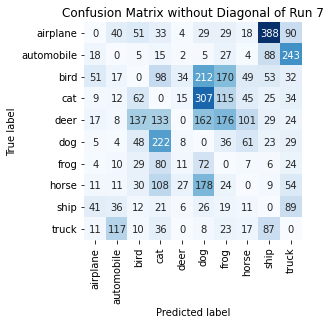

Summing down the rows, for Predictions of each Class that were wrong:  [167. 255. 384. 746. 107. 999. 619. 313. 708. 619.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  34.0 times
Summing across the columns, for total number of that True Class misidentified:  [682. 407. 716. 624. 787. 436. 243. 452. 261. 309.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  176.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8 on Dataset B

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
B

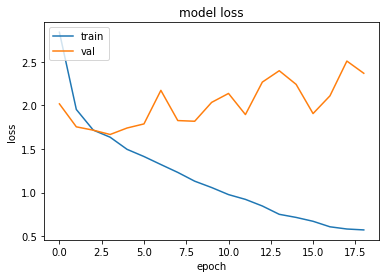

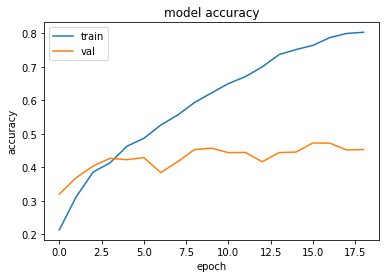

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.665773868560791 , and Val Acc happened to be 0.42649999260902405
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.4722999930381775 and Val Loss happened to be  1.905596137046814
TestLoss:  1.6495251655578613  TestAcc: 0.4235999882221222
dog 0.711
ship 0.71
horse 0.583
frog 0.562
airplane 0.461
truck 0.452
automobile 0.337
deer 0.225
bird 0.128
cat 0.067


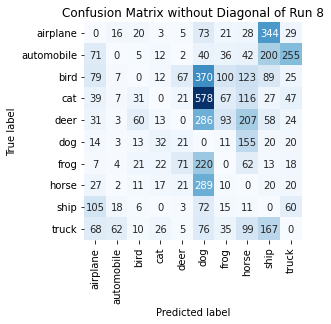

Summing down the rows, for Predictions of each Class that were wrong:  [ 441.  122.  177.  137.  216. 2004.  388.  843.  938.  498.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  71.0 times
Summing across the columns, for total number of that True Class misidentified:  [539. 663. 872. 933. 775. 289. 438. 417. 290. 548.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  286.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9 on Dataset B

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0

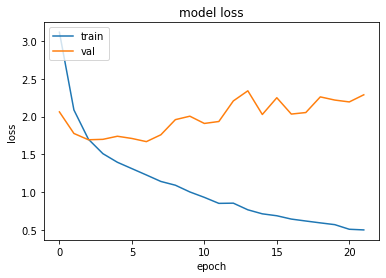

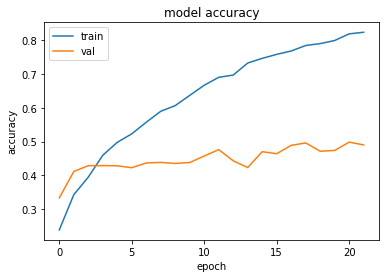

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.669042944908142 , and Val Acc happened to be 0.43689998984336853
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.4984000027179718 and Val Loss happened to be  2.1952898502349854
TestLoss:  1.6365934610366821  TestAcc: 0.4429999887943268
horse 0.635
ship 0.629
dog 0.56
frog 0.544
automobile 0.542
truck 0.455
cat 0.445
airplane 0.281
bird 0.184
deer 0.155


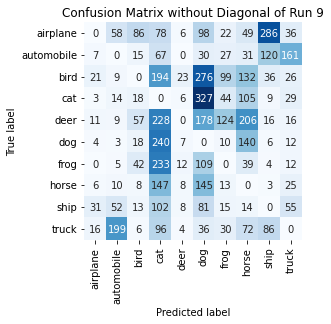

Summing down the rows, for Predictions of each Class that were wrong:  [  99.  359.  263. 1385.   74. 1280.  384.  788.  566.  372.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  23.0 times
Summing across the columns, for total number of that True Class misidentified:  [719. 458. 816. 555. 845. 440. 456. 365. 371. 545.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  228.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10 on Dataset B

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

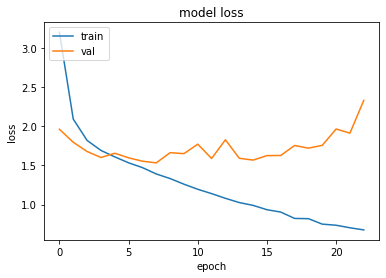

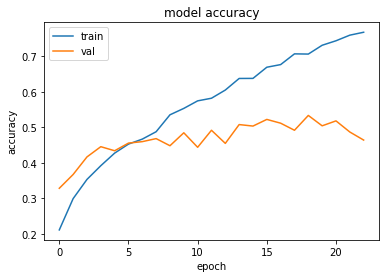

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.5325011014938354 , and Val Acc happened to be 0.4681999981403351
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5333999991416931 and Val Loss happened to be  1.719970703125
TestLoss:  1.5077922344207764  TestAcc: 0.4738999903202057
ship 0.738
horse 0.672
frog 0.653
dog 0.577
automobile 0.548
truck 0.53
airplane 0.423
cat 0.271
deer 0.212
bird 0.115


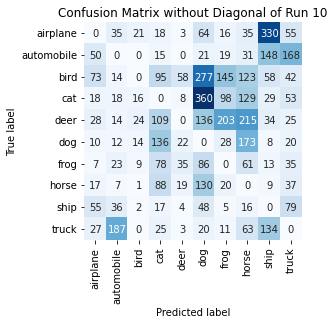

Summing down the rows, for Predictions of each Class that were wrong:  [ 285.  346.   87.  581.  152. 1142.  545.  846.  763.  514.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  58.0 times
Summing across the columns, for total number of that True Class misidentified:  [577. 452. 885. 729. 788. 423. 347. 328. 262. 470.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  215.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11 on Dataset B

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:  

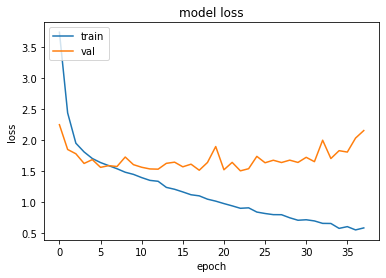

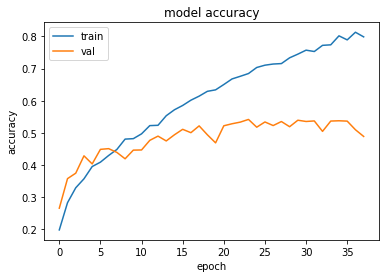

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.5022059679031372 , and Val Acc happened to be 0.53329998254776
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.541700005531311 and Val Loss happened to be  1.5366002321243286
TestLoss:  1.450271725654602  TestAcc: 0.5303000211715698
ship 0.772
truck 0.743
horse 0.675
frog 0.624
automobile 0.497
dog 0.476
deer 0.455
airplane 0.392
cat 0.337
bird 0.332


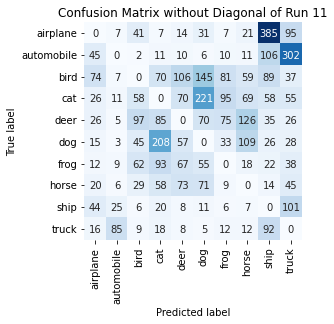

Summing down the rows, for Predictions of each Class that were wrong:  [278. 158. 349. 570. 413. 615. 328. 432. 827. 727.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  106.0 times
Summing across the columns, for total number of that True Class misidentified:  [608. 503. 668. 663. 545. 524. 376. 325. 228. 257.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  126.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12 on Dataset B

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   

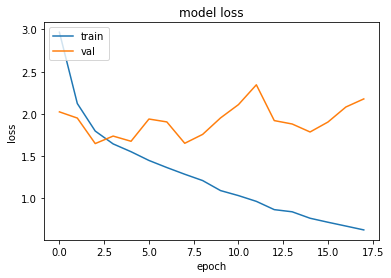

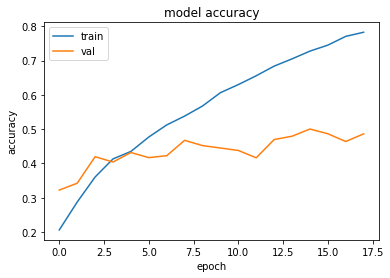

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.6484622955322266 , and Val Acc happened to be 0.4196000099182129
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.5002999901771545 and Val Loss happened to be  1.7858073711395264
TestLoss:  1.63692307472229  TestAcc: 0.42160001397132874
ship 0.661
frog 0.633
horse 0.568
automobile 0.454
truck 0.434
airplane 0.39
dog 0.385
deer 0.271
bird 0.21
cat 0.21


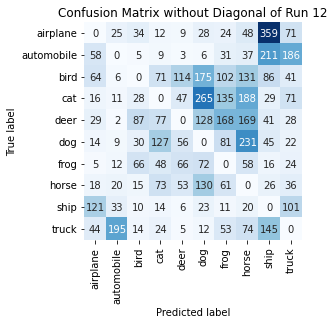

Summing down the rows, for Predictions of each Class that were wrong:  [369. 313. 289. 455. 359. 839. 666. 956. 958. 580.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  114.0 times
Summing across the columns, for total number of that True Class misidentified:  [610. 546. 790. 790. 729. 615. 367. 432. 339. 566.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  169.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13 on Dataset B

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   

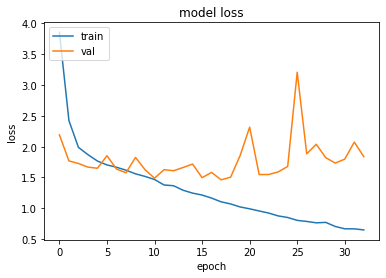

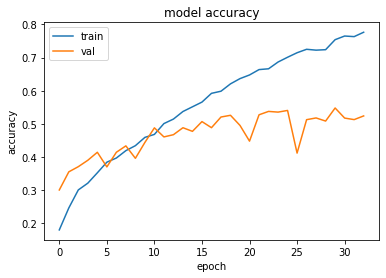

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.4616100788116455 , and Val Acc happened to be 0.520799994468689
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5479999780654907 and Val Loss happened to be  1.7333619594573975
TestLoss:  1.4150371551513672  TestAcc: 0.5311999917030334
frog 0.724
ship 0.71
horse 0.668
truck 0.614
deer 0.587
automobile 0.552
airplane 0.484
dog 0.471
cat 0.291
bird 0.211


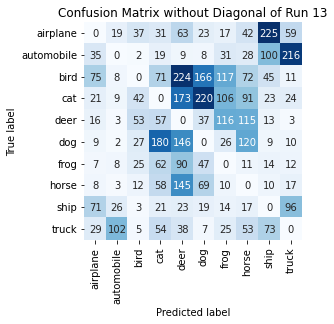

Summing down the rows, for Predictions of each Class that were wrong:  [271. 180. 206. 553. 911. 596. 462. 549. 512. 448.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  224.0 times
Summing across the columns, for total number of that True Class misidentified:  [516. 448. 789. 709. 413. 529. 276. 332. 290. 386.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  116.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14 on Dataset B

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:  

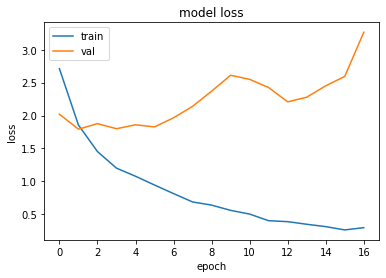

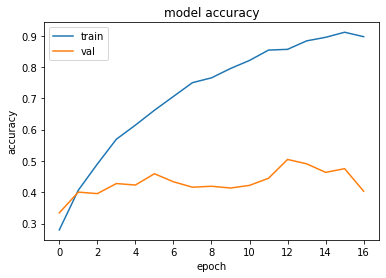

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  1 when  Val Loss was:  1.792725920677185 , and Val Acc happened to be 0.40049999952316284
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.504800021648407 and Val Loss happened to be  2.207871675491333
TestLoss:  1.7782433032989502  TestAcc: 0.39899998903274536
ship 0.755
frog 0.658
horse 0.601
dog 0.535
truck 0.474
automobile 0.463
airplane 0.198
deer 0.134
bird 0.089
cat 0.083


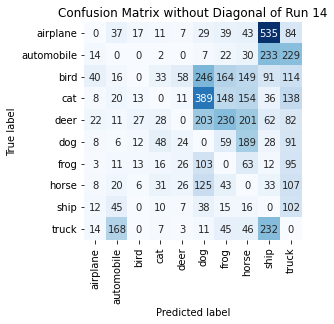

Summing down the rows, for Predictions of each Class that were wrong:  [ 129.  334.   88.  186.  162. 1151.  765.  891. 1262. 1042.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  58.0 times
Summing across the columns, for total number of that True Class misidentified:  [802. 537. 911. 917. 866. 465. 342. 399. 245. 526.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  230.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15 on Dataset B

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 

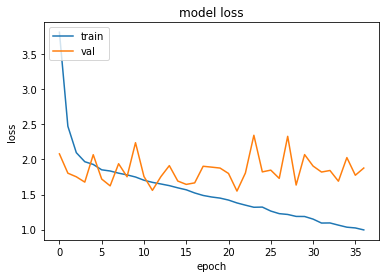

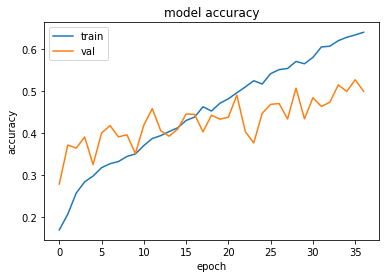

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.5491985082626343 , and Val Acc happened to be 0.4900999963283539
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5266000032424927 and Val Loss happened to be  1.7750244140625
TestLoss:  1.5014008283615112  TestAcc: 0.49390000104904175
dog 0.686
frog 0.686
ship 0.682
horse 0.575
automobile 0.544
airplane 0.527
truck 0.392
cat 0.326
deer 0.3
bird 0.221


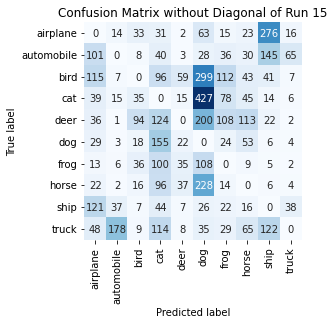

Summing down the rows, for Predictions of each Class that were wrong:  [ 524.  263.  256.  800.  188. 1414.  438.  397.  637.  144.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  59.0 times
Summing across the columns, for total number of that True Class misidentified:  [473. 456. 779. 674. 700. 314. 314. 425. 318. 608.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  200.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16 on Dataset B

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

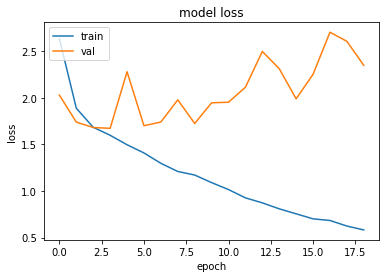

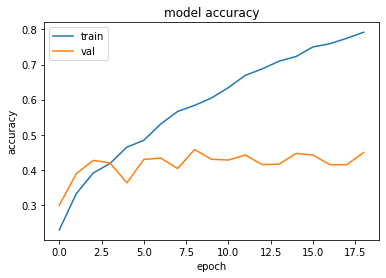

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6716326475143433 , and Val Acc happened to be 0.4196000099182129
Additionally, the best val acc epoch happened to be  8 when val acc was:  0.4578000009059906 and Val Loss happened to be  1.7234177589416504
TestLoss:  1.6525968313217163  TestAcc: 0.41999998688697815
ship 0.788
frog 0.649
horse 0.587
truck 0.569
dog 0.553
airplane 0.32
automobile 0.27
deer 0.188
cat 0.167
bird 0.109


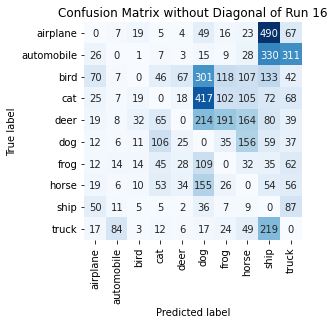

Summing down the rows, for Predictions of each Class that were wrong:  [ 250.  150.  114.  344.  187. 1313.  528.  673. 1472.  769.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  67.0 times
Summing across the columns, for total number of that True Class misidentified:  [680. 730. 891. 833. 812. 447. 351. 413. 212. 431.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  214.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17 on Dataset B

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.

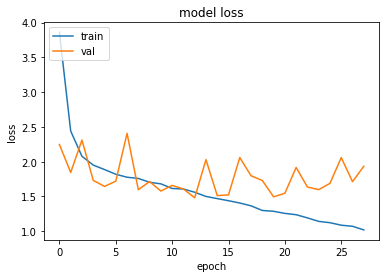

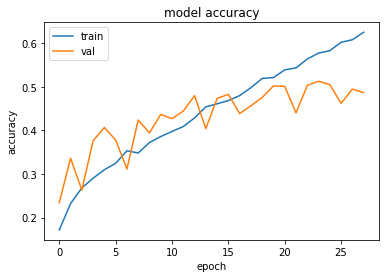

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4800788164138794 , and Val Acc happened to be 0.4796999990940094
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5127999782562256 and Val Loss happened to be  1.598271131515503
TestLoss:  1.4658373594284058  TestAcc: 0.47600001096725464
ship 0.751
dog 0.743
truck 0.705
horse 0.663
frog 0.551
automobile 0.367
airplane 0.353
deer 0.292
bird 0.198
cat 0.137


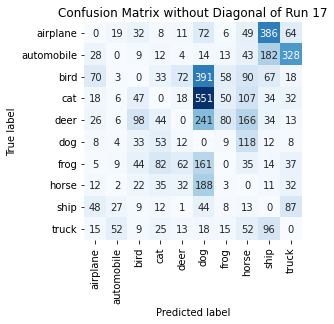

Summing down the rows, for Predictions of each Class that were wrong:  [ 230.  128.  303.  304.  225. 1680.  242.  673.  836.  619.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  72.0 times
Summing across the columns, for total number of that True Class misidentified:  [647. 633. 802. 863. 708. 257. 449. 337. 249. 295.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  241.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18 on Dataset B

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

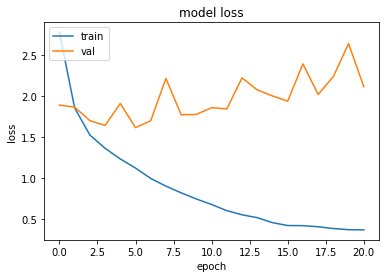

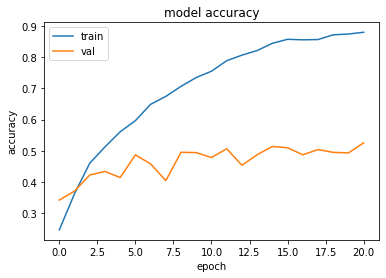

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6137830018997192 , and Val Acc happened to be 0.4869999885559082
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5257999897003174 and Val Loss happened to be  2.1150500774383545
TestLoss:  1.5939984321594238  TestAcc: 0.4823000133037567
frog 0.828
ship 0.735
dog 0.615
airplane 0.537
horse 0.535
truck 0.482
deer 0.378
automobile 0.313
bird 0.283
cat 0.117


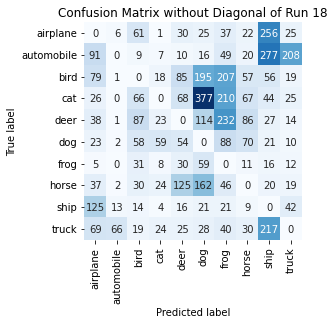

Summing down the rows, for Predictions of each Class that were wrong:  [493.  91. 375. 168. 443. 997. 930. 372. 934. 374.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  125.0 times
Summing across the columns, for total number of that True Class misidentified:  [463. 687. 717. 883. 622. 385. 172. 465. 265. 518.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  232.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19 on Dataset B

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

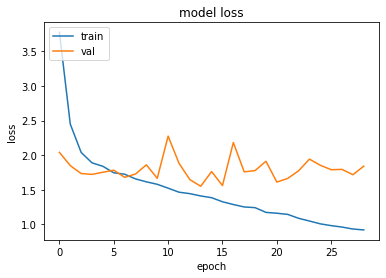

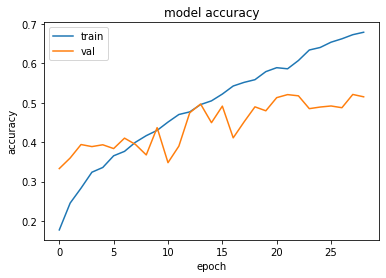

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.5519131422042847 , and Val Acc happened to be 0.4966000020503998
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.520799994468689 and Val Loss happened to be  1.7184005975723267
TestLoss:  1.4998435974121094  TestAcc: 0.5065000057220459
frog 0.837
ship 0.744
horse 0.591
airplane 0.588
automobile 0.583
dog 0.564
truck 0.401
bird 0.334
deer 0.217
cat 0.206


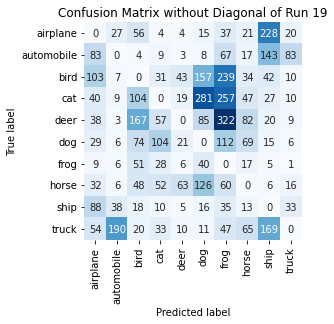

Summing down the rows, for Predictions of each Class that were wrong:  [ 476.  292.  542.  328.  174.  739. 1176.  365.  655.  188.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  63.0 times
Summing across the columns, for total number of that True Class misidentified:  [412. 417. 666. 794. 783. 436. 163. 409. 256. 599.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  322.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20 on Dataset B

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

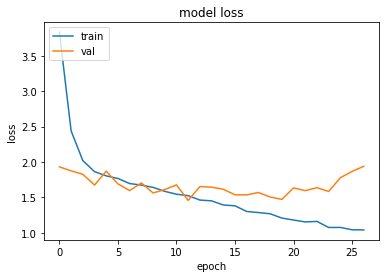

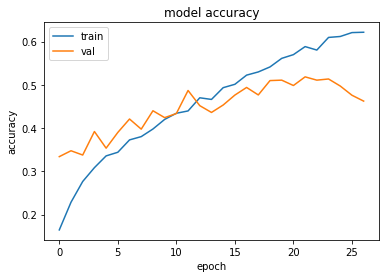

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.458867073059082 , and Val Acc happened to be 0.4869000017642975
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5184000134468079 and Val Loss happened to be  1.5959835052490234
TestLoss:  1.4284828901290894  TestAcc: 0.4876999855041504
frog 0.793
ship 0.693
dog 0.553
horse 0.553
truck 0.54
automobile 0.509
airplane 0.489
deer 0.289
cat 0.24
bird 0.218


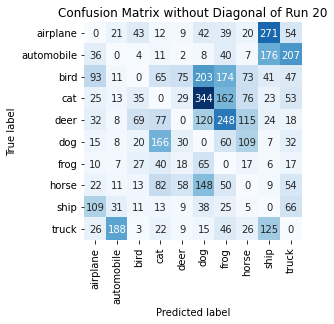

Summing down the rows, for Predictions of each Class that were wrong:  [368. 298. 225. 488. 239. 983. 844. 448. 682. 548.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  75.0 times
Summing across the columns, for total number of that True Class misidentified:  [511. 491. 782. 760. 711. 447. 207. 447. 307. 460.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  248.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21 on Dataset B

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn

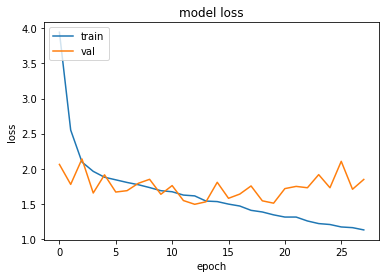

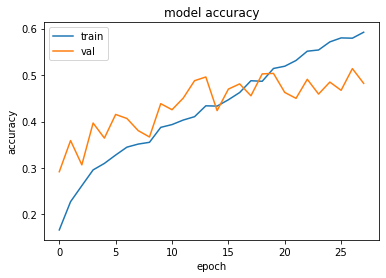

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4921115636825562 , and Val Acc happened to be 0.4878999888896942
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5138999819755554 and Val Loss happened to be  1.7064505815505981
TestLoss:  1.4770069122314453  TestAcc: 0.4860999882221222
ship 0.814
horse 0.699
frog 0.653
automobile 0.547
dog 0.529
truck 0.423
deer 0.382
airplane 0.357
bird 0.24
cat 0.217


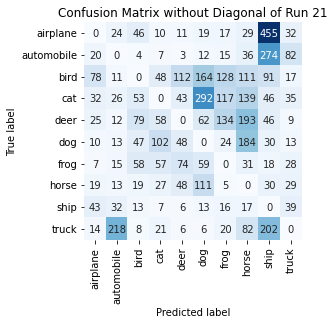

Summing down the rows, for Predictions of each Class that were wrong:  [ 248.  364.  327.  337.  351.  738.  476.  822. 1192.  284.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [643. 453. 760. 783. 618. 471. 347. 301. 186. 577.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  193.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22 on Dataset B

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   

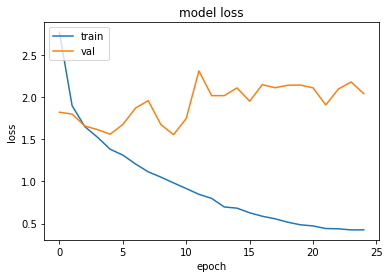

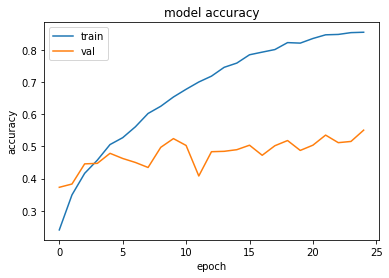

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.5543606281280518 , and Val Acc happened to be 0.5241000056266785
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5504000186920166 and Val Loss happened to be  2.0407252311706543
TestLoss:  1.533083438873291  TestAcc: 0.5205000042915344
ship 0.807
frog 0.795
truck 0.676
automobile 0.574
horse 0.564
dog 0.544
airplane 0.378
deer 0.33
cat 0.279
bird 0.258


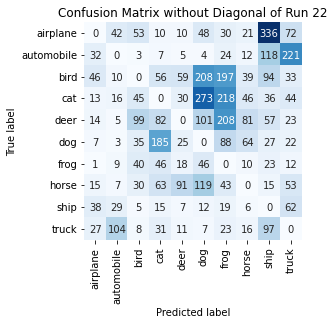

Summing down the rows, for Predictions of each Class that were wrong:  [193. 225. 318. 495. 256. 818. 850. 295. 803. 542.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  91.0 times
Summing across the columns, for total number of that True Class misidentified:  [622. 426. 742. 721. 670. 456. 205. 436. 193. 324.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  208.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23 on Dataset B

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.

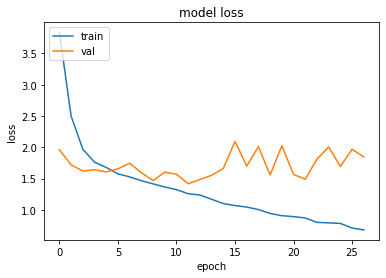

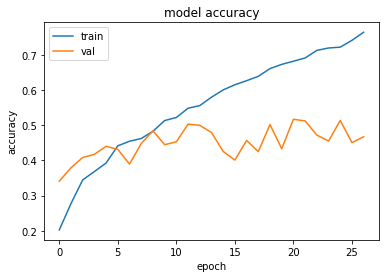

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.4172236919403076 , and Val Acc happened to be 0.5031999945640564
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5170000195503235 and Val Loss happened to be  1.5660686492919922
TestLoss:  1.3774757385253906  TestAcc: 0.5080999732017517
ship 0.801
truck 0.664
deer 0.661
frog 0.648
horse 0.63
dog 0.564
automobile 0.43
airplane 0.356
cat 0.197
bird 0.13


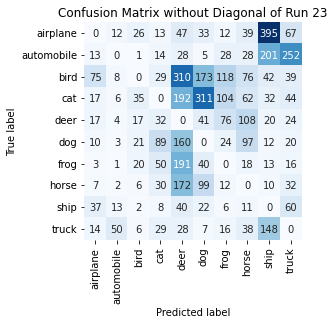

Summing down the rows, for Predictions of each Class that were wrong:  [ 193.   99.  134.  294. 1168.  731.  396.  477.  873.  554.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  310.0 times
Summing across the columns, for total number of that True Class misidentified:  [644. 570. 870. 803. 339. 436. 352. 370. 199. 336.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  108.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24 on Dataset B

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

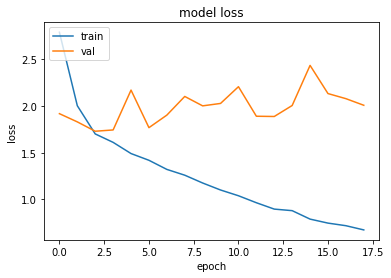

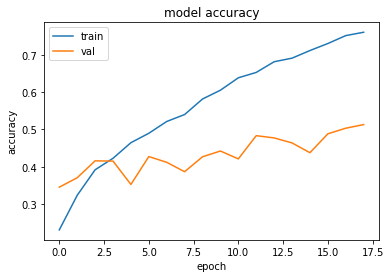

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7298519611358643 , and Val Acc happened to be 0.415800005197525
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5128999948501587 and Val Loss happened to be  2.0078983306884766
TestLoss:  1.7154613733291626  TestAcc: 0.4156999886035919
ship 0.703
frog 0.654
horse 0.599
dog 0.54
truck 0.493
automobile 0.369
airplane 0.332
deer 0.181
cat 0.144
bird 0.142


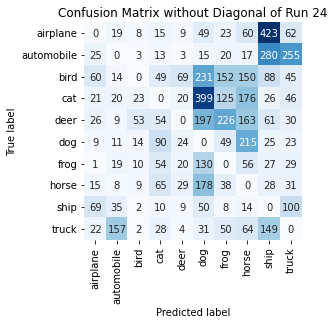

Summing down the rows, for Predictions of each Class that were wrong:  [ 248.  292.  124.  378.  187. 1280.  691.  915. 1107.  621.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  69.0 times
Summing across the columns, for total number of that True Class misidentified:  [668. 631. 858. 856. 819. 460. 346. 401. 297. 507.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  226.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25 on Dataset B

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0

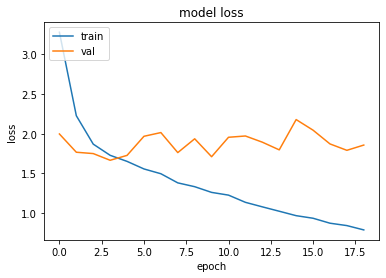

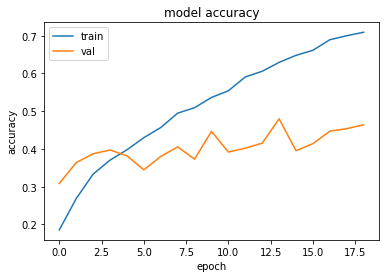

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6647487878799438 , and Val Acc happened to be 0.39730000495910645
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.4799000024795532 and Val Loss happened to be  1.7959505319595337
TestLoss:  1.641996145248413  TestAcc: 0.4059000015258789
dog 0.738
truck 0.646
frog 0.58
horse 0.565
ship 0.521
airplane 0.383
automobile 0.286
deer 0.165
bird 0.107
cat 0.068


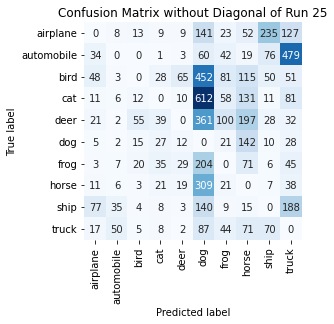

Summing down the rows, for Predictions of each Class that were wrong:  [ 227.  119.  127.  176.  152. 2366.  399.  813.  493. 1069.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  65.0 times
Summing across the columns, for total number of that True Class misidentified:  [617. 714. 893. 932. 835. 262. 420. 435. 479. 354.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  361.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26 on Dataset B

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0

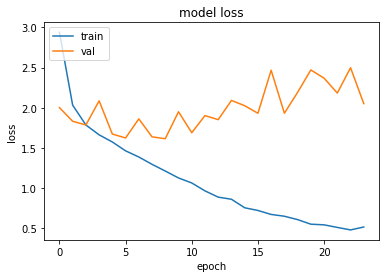

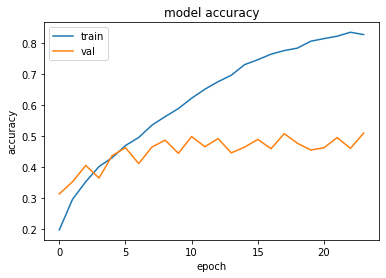

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.6152844429016113 , and Val Acc happened to be 0.48660001158714294
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5095000267028809 and Val Loss happened to be  2.0517232418060303
TestLoss:  1.5796664953231812  TestAcc: 0.4853000044822693
frog 0.839
automobile 0.659
ship 0.647
dog 0.59
horse 0.575
truck 0.532
airplane 0.421
cat 0.206
bird 0.194
deer 0.19


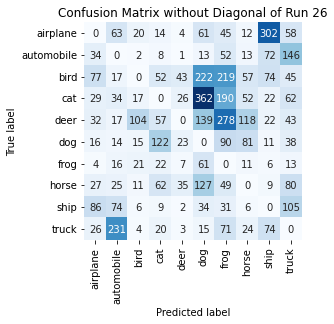

Summing down the rows, for Predictions of each Class that were wrong:  [ 331.  491.  200.  366.  144. 1034. 1025.  374.  592.  590.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  43.0 times
Summing across the columns, for total number of that True Class misidentified:  [579. 341. 806. 794. 810. 410. 161. 425. 353. 468.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  278.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27 on Dataset B

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

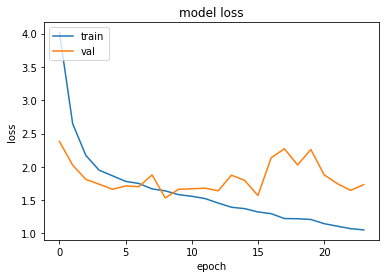

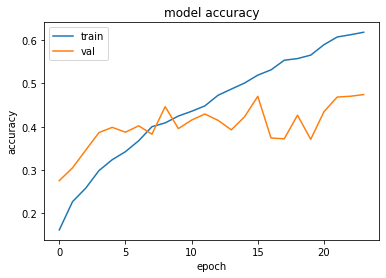

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.533092975616455 , and Val Acc happened to be 0.44620001316070557
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.4740999937057495 and Val Loss happened to be  1.7333813905715942
TestLoss:  1.5206561088562012  TestAcc: 0.4424000084400177
frog 0.688
ship 0.679
horse 0.638
automobile 0.538
dog 0.517
truck 0.467
airplane 0.341
bird 0.268
cat 0.208
deer 0.08


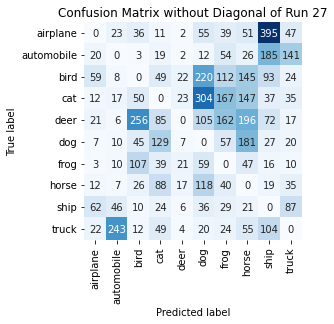

Summing down the rows, for Predictions of each Class that were wrong:  [218. 370. 545. 493. 104. 929. 684. 869. 948. 416.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  23.0 times
Summing across the columns, for total number of that True Class misidentified:  [659. 462. 732. 792. 920. 483. 312. 362. 321. 533.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  256.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28 on Dataset B

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 

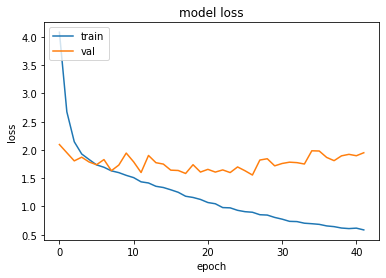

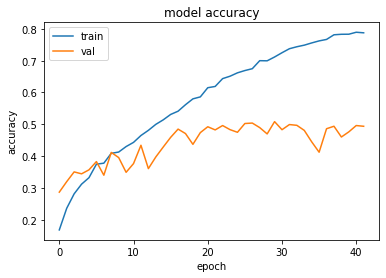

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.55600905418396 , and Val Acc happened to be 0.5038999915122986
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.508400022983551 and Val Loss happened to be  1.7184927463531494
TestLoss:  1.4723132848739624  TestAcc: 0.5210999846458435
truck 0.707
ship 0.661
frog 0.595
dog 0.569
horse 0.566
automobile 0.561
deer 0.513
airplane 0.445
bird 0.328
cat 0.266


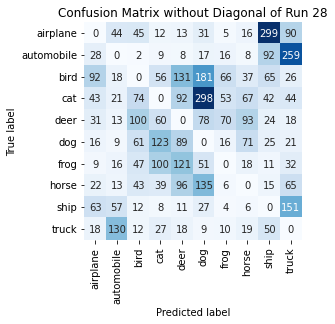

Summing down the rows, for Predictions of each Class that were wrong:  [322. 321. 396. 434. 579. 827. 246. 335. 623. 706.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  131.0 times
Summing across the columns, for total number of that True Class misidentified:  [555. 439. 672. 734. 487. 431. 405. 434. 339. 293.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  100.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29 on Dataset B

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

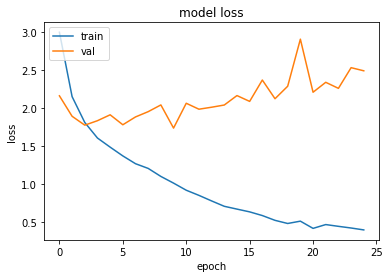

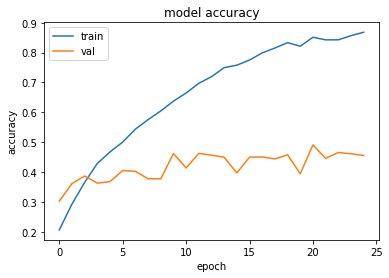

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.736739993095398 , and Val Acc happened to be 0.46209999918937683
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.49079999327659607 and Val Loss happened to be  2.2086706161499023
TestLoss:  1.7039976119995117  TestAcc: 0.4713999927043915
ship 0.782
frog 0.689
automobile 0.638
dog 0.601
horse 0.578
airplane 0.426
truck 0.416
deer 0.256
cat 0.168
bird 0.16


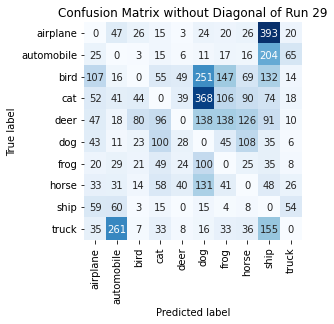

Summing down the rows, for Predictions of each Class that were wrong:  [ 421.  514.  221.  436.  197. 1054.  551.  504. 1167.  221.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  49.0 times
Summing across the columns, for total number of that True Class misidentified:  [574. 362. 840. 832. 744. 399. 311. 422. 218. 584.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  138.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30 on Dataset B

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

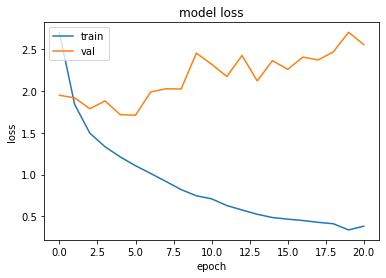

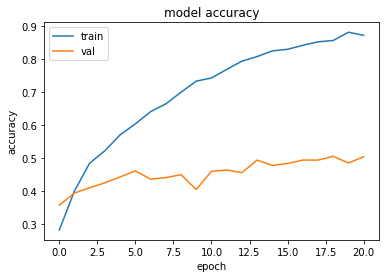

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.7090327739715576 , and Val Acc happened to be 0.4611999988555908
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5054000020027161 and Val Loss happened to be  2.4645087718963623
TestLoss:  1.6705913543701172  TestAcc: 0.4650999903678894
horse 0.683
frog 0.619
dog 0.599
truck 0.587
ship 0.55
automobile 0.497
airplane 0.414
cat 0.275
bird 0.224
deer 0.203


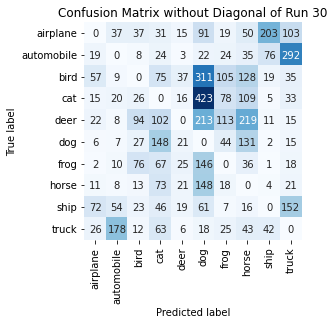

Summing down the rows, for Predictions of each Class that were wrong:  [ 230.  331.  316.  629.  163. 1433.  433.  767.  363.  684.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  37.0 times
Summing across the columns, for total number of that True Class misidentified:  [586. 503. 776. 725. 797. 401. 381. 317. 450. 413.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  219.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31 on Dataset B

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -

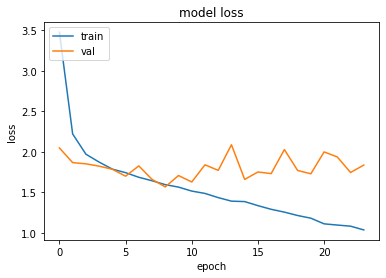

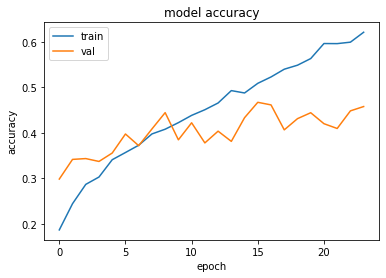

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.5683352947235107 , and Val Acc happened to be 0.44440001249313354
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.46709999442100525 and Val Loss happened to be  1.752343773841858
TestLoss:  1.5207723379135132  TestAcc: 0.4487999975681305
frog 0.697
truck 0.691
dog 0.576
horse 0.533
ship 0.524
airplane 0.515
automobile 0.421
cat 0.249
deer 0.179
bird 0.103


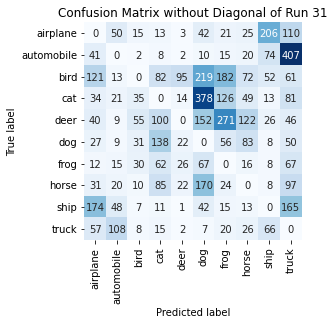

Summing down the rows, for Predictions of each Class that were wrong:  [ 537.  293.  193.  514.  187. 1087.  730.  426.  461. 1084.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  95.0 times
Summing across the columns, for total number of that True Class misidentified:  [485. 579. 897. 751. 821. 424. 303. 467. 476. 309.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  271.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32 on Dataset B

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

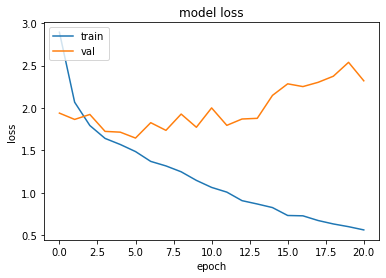

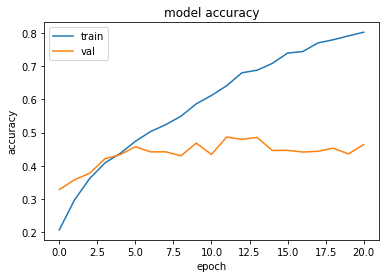

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6463968753814697 , and Val Acc happened to be 0.45739999413490295
Additionally, the best val acc epoch happened to be  11 when val acc was:  0.48660001158714294 and Val Loss happened to be  1.7960559129714966
TestLoss:  1.627333641052246  TestAcc: 0.45890000462532043
frog 0.672
ship 0.668
dog 0.638
horse 0.574
airplane 0.507
truck 0.464
automobile 0.361
bird 0.325
deer 0.322
cat 0.058


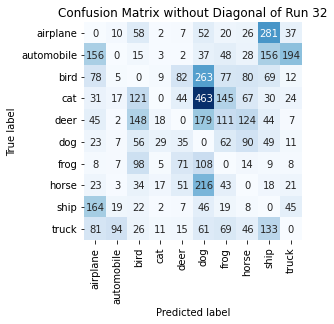

Summing down the rows, for Predictions of each Class that were wrong:  [ 609.  164.  578.   96.  314. 1425.  594.  483.  789.  359.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  82.0 times
Summing across the columns, for total number of that True Class misidentified:  [493. 639. 675. 942. 678. 362. 328. 426. 332. 536.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  179.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33 on Dataset B

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

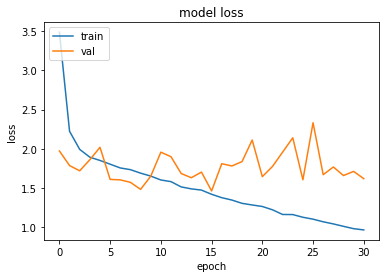

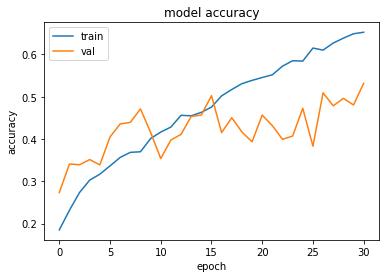

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.46147620677948 , and Val Acc happened to be 0.5026999711990356
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5317999720573425 and Val Loss happened to be  1.618226408958435
TestLoss:  1.437578558921814  TestAcc: 0.49399998784065247
ship 0.771
frog 0.752
automobile 0.699
horse 0.61
dog 0.541
truck 0.467
cat 0.36
deer 0.348
airplane 0.265
bird 0.127


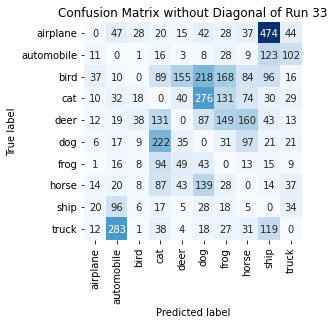

Summing down the rows, for Predictions of each Class that were wrong:  [123. 540. 117. 714. 349. 859. 608. 510. 935. 305.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  155.0 times
Summing across the columns, for total number of that True Class misidentified:  [735. 301. 873. 640. 652. 459. 248. 390. 229. 533.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  160.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34 on Dataset B

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 

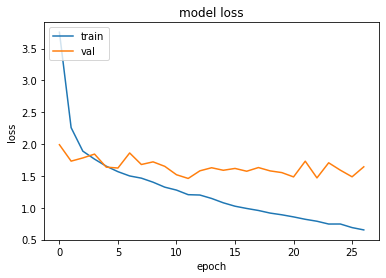

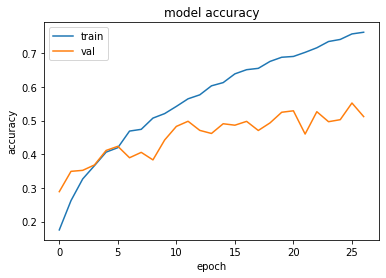

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.4600132703781128 , and Val Acc happened to be 0.498199999332428
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5525000095367432 and Val Loss happened to be  1.4859873056411743
TestLoss:  1.4379334449768066  TestAcc: 0.49079999327659607
ship 0.817
frog 0.651
horse 0.629
truck 0.619
dog 0.614
automobile 0.557
airplane 0.309
cat 0.302
bird 0.264
deer 0.146


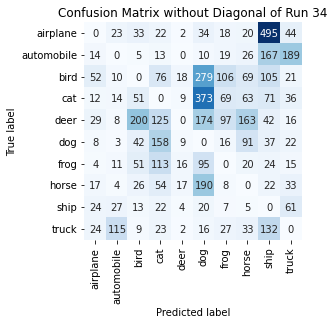

Summing down the rows, for Predictions of each Class that were wrong:  [ 184.  215.  430.  606.   77. 1191.  367.  490. 1095.  437.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  18.0 times
Summing across the columns, for total number of that True Class misidentified:  [691. 443. 736. 698. 854. 386. 349. 371. 183. 381.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  200.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35 on Dataset B

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

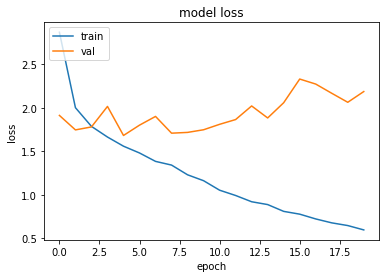

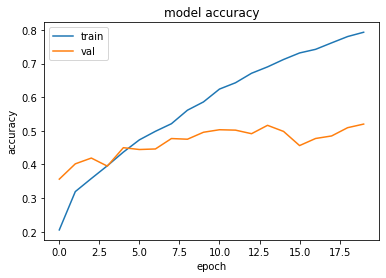

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6809580326080322 , and Val Acc happened to be 0.4496999979019165
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5199000239372253 and Val Loss happened to be  2.18601393699646
TestLoss:  1.6610386371612549  TestAcc: 0.4481000006198883
ship 0.79
frog 0.753
automobile 0.58
horse 0.561
truck 0.556
dog 0.452
airplane 0.307
cat 0.193
deer 0.187
bird 0.102


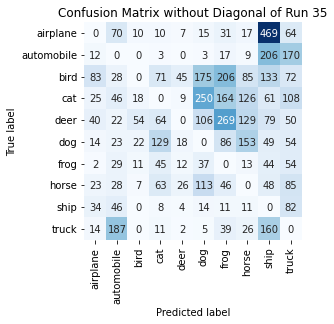

Summing down the rows, for Predictions of each Class that were wrong:  [ 247.  479.  122.  404.  123.  718.  869.  569. 1249.  739.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  45.0 times
Summing across the columns, for total number of that True Class misidentified:  [693. 420. 898. 807. 813. 548. 247. 439. 210. 444.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  269.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36 on Dataset B

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

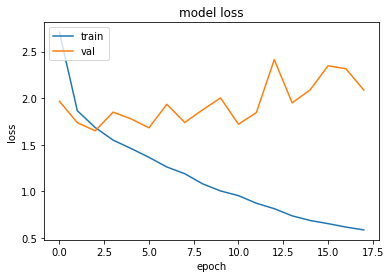

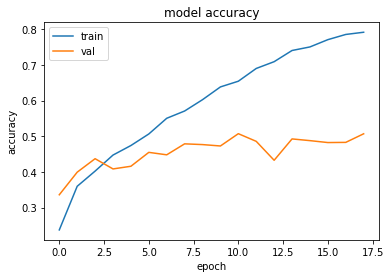

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.6486339569091797 , and Val Acc happened to be 0.43700000643730164
Additionally, the best val acc epoch happened to be  10 when val acc was:  0.5072000026702881 and Val Loss happened to be  1.7195806503295898
TestLoss:  1.6182533502578735  TestAcc: 0.4341000020503998
frog 0.759
ship 0.716
dog 0.566
horse 0.48
automobile 0.474
truck 0.473
airplane 0.348
deer 0.288
bird 0.132
cat 0.105


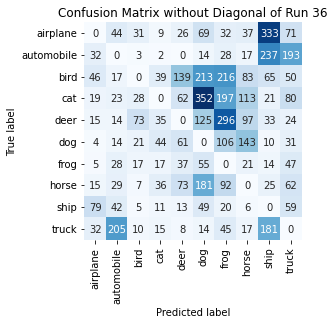

Summing down the rows, for Predictions of each Class that were wrong:  [ 247.  416.  195.  208.  419. 1072. 1032.  534.  919.  617.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [652. 526. 868. 895. 712. 434. 241. 520. 284. 527.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  296.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37 on Dataset B

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0

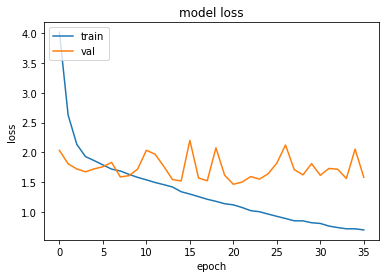

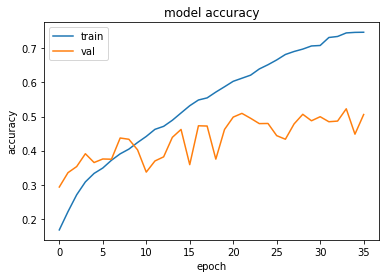

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.4636656045913696 , and Val Acc happened to be 0.4982999861240387
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.522599995136261 and Val Loss happened to be  1.5607233047485352
TestLoss:  1.4309500455856323  TestAcc: 0.5040000081062317
truck 0.672
ship 0.667
automobile 0.625
horse 0.604
frog 0.526
deer 0.51
dog 0.464
airplane 0.415
bird 0.284
cat 0.273


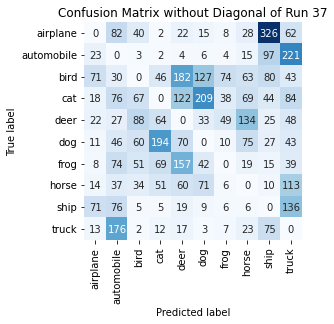

Summing down the rows, for Predictions of each Class that were wrong:  [251. 624. 350. 445. 653. 515. 202. 432. 699. 789.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  182.0 times
Summing across the columns, for total number of that True Class misidentified:  [585. 375. 716. 727. 490. 536. 474. 396. 333. 328.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  134.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38 on Dataset B

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

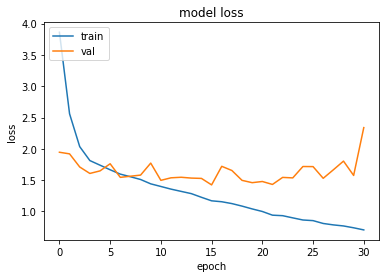

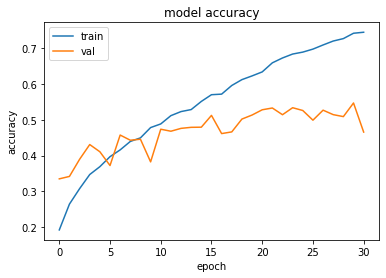

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.4233691692352295 , and Val Acc happened to be 0.5123000144958496
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.546999990940094 and Val Loss happened to be  1.5742602348327637
TestLoss:  1.390102505683899  TestAcc: 0.513700008392334
ship 0.796
dog 0.716
frog 0.713
truck 0.639
horse 0.609
automobile 0.513
airplane 0.4
deer 0.324
cat 0.264
bird 0.163


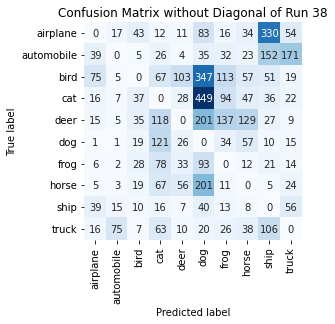

Summing down the rows, for Predictions of each Class that were wrong:  [ 212.  130.  203.  568.  278. 1469.  476.  405.  738.  384.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  103.0 times
Summing across the columns, for total number of that True Class misidentified:  [600. 487. 837. 736. 676. 284. 287. 391. 204. 361.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  201.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39 on Dataset B

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

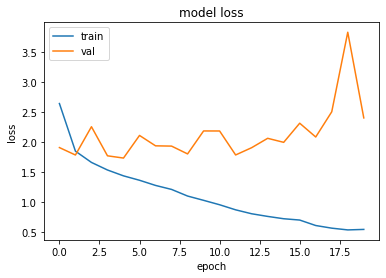

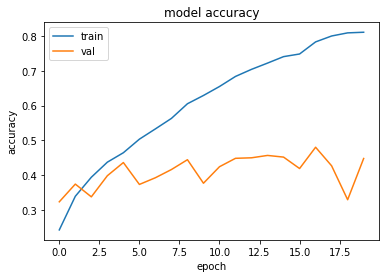

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.7311928272247314 , and Val Acc happened to be 0.4359000027179718
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.47999998927116394 and Val Loss happened to be  2.0830109119415283
TestLoss:  1.6988002061843872  TestAcc: 0.43389999866485596
ship 0.807
dog 0.606
frog 0.583
horse 0.559
automobile 0.476
airplane 0.399
truck 0.37
bird 0.259
deer 0.161
cat 0.119


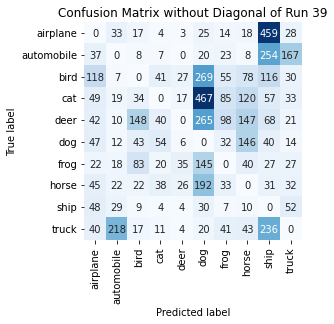

Summing down the rows, for Predictions of each Class that were wrong:  [ 448.  368.  381.  219.  122. 1433.  388.  610. 1288.  404.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  35.0 times
Summing across the columns, for total number of that True Class misidentified:  [601. 524. 741. 881. 839. 394. 417. 441. 193. 630.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  265.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40 on Dataset B

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomI

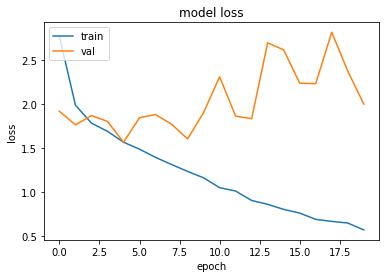

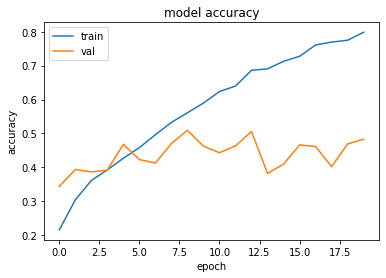

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5690668821334839 , and Val Acc happened to be 0.46790000796318054
Additionally, the best val acc epoch happened to be  8 when val acc was:  0.5091999769210815 and Val Loss happened to be  1.606886863708496
TestLoss:  1.5331159830093384  TestAcc: 0.4681999981403351
ship 0.775
frog 0.671
horse 0.582
dog 0.539
automobile 0.501
truck 0.5
airplane 0.317
deer 0.288
bird 0.276
cat 0.233


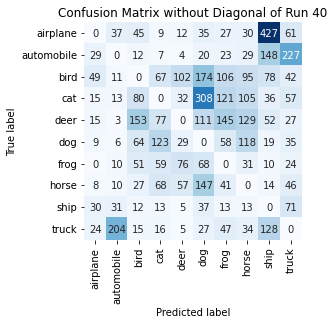

Summing down the rows, for Predictions of each Class that were wrong:  [179. 325. 459. 439. 322. 927. 581. 584. 912. 590.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  102.0 times
Summing across the columns, for total number of that True Class misidentified:  [683. 499. 724. 767. 712. 461. 329. 418. 225. 500.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  153.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41 on Dataset B

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

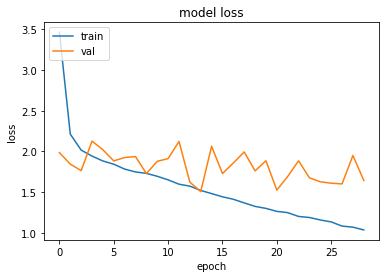

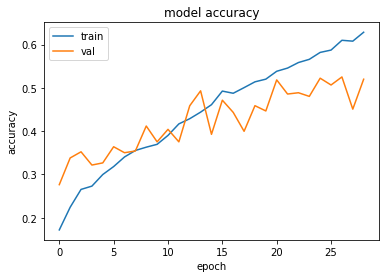

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.5076041221618652 , and Val Acc happened to be 0.49320000410079956
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5253000259399414 and Val Loss happened to be  1.6022988557815552
TestLoss:  1.472289800643921  TestAcc: 0.4921000003814697
ship 0.795
frog 0.777
dog 0.692
truck 0.586
horse 0.534
automobile 0.504
airplane 0.426
bird 0.29
deer 0.21
cat 0.107


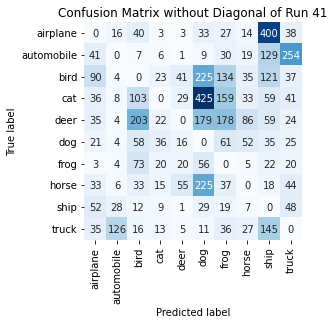

Summing down the rows, for Predictions of each Class that were wrong:  [ 346.  200.  545.  147.  171. 1192.  681.  278.  988.  531.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  55.0 times
Summing across the columns, for total number of that True Class misidentified:  [574. 496. 710. 893. 790. 308. 223. 466. 205. 414.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  203.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42 on Dataset B

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0

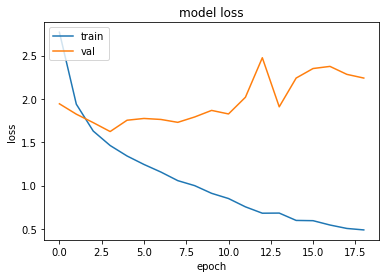

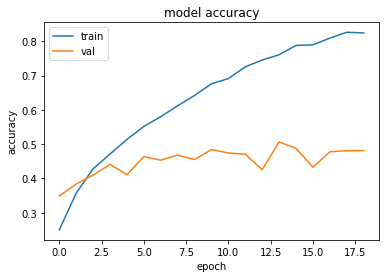

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6232575178146362 , and Val Acc happened to be 0.4410000145435333
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.5063999891281128 and Val Loss happened to be  1.9086843729019165
TestLoss:  1.5917621850967407  TestAcc: 0.4413999915122986
ship 0.738
horse 0.644
dog 0.589
frog 0.579
automobile 0.537
truck 0.472
deer 0.278
airplane 0.274
cat 0.168
bird 0.135


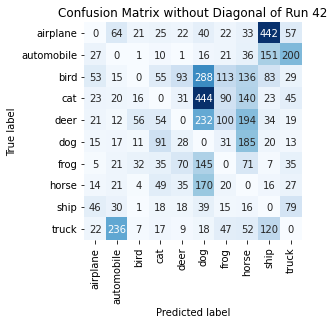

Summing down the rows, for Predictions of each Class that were wrong:  [ 226.  436.  149.  354.  307. 1392.  459.  863.  896.  504.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  93.0 times
Summing across the columns, for total number of that True Class misidentified:  [726. 463. 865. 832. 722. 411. 421. 356. 262. 528.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  232.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43 on Dataset B

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0

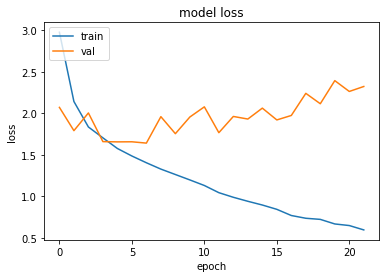

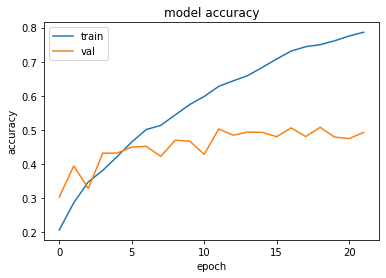

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.6398210525512695 , and Val Acc happened to be 0.45210000872612
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5078999996185303 and Val Loss happened to be  2.11427640914917
TestLoss:  1.6120719909667969  TestAcc: 0.4474000036716461
ship 0.655
frog 0.614
dog 0.599
horse 0.574
automobile 0.54
airplane 0.487
truck 0.329
cat 0.301
bird 0.237
deer 0.138


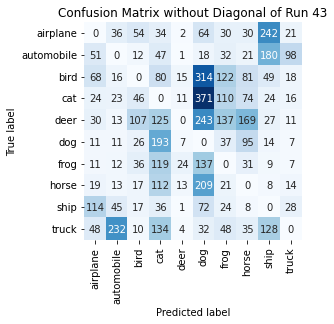

Summing down the rows, for Predictions of each Class that were wrong:  [ 376.  401.  325.  880.   78. 1460.  561.  544.  681.  220.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  24.0 times
Summing across the columns, for total number of that True Class misidentified:  [513. 460. 763. 699. 862. 401. 386. 426. 345. 671.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  243.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44 on Dataset B

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

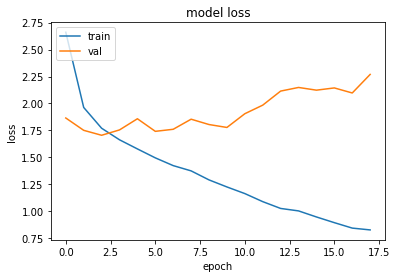

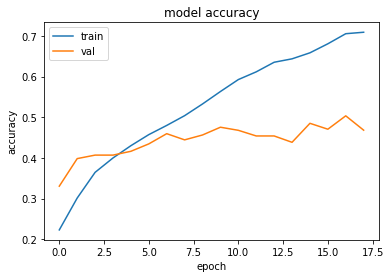

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7049572467803955 , and Val Acc happened to be 0.4068000018596649
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5034000277519226 and Val Loss happened to be  2.097360134124756
TestLoss:  1.6797515153884888  TestAcc: 0.4133000075817108
ship 0.788
dog 0.619
horse 0.596
frog 0.567
truck 0.482
automobile 0.383
airplane 0.26
cat 0.19
deer 0.133
bird 0.115


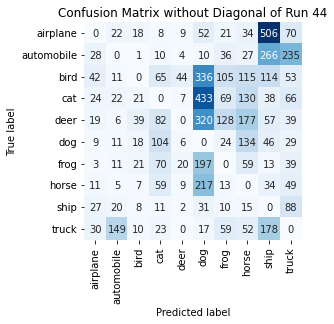

Summing down the rows, for Predictions of each Class that were wrong:  [ 193.  257.  143.  432.  101. 1613.  465.  743. 1252.  668.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  44.0 times
Summing across the columns, for total number of that True Class misidentified:  [740. 617. 885. 810. 867. 381. 433. 404. 212. 518.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  320.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45 on Dataset B

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

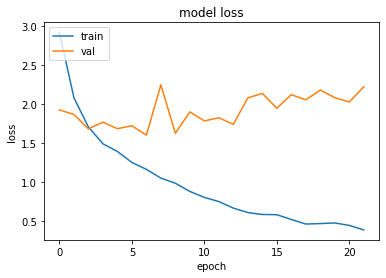

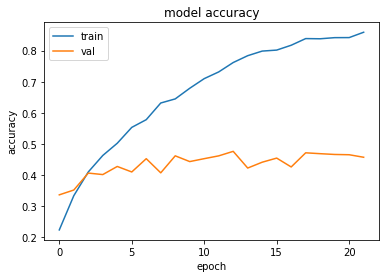

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.5983591079711914 , and Val Acc happened to be 0.45249998569488525
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.47609999775886536 and Val Loss happened to be  1.7370033264160156
TestLoss:  1.5758758783340454  TestAcc: 0.45249998569488525
frog 0.722
dog 0.598
horse 0.597
ship 0.556
truck 0.482
airplane 0.469
automobile 0.454
cat 0.287
deer 0.259
bird 0.101


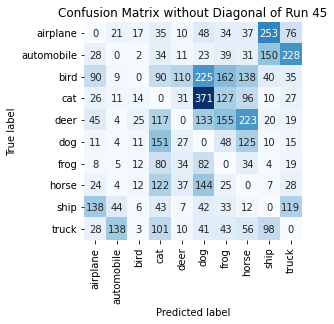

Summing down the rows, for Predictions of each Class that were wrong:  [ 398.  240.  102.  773.  277. 1109.  666.  752.  592.  566.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  110.0 times
Summing across the columns, for total number of that True Class misidentified:  [531. 546. 899. 713. 741. 402. 278. 403. 444. 518.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  223.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46 on Dataset B

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )


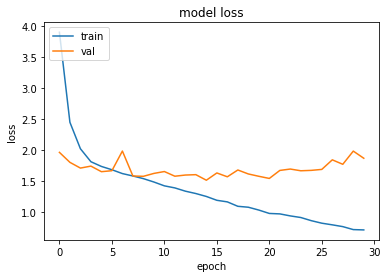

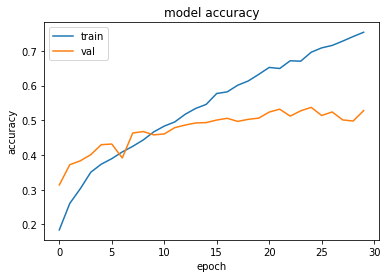

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.5187116861343384 , and Val Acc happened to be 0.4932999908924103
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5371999740600586 and Val Loss happened to be  1.6774810552597046
TestLoss:  1.4626024961471558  TestAcc: 0.49790000915527344
ship 0.742
automobile 0.661
horse 0.606
frog 0.595
dog 0.593
truck 0.57
airplane 0.452
cat 0.428
deer 0.188
bird 0.144


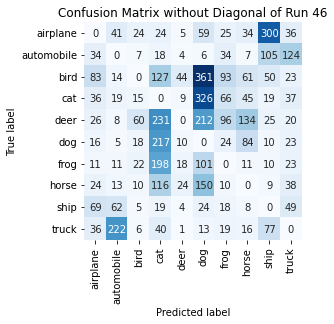

Summing down the rows, for Predictions of each Class that were wrong:  [ 335.  395.  167.  990.  119. 1252.  385.  400.  605.  373.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  44.0 times
Summing across the columns, for total number of that True Class misidentified:  [548. 339. 856. 572. 812. 407. 405. 394. 258. 430.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  231.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47 on Dataset B

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 ,

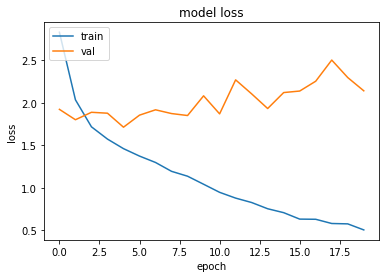

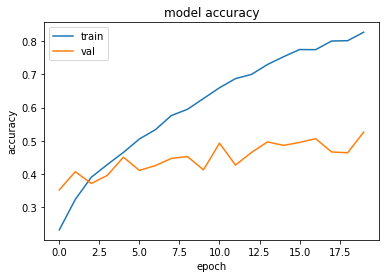

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.7123644351959229 , and Val Acc happened to be 0.45100000500679016
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5263000130653381 and Val Loss happened to be  2.1410841941833496
TestLoss:  1.6770769357681274  TestAcc: 0.45419999957084656
ship 0.865
frog 0.73
horse 0.591
dog 0.578
automobile 0.555
airplane 0.401
truck 0.378
bird 0.212
deer 0.137
cat 0.095


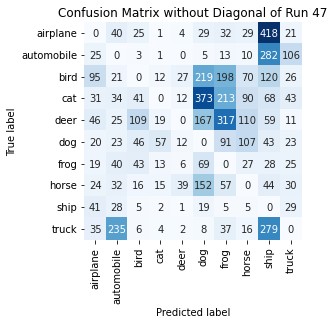

Summing down the rows, for Predictions of each Class that were wrong:  [ 336.  478.  294.  124.  103. 1041.  963.  464. 1341.  314.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  39.0 times
Summing across the columns, for total number of that True Class misidentified:  [599. 445. 788. 905. 863. 422. 270. 409. 135. 622.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  317.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48 on Dataset B

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

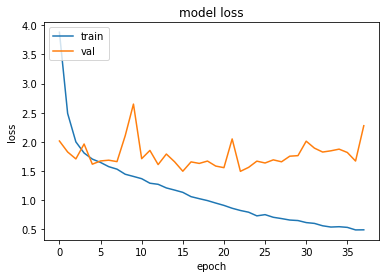

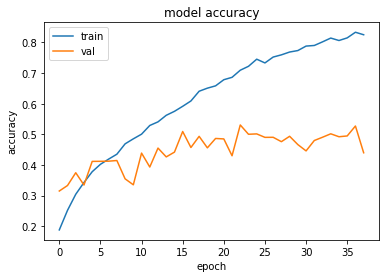

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.4946448802947998 , and Val Acc happened to be 0.5304999947547913
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5304999947547913 and Val Loss happened to be  1.4946448802947998
TestLoss:  1.480023980140686  TestAcc: 0.52920001745224
frog 0.786
truck 0.708
ship 0.655
automobile 0.555
deer 0.511
horse 0.477
dog 0.463
cat 0.421
airplane 0.384
bird 0.332


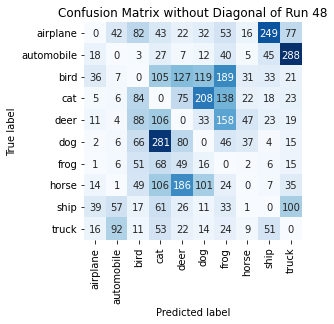

Summing down the rows, for Predictions of each Class that were wrong:  [142. 221. 451. 850. 594. 546. 705. 170. 436. 593.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  186.0 times
Summing across the columns, for total number of that True Class misidentified:  [616. 445. 668. 579. 489. 537. 214. 523. 345. 292.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  158.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49 on Dataset B

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

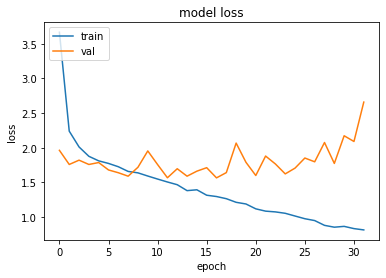

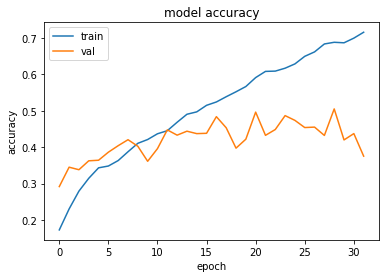

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.5642971992492676 , and Val Acc happened to be 0.4837999939918518
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5051000118255615 and Val Loss happened to be  1.772790789604187
TestLoss:  1.514398455619812  TestAcc: 0.48809999227523804
frog 0.674
dog 0.621
horse 0.585
ship 0.557
truck 0.55
deer 0.501
automobile 0.473
airplane 0.432
cat 0.291
bird 0.197


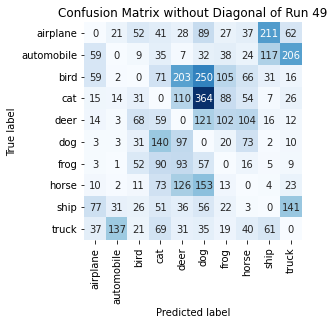

Summing down the rows, for Predictions of each Class that were wrong:  [ 277.  214.  301.  629.  731. 1157.  434.  417.  454.  505.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  203.0 times
Summing across the columns, for total number of that True Class misidentified:  [568. 527. 803. 709. 499. 379. 326. 415. 443. 450.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  121.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50 on Dataset B

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )


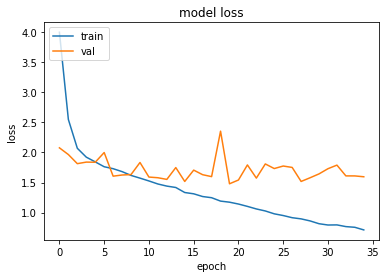

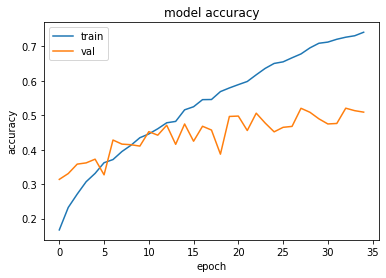

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.4790982007980347 , and Val Acc happened to be 0.4966000020503998
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5206000208854675 and Val Loss happened to be  1.6103389263153076
TestLoss:  1.4640246629714966  TestAcc: 0.4966000020503998
frog 0.725
ship 0.718
automobile 0.593
dog 0.536
truck 0.494
horse 0.484
cat 0.413
deer 0.403
airplane 0.328
bird 0.272


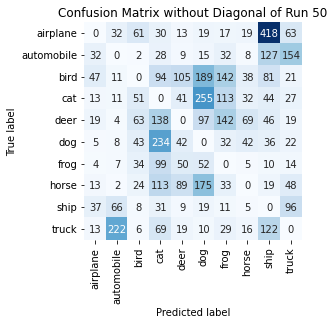

Summing down the rows, for Predictions of each Class that were wrong:  [183. 363. 292. 836. 377. 831. 551. 234. 903. 464.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  105.0 times
Summing across the columns, for total number of that True Class misidentified:  [672. 407. 728. 587. 597. 464. 275. 516. 282. 506.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  142.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 18 November 2021 18:02:56  (subtract ~5-hours for local Hour), and file is called  runs_GroupB_final.pkl


In [77]:
run_through_runs(ds=trainB, ds_noalb=trainB_noalb, dstitle = "B", showpictures=False)

filename will be:  runs_GroupC .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset C

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5


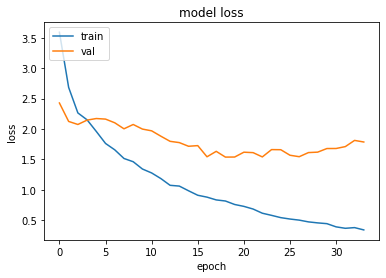

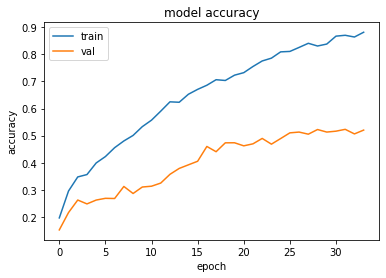

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.5375006198883057 , and Val Acc happened to be 0.47350001335144043
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5232999920845032 and Val Loss happened to be  1.7102279663085938
TestLoss:  1.5111782550811768  TestAcc: 0.4722000062465668
frog 0.842
ship 0.72
automobile 0.639
airplane 0.575
dog 0.497
horse 0.394
bird 0.375
truck 0.316
cat 0.196
deer 0.168


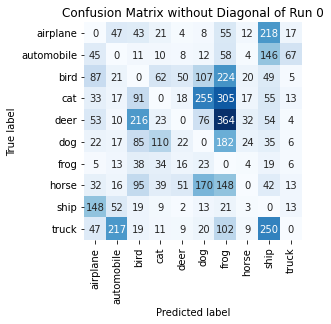

Summing down the rows, for Predictions of each Class that were wrong:  [ 472.  410.  617.  319.  180.  684. 1459.  125.  868.  144.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  51.0 times
Summing across the columns, for total number of that True Class misidentified:  [425. 361. 625. 804. 832. 503. 158. 606. 280. 684.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  364.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1 on Dataset C

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0

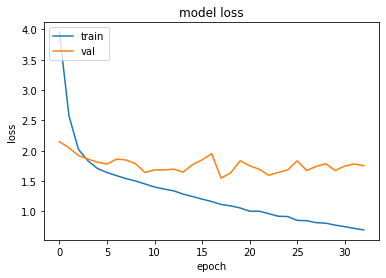

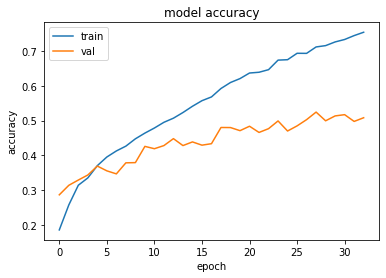

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.5496928691864014 , and Val Acc happened to be 0.48010000586509705
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5242999792098999 and Val Loss happened to be  1.743722677230835
TestLoss:  1.5319461822509766  TestAcc: 0.48100000619888306
dog 0.704
truck 0.67
ship 0.593
automobile 0.592
horse 0.591
frog 0.562
deer 0.392
airplane 0.344
cat 0.189
bird 0.173


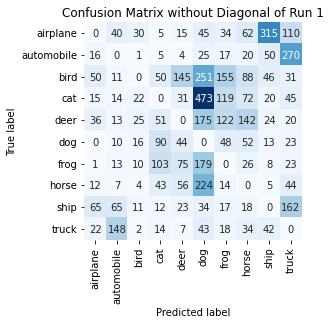

Summing down the rows, for Predictions of each Class that were wrong:  [ 217.  321.  121.  373.  400. 1449.  544.  514.  523.  728.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  145.0 times
Summing across the columns, for total number of that True Class misidentified:  [656. 408. 827. 811. 608. 296. 438. 409. 407. 330.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  175.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2 on Dataset C

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2

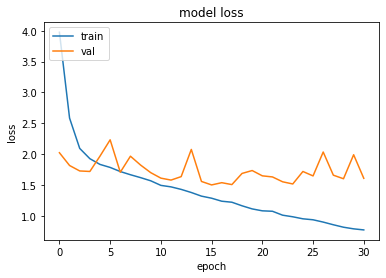

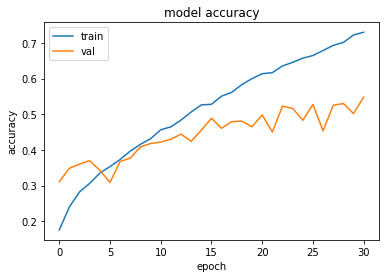

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.5044001340866089 , and Val Acc happened to be 0.4884999990463257
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5478000044822693 and Val Loss happened to be  1.6113195419311523
TestLoss:  1.47752845287323  TestAcc: 0.4878999888896942
frog 0.866
ship 0.684
horse 0.657
truck 0.62
automobile 0.456
airplane 0.446
deer 0.402
dog 0.391
bird 0.214
cat 0.143


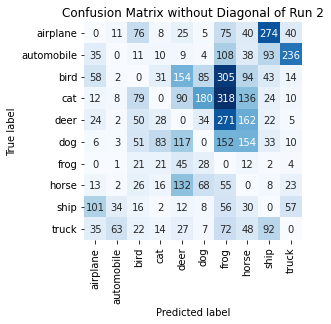

Summing down the rows, for Predictions of each Class that were wrong:  [ 284.  126.  352.  213.  611.  419. 1412.  714.  591.  399.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  154.0 times
Summing across the columns, for total number of that True Class misidentified:  [554. 544. 786. 857. 598. 609. 134. 343. 316. 380.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  271.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3 on Dataset C

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contra

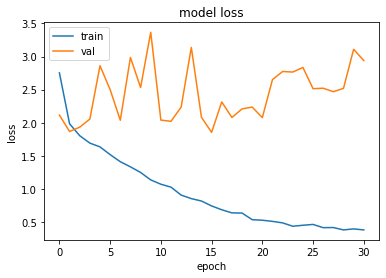

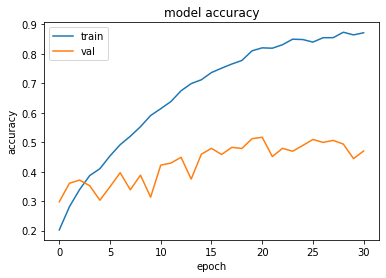

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.85395348072052 , and Val Acc happened to be 0.47940000891685486
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5170999765396118 and Val Loss happened to be  2.0766797065734863
TestLoss:  1.8156853914260864  TestAcc: 0.4903999865055084
frog 0.764
truck 0.744
ship 0.691
dog 0.677
automobile 0.515
horse 0.477
airplane 0.463
cat 0.283
deer 0.161
bird 0.129


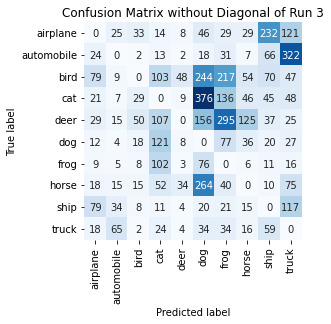

Summing down the rows, for Predictions of each Class that were wrong:  [ 289.  179.  165.  547.  120. 1234.  880.  334.  550.  798.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  48.0 times
Summing across the columns, for total number of that True Class misidentified:  [537. 485. 871. 717. 839. 323. 236. 523. 309. 256.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  295.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4 on Dataset C

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 

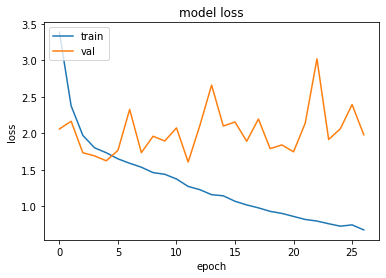

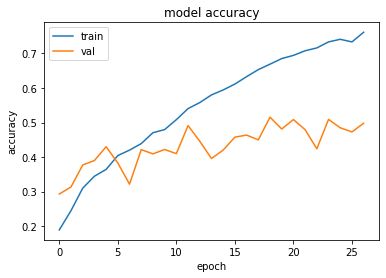

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.604560375213623 , and Val Acc happened to be 0.4912000000476837
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5156000256538391 and Val Loss happened to be  1.7879678010940552
TestLoss:  1.6153794527053833  TestAcc: 0.4819999933242798
truck 0.681
ship 0.646
frog 0.614
automobile 0.534
airplane 0.517
horse 0.484
deer 0.434
dog 0.417
cat 0.34
bird 0.153


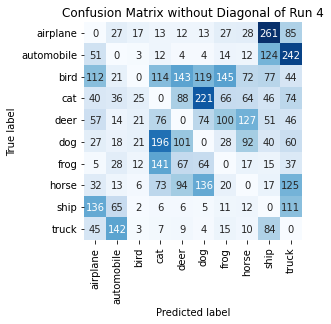

Summing down the rows, for Predictions of each Class that were wrong:  [505. 364. 110. 638. 524. 640. 426. 434. 715. 824.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  143.0 times
Summing across the columns, for total number of that True Class misidentified:  [483. 466. 847. 660. 566. 583. 386. 516. 354. 319.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  127.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5 on Dataset C

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0

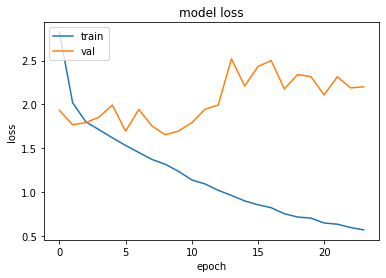

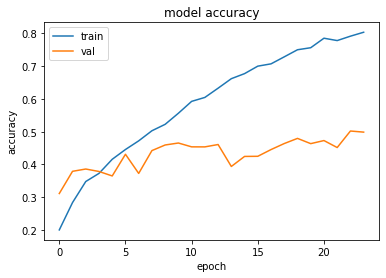

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.6540870666503906 , and Val Acc happened to be 0.4593999981880188
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5019999742507935 and Val Loss happened to be  2.1892268657684326
TestLoss:  1.6429951190948486  TestAcc: 0.45559999346733093
truck 0.734
dog 0.697
ship 0.653
frog 0.612
horse 0.553
deer 0.364
bird 0.28
airplane 0.275
automobile 0.24
cat 0.148


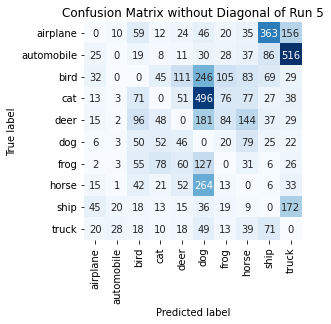

Summing down the rows, for Predictions of each Class that were wrong:  [ 173.   70.  428.  287.  388. 1475.  378.  534.  690. 1021.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  111.0 times
Summing across the columns, for total number of that True Class misidentified:  [725. 760. 720. 852. 636. 303. 388. 447. 347. 266.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  181.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6 on Dataset C

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contras

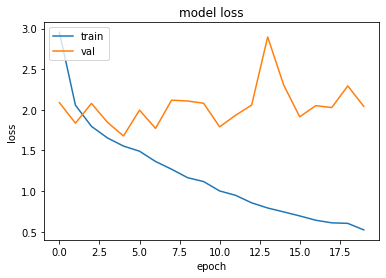

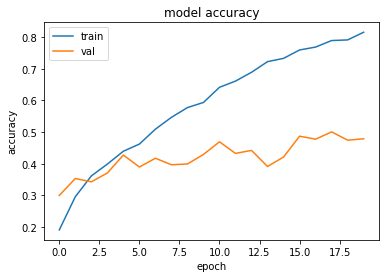

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.678678274154663 , and Val Acc happened to be 0.42750000953674316
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5006999969482422 and Val Loss happened to be  2.0279417037963867
TestLoss:  1.6549216508865356  TestAcc: 0.4372999966144562
ship 0.84
horse 0.654
truck 0.641
dog 0.633
frog 0.567
automobile 0.439
deer 0.241
airplane 0.178
cat 0.117
bird 0.063


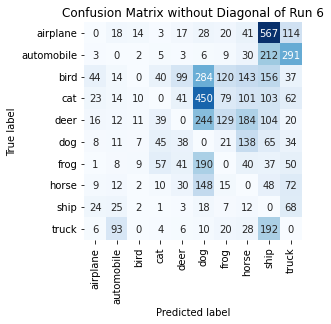

Summing down the rows, for Predictions of each Class that were wrong:  [ 134.  207.   57.  204.  278. 1378.  420.  717. 1484.  748.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  99.0 times
Summing across the columns, for total number of that True Class misidentified:  [822. 561. 937. 883. 759. 367. 433. 346. 160. 359.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  244.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7 on Dataset C

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contra

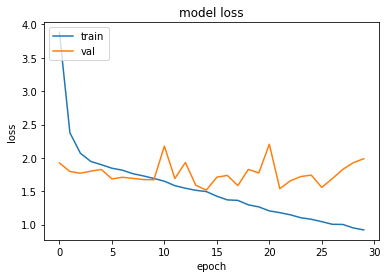

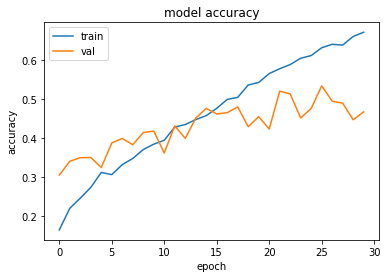

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.5171926021575928 , and Val Acc happened to be 0.4756999909877777
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5332000255584717 and Val Loss happened to be  1.5576648712158203
TestLoss:  1.5076169967651367  TestAcc: 0.4717999994754791
truck 0.756
ship 0.719
dog 0.689
deer 0.624
horse 0.574
frog 0.459
automobile 0.427
airplane 0.263
cat 0.109
bird 0.098


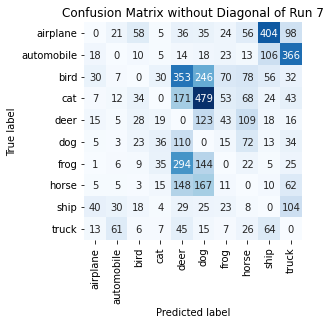

Summing down the rows, for Predictions of each Class that were wrong:  [ 134.  150.  189.  156. 1200. 1252.  269.  452.  700.  780.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  353.0 times
Summing across the columns, for total number of that True Class misidentified:  [737. 573. 902. 891. 376. 311. 541. 426. 281. 244.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  123.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8 on Dataset C

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0

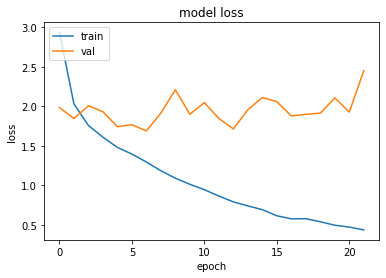

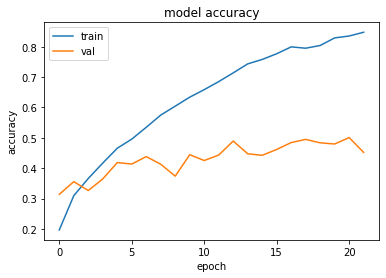

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.691215991973877 , and Val Acc happened to be 0.4383000135421753
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5008999705314636 and Val Loss happened to be  1.9292429685592651
TestLoss:  1.668222427368164  TestAcc: 0.4302999973297119
ship 0.775
dog 0.742
horse 0.67
truck 0.617
frog 0.546
airplane 0.288
deer 0.274
automobile 0.214
bird 0.137
cat 0.04


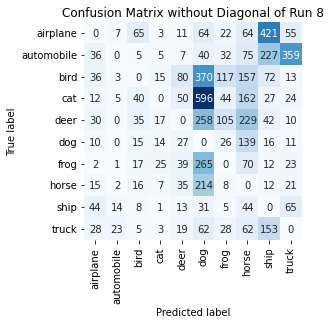

Summing down the rows, for Predictions of each Class that were wrong:  [ 213.   55.  206.   90.  281. 1900.  387. 1002.  982.  581.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  80.0 times
Summing across the columns, for total number of that True Class misidentified:  [712. 786. 863. 960. 726. 258. 454. 330. 225. 383.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  258.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9 on Dataset C

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0

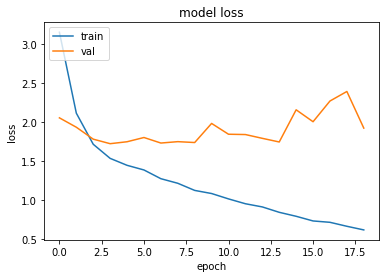

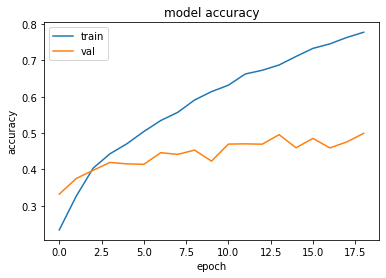

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.7238849401474 , and Val Acc happened to be 0.41920000314712524
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.499099999666214 and Val Loss happened to be  1.924278736114502
TestLoss:  1.718357801437378  TestAcc: 0.4226999878883362
ship 0.676
automobile 0.657
frog 0.645
horse 0.576
dog 0.52
truck 0.52
cat 0.283
deer 0.192
airplane 0.098
bird 0.06


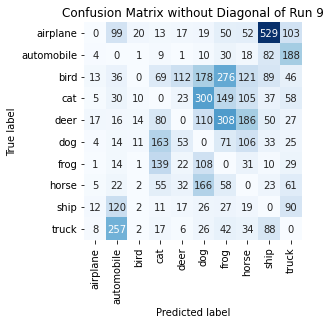

Summing down the rows, for Predictions of each Class that were wrong:  [  69.  608.   63.  556.  283.  943. 1011.  672.  941.  627.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [902. 343. 940. 717. 808. 480. 355. 424. 324. 480.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  308.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10 on Dataset C

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   (

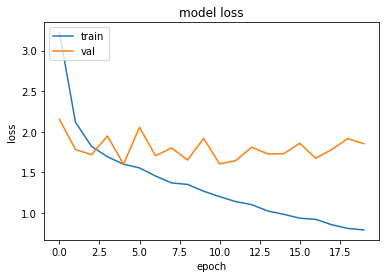

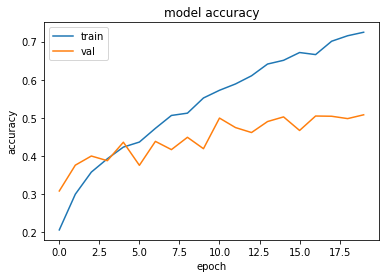

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5980199575424194 , and Val Acc happened to be 0.43619999289512634
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5080999732017517 and Val Loss happened to be  1.8523980379104614
TestLoss:  1.570380687713623  TestAcc: 0.44269999861717224
frog 0.712
ship 0.707
truck 0.687
horse 0.606
dog 0.521
automobile 0.398
airplane 0.286
bird 0.253
deer 0.16
cat 0.097


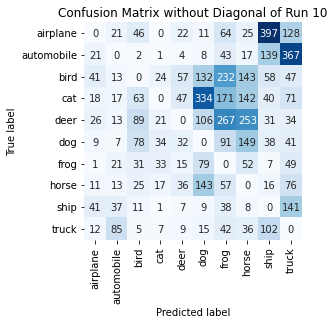

Summing down the rows, for Predictions of each Class that were wrong:  [ 180.  227.  350.  138.  229.  837. 1005.  825.  828.  954.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  57.0 times
Summing across the columns, for total number of that True Class misidentified:  [714. 602. 747. 903. 840. 479. 288. 394. 293. 313.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  267.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11 on Dataset C

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

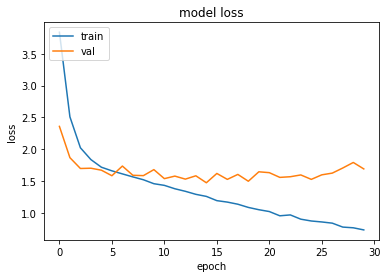

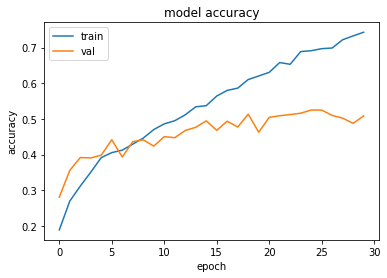

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.473062515258789 , and Val Acc happened to be 0.49459999799728394
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5249000191688538 and Val Loss happened to be  1.5262593030929565
TestLoss:  1.4312665462493896  TestAcc: 0.49079999327659607
ship 0.741
dog 0.719
frog 0.715
horse 0.622
automobile 0.619
truck 0.596
airplane 0.366
deer 0.231
bird 0.203
cat 0.096


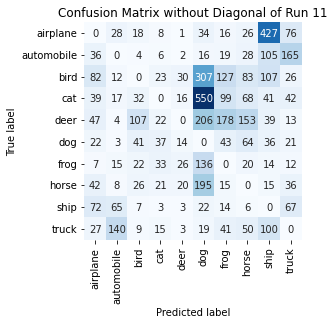

Summing down the rows, for Predictions of each Class that were wrong:  [ 374.  292.  266.  168.  115. 1485.  552.  498.  884.  458.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  30.0 times
Summing across the columns, for total number of that True Class misidentified:  [634. 381. 797. 904. 769. 281. 285. 378. 259. 404.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  206.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12 on Dataset C

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
Zoo

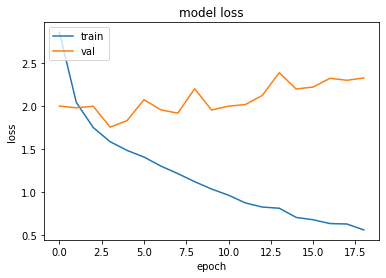

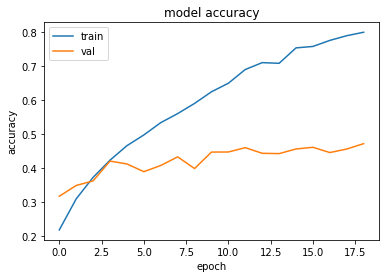

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.7559902667999268 , and Val Acc happened to be 0.42010000348091125
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.4713999927043915 and Val Loss happened to be  2.3294036388397217
TestLoss:  1.7357990741729736  TestAcc: 0.42250001430511475
ship 0.763
horse 0.639
frog 0.628
truck 0.566
dog 0.482
automobile 0.469
airplane 0.192
bird 0.183
cat 0.172
deer 0.131


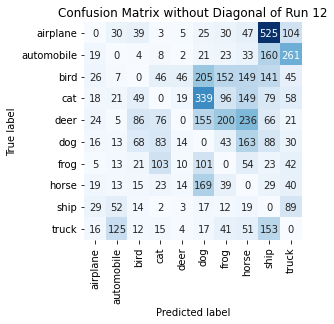

Summing down the rows, for Predictions of each Class that were wrong:  [ 172.  279.  308.  359.  117. 1049.  636.  901. 1264.  690.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  46.0 times
Summing across the columns, for total number of that True Class misidentified:  [808. 531. 817. 828. 869. 518. 372. 361. 237. 434.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  236.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13 on Dataset C

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
Z

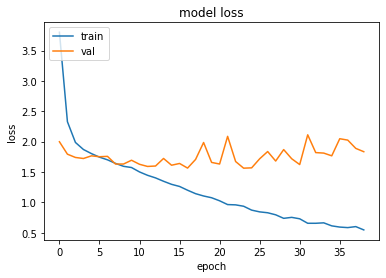

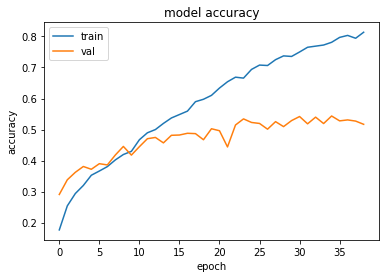

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.5626100301742554 , and Val Acc happened to be 0.5343999862670898
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5436999797821045 and Val Loss happened to be  1.7660915851593018
TestLoss:  1.577092170715332  TestAcc: 0.5311999917030334
frog 0.696
ship 0.692
horse 0.68
truck 0.656
dog 0.621
automobile 0.557
airplane 0.489
deer 0.48
bird 0.24
cat 0.201


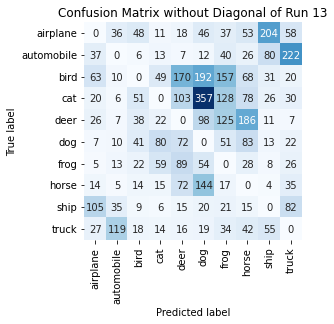

Summing down the rows, for Predictions of each Class that were wrong:  [304. 241. 247. 269. 562. 942. 610. 579. 432. 502.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  170.0 times
Summing across the columns, for total number of that True Class misidentified:  [511. 443. 760. 799. 520. 379. 304. 320. 308. 344.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  186.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14 on Dataset C

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

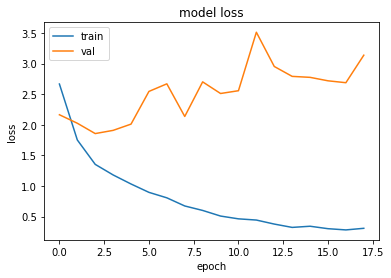

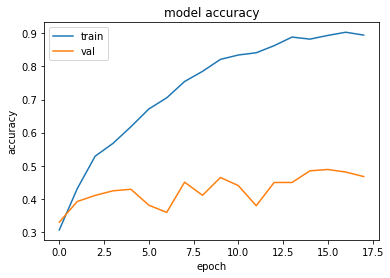

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.8566068410873413 , and Val Acc happened to be 0.41019999980926514
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.4885999858379364 and Val Loss happened to be  2.71921443939209
TestLoss:  1.8274791240692139  TestAcc: 0.4108999967575073
ship 0.73
dog 0.692
horse 0.624
truck 0.598
frog 0.41
automobile 0.347
deer 0.266
airplane 0.25
cat 0.131
bird 0.061


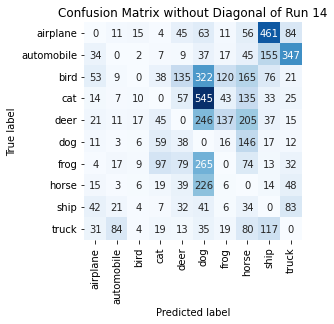

Summing down the rows, for Predictions of each Class that were wrong:  [ 225.  166.   73.  295.  447. 1780.  375.  940.  923.  667.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  135.0 times
Summing across the columns, for total number of that True Class misidentified:  [750. 653. 939. 869. 734. 308. 590. 376. 270. 402.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  246.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15 on Dataset C

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 

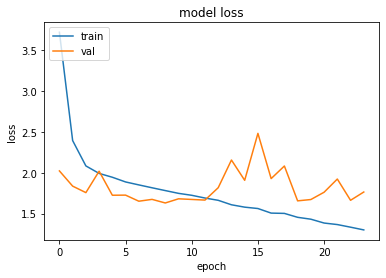

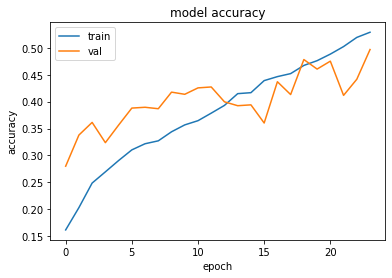

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.629867672920227 , and Val Acc happened to be 0.41760000586509705
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.4966999888420105 and Val Loss happened to be  1.7636765241622925
TestLoss:  1.6196941137313843  TestAcc: 0.4219000041484833
ship 0.771
frog 0.687
horse 0.679
dog 0.524
truck 0.473
bird 0.343
automobile 0.309
deer 0.185
airplane 0.18
cat 0.068


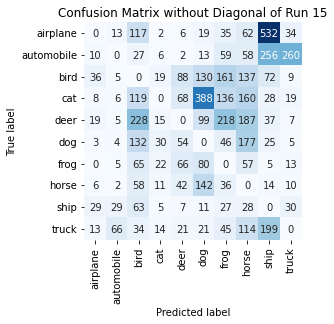

Summing down the rows, for Predictions of each Class that were wrong:  [ 124.  135.  843.  124.  354.  903.  763.  980. 1168.  387.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  88.0 times
Summing across the columns, for total number of that True Class misidentified:  [820. 691. 657. 932. 815. 476. 313. 321. 229. 527.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  228.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16 on Dataset C

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

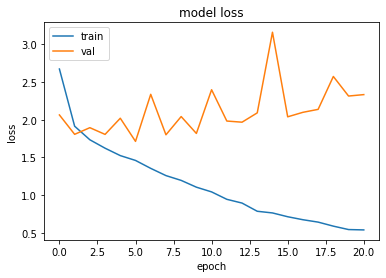

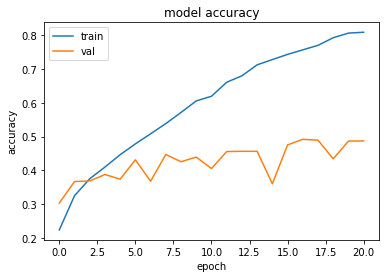

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.7131420373916626 , and Val Acc happened to be 0.4311999976634979
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.4918999969959259 and Val Loss happened to be  2.0980453491210938
TestLoss:  1.7009353637695312  TestAcc: 0.4357999861240387
ship 0.829
truck 0.654
horse 0.639
frog 0.613
dog 0.519
automobile 0.338
bird 0.2
deer 0.194
cat 0.188
airplane 0.184


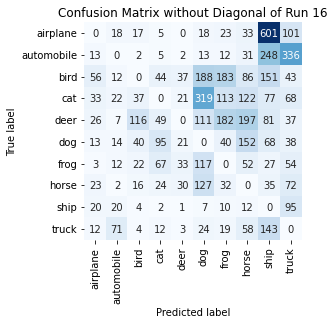

Summing down the rows, for Predictions of each Class that were wrong:  [ 199.  178.  258.  303.  148.  924.  614.  743. 1431.  844.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  37.0 times
Summing across the columns, for total number of that True Class misidentified:  [816. 662. 800. 812. 806. 481. 387. 361. 171. 346.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  197.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17 on Dataset C

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -

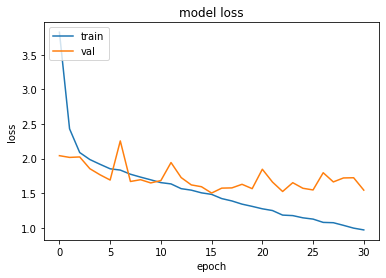

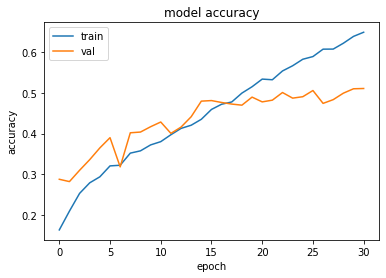

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.5033069849014282 , and Val Acc happened to be 0.48100000619888306
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.510699987411499 and Val Loss happened to be  1.5450937747955322
TestLoss:  1.4676029682159424  TestAcc: 0.4823000133037567
frog 0.732
dog 0.704
truck 0.691
horse 0.673
ship 0.607
automobile 0.415
deer 0.409
airplane 0.332
bird 0.147
cat 0.113


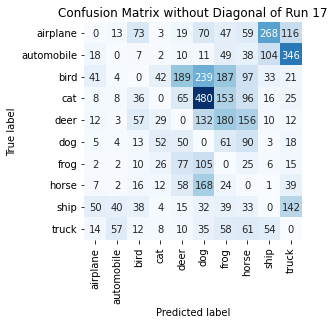

Summing down the rows, for Predictions of each Class that were wrong:  [ 157.  133.  262.  178.  493. 1272.  798.  655.  495.  734.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  189.0 times
Summing across the columns, for total number of that True Class misidentified:  [668. 585. 853. 887. 591. 296. 268. 327. 393. 309.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  180.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18 on Dataset C

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:  

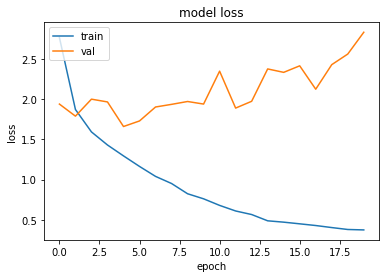

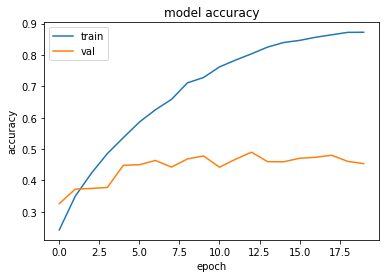

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6597778797149658 , and Val Acc happened to be 0.44850000739097595
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.490200012922287 and Val Loss happened to be  1.9735738039016724
TestLoss:  1.6377495527267456  TestAcc: 0.44909998774528503
ship 0.826
horse 0.762
frog 0.627
truck 0.602
automobile 0.493
dog 0.454
deer 0.296
airplane 0.245
cat 0.119
bird 0.067


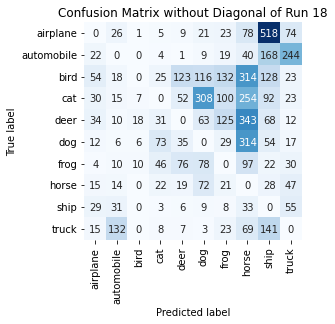

Summing down the rows, for Predictions of each Class that were wrong:  [ 215.  262.   42.  217.  328.  679.  480. 1542. 1219.  525.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  123.0 times
Summing across the columns, for total number of that True Class misidentified:  [755. 507. 933. 881. 704. 546. 373. 238. 174. 398.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  343.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19 on Dataset C

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )


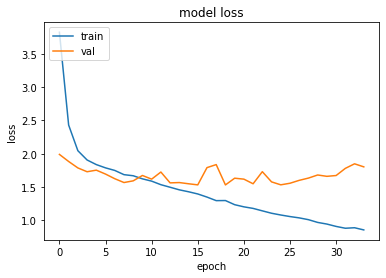

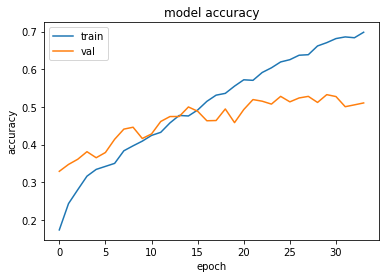

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.5309505462646484 , and Val Acc happened to be 0.49459999799728394
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5325999855995178 and Val Loss happened to be  1.6600290536880493
TestLoss:  1.4818408489227295  TestAcc: 0.4970000088214874
ship 0.765
frog 0.696
truck 0.662
dog 0.62
horse 0.576
automobile 0.461
bird 0.43
deer 0.359
airplane 0.215
cat 0.186


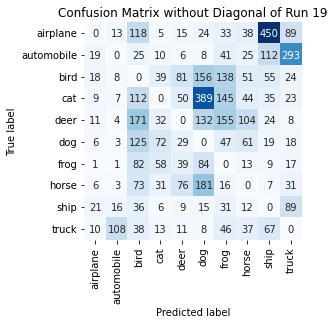

Summing down the rows, for Predictions of each Class that were wrong:  [101. 163. 780. 266. 316. 997. 652. 385. 778. 592.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  81.0 times
Summing across the columns, for total number of that True Class misidentified:  [785. 539. 570. 814. 641. 380. 304. 424. 235. 338.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  171.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20 on Dataset C

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0

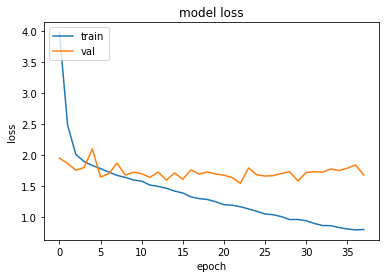

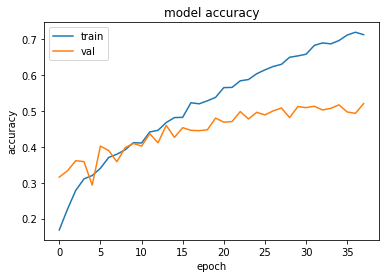

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.545095443725586 , and Val Acc happened to be 0.49869999289512634
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5210999846458435 and Val Loss happened to be  1.680165410041809
TestLoss:  1.5087990760803223  TestAcc: 0.5009999871253967
truck 0.769
dog 0.728
ship 0.65
frog 0.636
horse 0.577
automobile 0.463
deer 0.4
airplane 0.332
bird 0.256
cat 0.199


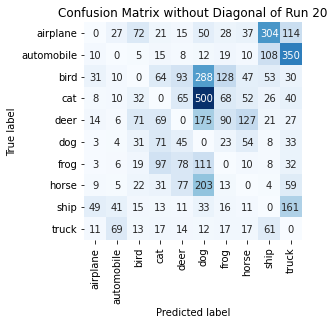

Summing down the rows, for Predictions of each Class that were wrong:  [ 138.  178.  280.  398.  406. 1384.  402.  365.  593.  846.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  93.0 times
Summing across the columns, for total number of that True Class misidentified:  [668. 537. 744. 801. 600. 272. 364. 423. 350. 231.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  175.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21 on Dataset C

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0

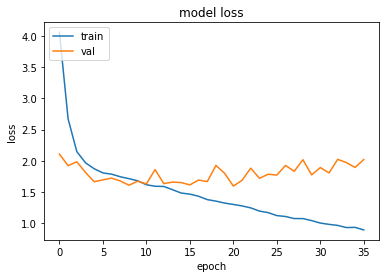

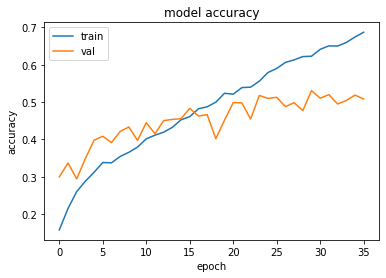

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.5965875387191772 , and Val Acc happened to be 0.49869999289512634
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5306000113487244 and Val Loss happened to be  1.7759029865264893
TestLoss:  1.578073501586914  TestAcc: 0.49880000948905945
ship 0.773
horse 0.648
frog 0.647
dog 0.629
truck 0.588
automobile 0.546
deer 0.397
airplane 0.376
bird 0.257
cat 0.127


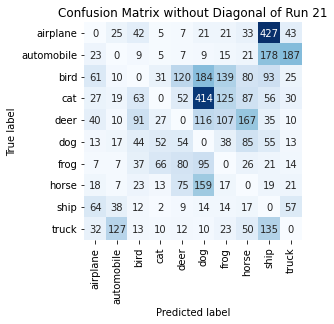

Summing down the rows, for Predictions of each Class that were wrong:  [ 285.  260.  334.  211.  416. 1022.  499.  566. 1019.  400.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  120.0 times
Summing across the columns, for total number of that True Class misidentified:  [624. 454. 743. 873. 603. 371. 353. 352. 227. 412.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  167.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22 on Dataset C

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   

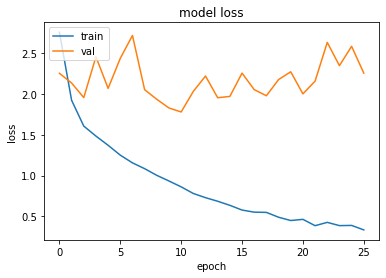

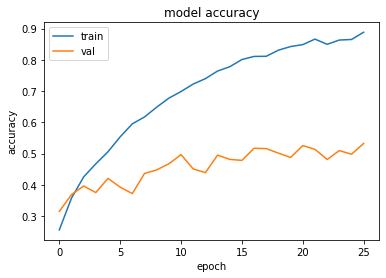

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.780291199684143 , and Val Acc happened to be 0.49639999866485596
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5321999788284302 and Val Loss happened to be  2.2565670013427734
TestLoss:  1.7400245666503906  TestAcc: 0.49410000443458557
ship 0.712
dog 0.672
truck 0.635
frog 0.594
horse 0.576
deer 0.517
automobile 0.479
airplane 0.35
bird 0.225
cat 0.181


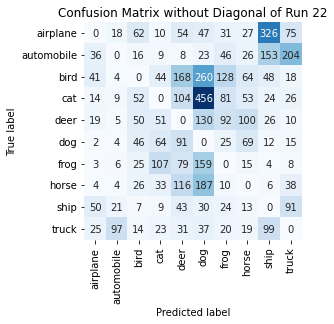

Summing down the rows, for Predictions of each Class that were wrong:  [ 194.  168.  298.  350.  694. 1329.  457.  386.  698.  485.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  168.0 times
Summing across the columns, for total number of that True Class misidentified:  [650. 521. 775. 819. 483. 328. 406. 424. 288. 365.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  130.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23 on Dataset C

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

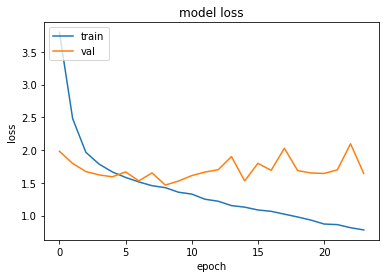

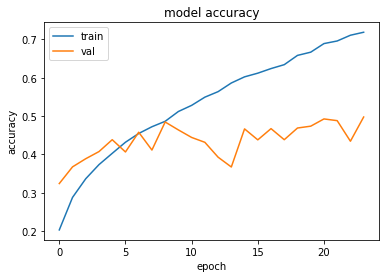

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.4646432399749756 , and Val Acc happened to be 0.4846000075340271
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.4975999891757965 and Val Loss happened to be  1.6404081583023071
TestLoss:  1.4391324520111084  TestAcc: 0.4875999987125397
ship 0.724
dog 0.72
horse 0.669
truck 0.648
frog 0.639
automobile 0.571
deer 0.315
airplane 0.308
bird 0.175
cat 0.107


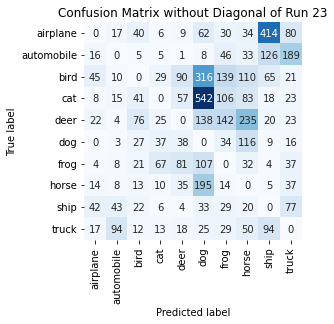

Summing down the rows, for Predictions of each Class that were wrong:  [ 168.  202.  257.  198.  333. 1426.  569.  713.  755.  503.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  90.0 times
Summing across the columns, for total number of that True Class misidentified:  [692. 429. 825. 893. 685. 280. 361. 331. 276. 352.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  235.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24 on Dataset C

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:  

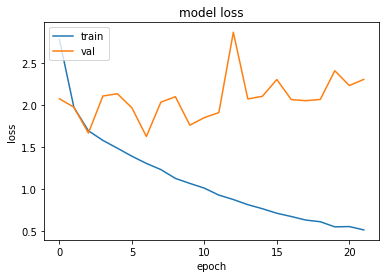

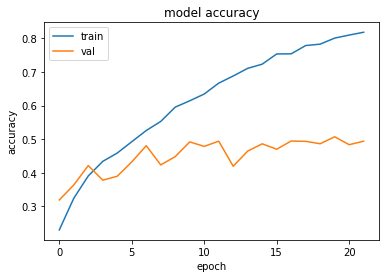

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.6266618967056274 , and Val Acc happened to be 0.4803999960422516
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5070000290870667 and Val Loss happened to be  2.4069480895996094
TestLoss:  1.6046183109283447  TestAcc: 0.4860999882221222
truck 0.641
dog 0.631
ship 0.617
horse 0.607
airplane 0.584
frog 0.569
automobile 0.502
deer 0.323
bird 0.201
cat 0.186


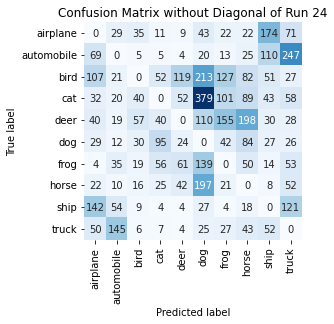

Summing down the rows, for Predictions of each Class that were wrong:  [ 495.  345.  217.  295.  319. 1153.  512.  611.  509.  683.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  119.0 times
Summing across the columns, for total number of that True Class misidentified:  [416. 498. 799. 814. 677. 369. 431. 393. 383. 359.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  198.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25 on Dataset C

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , 

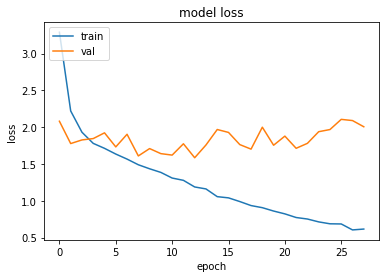

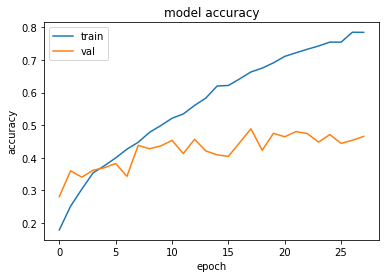

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.5838466882705688 , and Val Acc happened to be 0.4569000005722046
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.48899999260902405 and Val Loss happened to be  1.7010629177093506
TestLoss:  1.559113621711731  TestAcc: 0.45570001006126404
ship 0.789
dog 0.785
truck 0.638
frog 0.554
horse 0.52
automobile 0.373
airplane 0.319
bird 0.246
deer 0.215
cat 0.118


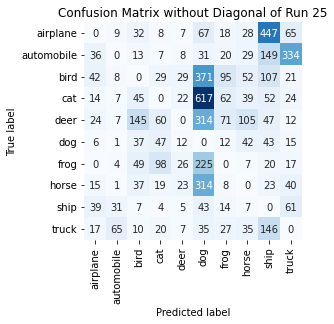

Summing down the rows, for Predictions of each Class that were wrong:  [ 193.  133.  375.  292.  139. 2017.  327.  344. 1034.  589.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  29.0 times
Summing across the columns, for total number of that True Class misidentified:  [681. 627. 754. 882. 785. 215. 446. 480. 211. 362.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  314.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26 on Dataset C

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0

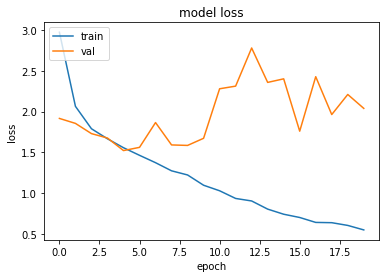

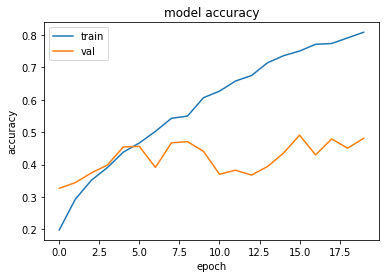

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5233222246170044 , and Val Acc happened to be 0.454800009727478
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.491100013256073 and Val Loss happened to be  1.7605839967727661
TestLoss:  1.5050299167633057  TestAcc: 0.4629000127315521
ship 0.749
frog 0.701
horse 0.643
truck 0.537
dog 0.485
automobile 0.431
airplane 0.414
deer 0.262
cat 0.245
bird 0.162


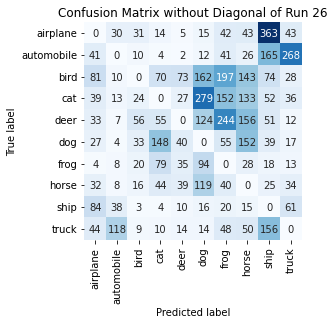

Summing down the rows, for Predictions of each Class that were wrong:  [385. 236. 202. 428. 245. 835. 839. 746. 943. 512.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  73.0 times
Summing across the columns, for total number of that True Class misidentified:  [586. 569. 838. 755. 738. 515. 299. 357. 251. 463.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  244.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27 on Dataset C

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 

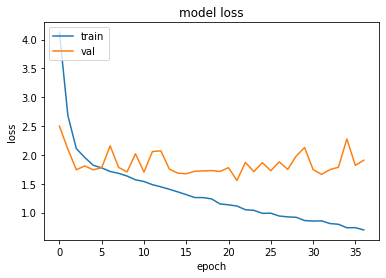

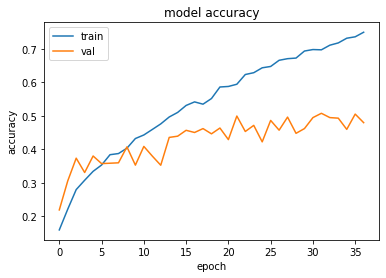

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.5557596683502197 , and Val Acc happened to be 0.49939998984336853
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5076000094413757 and Val Loss happened to be  1.6619665622711182
TestLoss:  1.5399138927459717  TestAcc: 0.4894999861717224
ship 0.781
frog 0.709
dog 0.669
airplane 0.516
automobile 0.506
truck 0.506
horse 0.482
bird 0.342
deer 0.296
cat 0.088


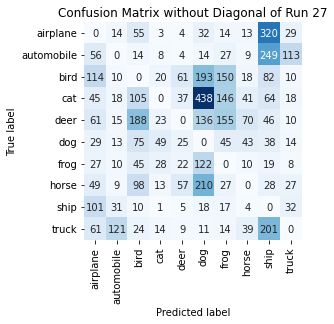

Summing down the rows, for Predictions of each Class that were wrong:  [ 543.  241.  614.  159.  224. 1174.  595.  247. 1047.  261.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  61.0 times
Summing across the columns, for total number of that True Class misidentified:  [484. 494. 658. 912. 704. 331. 291. 518. 219. 494.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  188.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28 on Dataset C

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

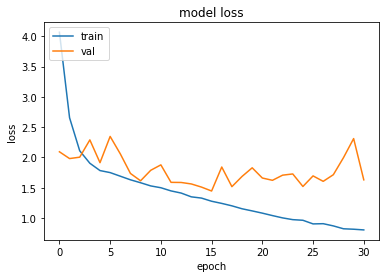

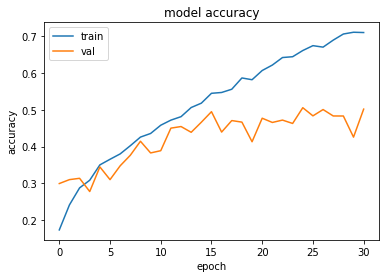

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.4466197490692139 , and Val Acc happened to be 0.4945000112056732
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.505299985408783 and Val Loss happened to be  1.5214141607284546
TestLoss:  1.4227535724639893  TestAcc: 0.49570000171661377
truck 0.71
frog 0.706
horse 0.683
ship 0.666
dog 0.602
deer 0.48
automobile 0.454
airplane 0.381
bird 0.198
cat 0.077


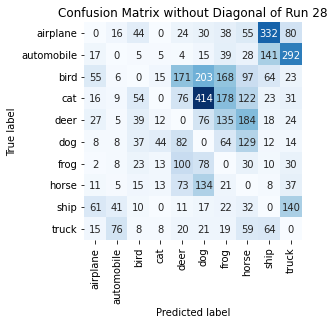

Summing down the rows, for Predictions of each Class that were wrong:  [212. 174. 235. 110. 561. 988. 684. 736. 672. 671.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  171.0 times
Summing across the columns, for total number of that True Class misidentified:  [619. 546. 802. 923. 520. 398. 294. 317. 334. 290.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  184.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29 on Dataset C

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

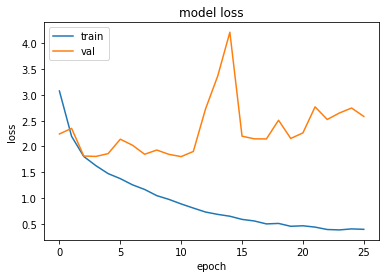

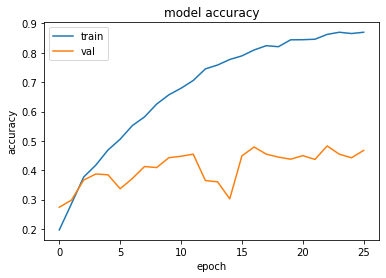

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.804111361503601 , and Val Acc happened to be 0.44769999384880066
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.4828000068664551 and Val Loss happened to be  2.523387908935547
TestLoss:  1.7783799171447754  TestAcc: 0.448199987411499
ship 0.693
truck 0.649
frog 0.599
dog 0.549
deer 0.478
horse 0.403
cat 0.344
automobile 0.303
airplane 0.255
bird 0.209


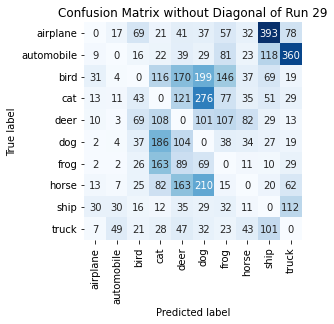

Summing down the rows, for Predictions of each Class that were wrong:  [117. 127. 322. 738. 809. 982. 576. 308. 818. 721.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  170.0 times
Summing across the columns, for total number of that True Class misidentified:  [745. 697. 791. 656. 522. 451. 401. 597. 307. 351.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  108.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30 on Dataset C

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.16 , 0

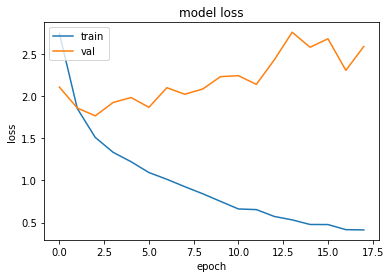

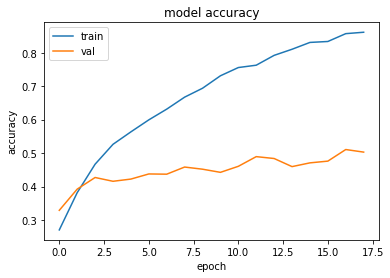

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7659012079238892 , and Val Acc happened to be 0.42730000615119934
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5108000040054321 and Val Loss happened to be  2.306459665298462
TestLoss:  1.747464895248413  TestAcc: 0.42879998683929443
frog 0.778
ship 0.687
truck 0.664
horse 0.604
automobile 0.568
dog 0.529
bird 0.16
airplane 0.107
cat 0.096
deer 0.095


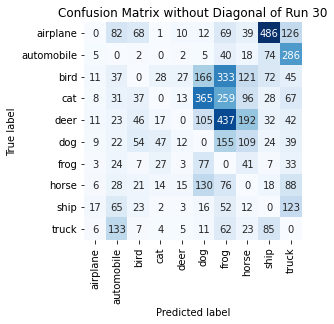

Summing down the rows, for Predictions of each Class that were wrong:  [  76.  445.  265.  140.   90.  887. 1483.  651.  826.  849.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  27.0 times
Summing across the columns, for total number of that True Class misidentified:  [893. 432. 840. 904. 905. 471. 222. 396. 313. 336.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  437.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31 on Dataset C

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0

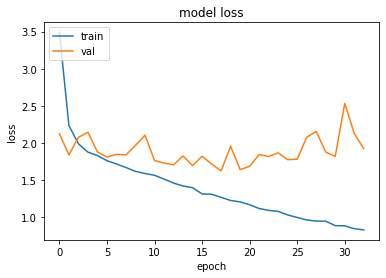

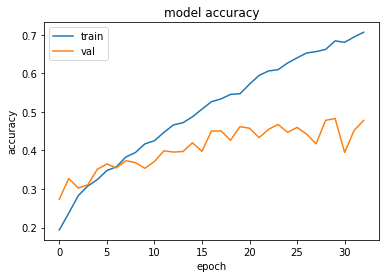

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.6244596242904663 , and Val Acc happened to be 0.4505999982357025
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.4828000068664551 and Val Loss happened to be  1.819381594657898
TestLoss:  1.6148056983947754  TestAcc: 0.4537000060081482
frog 0.768
ship 0.76
dog 0.715
truck 0.691
horse 0.525
automobile 0.404
airplane 0.229
bird 0.177
cat 0.145
deer 0.123


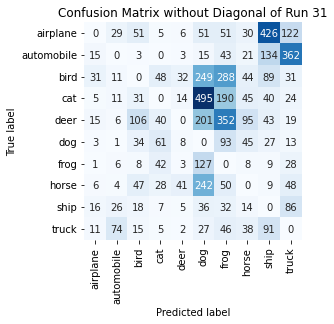

Summing down the rows, for Predictions of each Class that were wrong:  [ 103.  168.  313.  236.  114. 1443. 1145.  340.  868.  733.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  41.0 times
Summing across the columns, for total number of that True Class misidentified:  [771. 596. 823. 855. 877. 285. 232. 475. 240. 309.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  352.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32 on Dataset C

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

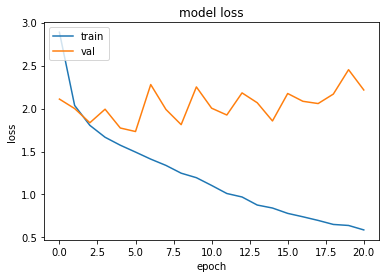

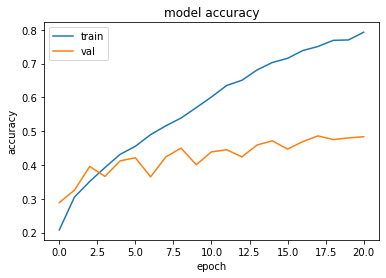

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.7326247692108154 , and Val Acc happened to be 0.4212999939918518
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.4862000048160553 and Val Loss happened to be  2.058152198791504
TestLoss:  1.7199150323867798  TestAcc: 0.42100000381469727
ship 0.797
frog 0.775
horse 0.612
automobile 0.519
truck 0.471
dog 0.43
airplane 0.224
deer 0.198
bird 0.126
cat 0.058


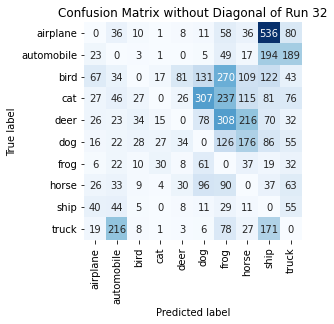

Summing down the rows, for Predictions of each Class that were wrong:  [ 250.  476.  134.   96.  198.  706. 1245.  744. 1316.  625.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  81.0 times
Summing across the columns, for total number of that True Class misidentified:  [776. 481. 874. 942. 802. 570. 225. 388. 203. 529.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  308.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33 on Dataset C

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

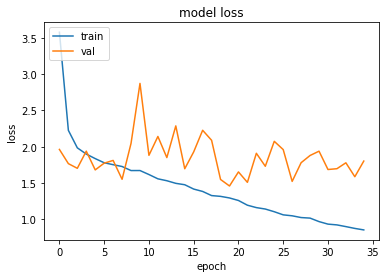

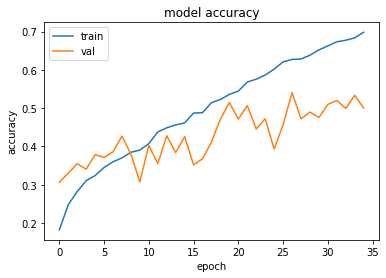

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.4597537517547607 , and Val Acc happened to be 0.5145999789237976
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5407000184059143 and Val Loss happened to be  1.523051381111145
TestLoss:  1.450284719467163  TestAcc: 0.5098000168800354
frog 0.789
ship 0.777
horse 0.601
dog 0.598
truck 0.586
deer 0.442
automobile 0.38
airplane 0.379
bird 0.346
cat 0.2


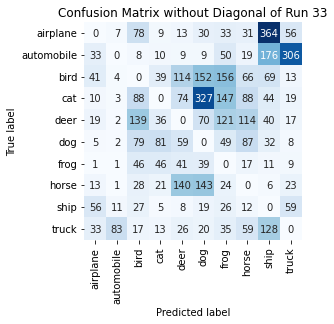

Summing down the rows, for Predictions of each Class that were wrong:  [211. 114. 510. 260. 484. 809. 641. 493. 870. 510.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  140.0 times
Summing across the columns, for total number of that True Class misidentified:  [621. 620. 654. 800. 558. 402. 211. 399. 223. 414.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  139.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34 on Dataset C

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0

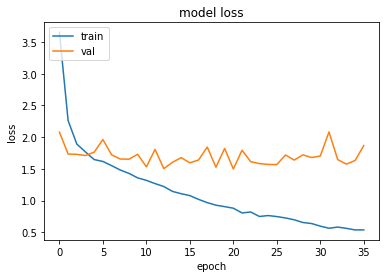

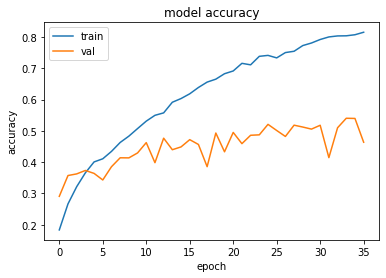

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.4972203969955444 , and Val Acc happened to be 0.4948999881744385
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5401999950408936 and Val Loss happened to be  1.5746207237243652
TestLoss:  1.4776347875595093  TestAcc: 0.4916999936103821
dog 0.798
truck 0.73
ship 0.724
horse 0.568
frog 0.48
airplane 0.461
automobile 0.419
bird 0.335
deer 0.299
cat 0.103


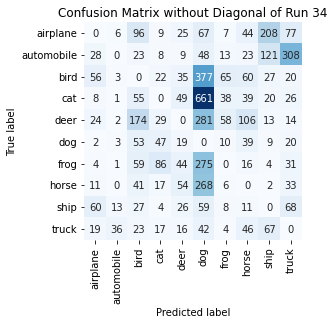

Summing down the rows, for Predictions of each Class that were wrong:  [ 212.   65.  551.  239.  277. 2078.  209.  384.  471.  597.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  54.0 times
Summing across the columns, for total number of that True Class misidentified:  [539. 581. 665. 897. 701. 202. 520. 432. 276. 270.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  281.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35 on Dataset C

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

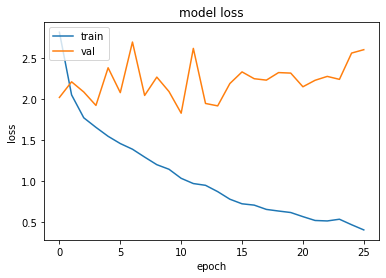

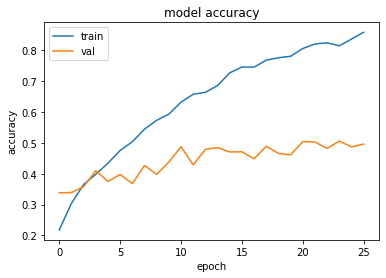

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.8302356004714966 , and Val Acc happened to be 0.48750001192092896
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5058000087738037 and Val Loss happened to be  2.243288516998291
TestLoss:  1.7888935804367065  TestAcc: 0.492900013923645
frog 0.738
ship 0.694
truck 0.677
horse 0.602
automobile 0.567
dog 0.469
airplane 0.393
bird 0.335
deer 0.262
cat 0.192


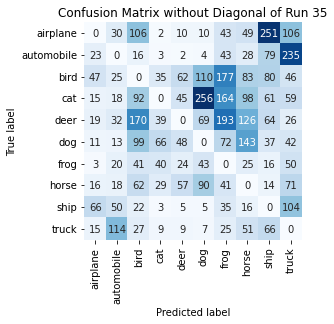

Summing down the rows, for Predictions of each Class that were wrong:  [215. 320. 635. 226. 262. 594. 793. 619. 668. 739.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  62.0 times
Summing across the columns, for total number of that True Class misidentified:  [607. 433. 665. 808. 738. 531. 262. 398. 306. 323.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  193.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36 on Dataset C

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.

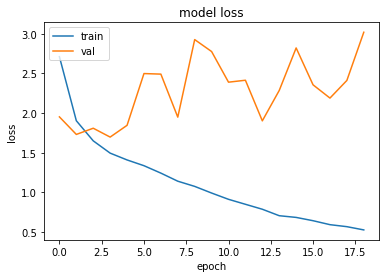

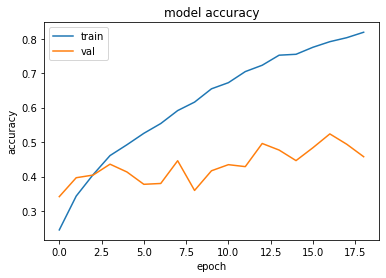

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6977031230926514 , and Val Acc happened to be 0.4357999861240387
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5236999988555908 and Val Loss happened to be  2.1895782947540283
TestLoss:  1.6550853252410889  TestAcc: 0.4415999948978424
ship 0.782
frog 0.685
truck 0.642
dog 0.629
automobile 0.591
horse 0.559
airplane 0.268
cat 0.106
bird 0.077
deer 0.077


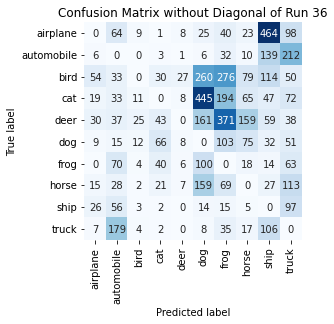

Summing down the rows, for Predictions of each Class that were wrong:  [ 166.  515.   70.  208.   65. 1178. 1135.  451. 1002.  794.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  27.0 times
Summing across the columns, for total number of that True Class misidentified:  [732. 409. 923. 894. 923. 371. 315. 441. 218. 358.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  371.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37 on Dataset C

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.

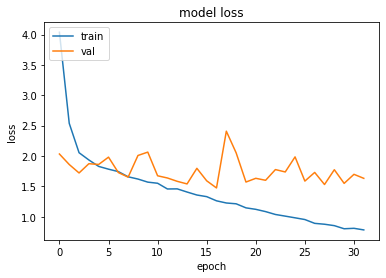

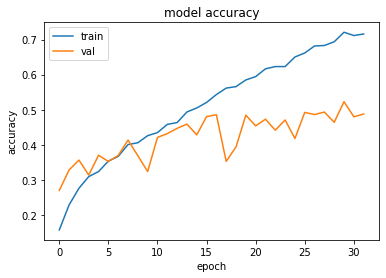

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.474052906036377 , and Val Acc happened to be 0.4855000078678131
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5228000283241272 and Val Loss happened to be  1.5492686033248901
TestLoss:  1.4556481838226318  TestAcc: 0.48399999737739563
ship 0.787
truck 0.715
dog 0.672
horse 0.596
frog 0.549
automobile 0.546
airplane 0.389
bird 0.283
deer 0.17
cat 0.133


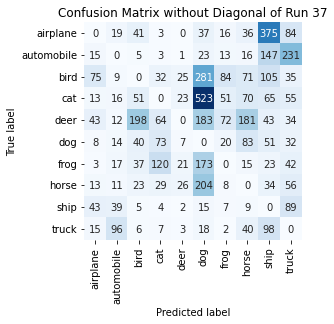

Summing down the rows, for Predictions of each Class that were wrong:  [ 228.  233.  406.  335.  108. 1457.  273.  521.  941.  658.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  26.0 times
Summing across the columns, for total number of that True Class misidentified:  [611. 454. 717. 867. 830. 328. 451. 404. 213. 285.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  198.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38 on Dataset C

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

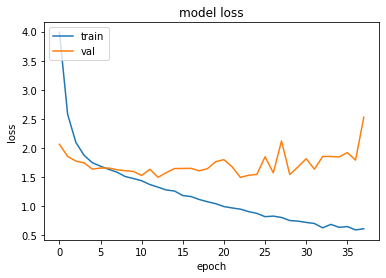

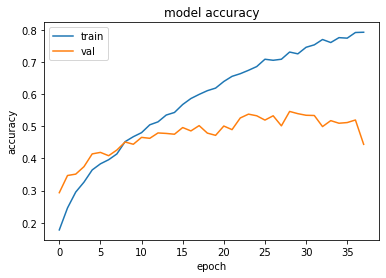

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.496305227279663 , and Val Acc happened to be 0.5260999798774719
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5464000105857849 and Val Loss happened to be  1.545462727546692
TestLoss:  1.4614940881729126  TestAcc: 0.5293999910354614
truck 0.797
ship 0.768
frog 0.682
dog 0.608
horse 0.55
deer 0.518
airplane 0.423
automobile 0.403
bird 0.302
cat 0.243


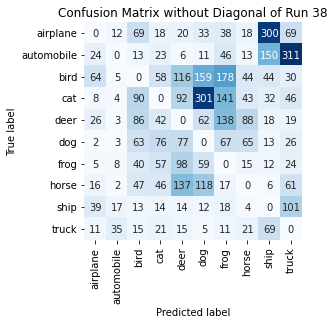

Summing down the rows, for Predictions of each Class that were wrong:  [195.  89. 436. 355. 575. 760. 654. 311. 644. 687.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  137.0 times
Summing across the columns, for total number of that True Class misidentified:  [577. 597. 698. 757. 482. 392. 318. 450. 232. 203.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  138.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39 on Dataset C

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

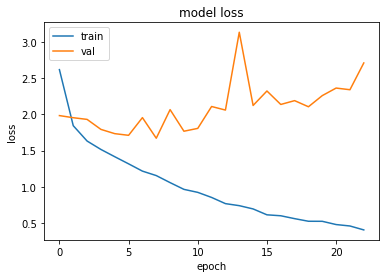

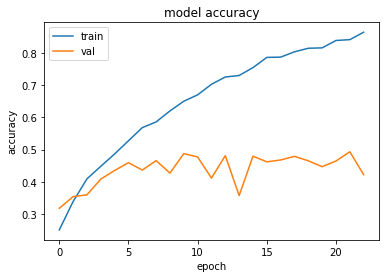

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.6704683303833008 , and Val Acc happened to be 0.4659000039100647
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.4932999908924103 and Val Loss happened to be  2.3403239250183105
TestLoss:  1.6609251499176025  TestAcc: 0.4627000093460083
frog 0.774
ship 0.767
truck 0.643
horse 0.601
dog 0.473
deer 0.44
automobile 0.351
bird 0.284
airplane 0.204
cat 0.09


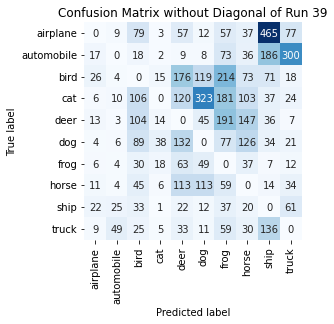

Summing down the rows, for Predictions of each Class that were wrong:  [114. 114. 529. 102. 725. 692. 948. 609. 986. 554.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [796. 649. 716. 910. 560. 527. 226. 399. 233. 357.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  191.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40 on Dataset C

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

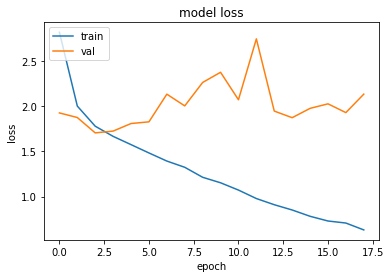

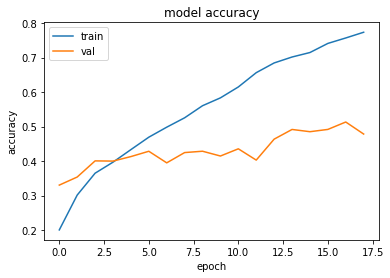

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7050328254699707 , and Val Acc happened to be 0.40049999952316284
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5131999850273132 and Val Loss happened to be  1.929961919784546
TestLoss:  1.6800005435943604  TestAcc: 0.40149998664855957
frog 0.815
ship 0.695
horse 0.643
dog 0.478
automobile 0.396
truck 0.37
deer 0.221
bird 0.161
airplane 0.138
cat 0.098


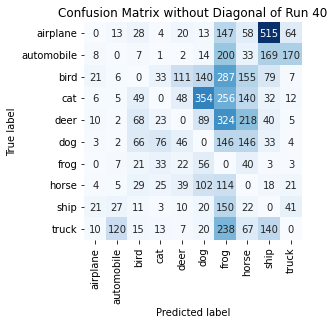

Summing down the rows, for Predictions of each Class that were wrong:  [  83.  187.  294.  211.  305.  808. 1862.  879. 1029.  327.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  111.0 times
Summing across the columns, for total number of that True Class misidentified:  [862. 604. 839. 902. 779. 522. 185. 357. 305. 630.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  324.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41 on Dataset C

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Z

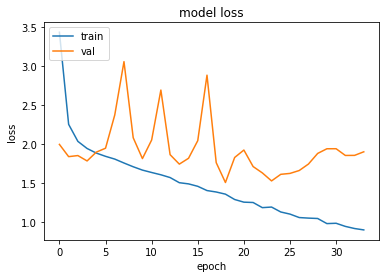

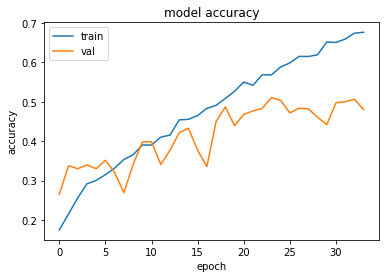

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.5074589252471924 , and Val Acc happened to be 0.4869999885559082
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.510699987411499 and Val Loss happened to be  1.5279771089553833
TestLoss:  1.4703655242919922  TestAcc: 0.48539999127388
dog 0.806
truck 0.774
frog 0.739
ship 0.708
horse 0.487
airplane 0.422
automobile 0.352
deer 0.29
cat 0.151
bird 0.125


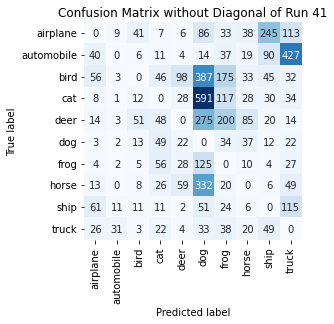

Summing down the rows, for Predictions of each Class that were wrong:  [ 225.   62.  150.  276.  251. 1894.  678.  276.  501.  833.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  98.0 times
Summing across the columns, for total number of that True Class misidentified:  [578. 648. 875. 849. 710. 194. 261. 513. 292. 226.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  275.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42 on Dataset C

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.

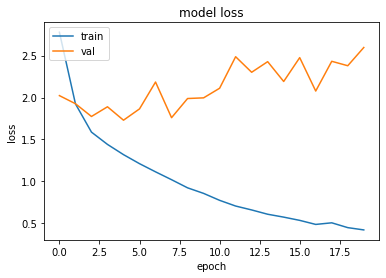

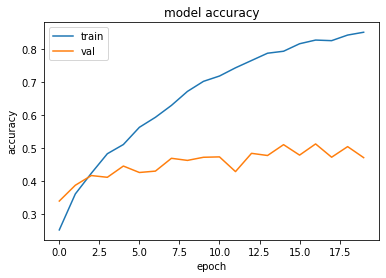

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.7293906211853027 , and Val Acc happened to be 0.4449000060558319
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5121999979019165 and Val Loss happened to be  2.077476739883423
TestLoss:  1.7127220630645752  TestAcc: 0.44780001044273376
ship 0.828
horse 0.647
frog 0.618
truck 0.588
automobile 0.574
dog 0.555
deer 0.235
airplane 0.156
cat 0.152
bird 0.125


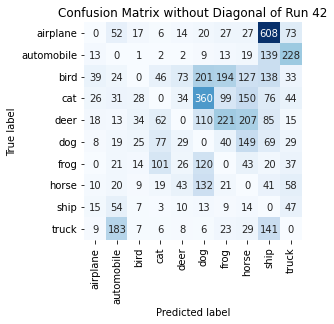

Summing down the rows, for Predictions of each Class that were wrong:  [ 138.  417.  142.  322.  239.  971.  647.  765. 1317.  564.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  73.0 times
Summing across the columns, for total number of that True Class misidentified:  [844. 426. 875. 848. 765. 445. 382. 353. 172. 412.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  221.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43 on Dataset C

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.

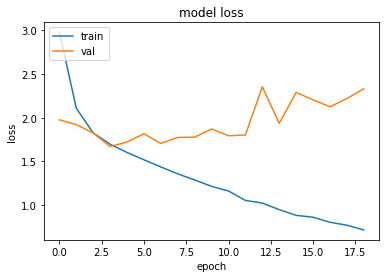

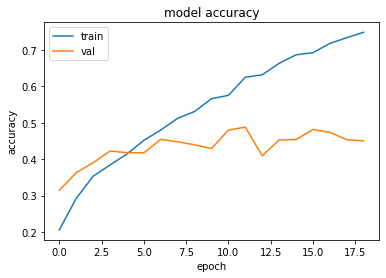

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6711477041244507 , and Val Acc happened to be 0.42239999771118164
Additionally, the best val acc epoch happened to be  11 when val acc was:  0.48809999227523804 and Val Loss happened to be  1.8031566143035889
TestLoss:  1.645688533782959  TestAcc: 0.42890000343322754
frog 0.722
truck 0.707
ship 0.706
horse 0.627
dog 0.563
automobile 0.293
deer 0.278
airplane 0.167
bird 0.134
cat 0.092


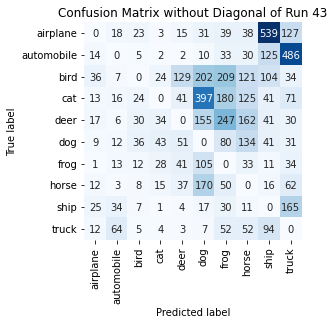

Summing down the rows, for Predictions of each Class that were wrong:  [ 139.  173.  150.  154.  323. 1094.  920.  706. 1012. 1040.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  129.0 times
Summing across the columns, for total number of that True Class misidentified:  [833. 707. 866. 908. 722. 437. 278. 373. 294. 293.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  247.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44 on Dataset C

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
Z

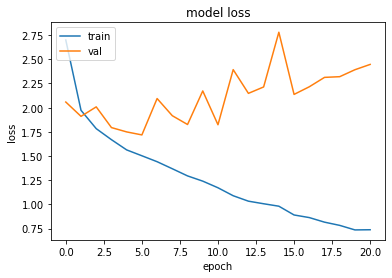

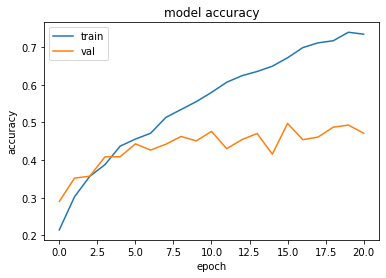

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.7181169986724854 , and Val Acc happened to be 0.44279998540878296
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.49709999561309814 and Val Loss happened to be  2.1370818614959717
TestLoss:  1.6852922439575195  TestAcc: 0.4458000063896179
ship 0.838
frog 0.784
truck 0.595
horse 0.565
dog 0.526
automobile 0.448
bird 0.213
airplane 0.193
deer 0.177
cat 0.119


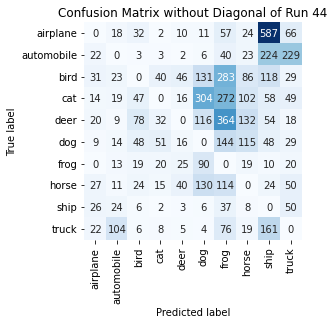

Summing down the rows, for Predictions of each Class that were wrong:  [ 171.  235.  263.  173.  163.  798. 1387.  528. 1284.  540.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  46.0 times
Summing across the columns, for total number of that True Class misidentified:  [807. 552. 787. 881. 823. 474. 216. 435. 162. 405.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  364.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45 on Dataset C

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

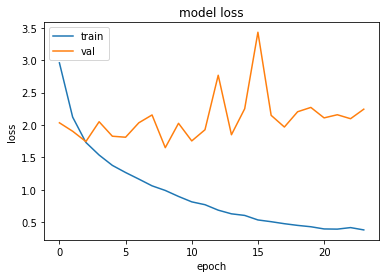

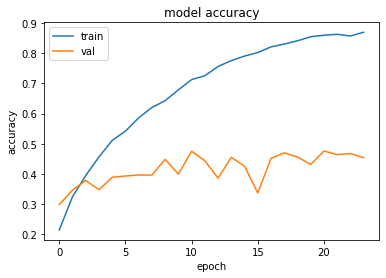

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.6504859924316406 , and Val Acc happened to be 0.4481000006198883
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.4756999909877777 and Val Loss happened to be  2.1100573539733887
TestLoss:  1.6408039331436157  TestAcc: 0.44999998807907104
ship 0.759
frog 0.727
dog 0.601
horse 0.571
truck 0.556
automobile 0.391
airplane 0.335
deer 0.271
cat 0.165
bird 0.124


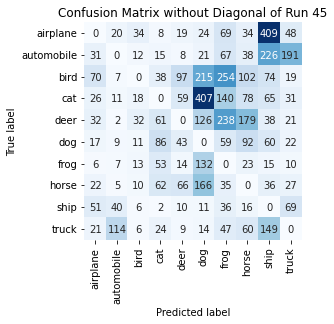

Summing down the rows, for Predictions of each Class that were wrong:  [ 276.  215.  142.  349.  325. 1116.  945.  622. 1072.  438.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  97.0 times
Summing across the columns, for total number of that True Class misidentified:  [665. 609. 876. 835. 729. 399. 273. 429. 241. 444.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  238.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46 on Dataset C

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

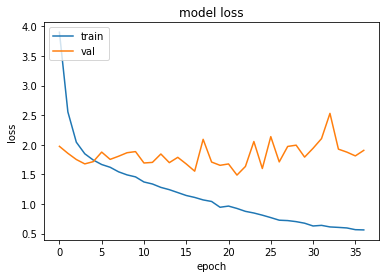

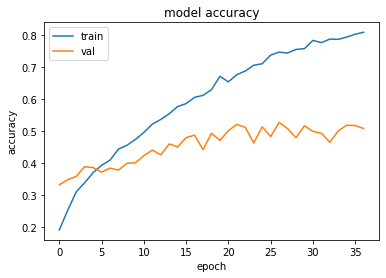

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.4878909587860107 , and Val Acc happened to be 0.5212000012397766
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5273000001907349 and Val Loss happened to be  1.7105990648269653
TestLoss:  1.4739701747894287  TestAcc: 0.5256999731063843
ship 0.824
frog 0.722
truck 0.686
automobile 0.601
horse 0.569
deer 0.565
dog 0.495
airplane 0.325
cat 0.277
bird 0.193


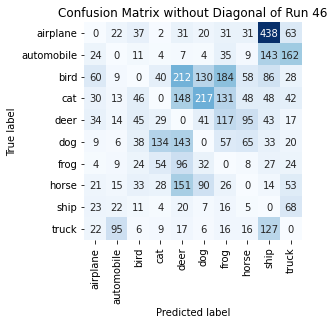

Summing down the rows, for Predictions of each Class that were wrong:  [227. 205. 251. 304. 825. 547. 613. 335. 959. 477.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  212.0 times
Summing across the columns, for total number of that True Class misidentified:  [675. 399. 807. 723. 435. 505. 278. 431. 176. 314.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  117.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47 on Dataset C

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )

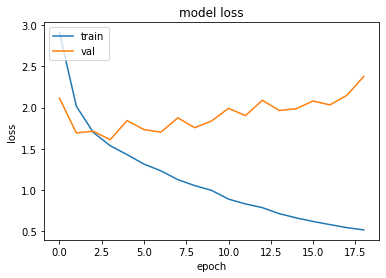

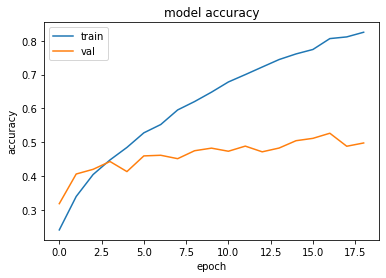

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6108276844024658 , and Val Acc happened to be 0.44269999861717224
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5264000296592712 and Val Loss happened to be  2.032047748565674
TestLoss:  1.5981016159057617  TestAcc: 0.44179999828338623
truck 0.722
dog 0.698
ship 0.693
frog 0.613
horse 0.544
automobile 0.329
airplane 0.277
deer 0.275
cat 0.175
bird 0.092


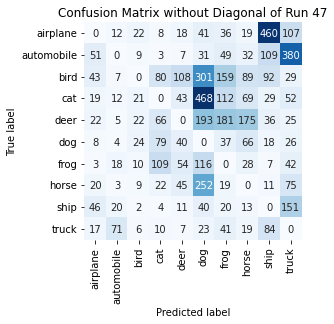

Summing down the rows, for Predictions of each Class that were wrong:  [ 229.  152.  125.  381.  333. 1465.  654.  510.  846.  887.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  108.0 times
Summing across the columns, for total number of that True Class misidentified:  [723. 671. 908. 825. 725. 302. 387. 456. 307. 278.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  193.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48 on Dataset C

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

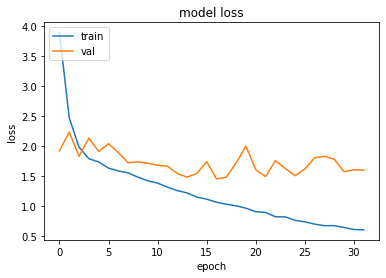

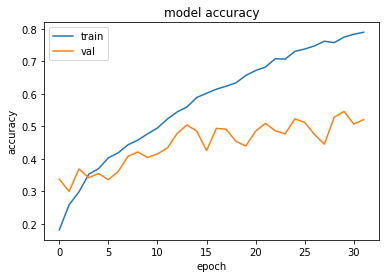

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.455169916152954 , and Val Acc happened to be 0.4936000108718872
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5460000038146973 and Val Loss happened to be  1.5739688873291016
TestLoss:  1.4564752578735352  TestAcc: 0.49549999833106995
ship 0.722
dog 0.686
horse 0.651
truck 0.651
frog 0.628
automobile 0.466
deer 0.435
airplane 0.326
bird 0.198
cat 0.192


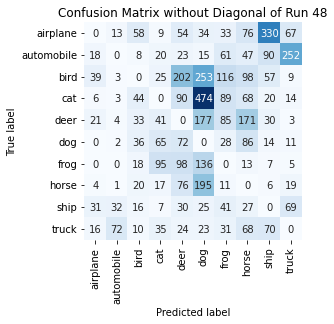

Summing down the rows, for Predictions of each Class that were wrong:  [ 135.  130.  243.  314.  669. 1332.  495.  654.  624.  449.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  202.0 times
Summing across the columns, for total number of that True Class misidentified:  [674. 534. 802. 808. 565. 314. 372. 349. 278. 349.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  177.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49 on Dataset C

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

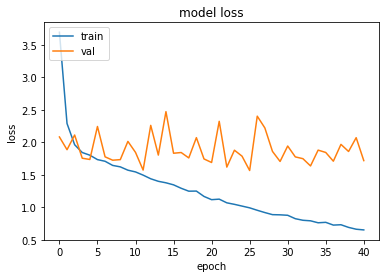

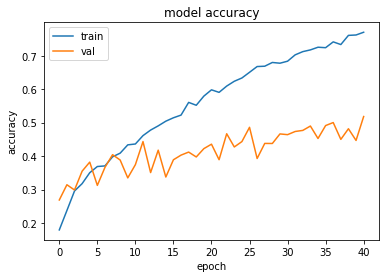

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.5658173561096191 , and Val Acc happened to be 0.4860999882221222
Additionally, the best val acc epoch happened to be  40 when val acc was:  0.5182999968528748 and Val Loss happened to be  1.7182648181915283
TestLoss:  1.5532511472702026  TestAcc: 0.48820000886917114
truck 0.763
ship 0.738
dog 0.619
horse 0.573
deer 0.435
frog 0.394
airplane 0.391
cat 0.362
automobile 0.355
bird 0.252


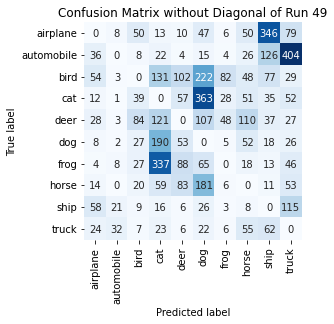

Summing down the rows, for Predictions of each Class that were wrong:  [ 238.   78.  271.  912.  409. 1048.  188.  418.  725.  831.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  102.0 times
Summing across the columns, for total number of that True Class misidentified:  [609. 645. 748. 638. 565. 381. 606. 427. 262. 237.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  121.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50 on Dataset C

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )


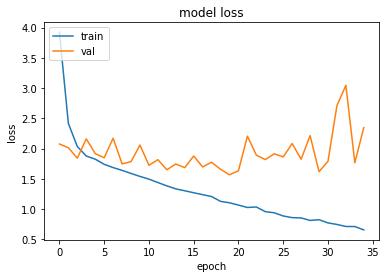

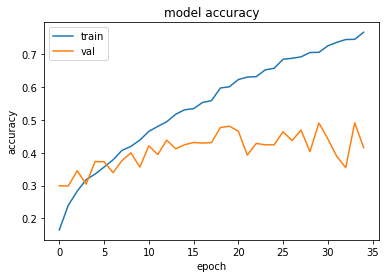

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.5676331520080566 , and Val Acc happened to be 0.48089998960494995
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.4912000000476837 and Val Loss happened to be  1.7662568092346191
TestLoss:  1.5473271608352661  TestAcc: 0.48159998655319214
ship 0.789
dog 0.733
truck 0.709
horse 0.641
frog 0.482
deer 0.394
automobile 0.345
airplane 0.319
bird 0.253
cat 0.151


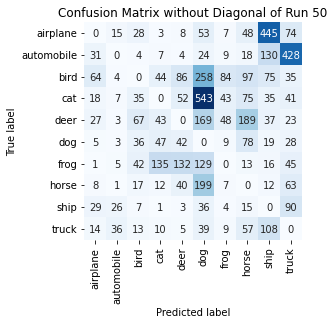

Summing down the rows, for Predictions of each Class that were wrong:  [ 197.  100.  249.  302.  372. 1450.  220.  590.  877.  827.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  132.0 times
Summing across the columns, for total number of that True Class misidentified:  [681. 655. 747. 849. 606. 267. 518. 359. 211. 291.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  189.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 18 November 2021 19:22:38  (subtract ~5-hours for local Hour), and file is called  runs_GroupC_final.pkl


In [78]:
run_through_runs(ds=trainC, ds_noalb=trainC_noalb, dstitle = "C", showpictures=False)

filename will be:  runs_GroupD .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset D

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5


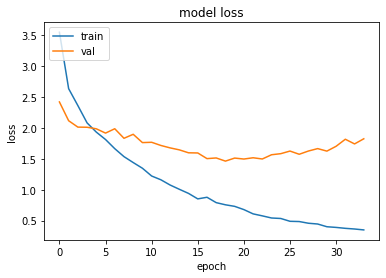

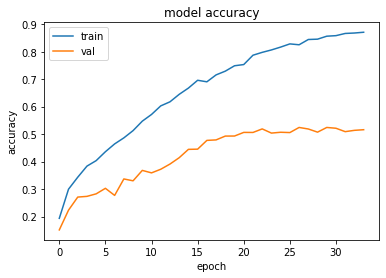

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.462131142616272 , and Val Acc happened to be 0.492900013923645
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5242999792098999 and Val Loss happened to be  1.5727893114089966
TestLoss:  1.4456737041473389  TestAcc: 0.49880000948905945
ship 0.818
frog 0.599
automobile 0.522
deer 0.509
horse 0.487
airplane 0.474
dog 0.458
truck 0.445
bird 0.362
cat 0.314


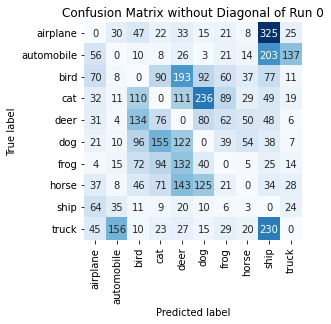

Summing down the rows, for Predictions of each Class that were wrong:  [ 360.  277.  536.  548.  807.  616.  348.  220. 1029.  271.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  193.0 times
Summing across the columns, for total number of that True Class misidentified:  [526. 478. 638. 686. 491. 542. 401. 513. 182. 555.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  134.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1 on Dataset D

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.

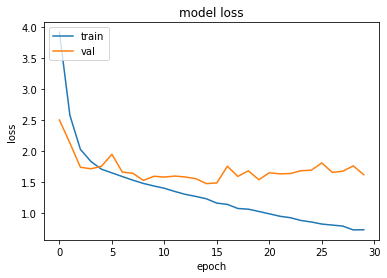

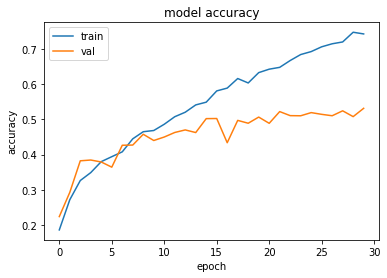

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.4702508449554443 , and Val Acc happened to be 0.5022000074386597
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.531499981880188 and Val Loss happened to be  1.613468885421753
TestLoss:  1.4593231678009033  TestAcc: 0.499099999666214
frog 0.802
ship 0.792
horse 0.597
automobile 0.583
truck 0.568
dog 0.526
bird 0.333
airplane 0.303
deer 0.269
cat 0.218


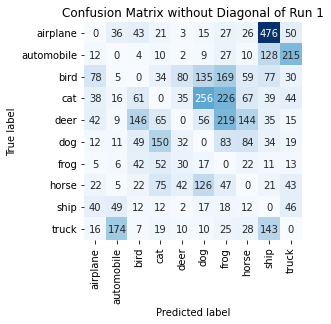

Summing down the rows, for Predictions of each Class that were wrong:  [265. 311. 386. 438. 236. 641. 841. 452. 964. 475.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  80.0 times
Summing across the columns, for total number of that True Class misidentified:  [697. 417. 667. 782. 731. 474. 198. 403. 208. 432.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  219.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2 on Dataset D

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )
B

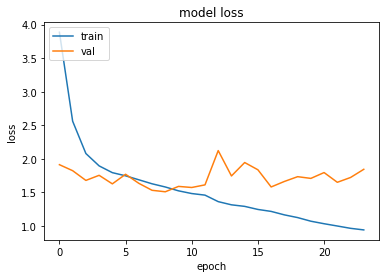

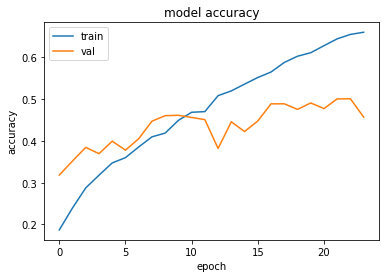

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.5100899934768677 , and Val Acc happened to be 0.46050000190734863
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5008999705314636 and Val Loss happened to be  1.7228790521621704
TestLoss:  1.487630844116211  TestAcc: 0.4575999975204468
ship 0.808
dog 0.703
frog 0.603
horse 0.563
truck 0.53
automobile 0.495
airplane 0.361
bird 0.328
deer 0.125
cat 0.06


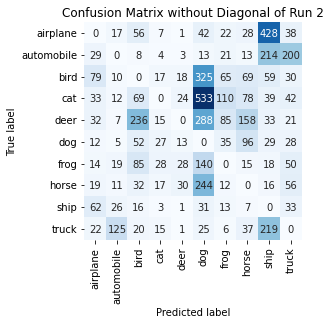

Summing down the rows, for Predictions of each Class that were wrong:  [ 302.  232.  574.  133.  119. 1641.  369.  501. 1055.  498.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  30.0 times
Summing across the columns, for total number of that True Class misidentified:  [639. 505. 672. 940. 875. 297. 397. 437. 192. 470.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  288.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3 on Dataset D

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast

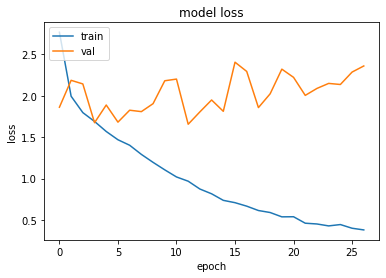

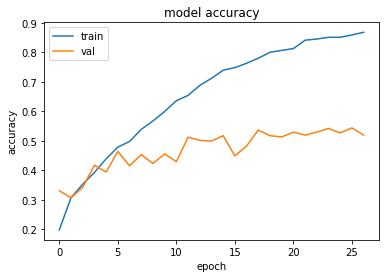

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.6557700634002686 , and Val Acc happened to be 0.5123000144958496
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5440000295639038 and Val Loss happened to be  2.2850654125213623
TestLoss:  1.646956205368042  TestAcc: 0.5080000162124634
truck 0.725
ship 0.688
dog 0.643
frog 0.64
horse 0.583
airplane 0.452
deer 0.441
automobile 0.435
cat 0.259
bird 0.214


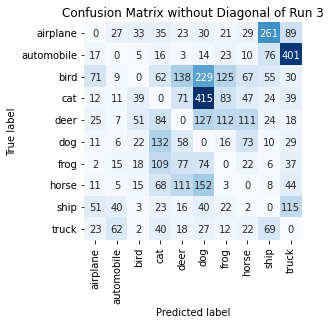

Summing down the rows, for Predictions of each Class that were wrong:  [ 223.  182.  188.  569.  515. 1108.  417.  383.  533.  802.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  138.0 times
Summing across the columns, for total number of that True Class misidentified:  [548. 565. 786. 741. 559. 357. 360. 417. 312. 275.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  127.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4 on Dataset D

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 

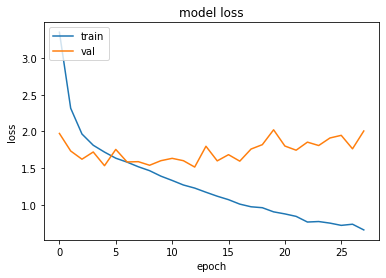

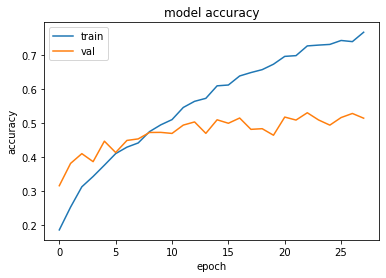

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.5151629447937012 , and Val Acc happened to be 0.5044000148773193
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5314000248908997 and Val Loss happened to be  1.8543710708618164
TestLoss:  1.4938397407531738  TestAcc: 0.5067999958992004
frog 0.804
ship 0.732
truck 0.622
horse 0.605
dog 0.547
airplane 0.517
automobile 0.413
bird 0.341
deer 0.309
cat 0.178


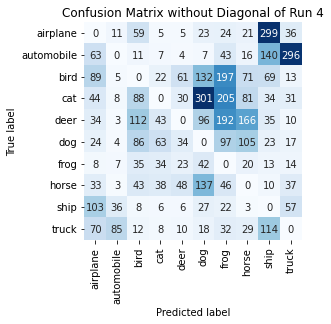

Summing down the rows, for Predictions of each Class that were wrong:  [468. 162. 454. 226. 221. 783. 858. 512. 737. 511.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  61.0 times
Summing across the columns, for total number of that True Class misidentified:  [483. 587. 659. 822. 691. 453. 196. 395. 268. 378.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  192.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5 on Dataset D

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )

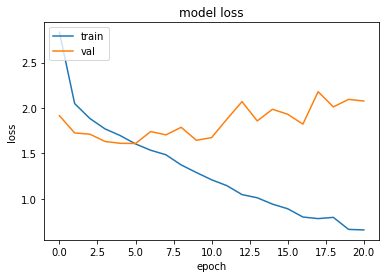

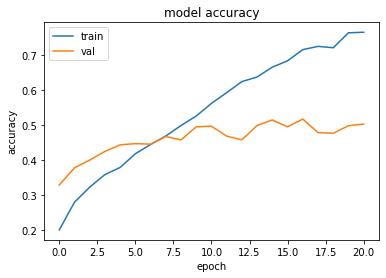

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6100668907165527 , and Val Acc happened to be 0.4471000134944916
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.517300009727478 and Val Loss happened to be  1.8230371475219727
TestLoss:  1.599244236946106  TestAcc: 0.45350000262260437
frog 0.842
ship 0.662
truck 0.586
horse 0.557
airplane 0.477
bird 0.44
dog 0.391
automobile 0.298
deer 0.222
cat 0.06


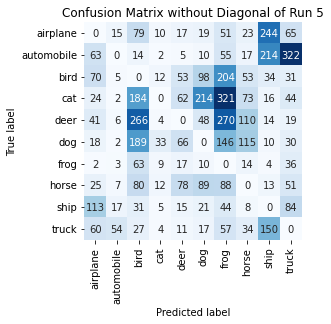

Summing down the rows, for Predictions of each Class that were wrong:  [ 416.  111.  933.   91.  324.  526. 1236.  447.  699.  682.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  78.0 times
Summing across the columns, for total number of that True Class misidentified:  [523. 702. 560. 940. 778. 609. 158. 443. 338. 414.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  270.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6 on Dataset D

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contras

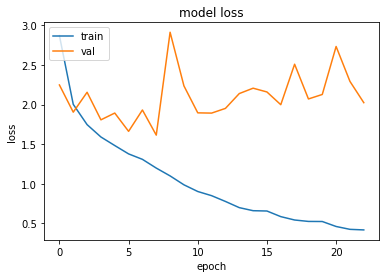

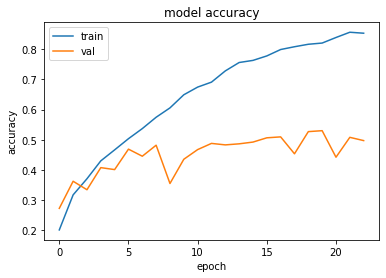

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.6141254901885986 , and Val Acc happened to be 0.4821999967098236
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5303000211715698 and Val Loss happened to be  2.127370595932007
TestLoss:  1.5995912551879883  TestAcc: 0.4819999933242798
frog 0.803
ship 0.795
truck 0.676
dog 0.655
horse 0.588
airplane 0.313
automobile 0.302
deer 0.26
bird 0.221
cat 0.207


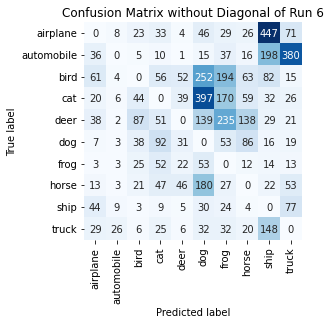

Summing down the rows, for Predictions of each Class that were wrong:  [ 251.   64.  252.  375.  206. 1144.  801.  424.  988.  675.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  52.0 times
Summing across the columns, for total number of that True Class misidentified:  [687. 698. 779. 793. 740. 345. 197. 412. 205. 324.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  235.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7 on Dataset D

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contr

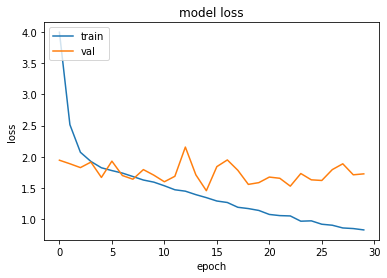

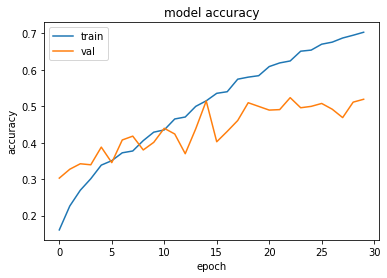

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.4562883377075195 , and Val Acc happened to be 0.5144000053405762
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5235000252723694 and Val Loss happened to be  1.5291417837142944
TestLoss:  1.4467949867248535  TestAcc: 0.5149000287055969
ship 0.819
horse 0.716
frog 0.681
truck 0.636
automobile 0.534
dog 0.516
bird 0.422
deer 0.34
airplane 0.332
cat 0.153


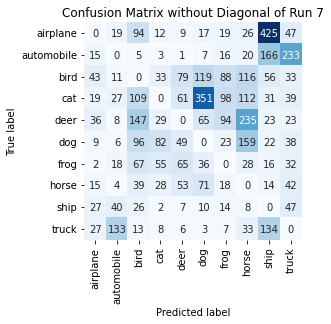

Summing down the rows, for Predictions of each Class that were wrong:  [193. 266. 596. 252. 330. 679. 377. 737. 887. 534.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  79.0 times
Summing across the columns, for total number of that True Class misidentified:  [668. 466. 578. 847. 660. 484. 319. 284. 181. 364.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  235.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8 on Dataset D

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )


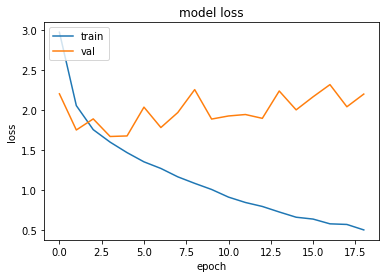

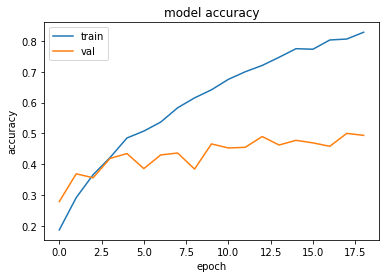

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6668370962142944 , and Val Acc happened to be 0.41929998993873596
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5002999901771545 and Val Loss happened to be  2.0387022495269775
TestLoss:  1.651633381843567  TestAcc: 0.41530001163482666
dog 0.67
frog 0.652
horse 0.646
truck 0.616
ship 0.613
automobile 0.286
deer 0.257
airplane 0.225
bird 0.17
cat 0.018


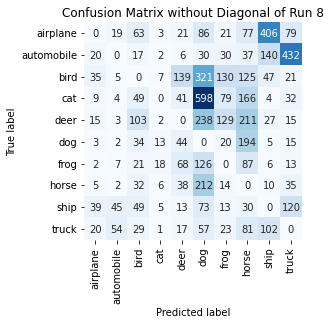

Summing down the rows, for Predictions of each Class that were wrong:  [ 148.  141.  397.   57.  387. 1741.  459. 1008.  747.  762.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [775. 714. 830. 982. 743. 330. 348. 354. 387. 384.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  238.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9 on Dataset D

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 

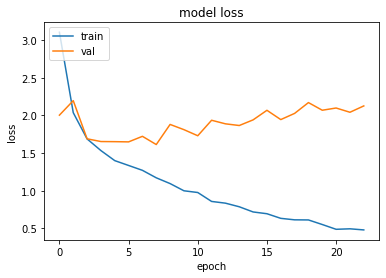

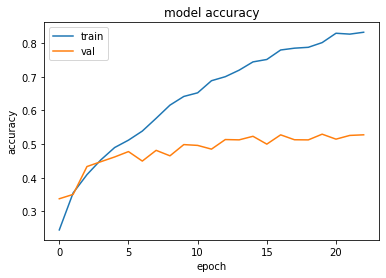

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.6128462553024292 , and Val Acc happened to be 0.4812999963760376
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5293999910354614 and Val Loss happened to be  2.068352699279785
TestLoss:  1.5858995914459229  TestAcc: 0.4921000003814697
horse 0.727
ship 0.62
dog 0.589
truck 0.589
frog 0.585
automobile 0.461
deer 0.422
bird 0.415
airplane 0.361
cat 0.152


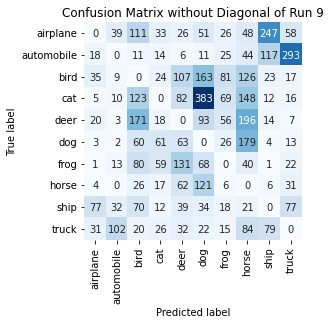

Summing down the rows, for Predictions of each Class that were wrong:  [194. 210. 672. 264. 548. 946. 322. 886. 503. 534.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  131.0 times
Summing across the columns, for total number of that True Class misidentified:  [639. 539. 585. 848. 578. 411. 415. 273. 380. 411.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  196.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10 on Dataset D

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0

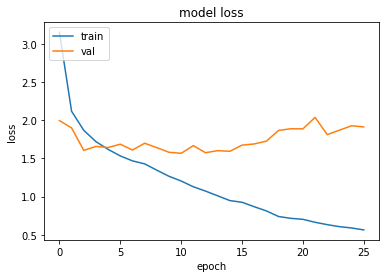

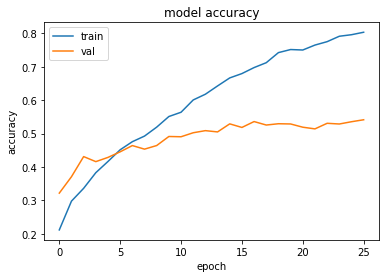

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.567266821861267 , and Val Acc happened to be 0.49059998989105225
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5414999723434448 and Val Loss happened to be  1.9131250381469727
TestLoss:  1.5368784666061401  TestAcc: 0.5011000037193298
truck 0.776
frog 0.74
ship 0.709
horse 0.593
deer 0.51
airplane 0.477
dog 0.454
bird 0.296
automobile 0.257
cat 0.199


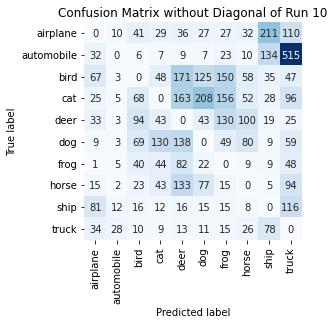

Summing down the rows, for Predictions of each Class that were wrong:  [ 297.   71.  367.  365.  761.  535.  580.  375.  528. 1110.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  171.0 times
Summing across the columns, for total number of that True Class misidentified:  [523. 743. 704. 801. 490. 546. 260. 407. 291. 224.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  130.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11 on Dataset D

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:  

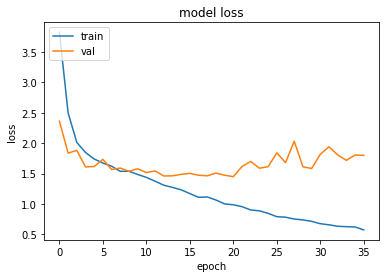

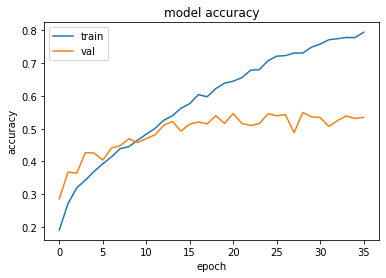

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.450066089630127 , and Val Acc happened to be 0.5464000105857849
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5497000217437744 and Val Loss happened to be  1.6127413511276245
TestLoss:  1.4326049089431763  TestAcc: 0.5526999831199646
ship 0.783
frog 0.698
horse 0.694
truck 0.639
automobile 0.595
airplane 0.579
deer 0.491
dog 0.484
cat 0.312
bird 0.252


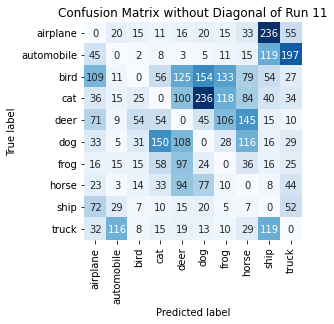

Summing down the rows, for Predictions of each Class that were wrong:  [437. 223. 171. 395. 577. 594. 436. 544. 623. 473.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  125.0 times
Summing across the columns, for total number of that True Class misidentified:  [421. 405. 748. 688. 509. 516. 302. 306. 217. 361.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  145.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12 on Dataset D

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   

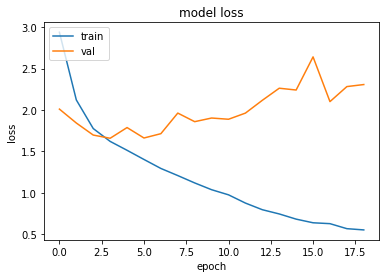

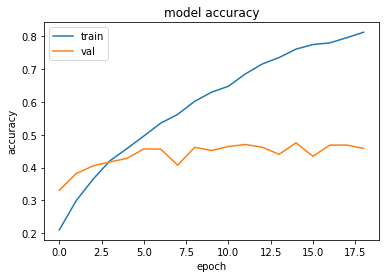

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6591910123825073 , and Val Acc happened to be 0.4174000024795532
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.47540000081062317 and Val Loss happened to be  2.2412726879119873
TestLoss:  1.65236234664917  TestAcc: 0.42879998683929443
frog 0.806
ship 0.749
horse 0.637
truck 0.476
automobile 0.442
dog 0.418
deer 0.235
bird 0.221
airplane 0.179
cat 0.125


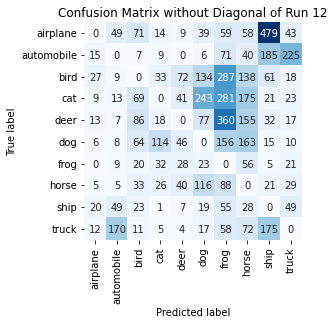

Summing down the rows, for Predictions of each Class that were wrong:  [ 107.  319.  384.  252.  247.  674. 1415.  885.  994.  435.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  72.0 times
Summing across the columns, for total number of that True Class misidentified:  [821. 558. 779. 875. 765. 582. 194. 363. 251. 524.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  360.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13 on Dataset D

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
Zo

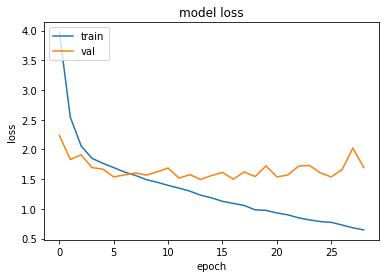

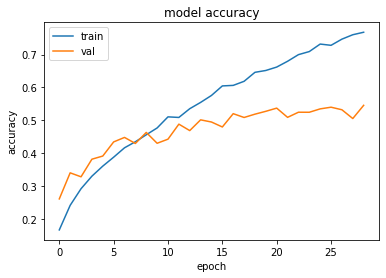

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.494802474975586 , and Val Acc happened to be 0.5015000104904175
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5457000136375427 and Val Loss happened to be  1.6945219039916992
TestLoss:  1.4801913499832153  TestAcc: 0.5045999884605408
horse 0.693
truck 0.69
automobile 0.651
dog 0.615
ship 0.612
frog 0.6
airplane 0.357
deer 0.352
bird 0.251
cat 0.225


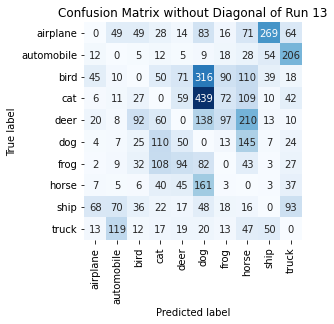

Summing down the rows, for Predictions of each Class that were wrong:  [ 177.  288.  284.  447.  374. 1296.  340.  779.  448.  521.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  94.0 times
Summing across the columns, for total number of that True Class misidentified:  [643. 349. 749. 775. 648. 385. 400. 307. 388. 310.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  210.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14 on Dataset D

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )

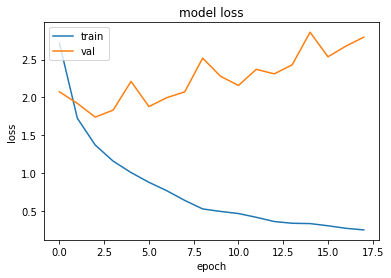

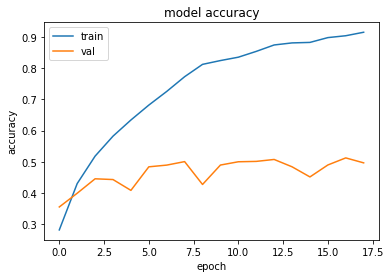

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.739003300666809 , and Val Acc happened to be 0.44530001282691956
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5123000144958496 and Val Loss happened to be  2.677847146987915
TestLoss:  1.7234516143798828  TestAcc: 0.4489000141620636
ship 0.731
frog 0.721
dog 0.563
truck 0.56
horse 0.53
deer 0.44
automobile 0.345
airplane 0.292
cat 0.207
bird 0.1


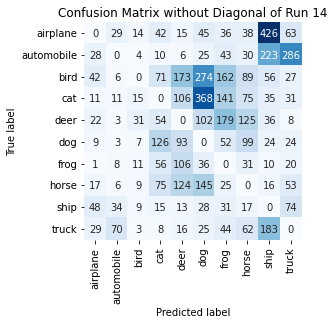

Summing down the rows, for Predictions of each Class that were wrong:  [ 207.  170.  103.  457.  652. 1048.  713.  566. 1009.  586.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  173.0 times
Summing across the columns, for total number of that True Class misidentified:  [708. 655. 900. 793. 560. 437. 279. 470. 269. 440.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  179.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15 on Dataset D

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16

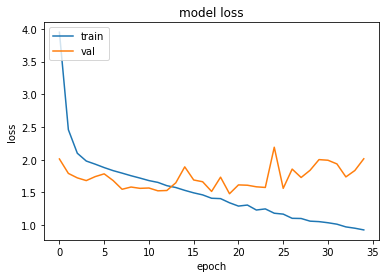

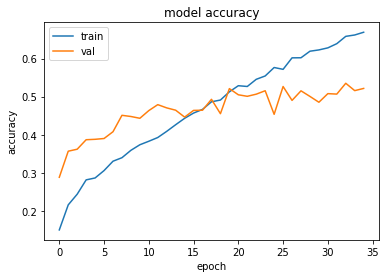

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.4798223972320557 , and Val Acc happened to be 0.5210000276565552
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5350000262260437 and Val Loss happened to be  1.7370980978012085
TestLoss:  1.475650429725647  TestAcc: 0.5236999988555908
frog 0.847
ship 0.656
truck 0.642
horse 0.599
automobile 0.548
dog 0.522
airplane 0.501
deer 0.367
bird 0.296
cat 0.259


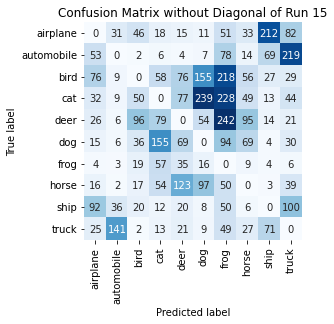

Summing down the rows, for Predictions of each Class that were wrong:  [ 339.  243.  288.  452.  440.  596. 1060.  358.  417.  570.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  123.0 times
Summing across the columns, for total number of that True Class misidentified:  [499. 452. 704. 741. 633. 478. 153. 401. 344. 358.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  242.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16 on Dataset D

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Z

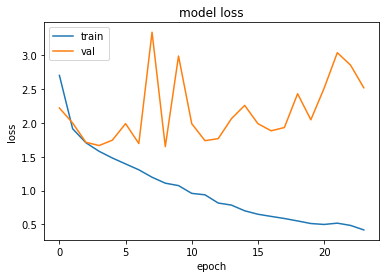

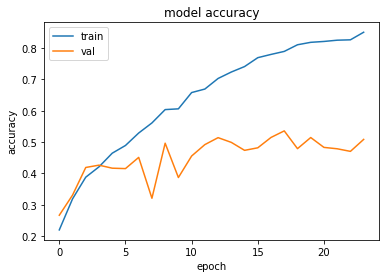

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.6509431600570679 , and Val Acc happened to be 0.4964999854564667
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5357999801635742 and Val Loss happened to be  1.9333937168121338
TestLoss:  1.6576179265975952  TestAcc: 0.49399998784065247
ship 0.783
frog 0.741
dog 0.71
truck 0.615
automobile 0.548
horse 0.473
deer 0.414
airplane 0.329
cat 0.164
bird 0.163


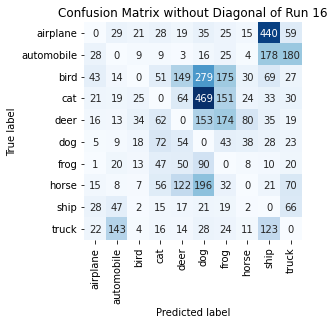

Summing down the rows, for Predictions of each Class that were wrong:  [ 179.  302.  133.  356.  492. 1287.  668.  212.  937.  494.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  149.0 times
Summing across the columns, for total number of that True Class misidentified:  [671. 452. 837. 836. 586. 290. 259. 527. 217. 385.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  174.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17 on Dataset D

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -

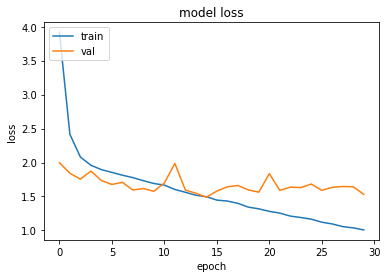

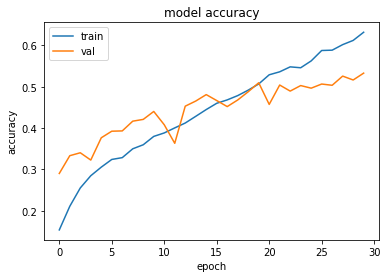

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.4896069765090942 , and Val Acc happened to be 0.48100000619888306
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5329999923706055 and Val Loss happened to be  1.5300943851470947
TestLoss:  1.4705246686935425  TestAcc: 0.4837000072002411
frog 0.772
ship 0.767
dog 0.71
truck 0.554
automobile 0.537
horse 0.511
airplane 0.417
deer 0.235
bird 0.219
cat 0.115


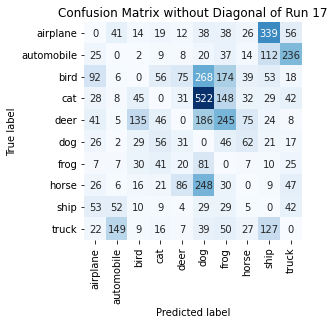

Summing down the rows, for Predictions of each Class that were wrong:  [ 320.  276.  290.  273.  274. 1431.  797.  287.  724.  491.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  86.0 times
Summing across the columns, for total number of that True Class misidentified:  [583. 463. 781. 885. 765. 290. 228. 489. 233. 446.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  245.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18 on Dataset D

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

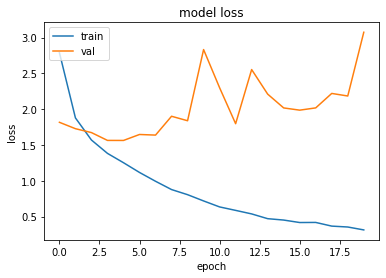

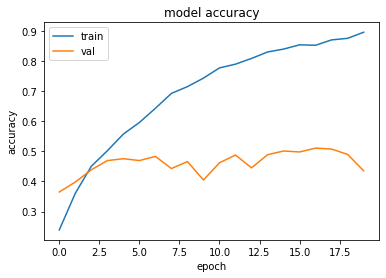

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5630031824111938 , and Val Acc happened to be 0.4754999876022339
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.510699987411499 and Val Loss happened to be  2.0176384449005127
TestLoss:  1.5505318641662598  TestAcc: 0.47940000891685486
horse 0.686
frog 0.682
truck 0.661
dog 0.555
ship 0.523
airplane 0.485
deer 0.471
automobile 0.432
bird 0.198
cat 0.101


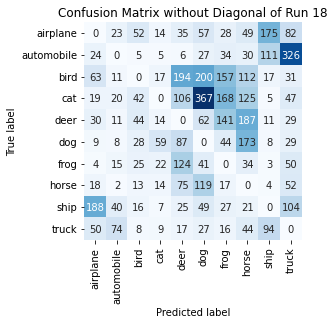

Summing down the rows, for Predictions of each Class that were wrong:  [405. 204. 233. 161. 669. 949. 632. 775. 428. 750.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  194.0 times
Summing across the columns, for total number of that True Class misidentified:  [515. 568. 802. 899. 529. 445. 318. 314. 477. 339.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  187.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19 on Dataset D

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

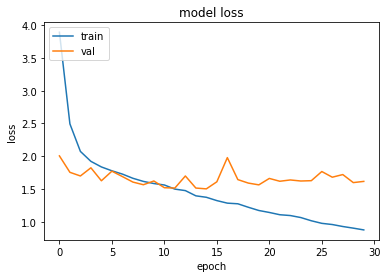

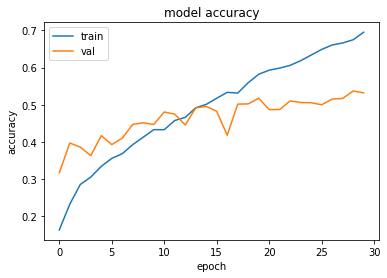

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.5022764205932617 , and Val Acc happened to be 0.4957999885082245
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5371000170707703 and Val Loss happened to be  1.5978541374206543
TestLoss:  1.454248309135437  TestAcc: 0.5020999908447266
frog 0.748
truck 0.661
dog 0.65
ship 0.615
horse 0.538
automobile 0.497
bird 0.369
airplane 0.357
deer 0.355
cat 0.231


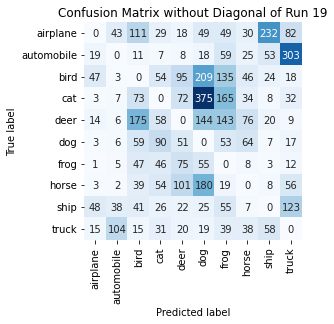

Summing down the rows, for Predictions of each Class that were wrong:  [ 153.  214.  571.  395.  462. 1074.  717.  328.  413.  652.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  101.0 times
Summing across the columns, for total number of that True Class misidentified:  [643. 503. 631. 769. 645. 350. 252. 462. 385. 339.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  175.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20 on Dataset D

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:  

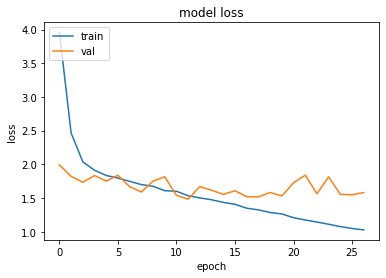

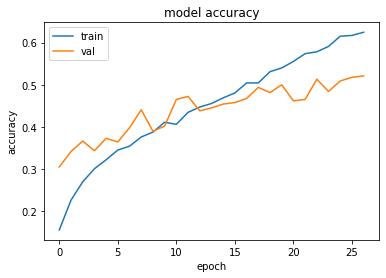

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.4836713075637817 , and Val Acc happened to be 0.4722999930381775
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5210000276565552 and Val Loss happened to be  1.5806423425674438
TestLoss:  1.4532361030578613  TestAcc: 0.4781000018119812
ship 0.688
frog 0.686
horse 0.644
truck 0.642
dog 0.521
automobile 0.424
deer 0.406
airplane 0.371
bird 0.287
cat 0.112


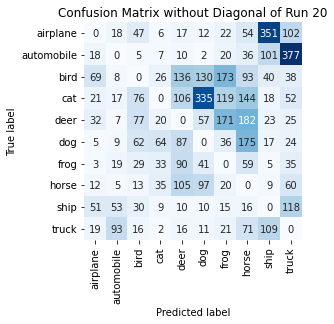

Summing down the rows, for Predictions of each Class that were wrong:  [230. 229. 355. 202. 577. 695. 597. 830. 673. 831.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  136.0 times
Summing across the columns, for total number of that True Class misidentified:  [629. 576. 713. 888. 594. 479. 314. 356. 312. 358.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  182.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21 on Dataset D

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

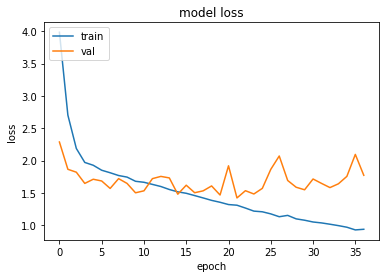

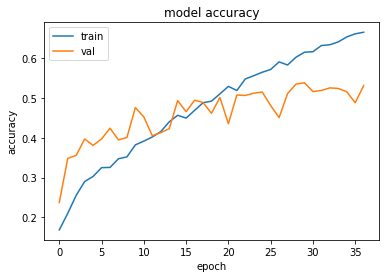

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.4215354919433594 , and Val Acc happened to be 0.5073000192642212
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.538100004196167 and Val Loss happened to be  1.5477324724197388
TestLoss:  1.402904748916626  TestAcc: 0.5062000155448914
ship 0.724
truck 0.661
dog 0.619
frog 0.58
horse 0.578
automobile 0.473
deer 0.468
airplane 0.417
bird 0.359
cat 0.183


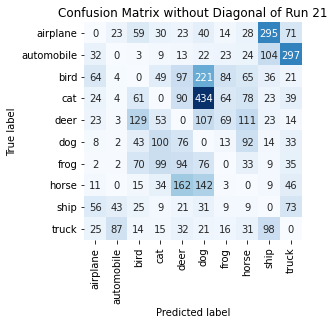

Summing down the rows, for Predictions of each Class that were wrong:  [ 245.  168.  419.  398.  608. 1094.  295.  471.  611.  629.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  162.0 times
Summing across the columns, for total number of that True Class misidentified:  [583. 527. 641. 817. 532. 381. 420. 422. 276. 339.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  129.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22 on Dataset D

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   (

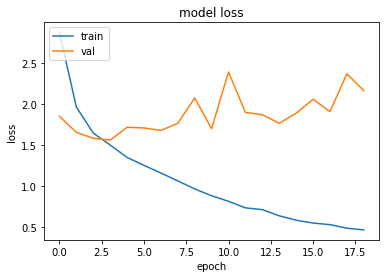

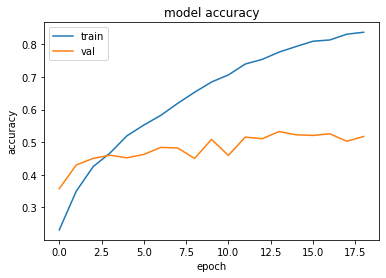

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.5583484172821045 , and Val Acc happened to be 0.46000000834465027
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.5327000021934509 and Val Loss happened to be  1.7634650468826294
TestLoss:  1.560124158859253  TestAcc: 0.45980000495910645
frog 0.834
ship 0.737
truck 0.686
horse 0.605
dog 0.434
automobile 0.369
cat 0.286
airplane 0.243
deer 0.212
bird 0.192


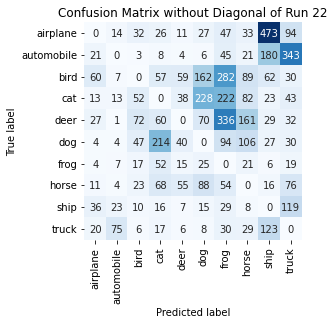

Summing down the rows, for Predictions of each Class that were wrong:  [ 196.  148.  262.  518.  235.  629. 1139.  550.  939.  786.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  59.0 times
Summing across the columns, for total number of that True Class misidentified:  [757. 631. 808. 714. 788. 566. 166. 395. 263. 314.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  336.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23 on Dataset D

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

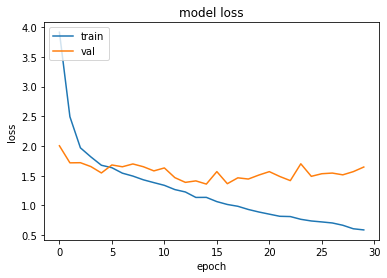

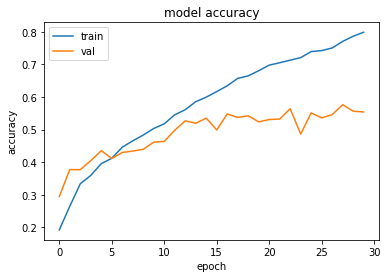

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.3586902618408203 , and Val Acc happened to be 0.5353000164031982
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5766000151634216 and Val Loss happened to be  1.5143831968307495
TestLoss:  1.3370132446289062  TestAcc: 0.5317999720573425
ship 0.798
truck 0.745
frog 0.742
horse 0.581
dog 0.536
deer 0.487
automobile 0.483
airplane 0.407
bird 0.323
cat 0.216


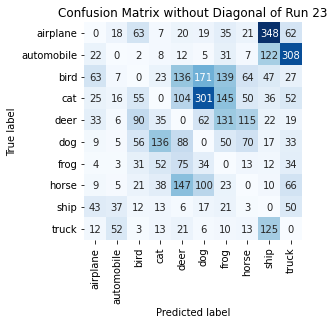

Summing down the rows, for Predictions of each Class that were wrong:  [220. 149. 333. 325. 609. 715. 585. 356. 739. 651.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [593. 517. 677. 784. 513. 464. 258. 419. 202. 255.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  131.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24 on Dataset D

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0

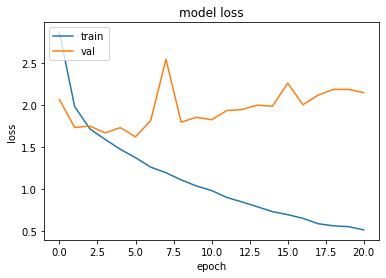

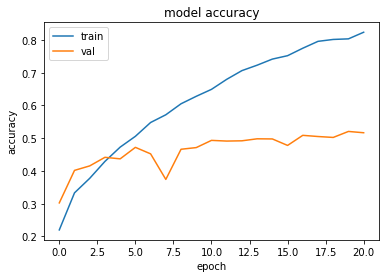

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.623840570449829 , and Val Acc happened to be 0.47209998965263367
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5206999778747559 and Val Loss happened to be  2.1897475719451904
TestLoss:  1.609458327293396  TestAcc: 0.4708000123500824
frog 0.856
ship 0.705
horse 0.606
truck 0.578
dog 0.576
automobile 0.417
deer 0.329
bird 0.285
airplane 0.261
cat 0.095


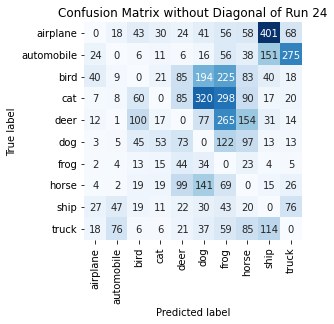

Summing down the rows, for Predictions of each Class that were wrong:  [ 137.  170.  311.  183.  459.  890. 1193.  648.  786.  515.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  99.0 times
Summing across the columns, for total number of that True Class misidentified:  [739. 583. 715. 905. 671. 424. 144. 394. 295. 422.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  265.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25 on Dataset D

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0

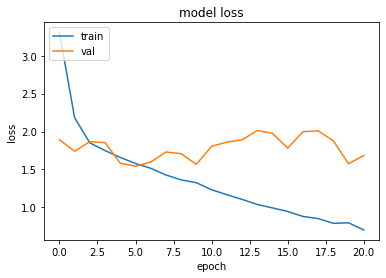

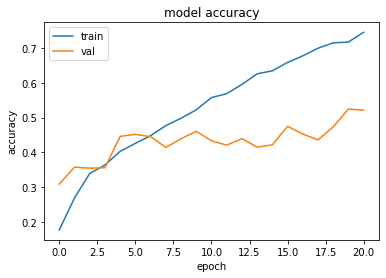

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5427165031433105 , and Val Acc happened to be 0.45190000534057617
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5246000289916992 and Val Loss happened to be  1.5761150121688843
TestLoss:  1.5342621803283691  TestAcc: 0.4553000032901764
frog 0.685
horse 0.678
truck 0.671
ship 0.653
dog 0.58
automobile 0.572
deer 0.352
airplane 0.205
cat 0.087
bird 0.07


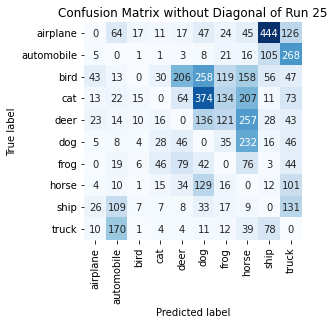

Summing down the rows, for Predictions of each Class that were wrong:  [ 129.  429.   62.  158.  461. 1038.  499. 1039.  753.  879.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  206.0 times
Summing across the columns, for total number of that True Class misidentified:  [795. 428. 930. 913. 648. 420. 315. 322. 347. 329.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  257.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26 on Dataset D

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -

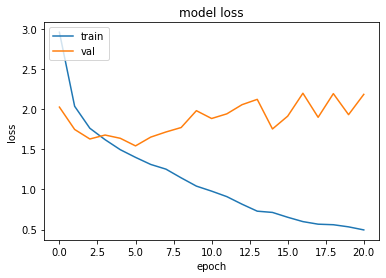

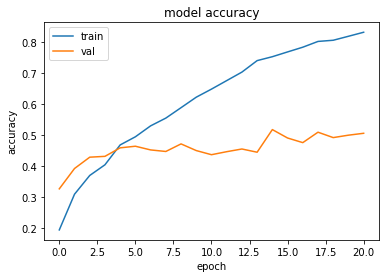

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5432616472244263 , and Val Acc happened to be 0.4641999900341034
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.517799973487854 and Val Loss happened to be  1.7542511224746704
TestLoss:  1.5409822463989258  TestAcc: 0.46860000491142273
frog 0.814
ship 0.745
dog 0.579
horse 0.546
truck 0.488
automobile 0.454
deer 0.293
airplane 0.29
bird 0.265
cat 0.212


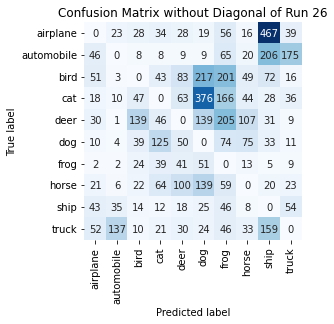

Summing down the rows, for Predictions of each Class that were wrong:  [ 273.  221.  331.  392.  422.  999.  918.  365. 1021.  372.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  100.0 times
Summing across the columns, for total number of that True Class misidentified:  [710. 546. 735. 788. 707. 421. 186. 454. 255. 512.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  205.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27 on Dataset D

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Z

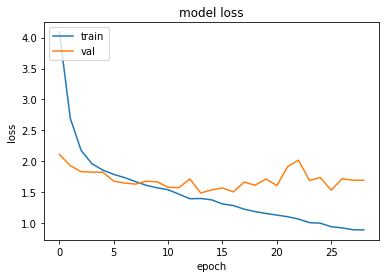

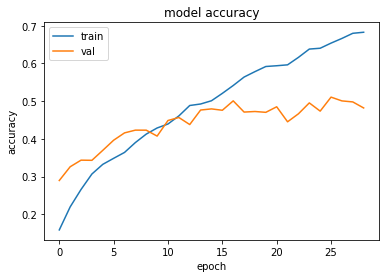

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.486633062362671 , and Val Acc happened to be 0.4763999879360199
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5105999708175659 and Val Loss happened to be  1.5330688953399658
TestLoss:  1.4698373079299927  TestAcc: 0.46880000829696655
ship 0.7
dog 0.699
automobile 0.657
frog 0.603
horse 0.595
truck 0.498
bird 0.324
airplane 0.251
deer 0.22
cat 0.141


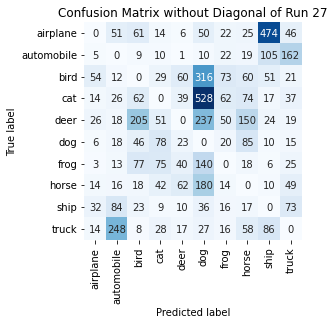

Summing down the rows, for Predictions of each Class that were wrong:  [ 168.  486.  509.  336.  258. 1524.  295.  506.  783.  447.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  62.0 times
Summing across the columns, for total number of that True Class misidentified:  [749. 343. 676. 859. 780. 301. 397. 405. 300. 502.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  237.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28 on Dataset D

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

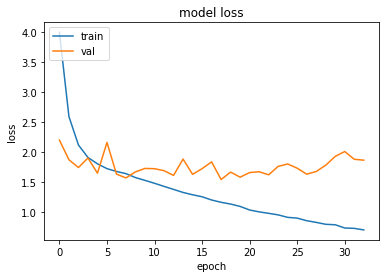

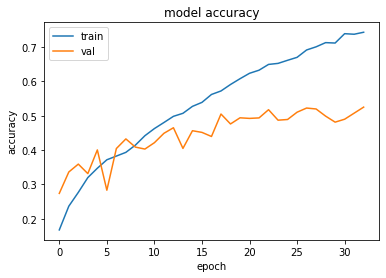

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.5476353168487549 , and Val Acc happened to be 0.5048999786376953
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5249999761581421 and Val Loss happened to be  1.868998646736145
TestLoss:  1.5322617292404175  TestAcc: 0.5037999749183655
frog 0.819
truck 0.67
horse 0.573
ship 0.562
automobile 0.553
airplane 0.52
dog 0.499
deer 0.41
bird 0.236
cat 0.196


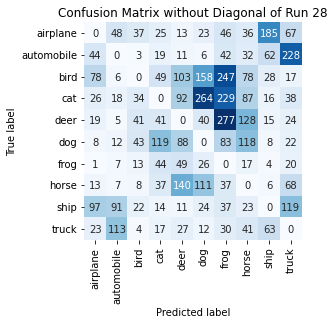

Summing down the rows, for Predictions of each Class that were wrong:  [ 309.  307.  205.  365.  534.  664. 1028.  560.  387.  603.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  140.0 times
Summing across the columns, for total number of that True Class misidentified:  [480. 447. 764. 804. 590. 501. 181. 427. 438. 330.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  277.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29 on Dataset D

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

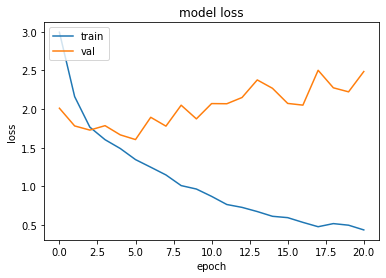

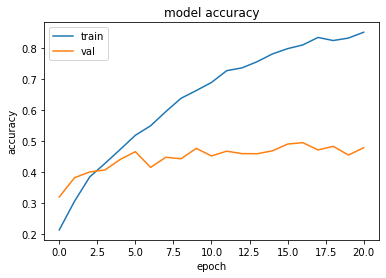

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6049498319625854 , and Val Acc happened to be 0.4666000008583069
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.49570000171661377 and Val Loss happened to be  2.05106520652771
TestLoss:  1.5862678289413452  TestAcc: 0.46709999442100525
frog 0.798
dog 0.606
horse 0.564
ship 0.564
airplane 0.516
automobile 0.449
truck 0.376
deer 0.354
bird 0.291
cat 0.153


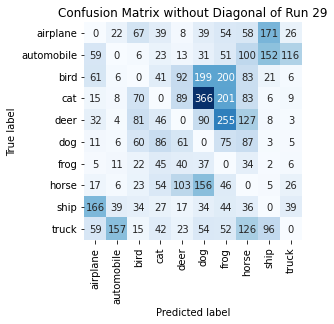

Summing down the rows, for Predictions of each Class that were wrong:  [ 425.  259.  378.  403.  446. 1006.  978.  734.  464.  236.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  103.0 times
Summing across the columns, for total number of that True Class misidentified:  [484. 551. 709. 847. 646. 394. 202. 436. 436. 624.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  255.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30 on Dataset D

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:  

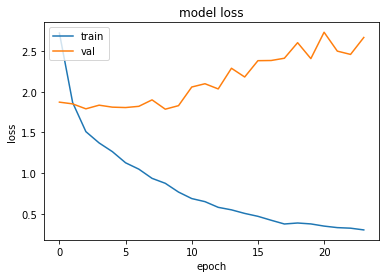

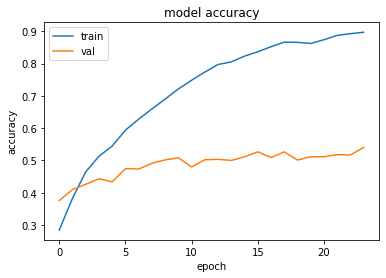

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.78515625 , and Val Acc happened to be 0.5016999840736389
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5400000214576721 and Val Loss happened to be  2.6660354137420654
TestLoss:  1.778275728225708  TestAcc: 0.5013999938964844
frog 0.798
ship 0.632
horse 0.628
truck 0.615
automobile 0.611
dog 0.455
airplane 0.414
deer 0.401
bird 0.283
cat 0.177


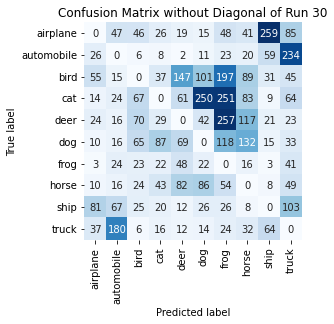

Summing down the rows, for Predictions of each Class that were wrong:  [260. 405. 332. 288. 452. 567. 998. 538. 469. 677.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [586. 389. 717. 823. 599. 545. 202. 372. 368. 385.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  257.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31 on Dataset D

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

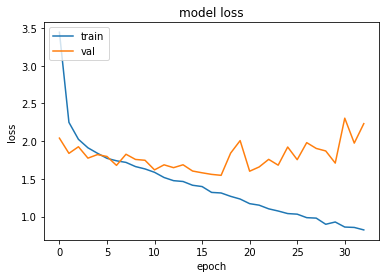

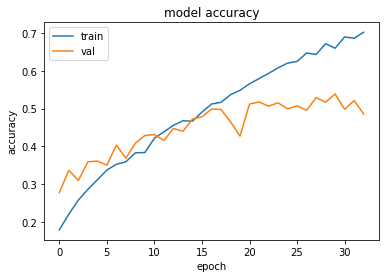

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.546628475189209 , and Val Acc happened to be 0.4977000057697296
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5385000109672546 and Val Loss happened to be  1.7090296745300293
TestLoss:  1.5237735509872437  TestAcc: 0.5044999718666077
automobile 0.775
frog 0.758
ship 0.729
dog 0.665
horse 0.596
truck 0.503
airplane 0.393
deer 0.245
bird 0.211
cat 0.17


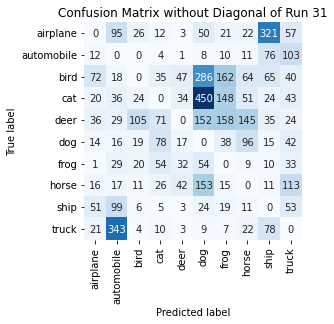

Summing down the rows, for Predictions of each Class that were wrong:  [ 243.  682.  215.  295.  182. 1186.  578.  431.  635.  508.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  47.0 times
Summing across the columns, for total number of that True Class misidentified:  [607. 225. 789. 830. 755. 335. 242. 404. 271. 497.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  158.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32 on Dataset D

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

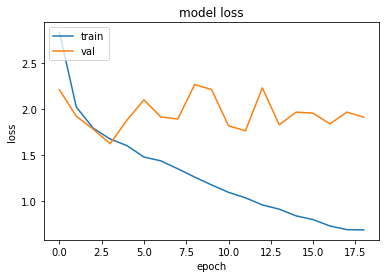

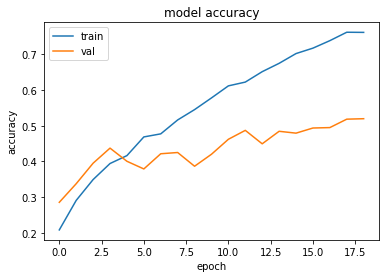

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6244533061981201 , and Val Acc happened to be 0.43720000982284546
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5196999907493591 and Val Loss happened to be  1.912939429283142
TestLoss:  1.6004269123077393  TestAcc: 0.43779999017715454
frog 0.83
ship 0.609
horse 0.561
dog 0.542
truck 0.54
airplane 0.44
automobile 0.346
bird 0.225
cat 0.156
deer 0.129


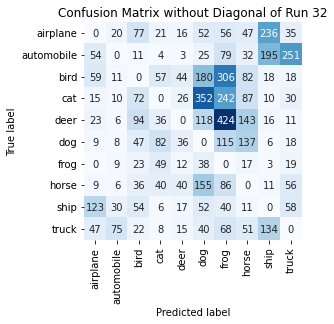

Summing down the rows, for Predictions of each Class that were wrong:  [ 339.  175.  436.  303.  209. 1012. 1416.  607.  629.  496.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  44.0 times
Summing across the columns, for total number of that True Class misidentified:  [560. 654. 775. 844. 871. 458. 170. 439. 391. 460.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  424.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33 on Dataset D

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

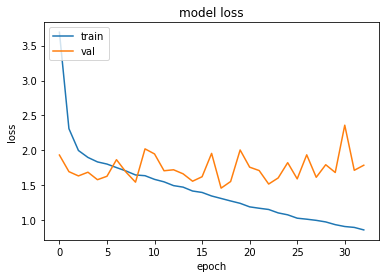

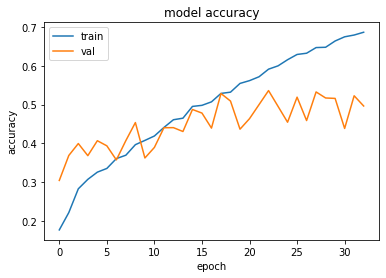

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.4604949951171875 , and Val Acc happened to be 0.5285999774932861
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5360999703407288 and Val Loss happened to be  1.5190106630325317
TestLoss:  1.4490952491760254  TestAcc: 0.5271999835968018
frog 0.833
airplane 0.649
ship 0.646
horse 0.643
truck 0.591
automobile 0.574
dog 0.565
deer 0.39
bird 0.217
cat 0.164


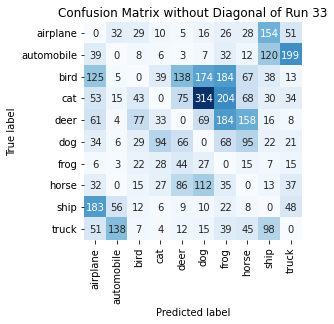

Summing down the rows, for Predictions of each Class that were wrong:  [584. 259. 242. 247. 438. 744. 794. 496. 498. 426.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  138.0 times
Summing across the columns, for total number of that True Class misidentified:  [351. 426. 783. 836. 610. 435. 167. 357. 354. 409.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  184.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34 on Dataset D

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0

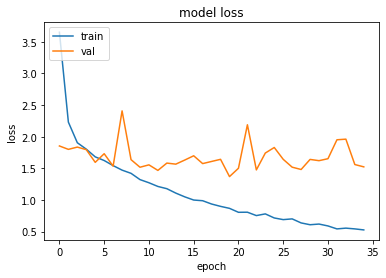

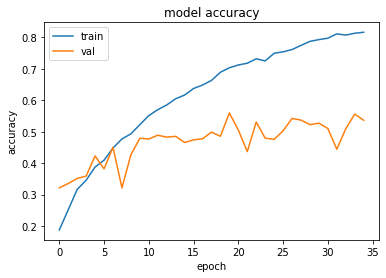

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.3686985969543457 , and Val Acc happened to be 0.559499979019165
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.559499979019165 and Val Loss happened to be  1.3686985969543457
TestLoss:  1.3546695709228516  TestAcc: 0.5573999881744385
truck 0.755
frog 0.714
ship 0.71
deer 0.625
horse 0.624
automobile 0.567
airplane 0.462
dog 0.452
bird 0.377
cat 0.288


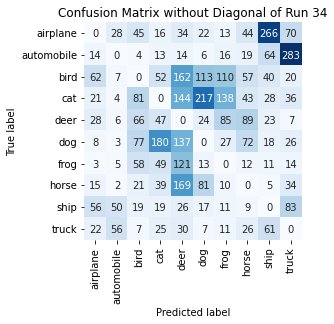

Summing down the rows, for Predictions of each Class that were wrong:  [229. 161. 378. 440. 837. 500. 421. 371. 516. 573.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  169.0 times
Summing across the columns, for total number of that True Class misidentified:  [538. 433. 623. 712. 375. 548. 286. 376. 290. 245.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  89.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35 on Dataset D

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

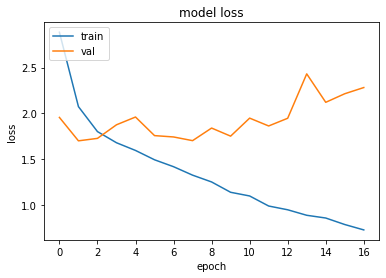

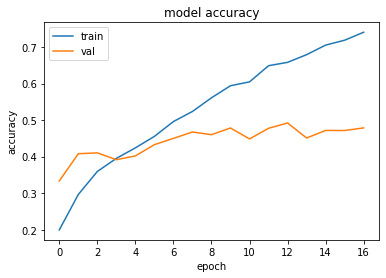

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  1 when  Val Loss was:  1.7012425661087036 , and Val Acc happened to be 0.40790000557899475
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.4921000003814697 and Val Loss happened to be  1.947509527206421
TestLoss:  1.6754101514816284  TestAcc: 0.4083000123500824
ship 0.703
frog 0.685
horse 0.559
truck 0.515
dog 0.482
automobile 0.38
airplane 0.334
deer 0.244
bird 0.111
cat 0.07


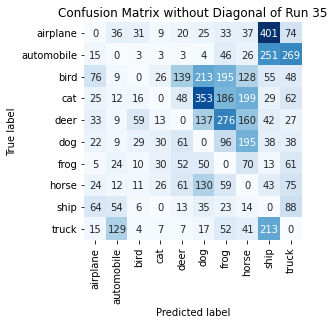

Summing down the rows, for Predictions of each Class that were wrong:  [ 279.  294.  169.  144.  404.  964.  966.  870. 1085.  742.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [666. 620. 889. 930. 756. 518. 315. 441. 297. 485.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  276.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36 on Dataset D

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

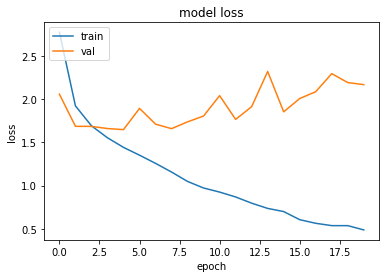

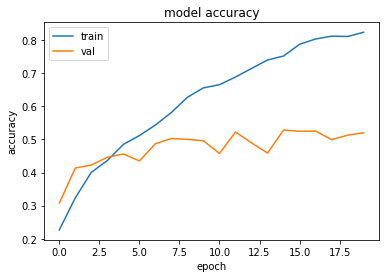

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.649031639099121 , and Val Acc happened to be 0.4560999870300293
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.5284000039100647 and Val Loss happened to be  1.8554054498672485
TestLoss:  1.637518048286438  TestAcc: 0.45890000462532043
frog 0.834
ship 0.71
dog 0.565
horse 0.525
automobile 0.512
truck 0.509
airplane 0.361
deer 0.33
cat 0.136
bird 0.107


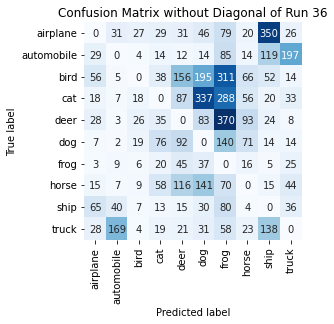

Summing down the rows, for Predictions of each Class that were wrong:  [ 249.  273.  120.  302.  575.  914. 1481.  363.  737.  397.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  156.0 times
Summing across the columns, for total number of that True Class misidentified:  [639. 488. 893. 864. 670. 435. 166. 475. 290. 491.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  370.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37 on Dataset D

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0

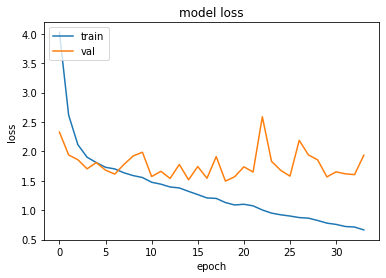

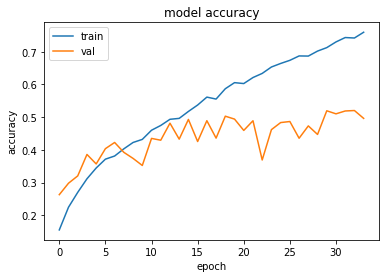

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.4939020872116089 , and Val Acc happened to be 0.5030999779701233
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5203999876976013 and Val Loss happened to be  1.6042057275772095
TestLoss:  1.478832483291626  TestAcc: 0.5047000050544739
frog 0.817
dog 0.771
ship 0.633
truck 0.61
automobile 0.586
horse 0.502
airplane 0.449
deer 0.346
bird 0.234
cat 0.099


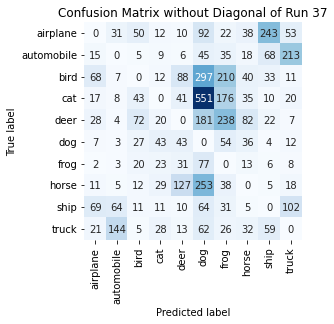

Summing down the rows, for Predictions of each Class that were wrong:  [ 238.  269.  245.  187.  369. 1622.  830.  299.  450.  444.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  127.0 times
Summing across the columns, for total number of that True Class misidentified:  [551. 414. 766. 901. 654. 229. 183. 498. 367. 390.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  238.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38 on Dataset D

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

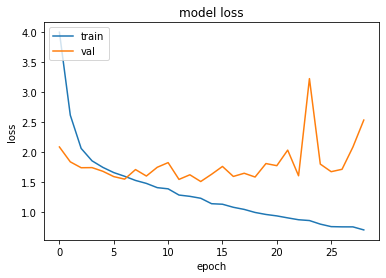

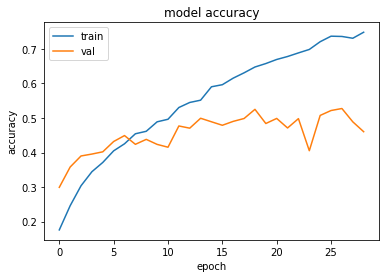

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.5050160884857178 , and Val Acc happened to be 0.499099999666214
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5273000001907349 and Val Loss happened to be  1.7087574005126953
TestLoss:  1.4738984107971191  TestAcc: 0.5092999935150146
frog 0.814
truck 0.747
ship 0.636
horse 0.608
automobile 0.578
dog 0.488
deer 0.419
airplane 0.355
bird 0.347
cat 0.101


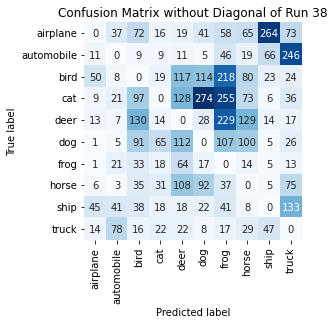

Summing down the rows, for Predictions of each Class that were wrong:  [ 150.  221.  521.  212.  599.  601. 1008.  517.  435.  643.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  128.0 times
Summing across the columns, for total number of that True Class misidentified:  [645. 422. 653. 899. 581. 512. 186. 392. 364. 253.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  229.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39 on Dataset D

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

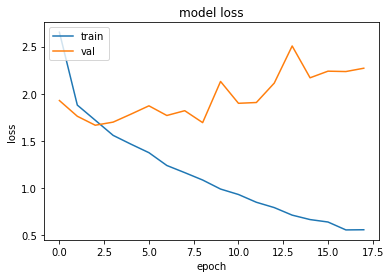

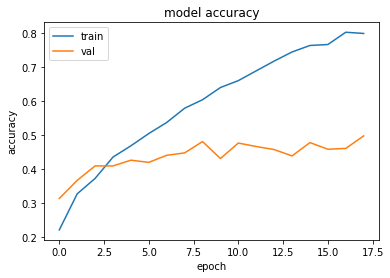

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.6659072637557983 , and Val Acc happened to be 0.40869998931884766
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.49720001220703125 and Val Loss happened to be  2.2702090740203857
TestLoss:  1.6450687646865845  TestAcc: 0.40470001101493835
frog 0.81
ship 0.706
automobile 0.567
truck 0.51
horse 0.483
dog 0.32
bird 0.252
deer 0.173
airplane 0.132
cat 0.094


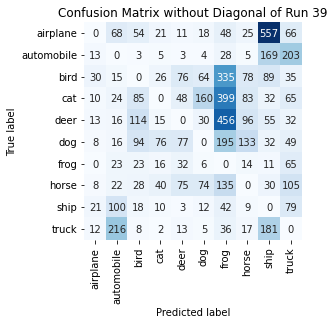

Summing down the rows, for Predictions of each Class that were wrong:  [ 115.  500.  427.  211.  338.  373. 1674.  460. 1156.  699.]
For example, the model predicted a  label 4 (deer) on a true   5  a total of  77.0 times
Summing across the columns, for total number of that True Class misidentified:  [868. 433. 748. 906. 827. 680. 190. 517. 294. 490.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  456.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40 on Dataset D

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

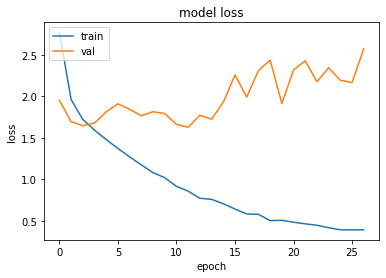

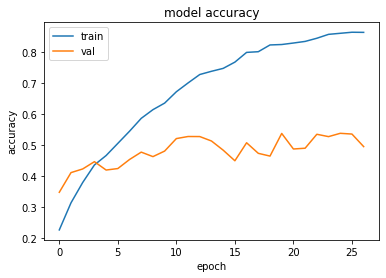

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.6275068521499634 , and Val Acc happened to be 0.5288000106811523
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5390999913215637 and Val Loss happened to be  2.1928281784057617
TestLoss:  1.6098185777664185  TestAcc: 0.5338000059127808
ship 0.796
truck 0.715
frog 0.678
horse 0.626
dog 0.578
deer 0.537
airplane 0.494
automobile 0.428
bird 0.252
cat 0.234


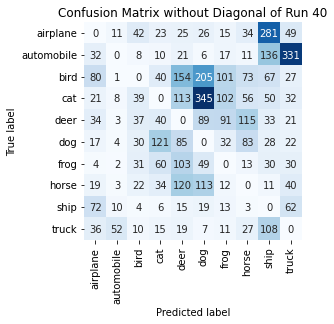

Summing down the rows, for Predictions of each Class that were wrong:  [315.  94. 223. 349. 655. 859. 394. 415. 744. 614.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  154.0 times
Summing across the columns, for total number of that True Class misidentified:  [506. 572. 748. 766. 463. 422. 322. 374. 204. 285.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  115.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41 on Dataset D

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

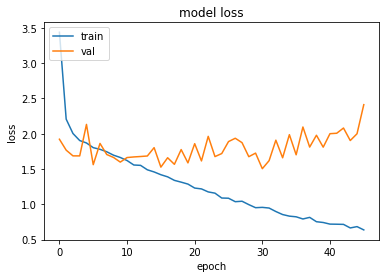

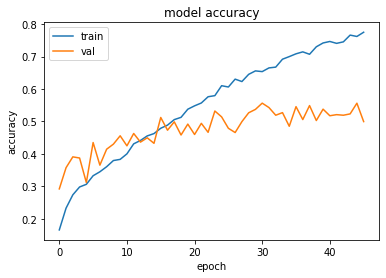

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.5037071704864502 , and Val Acc happened to be 0.5565000176429749
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5565000176429749 and Val Loss happened to be  1.5037071704864502
TestLoss:  1.4881240129470825  TestAcc: 0.5601999759674072
ship 0.71
frog 0.701
automobile 0.686
truck 0.663
horse 0.625
dog 0.595
deer 0.531
airplane 0.514
bird 0.317
cat 0.26


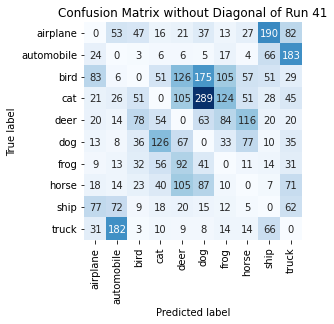

Summing down the rows, for Predictions of each Class that were wrong:  [296. 388. 282. 377. 551. 720. 412. 362. 452. 558.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  126.0 times
Summing across the columns, for total number of that True Class misidentified:  [486. 314. 683. 740. 469. 405. 299. 375. 290. 337.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  116.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42 on Dataset D

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

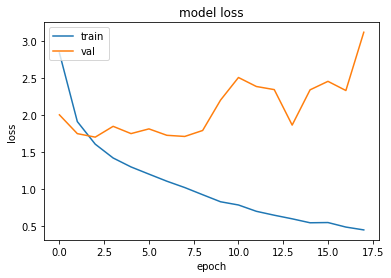

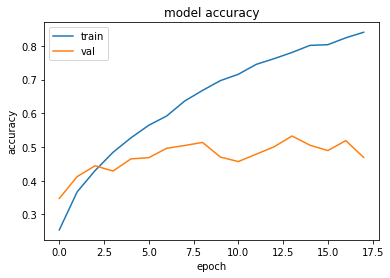

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7068654298782349 , and Val Acc happened to be 0.4442000091075897
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.5327000021934509 and Val Loss happened to be  1.8697586059570312
TestLoss:  1.7117117643356323  TestAcc: 0.44510000944137573
frog 0.777
ship 0.759
dog 0.614
horse 0.561
automobile 0.516
truck 0.335
airplane 0.33
bird 0.272
deer 0.183
cat 0.104


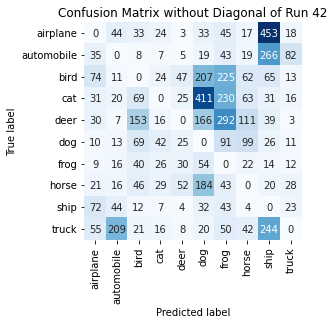

Summing down the rows, for Predictions of each Class that were wrong:  [ 337.  380.  451.  191.  199. 1126. 1062.  439. 1158.  206.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  52.0 times
Summing across the columns, for total number of that True Class misidentified:  [670. 484. 728. 896. 817. 386. 223. 439. 241. 665.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  292.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43 on Dataset D

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.

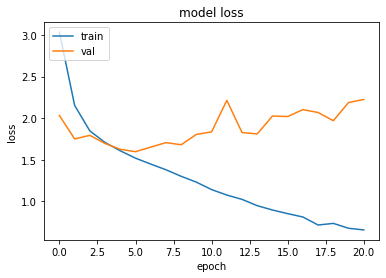

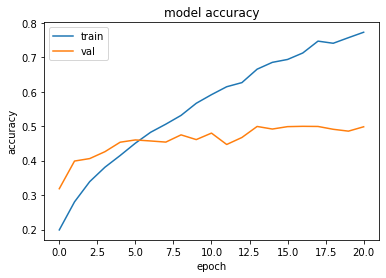

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.59715735912323 , and Val Acc happened to be 0.46000000834465027
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.49950000643730164 and Val Loss happened to be  2.1027016639709473
TestLoss:  1.5723198652267456  TestAcc: 0.4634999930858612
frog 0.713
truck 0.674
ship 0.649
dog 0.641
horse 0.55
automobile 0.383
airplane 0.316
bird 0.305
deer 0.279
cat 0.125


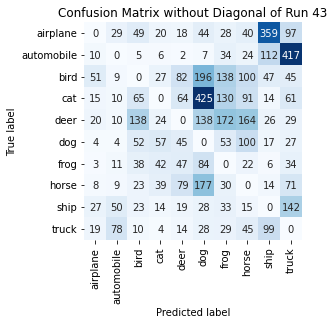

Summing down the rows, for Predictions of each Class that were wrong:  [ 157.  210.  403.  233.  370. 1127.  647.  601.  694.  923.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  82.0 times
Summing across the columns, for total number of that True Class misidentified:  [684. 617. 695. 875. 721. 359. 287. 450. 351. 326.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  172.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44 on Dataset D

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

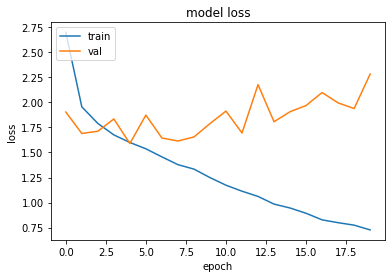

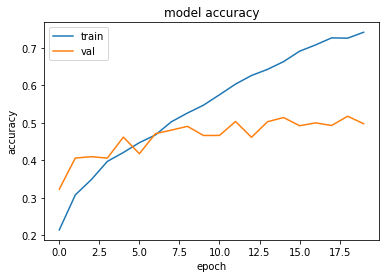

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5894418954849243 , and Val Acc happened to be 0.46160000562667847
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.517300009727478 and Val Loss happened to be  1.9380580186843872
TestLoss:  1.56675386428833  TestAcc: 0.46650001406669617
frog 0.795
ship 0.73
dog 0.606
truck 0.586
horse 0.529
airplane 0.501
automobile 0.395
bird 0.24
deer 0.187
cat 0.096


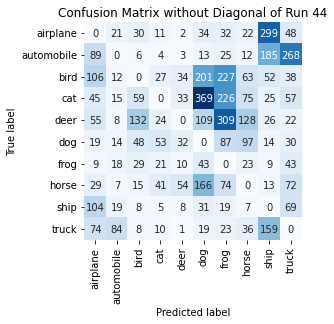

Summing down the rows, for Predictions of each Class that were wrong:  [ 530.  198.  335.  196.  177.  985. 1022.  463.  782.  647.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  54.0 times
Summing across the columns, for total number of that True Class misidentified:  [499. 605. 760. 904. 813. 394. 205. 471. 270. 414.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  309.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45 on Dataset D

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

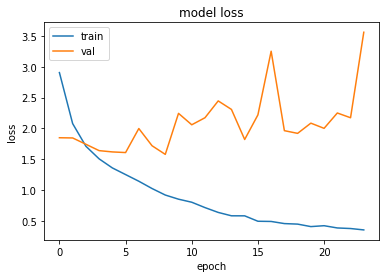

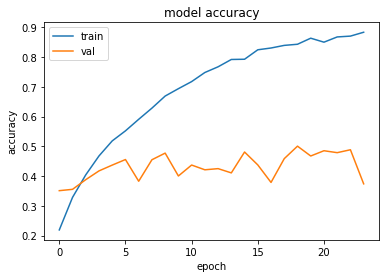

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.578029751777649 , and Val Acc happened to be 0.4772999882698059
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5006999969482422 and Val Loss happened to be  1.9191861152648926
TestLoss:  1.5428391695022583  TestAcc: 0.4853000044822693
frog 0.78
ship 0.671
dog 0.6
truck 0.557
horse 0.543
automobile 0.511
deer 0.367
airplane 0.353
cat 0.262
bird 0.209


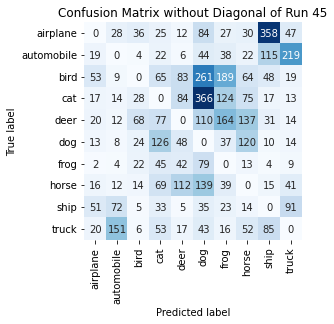

Summing down the rows, for Predictions of each Class that were wrong:  [ 211.  310.  207.  515.  409. 1161.  657.  527.  683.  467.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [647. 489. 791. 738. 633. 400. 220. 457. 329. 443.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  164.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46 on Dataset D

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Z

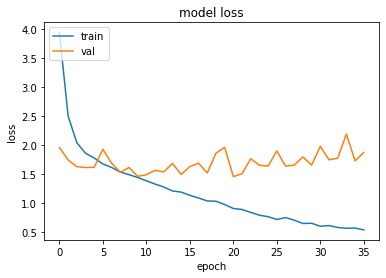

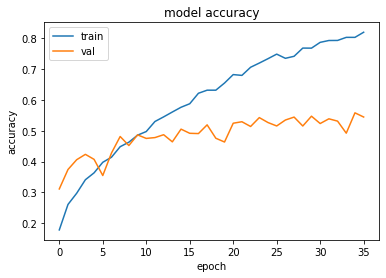

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.4594433307647705 , and Val Acc happened to be 0.524399995803833
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5580999851226807 and Val Loss happened to be  1.7287722826004028
TestLoss:  1.4178969860076904  TestAcc: 0.5284000039100647
ship 0.751
truck 0.671
frog 0.625
automobile 0.559
horse 0.536
deer 0.511
dog 0.439
cat 0.438
airplane 0.407
bird 0.347


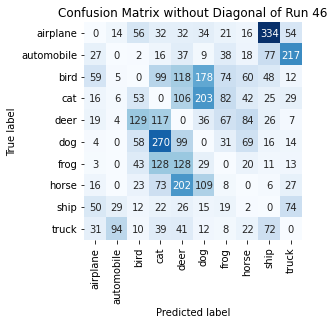

Summing down the rows, for Predictions of each Class that were wrong:  [225. 152. 386. 796. 789. 625. 348. 333. 615. 447.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  202.0 times
Summing across the columns, for total number of that True Class misidentified:  [593. 441. 653. 562. 489. 561. 375. 464. 249. 329.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  129.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47 on Dataset D

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )

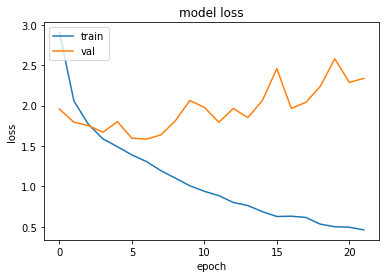

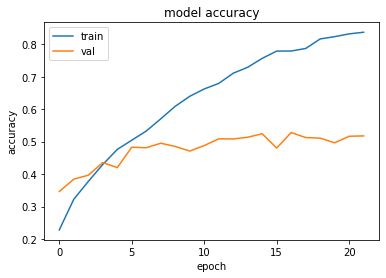

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.5840988159179688 , and Val Acc happened to be 0.4812999963760376
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.527999997138977 and Val Loss happened to be  1.9644179344177246
TestLoss:  1.559233546257019  TestAcc: 0.48750001192092896
horse 0.688
ship 0.652
frog 0.627
dog 0.611
truck 0.585
automobile 0.474
deer 0.42
bird 0.334
airplane 0.33
cat 0.154


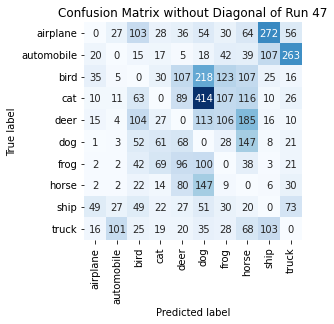

Summing down the rows, for Predictions of each Class that were wrong:  [ 150.  182.  475.  287.  528. 1150.  503.  784.  550.  516.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  107.0 times
Summing across the columns, for total number of that True Class misidentified:  [670. 526. 666. 846. 580. 389. 373. 312. 348. 415.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  185.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48 on Dataset D

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

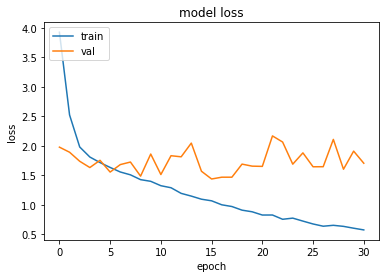

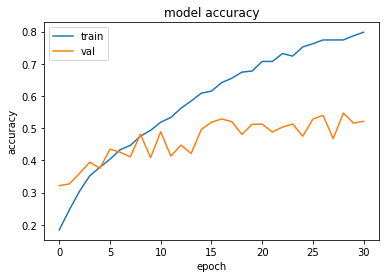

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.4357316493988037 , and Val Acc happened to be 0.5184000134468079
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.546999990940094 and Val Loss happened to be  1.6012046337127686
TestLoss:  1.4401369094848633  TestAcc: 0.5209000110626221
frog 0.831
ship 0.816
truck 0.619
dog 0.561
horse 0.511
automobile 0.476
deer 0.458
airplane 0.363
bird 0.316
cat 0.258


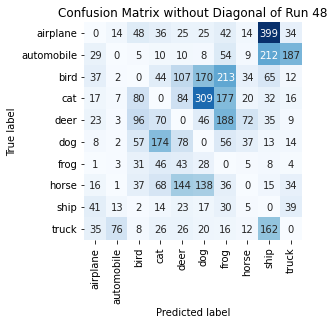

Summing down the rows, for Predictions of each Class that were wrong:  [207. 121. 364. 488. 540. 761. 812. 208. 941. 349.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  144.0 times
Summing across the columns, for total number of that True Class misidentified:  [637. 524. 684. 742. 542. 439. 169. 489. 184. 381.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  188.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49 on Dataset D

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0

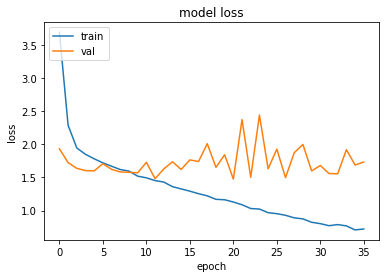

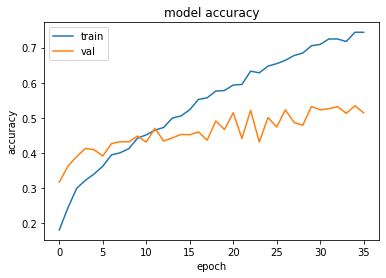

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.4750124216079712 , and Val Acc happened to be 0.5145999789237976
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5343999862670898 and Val Loss happened to be  1.6872888803482056
TestLoss:  1.4564720392227173  TestAcc: 0.5152000188827515
frog 0.749
ship 0.712
horse 0.703
truck 0.603
deer 0.504
dog 0.484
airplane 0.437
automobile 0.413
bird 0.411
cat 0.136


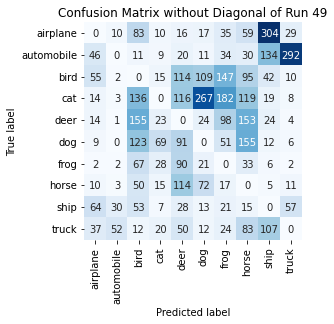

Summing down the rows, for Predictions of each Class that were wrong:  [251. 103. 690. 196. 639. 546. 609. 742. 653. 419.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  116.0 times
Summing across the columns, for total number of that True Class misidentified:  [563. 587. 589. 864. 496. 516. 251. 297. 288. 397.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  155.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50 on Dataset D

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:  

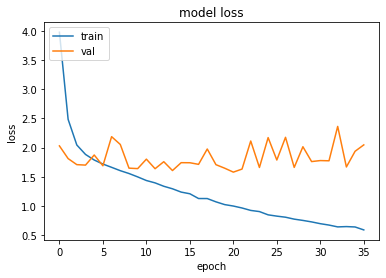

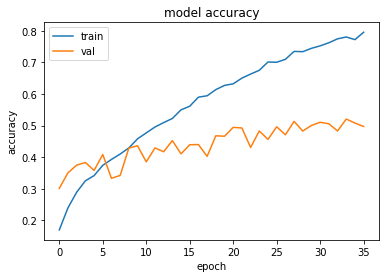

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.5792018175125122 , and Val Acc happened to be 0.4943999946117401
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5206000208854675 and Val Loss happened to be  1.6677601337432861
TestLoss:  1.5690103769302368  TestAcc: 0.49790000915527344
ship 0.798
frog 0.786
truck 0.615
horse 0.611
dog 0.541
automobile 0.457
airplane 0.361
deer 0.322
bird 0.288
cat 0.2


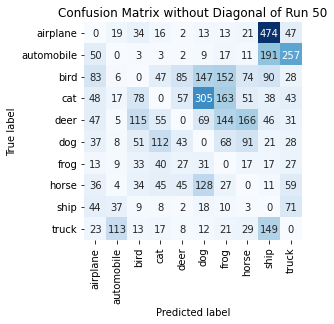

Summing down the rows, for Predictions of each Class that were wrong:  [ 381.  218.  370.  343.  271.  732.  615.  463. 1037.  591.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  85.0 times
Summing across the columns, for total number of that True Class misidentified:  [639. 543. 712. 800. 678. 459. 214. 389. 202. 385.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  166.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 18 November 2021 20:41:41  (subtract ~5-hours for local Hour), and file is called  runs_GroupD_final.pkl


In [79]:
run_through_runs(ds=trainD, ds_noalb=trainD_noalb, dstitle = "D", showpictures=False)

filename will be:  runs_GroupE .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset E

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5


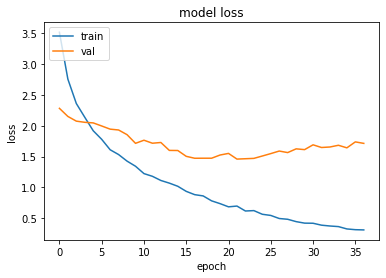

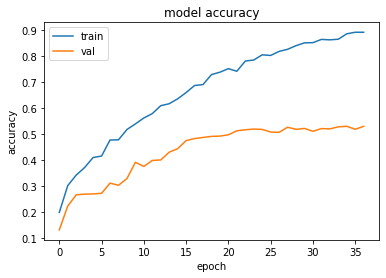

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  21 when  Val Loss was:  1.4591152667999268 , and Val Acc happened to be 0.5113999843597412
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5289000272750854 and Val Loss happened to be  1.6412901878356934
TestLoss:  1.4350751638412476  TestAcc: 0.5170000195503235
ship 0.692
truck 0.632
dog 0.615
horse 0.614
automobile 0.588
airplane 0.556
frog 0.548
deer 0.401
bird 0.376
cat 0.148


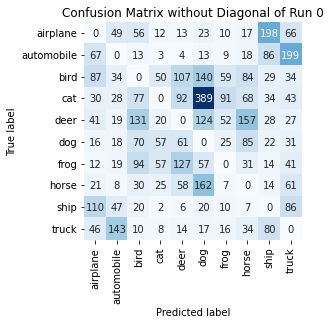

Summing down the rows, for Predictions of each Class that were wrong:  [430. 365. 501. 234. 482. 945. 279. 501. 505. 588.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  127.0 times
Summing across the columns, for total number of that True Class misidentified:  [444. 412. 624. 852. 599. 385. 452. 386. 308. 368.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  157.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1 on Dataset E

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Brigh

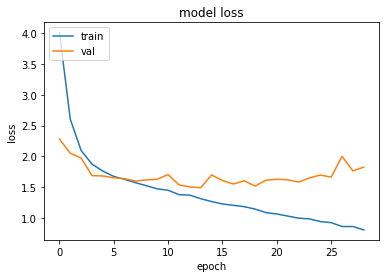

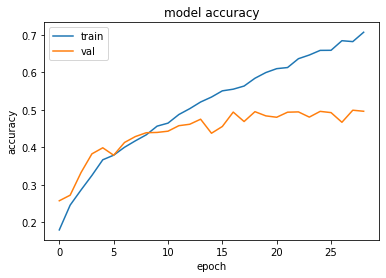

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.490294098854065 , and Val Acc happened to be 0.47510001063346863
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.499099999666214 and Val Loss happened to be  1.7635509967803955
TestLoss:  1.4730494022369385  TestAcc: 0.47839999198913574
ship 0.757
horse 0.677
frog 0.67
truck 0.62
automobile 0.577
dog 0.563
deer 0.447
airplane 0.23
bird 0.157
cat 0.086


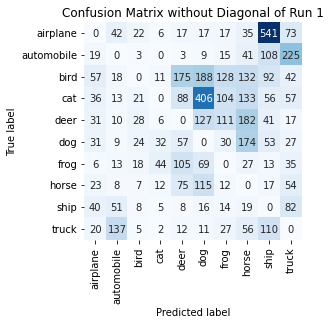

Summing down the rows, for Predictions of each Class that were wrong:  [ 263.  301.  136.  118.  540.  958.  458.  799. 1031.  612.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  175.0 times
Summing across the columns, for total number of that True Class misidentified:  [770. 423. 843. 914. 553. 437. 330. 323. 243. 380.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  182.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2 on Dataset E

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0

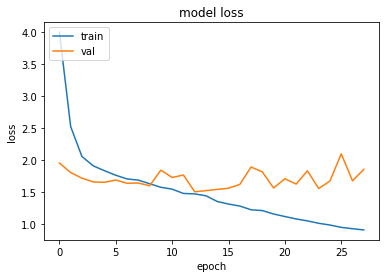

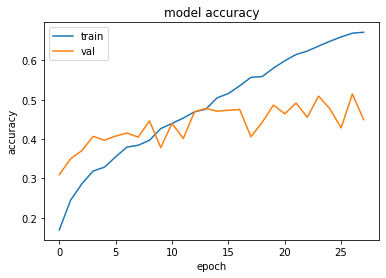

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.509185791015625 , and Val Acc happened to be 0.46950000524520874
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5145999789237976 and Val Loss happened to be  1.6809722185134888
TestLoss:  1.4897469282150269  TestAcc: 0.4607999920845032
truck 0.759
ship 0.711
horse 0.656
dog 0.639
frog 0.546
deer 0.412
automobile 0.302
airplane 0.296
bird 0.17
cat 0.117


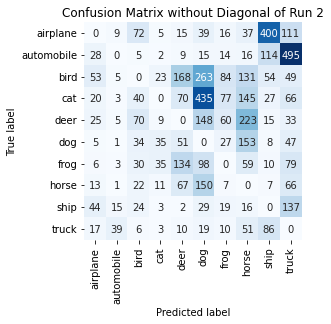

Summing down the rows, for Predictions of each Class that were wrong:  [ 211.   81.  303.  126.  526. 1196.  314.  831.  721. 1083.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  168.0 times
Summing across the columns, for total number of that True Class misidentified:  [704. 698. 830. 883. 588. 361. 454. 344. 289. 241.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  223.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3 on Dataset E

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contr

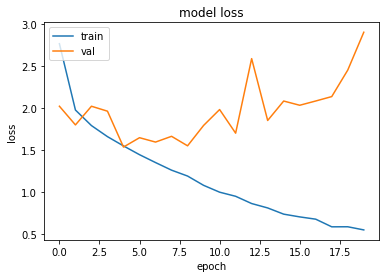

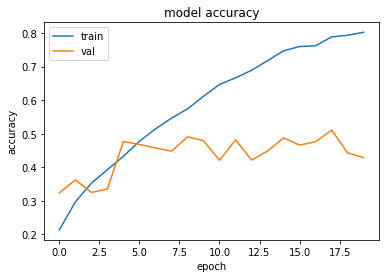

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5357859134674072 , and Val Acc happened to be 0.4767000079154968
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5109999775886536 and Val Loss happened to be  2.13787841796875
TestLoss:  1.5171947479248047  TestAcc: 0.47360000014305115
frog 0.706
horse 0.667
ship 0.605
dog 0.575
truck 0.572
airplane 0.505
automobile 0.461
deer 0.309
bird 0.289
cat 0.047


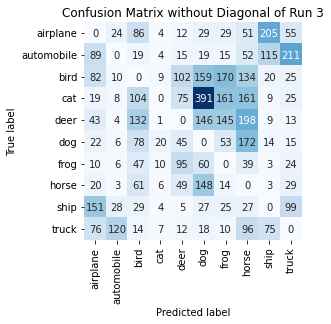

Summing down the rows, for Predictions of each Class that were wrong:  [512. 209. 570.  65. 410. 997. 622. 930. 453. 496.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  102.0 times
Summing across the columns, for total number of that True Class misidentified:  [495. 539. 711. 953. 691. 425. 294. 333. 395. 428.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  198.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4 on Dataset E

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 0.05 )
C

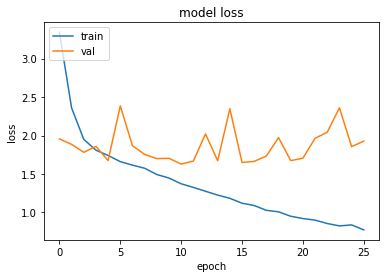

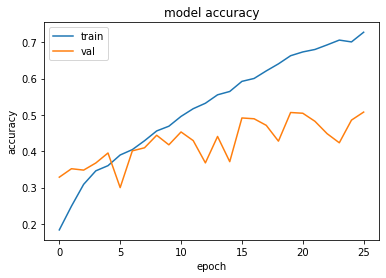

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.6287891864776611 , and Val Acc happened to be 0.453000009059906
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5077000260353088 and Val Loss happened to be  1.9274613857269287
TestLoss:  1.6082230806350708  TestAcc: 0.4553000032901764
truck 0.772
dog 0.637
horse 0.634
frog 0.605
ship 0.506
airplane 0.375
deer 0.353
automobile 0.313
bird 0.224
cat 0.134


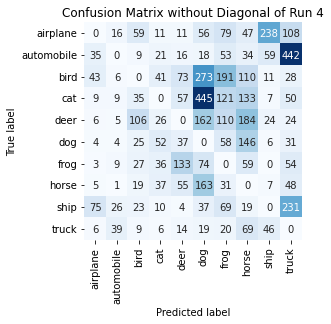

Summing down the rows, for Predictions of each Class that were wrong:  [ 186.  115.  312.  240.  400. 1247.  732.  801.  398. 1016.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  133.0 times
Summing across the columns, for total number of that True Class misidentified:  [625. 687. 776. 866. 647. 363. 395. 366. 494. 228.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  184.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5 on Dataset E

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: (

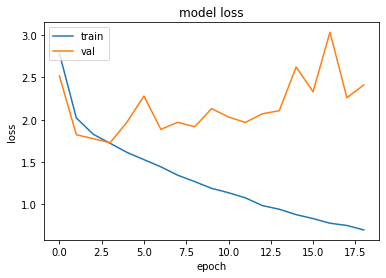

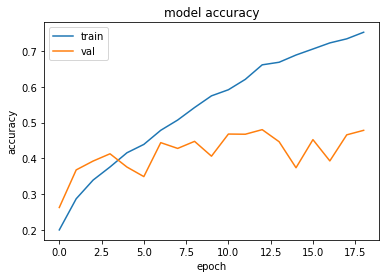

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.728376030921936 , and Val Acc happened to be 0.41280001401901245
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.48019999265670776 and Val Loss happened to be  2.069744825363159
TestLoss:  1.7199374437332153  TestAcc: 0.412200003862381
horse 0.731
truck 0.726
ship 0.708
frog 0.701
dog 0.493
deer 0.272
automobile 0.206
airplane 0.1
bird 0.095
cat 0.09


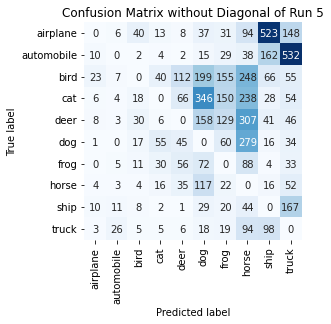

Summing down the rows, for Predictions of each Class that were wrong:  [  65.   65.  135.  171.  331.  991.  615. 1430.  954. 1121.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [900. 794. 905. 910. 728. 507. 299. 269. 292. 274.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  307.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6 on Dataset E

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contr

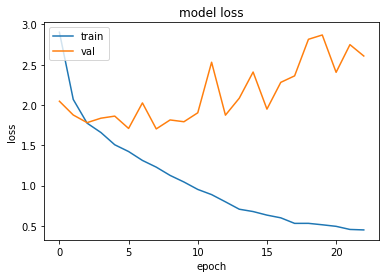

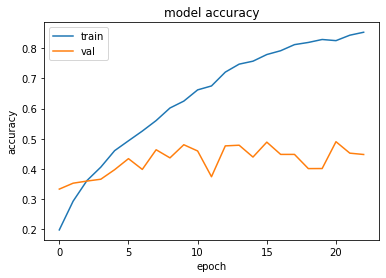

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.7036129236221313 , and Val Acc happened to be 0.46380001306533813
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.4903999865055084 and Val Loss happened to be  2.406057834625244
TestLoss:  1.6903613805770874  TestAcc: 0.46549999713897705
frog 0.77
horse 0.678
ship 0.671
truck 0.667
dog 0.619
automobile 0.47
deer 0.242
bird 0.225
airplane 0.217
cat 0.096


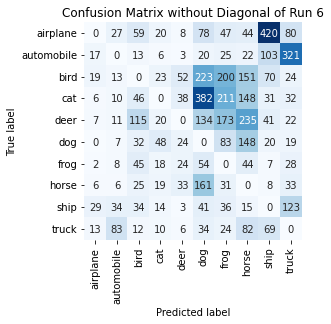

Summing down the rows, for Predictions of each Class that were wrong:  [  99.  199.  381.  178.  191. 1127.  830.  889.  769.  682.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  52.0 times
Summing across the columns, for total number of that True Class misidentified:  [783. 530. 775. 904. 758. 381. 230. 322. 329. 333.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  235.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7 on Dataset E

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Cont

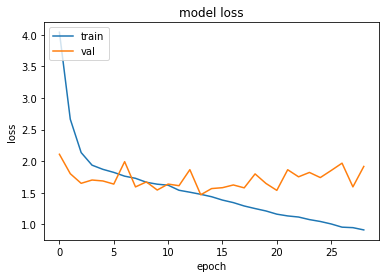

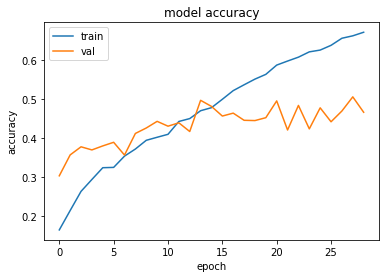

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.4677780866622925 , and Val Acc happened to be 0.49709999561309814
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5059999823570251 and Val Loss happened to be  1.5927135944366455
TestLoss:  1.4554483890533447  TestAcc: 0.4959000051021576
ship 0.825
frog 0.819
truck 0.693
dog 0.639
horse 0.567
automobile 0.554
airplane 0.301
bird 0.268
deer 0.192
cat 0.101


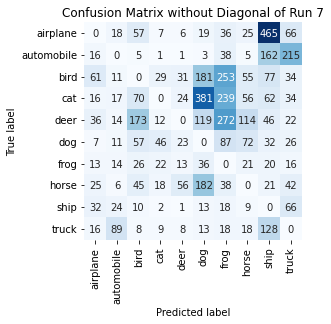

Summing down the rows, for Predictions of each Class that were wrong:  [ 222.  204.  451.  146.  163.  947.  999.  375. 1013.  521.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  56.0 times
Summing across the columns, for total number of that True Class misidentified:  [699. 446. 732. 899. 808. 361. 181. 433. 175. 307.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  272.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8 on Dataset E

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0

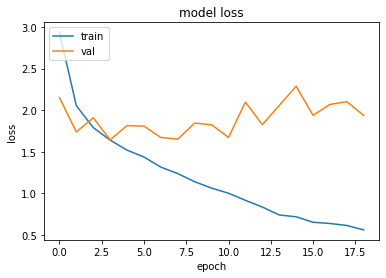

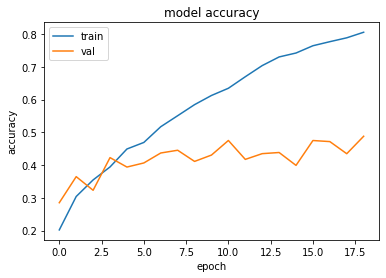

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6441457271575928 , and Val Acc happened to be 0.42289999127388
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.48809999227523804 and Val Loss happened to be  1.9374003410339355
TestLoss:  1.632034182548523  TestAcc: 0.42320001125335693
frog 0.785
ship 0.75
horse 0.585
truck 0.553
dog 0.54
automobile 0.386
bird 0.203
deer 0.196
airplane 0.183
cat 0.051


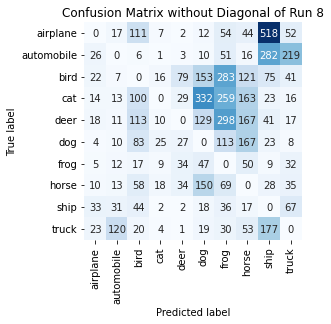

Summing down the rows, for Predictions of each Class that were wrong:  [ 155.  234.  552.   92.  211.  870. 1193.  798. 1176.  487.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  79.0 times
Summing across the columns, for total number of that True Class misidentified:  [817. 614. 797. 949. 804. 460. 215. 415. 250. 447.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  298.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9 on Dataset E

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 

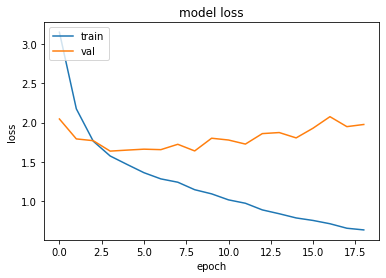

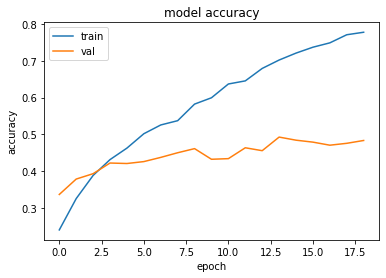

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.635127305984497 , and Val Acc happened to be 0.42250001430511475
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.492900013923645 and Val Loss happened to be  1.8718050718307495
TestLoss:  1.6322845220565796  TestAcc: 0.42640000581741333
horse 0.717
frog 0.706
ship 0.69
truck 0.557
dog 0.484
automobile 0.336
deer 0.335
bird 0.156
cat 0.143
airplane 0.14


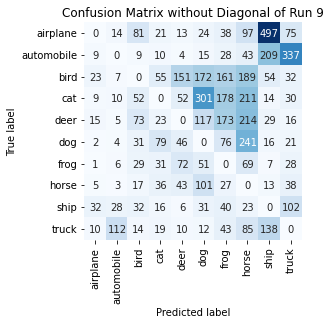

Summing down the rows, for Predictions of each Class that were wrong:  [ 106.  189.  338.  290.  397.  824.  764. 1172.  977.  679.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  151.0 times
Summing across the columns, for total number of that True Class misidentified:  [860. 664. 844. 857. 665. 516. 294. 283. 310. 443.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  214.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10 on Dataset E

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   

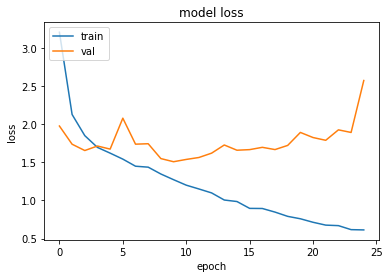

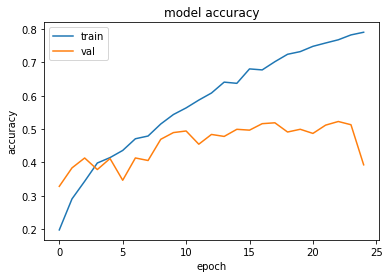

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.50868821144104 , and Val Acc happened to be 0.4894999861717224
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5227000117301941 and Val Loss happened to be  1.9273544549942017
TestLoss:  1.48850417137146  TestAcc: 0.489300012588501
ship 0.759
horse 0.662
frog 0.641
dog 0.627
truck 0.611
automobile 0.51
deer 0.413
airplane 0.276
bird 0.216
cat 0.178


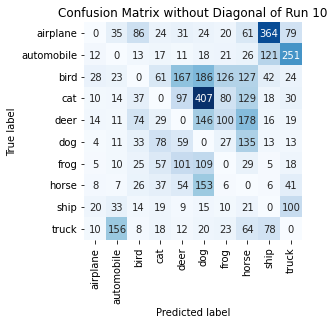

Summing down the rows, for Predictions of each Class that were wrong:  [ 111.  300.  316.  340.  541. 1078.  413.  770.  663.  575.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  167.0 times
Summing across the columns, for total number of that True Class misidentified:  [724. 490. 784. 822. 587. 373. 359. 338. 241. 389.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  178.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11 on Dataset E

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

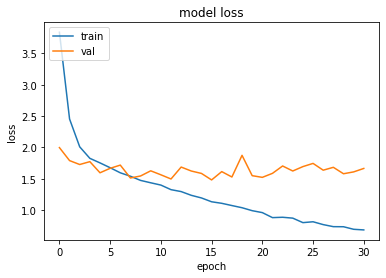

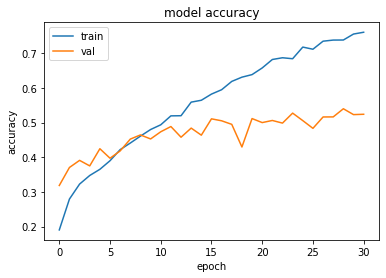

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.4805742502212524 , and Val Acc happened to be 0.5108000040054321
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.539900004863739 and Val Loss happened to be  1.579164743423462
TestLoss:  1.4497222900390625  TestAcc: 0.5141000151634216
truck 0.776
ship 0.77
frog 0.725
horse 0.683
automobile 0.548
dog 0.486
deer 0.437
airplane 0.277
bird 0.243
cat 0.196


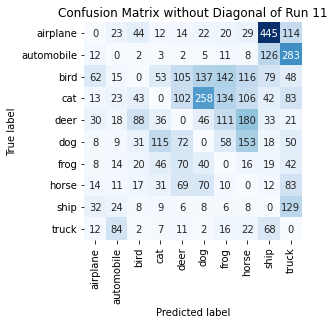

Summing down the rows, for Predictions of each Class that were wrong:  [191. 221. 255. 312. 451. 588. 508. 638. 842. 853.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  105.0 times
Summing across the columns, for total number of that True Class misidentified:  [723. 452. 757. 804. 563. 514. 275. 317. 230. 224.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  180.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12 on Dataset E

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   

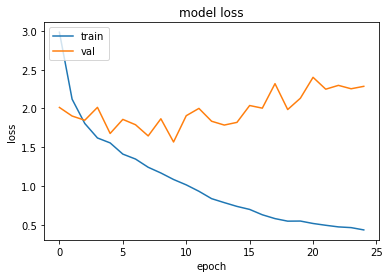

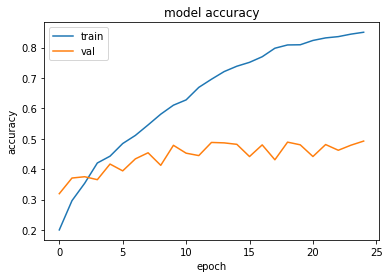

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.5673516988754272 , and Val Acc happened to be 0.47859999537467957
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.4925000071525574 and Val Loss happened to be  2.2856407165527344
TestLoss:  1.5490577220916748  TestAcc: 0.47279998660087585
ship 0.708
frog 0.667
horse 0.622
dog 0.612
automobile 0.502
truck 0.497
bird 0.309
airplane 0.306
deer 0.302
cat 0.203


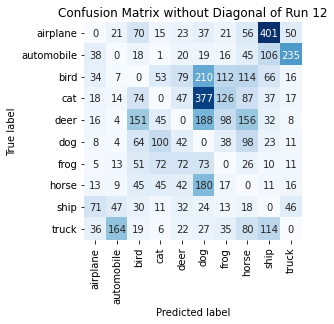

Summing down the rows, for Predictions of each Class that were wrong:  [ 239.  283.  522.  348.  379. 1135.  476.  680.  800.  410.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  79.0 times
Summing across the columns, for total number of that True Class misidentified:  [694. 498. 691. 797. 698. 388. 333. 378. 292. 503.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  188.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13 on Dataset E

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
Zoo

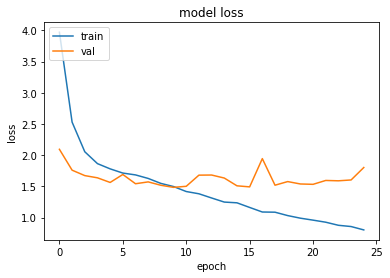

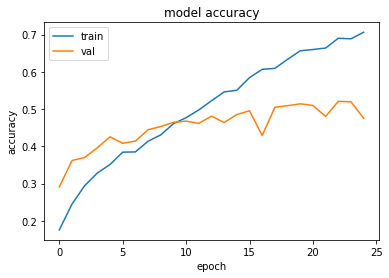

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.4842414855957031 , and Val Acc happened to be 0.4645000100135803
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5209000110626221 and Val Loss happened to be  1.5892136096954346
TestLoss:  1.4681257009506226  TestAcc: 0.4648999869823456
truck 0.774
horse 0.674
ship 0.658
dog 0.631
frog 0.608
automobile 0.478
deer 0.334
airplane 0.279
bird 0.122
cat 0.091


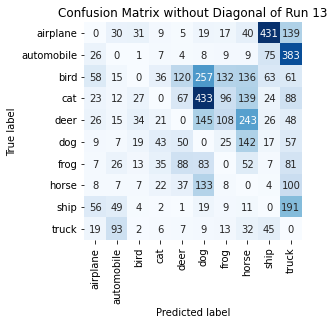

Summing down the rows, for Predictions of each Class that were wrong:  [ 232.  254.  138.  181.  379. 1106.  417.  804.  692. 1148.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  120.0 times
Summing across the columns, for total number of that True Class misidentified:  [721. 522. 878. 909. 666. 369. 392. 326. 342. 226.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  243.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14 on Dataset E

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 

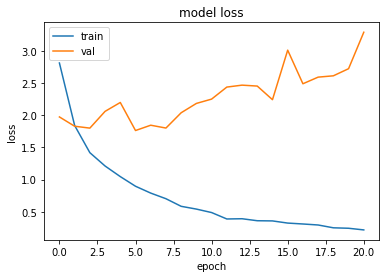

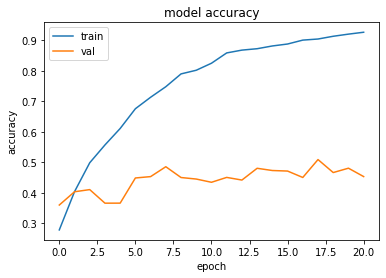

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.7630677223205566 , and Val Acc happened to be 0.4487000107765198
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5091000199317932 and Val Loss happened to be  2.5935535430908203
TestLoss:  1.7436195611953735  TestAcc: 0.4449000060558319
dog 0.703
ship 0.679
horse 0.638
truck 0.564
automobile 0.528
frog 0.462
deer 0.352
airplane 0.231
bird 0.158
cat 0.134


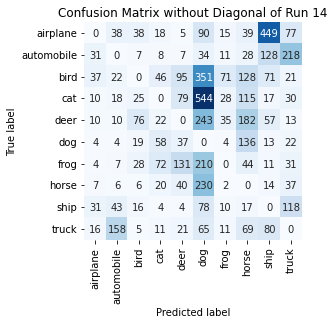

Summing down the rows, for Predictions of each Class that were wrong:  [ 150.  306.  220.  259.  419. 1845.  187.  758.  840.  567.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  131.0 times
Summing across the columns, for total number of that True Class misidentified:  [769. 472. 842. 866. 648. 297. 538. 362. 321. 436.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  243.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15 on Dataset E

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 

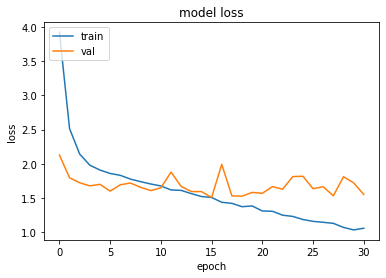

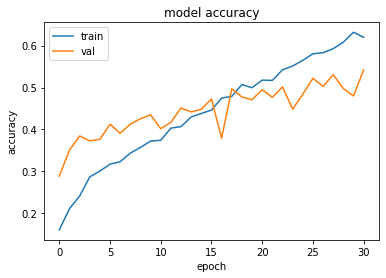

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.508790373802185 , and Val Acc happened to be 0.47290000319480896
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5418999791145325 and Val Loss happened to be  1.5535959005355835
TestLoss:  1.507622480392456  TestAcc: 0.46779999136924744
truck 0.81
dog 0.738
ship 0.663
horse 0.626
frog 0.534
automobile 0.336
deer 0.336
airplane 0.3
bird 0.291
cat 0.044


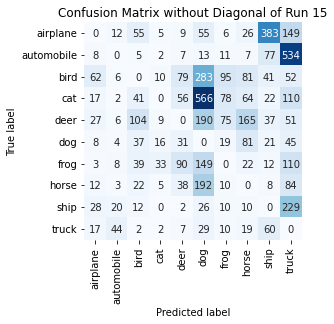

Summing down the rows, for Predictions of each Class that were wrong:  [ 182.  105.  317.   82.  319. 1503.  314.  475.  661. 1364.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  90.0 times
Summing across the columns, for total number of that True Class misidentified:  [700. 664. 709. 956. 664. 262. 466. 374. 337. 190.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  190.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16 on Dataset E

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

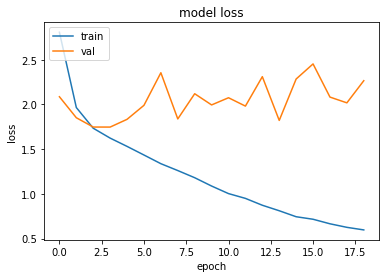

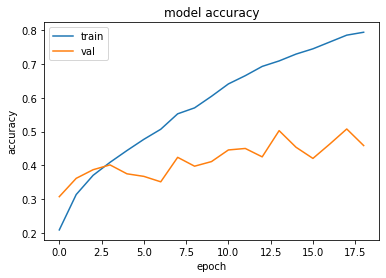

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.7471213340759277 , and Val Acc happened to be 0.40139999985694885
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5076000094413757 and Val Loss happened to be  2.018171548843384
TestLoss:  1.7420939207077026  TestAcc: 0.400299996137619
ship 0.772
horse 0.659
dog 0.655
frog 0.461
truck 0.434
automobile 0.391
deer 0.245
bird 0.211
airplane 0.134
cat 0.041


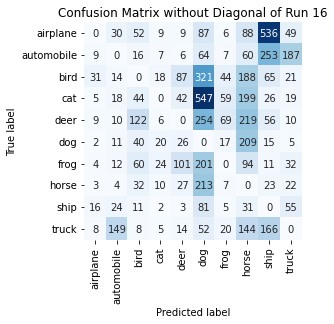

Summing down the rows, for Predictions of each Class that were wrong:  [  87.  272.  385.  101.  315. 1820.  234. 1232. 1151.  400.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  101.0 times
Summing across the columns, for total number of that True Class misidentified:  [866. 609. 789. 959. 755. 345. 539. 341. 228. 566.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  254.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17 on Dataset E

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0

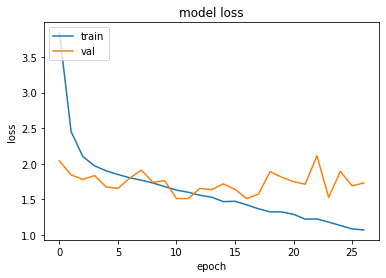

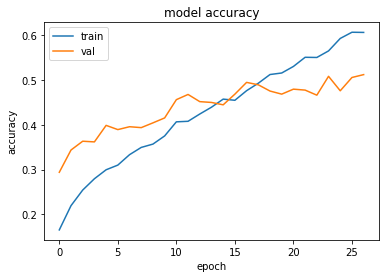

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.5125540494918823 , and Val Acc happened to be 0.4674000144004822
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5116000175476074 and Val Loss happened to be  1.7310396432876587
TestLoss:  1.4834331274032593  TestAcc: 0.4657999873161316
frog 0.774
ship 0.754
horse 0.724
truck 0.629
dog 0.488
automobile 0.43
deer 0.409
airplane 0.259
bird 0.114
cat 0.077


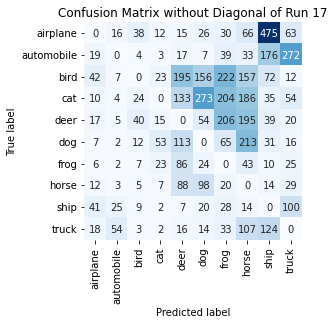

Summing down the rows, for Predictions of each Class that were wrong:  [ 172.  118.  142.  140.  670.  672.  847. 1014.  976.  591.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  195.0 times
Summing across the columns, for total number of that True Class misidentified:  [741. 570. 886. 923. 591. 512. 226. 276. 246. 371.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  206.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18 on Dataset E

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:  

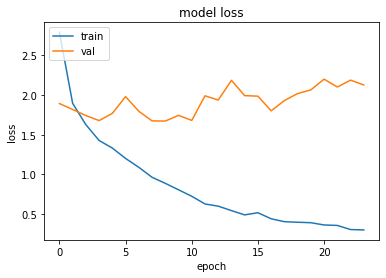

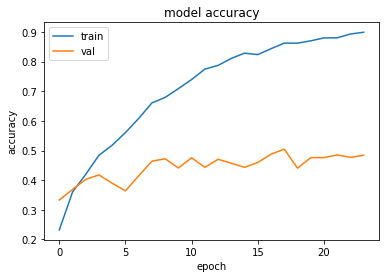

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.6715705394744873 , and Val Acc happened to be 0.47209998965263367
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5047000050544739 and Val Loss happened to be  1.9305799007415771
TestLoss:  1.6377166509628296  TestAcc: 0.47440001368522644
ship 0.803
frog 0.75
horse 0.696
dog 0.64
automobile 0.57
truck 0.523
airplane 0.303
bird 0.232
deer 0.139
cat 0.088


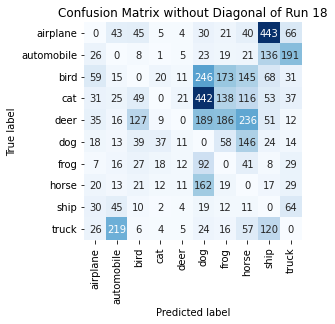

Summing down the rows, for Predictions of each Class that were wrong:  [ 252.  405.  332.  108.   84. 1227.  642.  813.  920.  473.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  21.0 times
Summing across the columns, for total number of that True Class misidentified:  [697. 430. 768. 912. 861. 360. 250. 304. 197. 477.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  236.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19 on Dataset E

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Z

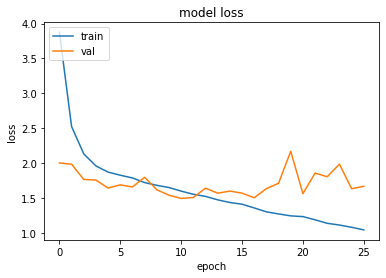

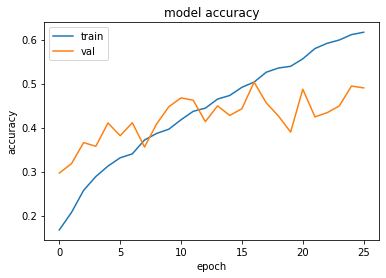

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.4989432096481323 , and Val Acc happened to be 0.4675000011920929
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5033000111579895 and Val Loss happened to be  1.508317232131958
TestLoss:  1.4879800081253052  TestAcc: 0.46860000491142273
horse 0.736
ship 0.716
frog 0.628
truck 0.608
dog 0.598
automobile 0.506
airplane 0.277
deer 0.254
bird 0.225
cat 0.138


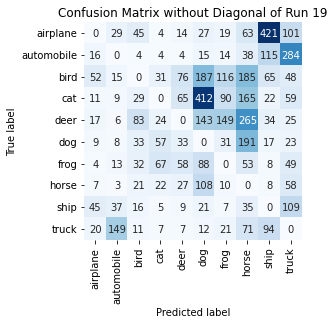

Summing down the rows, for Predictions of each Class that were wrong:  [ 181.  269.  274.  221.  293. 1013.  457. 1066.  784.  756.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  76.0 times
Summing across the columns, for total number of that True Class misidentified:  [723. 494. 775. 862. 746. 402. 372. 264. 284. 392.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  265.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20 on Dataset E

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:  

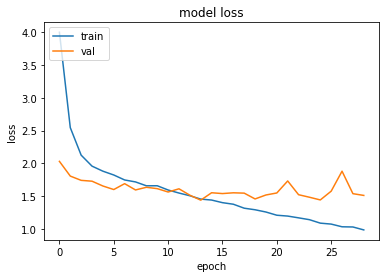

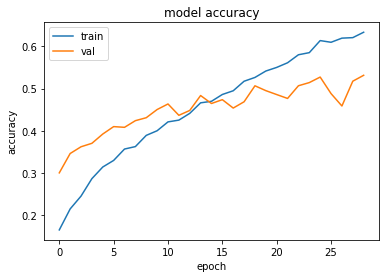

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.438288688659668 , and Val Acc happened to be 0.48350000381469727
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.531499981880188 and Val Loss happened to be  1.5107113122940063
TestLoss:  1.4177167415618896  TestAcc: 0.48489999771118164
truck 0.825
frog 0.724
horse 0.646
dog 0.638
ship 0.615
deer 0.44
airplane 0.376
automobile 0.289
cat 0.156
bird 0.14


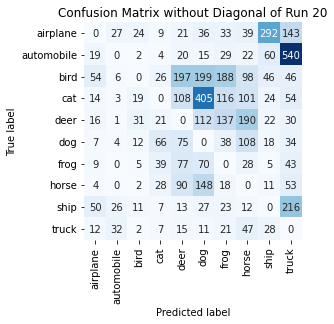

Summing down the rows, for Predictions of each Class that were wrong:  [ 185.   99.  108.  207.  616. 1023.  603.  645.  506. 1159.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  197.0 times
Summing across the columns, for total number of that True Class misidentified:  [624. 711. 860. 844. 560. 362. 276. 354. 385. 175.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  190.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21 on Dataset E

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -

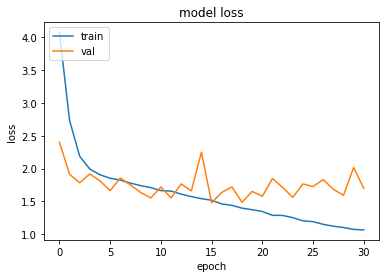

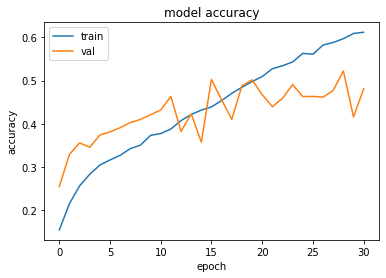

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.4805186986923218 , and Val Acc happened to be 0.5026000142097473
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5224000215530396 and Val Loss happened to be  1.593238115310669
TestLoss:  1.4537793397903442  TestAcc: 0.49799999594688416
frog 0.743
truck 0.741
horse 0.706
dog 0.6
ship 0.571
automobile 0.549
deer 0.402
airplane 0.386
bird 0.183
cat 0.099


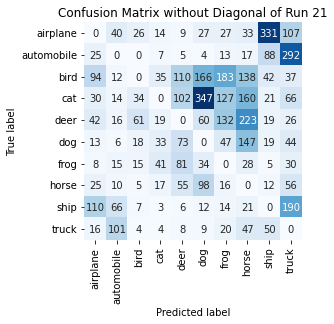

Summing down the rows, for Predictions of each Class that were wrong:  [363. 280. 170. 173. 449. 757. 579. 814. 587. 848.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  110.0 times
Summing across the columns, for total number of that True Class misidentified:  [614. 451. 817. 901. 598. 400. 257. 294. 429. 259.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  223.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22 on Dataset E

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0

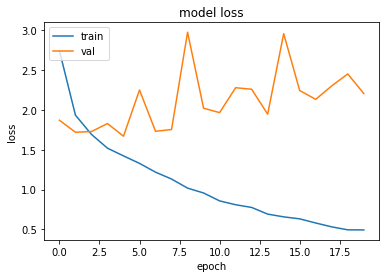

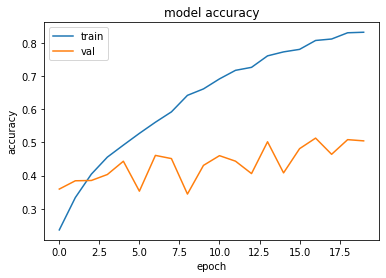

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6703994274139404 , and Val Acc happened to be 0.4431999921798706
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5128999948501587 and Val Loss happened to be  2.1333231925964355
TestLoss:  1.6222107410430908  TestAcc: 0.44760000705718994
frog 0.836
horse 0.67
truck 0.668
dog 0.597
ship 0.448
airplane 0.382
automobile 0.355
deer 0.283
cat 0.157
bird 0.08


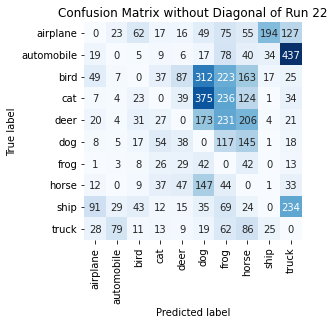

Summing down the rows, for Predictions of each Class that were wrong:  [ 235.  154.  209.  232.  286. 1169. 1135.  885.  277.  942.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  87.0 times
Summing across the columns, for total number of that True Class misidentified:  [618. 645. 920. 843. 717. 403. 164. 330. 552. 332.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  231.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23 on Dataset E

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

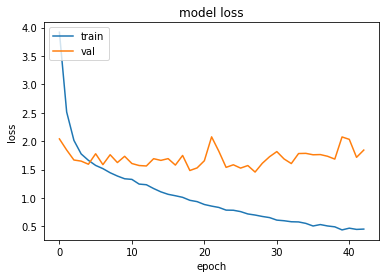

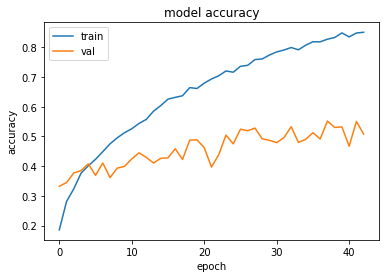

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  27 when  Val Loss was:  1.4552613496780396 , and Val Acc happened to be 0.5281000137329102
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.551800012588501 and Val Loss happened to be  1.733373999595642
TestLoss:  1.4275083541870117  TestAcc: 0.5302000045776367
ship 0.799
truck 0.771
frog 0.702
dog 0.655
horse 0.614
deer 0.484
bird 0.388
automobile 0.354
airplane 0.339
cat 0.196


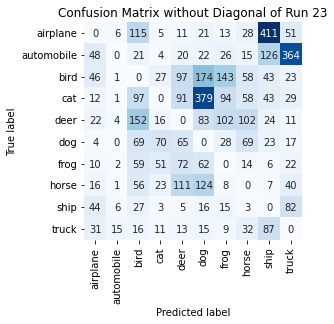

Summing down the rows, for Predictions of each Class that were wrong:  [233.  36. 612. 210. 485. 896. 438. 379. 770. 639.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  111.0 times
Summing across the columns, for total number of that True Class misidentified:  [661. 646. 612. 804. 516. 345. 298. 386. 201. 229.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  152.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24 on Dataset E

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0

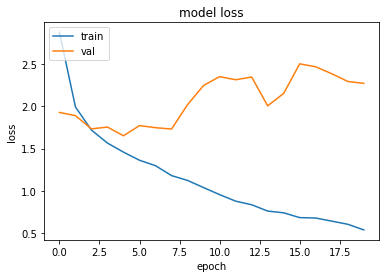

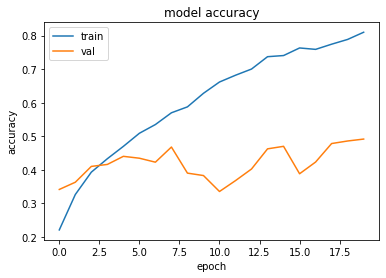

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6520161628723145 , and Val Acc happened to be 0.44029998779296875
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.4916999936103821 and Val Loss happened to be  2.2745630741119385
TestLoss:  1.627105712890625  TestAcc: 0.43880000710487366
ship 0.785
horse 0.637
dog 0.597
frog 0.58
automobile 0.564
truck 0.424
deer 0.257
bird 0.232
cat 0.157
airplane 0.155


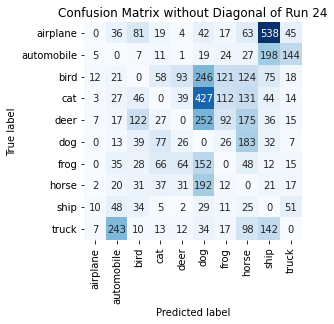

Summing down the rows, for Predictions of each Class that were wrong:  [  46.  460.  398.  313.  272. 1393.  432.  874. 1098.  326.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  93.0 times
Summing across the columns, for total number of that True Class misidentified:  [845. 436. 768. 843. 743. 403. 420. 363. 215. 576.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  252.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25 on Dataset E

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.

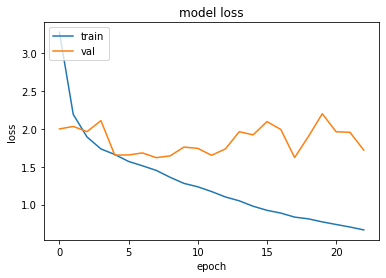

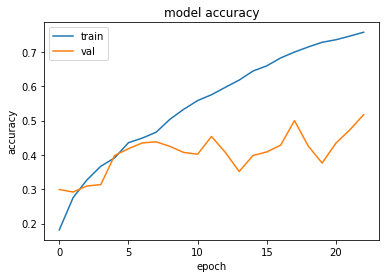

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.6205695867538452 , and Val Acc happened to be 0.43810001015663147
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.517300009727478 and Val Loss happened to be  1.7204506397247314
TestLoss:  1.6300095319747925  TestAcc: 0.4311999976634979
frog 0.8
truck 0.743
ship 0.667
horse 0.658
deer 0.43
airplane 0.307
dog 0.298
automobile 0.272
bird 0.112
cat 0.025


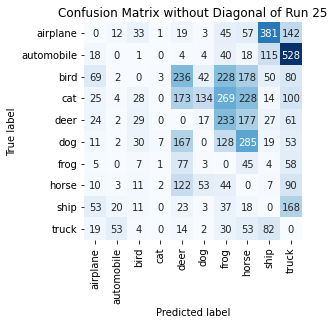

Summing down the rows, for Predictions of each Class that were wrong:  [ 234.   98.  154.   14.  835.  261. 1054. 1059.  699. 1280.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  236.0 times
Summing across the columns, for total number of that True Class misidentified:  [693. 728. 888. 975. 570. 702. 200. 342. 333. 257.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  233.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26 on Dataset E

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0

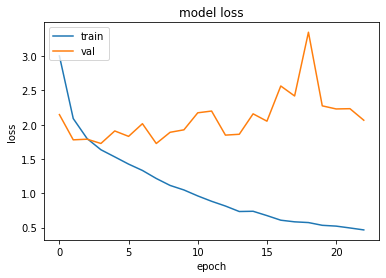

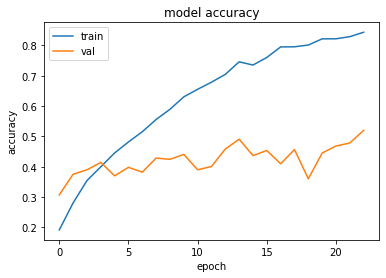

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.725477933883667 , and Val Acc happened to be 0.4284999966621399
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5199000239372253 and Val Loss happened to be  2.0647270679473877
TestLoss:  1.7163695096969604  TestAcc: 0.4325999915599823
truck 0.853
horse 0.738
ship 0.602
dog 0.503
frog 0.442
airplane 0.406
bird 0.243
deer 0.23
cat 0.164
automobile 0.145


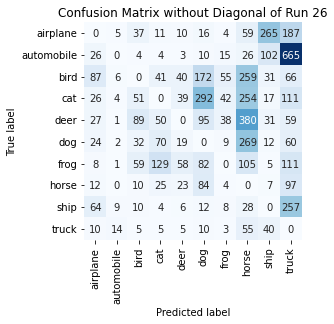

Summing down the rows, for Predictions of each Class that were wrong:  [ 284.   42.  297.  339.  203.  773.  178. 1435.  510. 1613.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  58.0 times
Summing across the columns, for total number of that True Class misidentified:  [594. 855. 757. 836. 770. 497. 558. 262. 398. 147.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  380.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27 on Dataset E

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Z

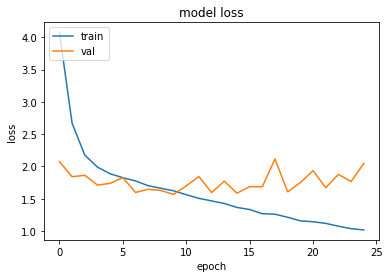

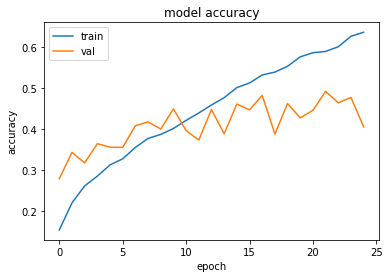

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.5660685300827026 , and Val Acc happened to be 0.4496000111103058
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.49239999055862427 and Val Loss happened to be  1.6701513528823853
TestLoss:  1.55013906955719  TestAcc: 0.454800009727478
ship 0.75
horse 0.687
frog 0.674
automobile 0.538
truck 0.524
dog 0.435
deer 0.378
airplane 0.274
bird 0.238
cat 0.05


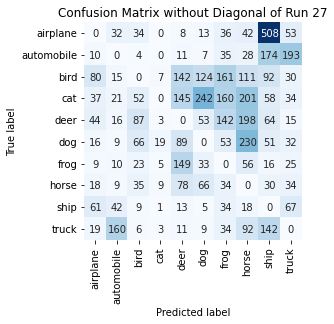

Summing down the rows, for Predictions of each Class that were wrong:  [ 294.  314.  316.   47.  646.  552.  689.  976. 1135.  483.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  149.0 times
Summing across the columns, for total number of that True Class misidentified:  [726. 462. 762. 950. 622. 565. 326. 313. 250. 476.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  198.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28 on Dataset E

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )


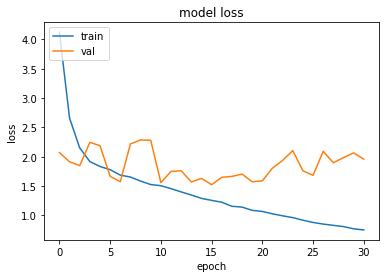

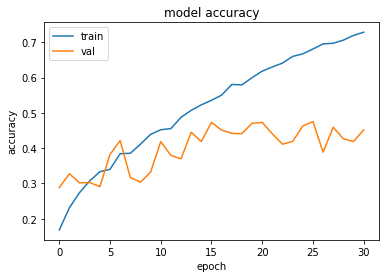

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.5242033004760742 , and Val Acc happened to be 0.4733000099658966
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.4754999876022339 and Val Loss happened to be  1.6833339929580688
TestLoss:  1.4821913242340088  TestAcc: 0.4758000075817108
frog 0.781
ship 0.691
truck 0.65
dog 0.62
horse 0.61
deer 0.421
airplane 0.343
automobile 0.269
bird 0.261
cat 0.112


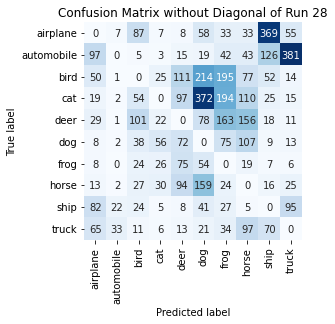

Summing down the rows, for Predictions of each Class that were wrong:  [ 371.   70.  371.  180.  493. 1016.  787.  647.  692.  615.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  111.0 times
Summing across the columns, for total number of that True Class misidentified:  [657. 731. 739. 888. 579. 380. 219. 390. 309. 350.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  163.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29 on Dataset E

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

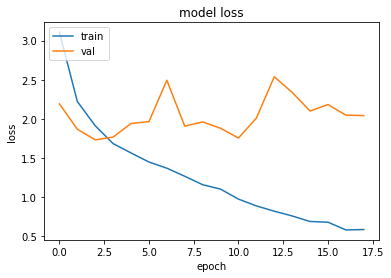

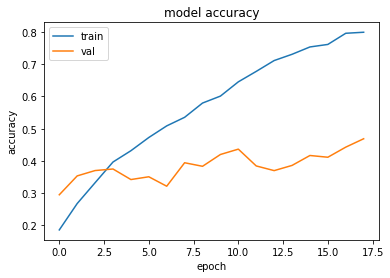

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7316594123840332 , and Val Acc happened to be 0.3702999949455261
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.46889999508857727 and Val Loss happened to be  2.04231858253479
TestLoss:  1.7165881395339966  TestAcc: 0.37439998984336853
frog 0.797
ship 0.666
truck 0.592
horse 0.548
dog 0.469
automobile 0.24
airplane 0.142
deer 0.116
cat 0.11
bird 0.064


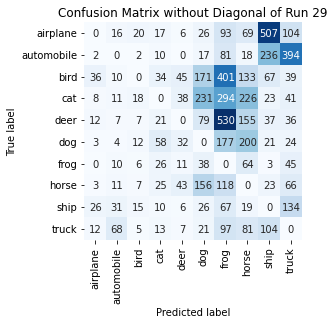

Summing down the rows, for Predictions of each Class that were wrong:  [ 102.  168.   92.  214.  188.  765. 1858.  965. 1021.  883.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  45.0 times
Summing across the columns, for total number of that True Class misidentified:  [858. 760. 936. 890. 884. 531. 203. 452. 334. 408.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  530.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30 on Dataset E

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

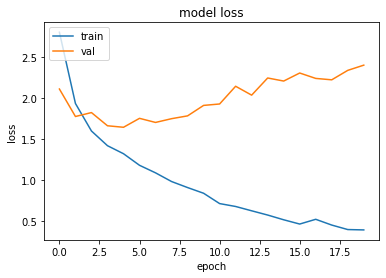

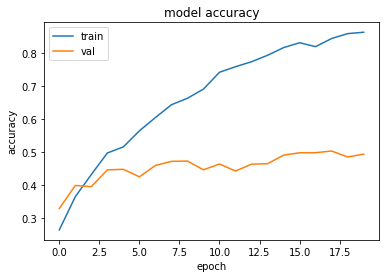

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.639632225036621 , and Val Acc happened to be 0.4481000006198883
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.503600001335144 and Val Loss happened to be  2.218308687210083
TestLoss:  1.6047770977020264  TestAcc: 0.4456000030040741
frog 0.725
truck 0.702
horse 0.681
ship 0.626
dog 0.479
automobile 0.477
deer 0.336
airplane 0.195
bird 0.17
cat 0.065


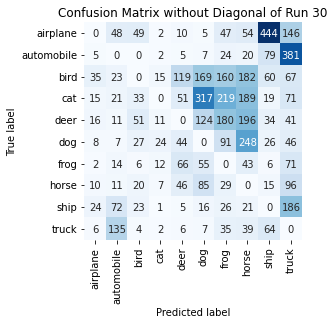

Summing down the rows, for Predictions of each Class that were wrong:  [ 121.  342.  213.   76.  352.  785.  811.  992.  747. 1105.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  119.0 times
Summing across the columns, for total number of that True Class misidentified:  [805. 523. 830. 935. 664. 521. 275. 319. 374. 298.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  196.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31 on Dataset E

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , 

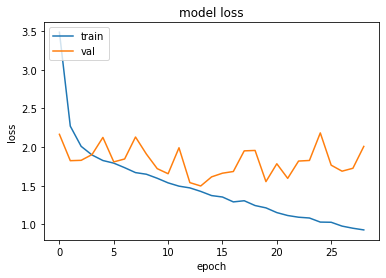

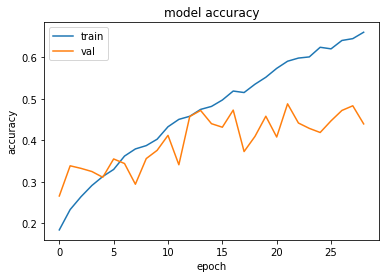

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.496827244758606 , and Val Acc happened to be 0.4717000126838684
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.4875999987125397 and Val Loss happened to be  1.5952997207641602
TestLoss:  1.4921422004699707  TestAcc: 0.4754999876022339
ship 0.793
truck 0.722
frog 0.716
dog 0.697
horse 0.514
automobile 0.507
deer 0.256
airplane 0.202
bird 0.195
cat 0.153


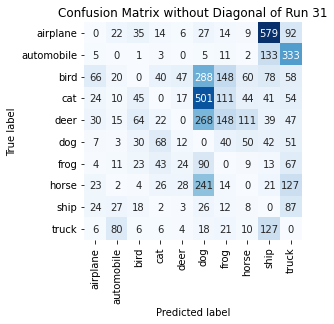

Summing down the rows, for Predictions of each Class that were wrong:  [ 189.  190.  226.  224.  141. 1464.  519.  303. 1073.  916.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  47.0 times
Summing across the columns, for total number of that True Class misidentified:  [798. 493. 805. 847. 744. 303. 284. 486. 207. 278.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  268.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32 on Dataset E

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

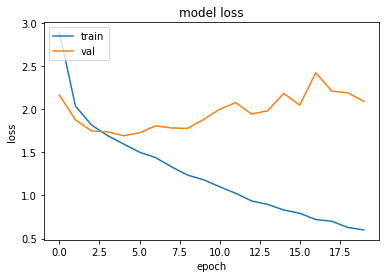

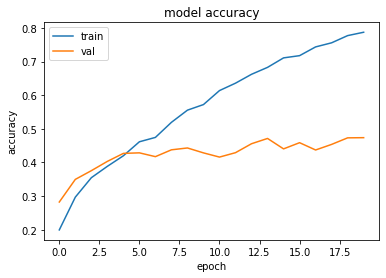

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.693314790725708 , and Val Acc happened to be 0.4268999993801117
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.47360000014305115 and Val Loss happened to be  2.0924508571624756
TestLoss:  1.6813551187515259  TestAcc: 0.43070000410079956
frog 0.815
ship 0.686
horse 0.604
truck 0.587
dog 0.504
automobile 0.375
deer 0.278
airplane 0.241
bird 0.124
cat 0.093


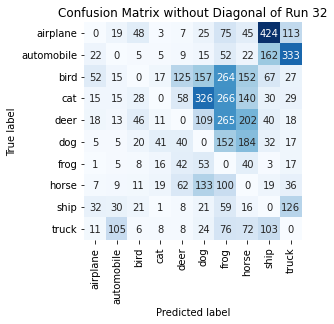

Summing down the rows, for Predictions of each Class that were wrong:  [ 163.  216.  193.  121.  359.  863. 1309.  873.  880.  716.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  125.0 times
Summing across the columns, for total number of that True Class misidentified:  [759. 625. 876. 907. 722. 496. 185. 396. 314. 413.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  265.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33 on Dataset E

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   (

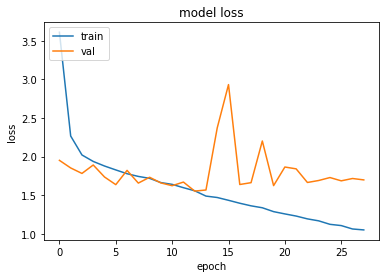

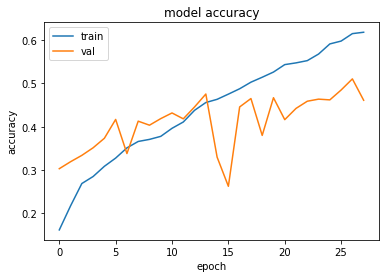

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.5530872344970703 , and Val Acc happened to be 0.4458000063896179
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5105999708175659 and Val Loss happened to be  1.716060757637024
TestLoss:  1.5280259847640991  TestAcc: 0.4456999897956848
dog 0.777
truck 0.706
horse 0.649
ship 0.611
frog 0.48
deer 0.363
automobile 0.351
airplane 0.266
cat 0.179
bird 0.075


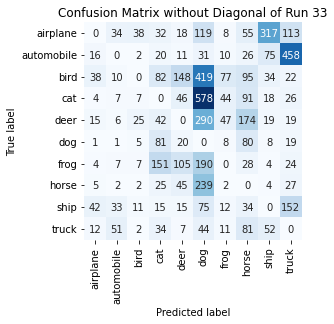

Summing down the rows, for Predictions of each Class that were wrong:  [ 137.  151.   99.  482.  415. 1985.  219.  664.  531.  860.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  148.0 times
Summing across the columns, for total number of that True Class misidentified:  [734. 649. 925. 821. 637. 223. 520. 351. 389. 294.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  290.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34 on Dataset E

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

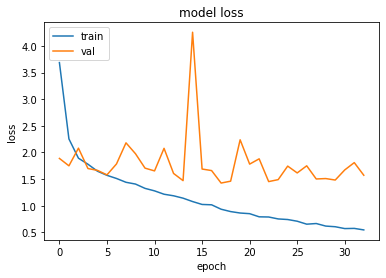

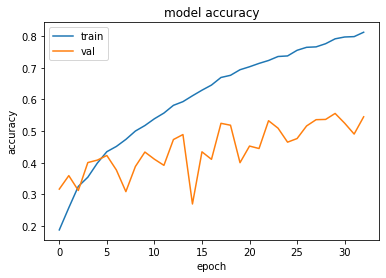

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.4260104894638062 , and Val Acc happened to be 0.5246000289916992
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5558000206947327 and Val Loss happened to be  1.4826816320419312
TestLoss:  1.4004374742507935  TestAcc: 0.535099983215332
frog 0.75
ship 0.737
dog 0.728
truck 0.704
horse 0.67
automobile 0.48
airplane 0.458
deer 0.419
bird 0.305
cat 0.1


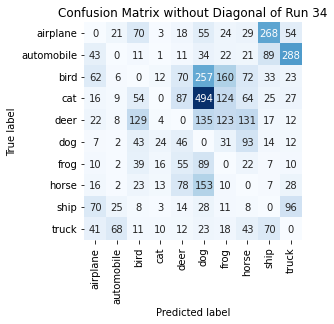

Summing down the rows, for Predictions of each Class that were wrong:  [ 287.  143.  388.   86.  391. 1268.  523.  483.  530.  550.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  87.0 times
Summing across the columns, for total number of that True Class misidentified:  [542. 520. 695. 900. 581. 272. 250. 330. 263. 296.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  135.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35 on Dataset E

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

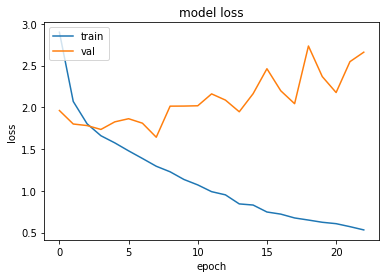

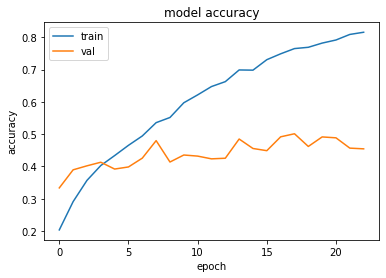

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.6418529748916626 , and Val Acc happened to be 0.4796999990940094
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5009999871253967 and Val Loss happened to be  2.0433876514434814
TestLoss:  1.618356704711914  TestAcc: 0.484499990940094
frog 0.848
ship 0.708
truck 0.6
horse 0.581
automobile 0.539
deer 0.421
dog 0.419
airplane 0.346
cat 0.247
bird 0.136


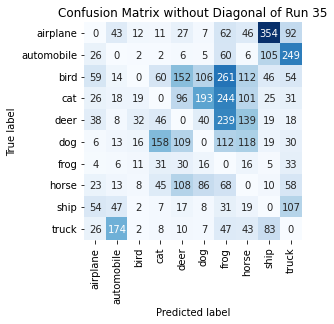

Summing down the rows, for Predictions of each Class that were wrong:  [ 262.  336.  104.  368.  555.  468. 1124.  600.  666.  672.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  152.0 times
Summing across the columns, for total number of that True Class misidentified:  [654. 461. 864. 753. 579. 581. 152. 419. 292. 400.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  239.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36 on Dataset E

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

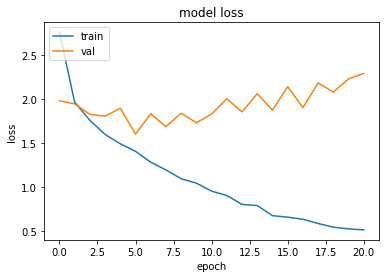

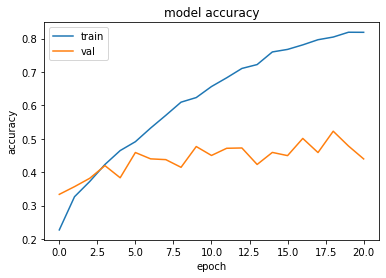

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6008816957473755 , and Val Acc happened to be 0.45899999141693115
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5228000283241272 and Val Loss happened to be  2.078627109527588
TestLoss:  1.5671889781951904  TestAcc: 0.4691999852657318
ship 0.785
horse 0.696
frog 0.66
truck 0.623
automobile 0.516
dog 0.484
deer 0.289
airplane 0.239
bird 0.238
cat 0.162


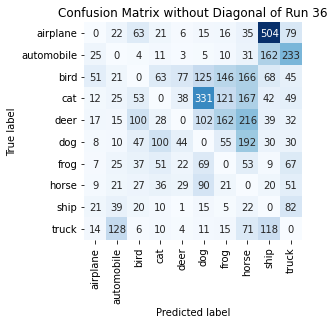

Summing down the rows, for Predictions of each Class that were wrong:  [164. 306. 357. 330. 224. 763. 551. 953. 992. 668.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  77.0 times
Summing across the columns, for total number of that True Class misidentified:  [761. 484. 762. 838. 711. 516. 340. 304. 215. 377.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  216.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37 on Dataset E

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomI

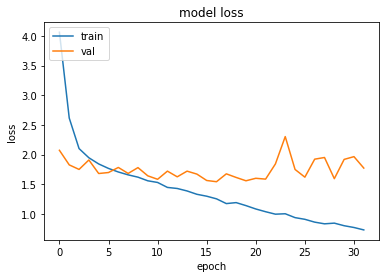

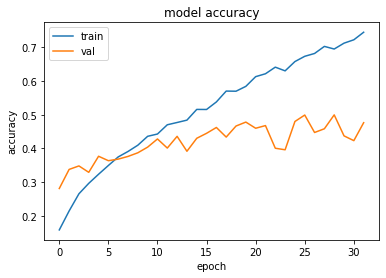

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.5430068969726562 , and Val Acc happened to be 0.4620000123977661
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.49939998984336853 and Val Loss happened to be  1.5943185091018677
TestLoss:  1.536543607711792  TestAcc: 0.45739999413490295
ship 0.732
truck 0.632
dog 0.624
horse 0.604
frog 0.586
automobile 0.455
deer 0.429
cat 0.308
airplane 0.136
bird 0.068


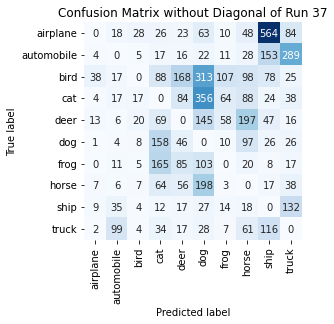

Summing down the rows, for Predictions of each Class that were wrong:  [  78.  213.   98.  633.  512. 1255.  284.  655. 1033.  665.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  168.0 times
Summing across the columns, for total number of that True Class misidentified:  [864. 545. 932. 692. 571. 376. 414. 396. 268. 368.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  197.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38 on Dataset E

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

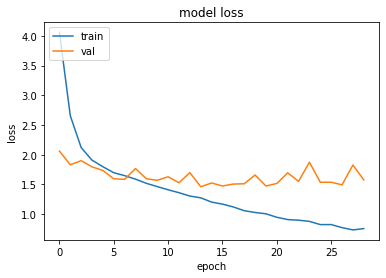

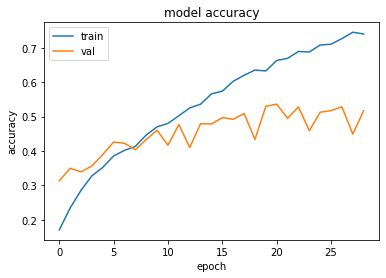

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.4608720541000366 , and Val Acc happened to be 0.4794999957084656
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5360999703407288 and Val Loss happened to be  1.5161536931991577
TestLoss:  1.4336737394332886  TestAcc: 0.48429998755455017
dog 0.805
truck 0.803
ship 0.729
horse 0.637
frog 0.531
deer 0.454
automobile 0.374
bird 0.226
airplane 0.219
cat 0.065


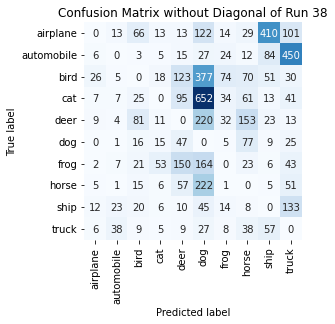

Summing down the rows, for Predictions of each Class that were wrong:  [  73.   99.  256.  132.  519. 1856.  206.  471.  658.  887.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  150.0 times
Summing across the columns, for total number of that True Class misidentified:  [781. 626. 774. 935. 546. 195. 469. 363. 271. 197.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  220.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39 on Dataset E

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

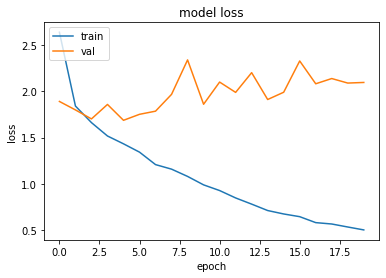

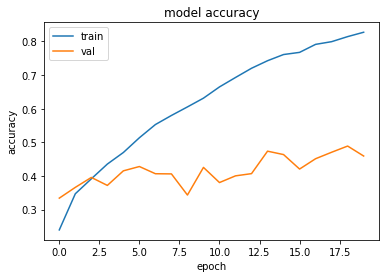

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.686781644821167 , and Val Acc happened to be 0.41530001163482666
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.48890000581741333 and Val Loss happened to be  2.089740753173828
TestLoss:  1.6740838289260864  TestAcc: 0.41290000081062317
ship 0.776
truck 0.653
frog 0.62
horse 0.611
dog 0.561
automobile 0.249
bird 0.235
deer 0.192
cat 0.127
airplane 0.105


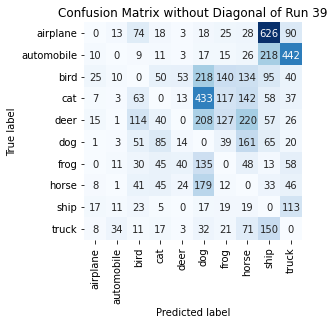

Summing down the rows, for Predictions of each Class that were wrong:  [  91.   87.  416.  316.  153. 1257.  515.  849. 1315.  872.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  53.0 times
Summing across the columns, for total number of that True Class misidentified:  [895. 751. 765. 873. 808. 439. 380. 389. 224. 347.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  220.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40 on Dataset E

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

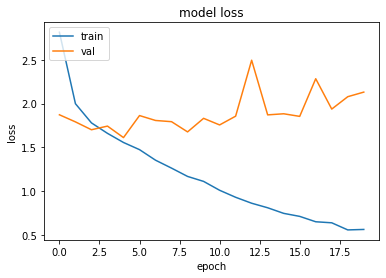

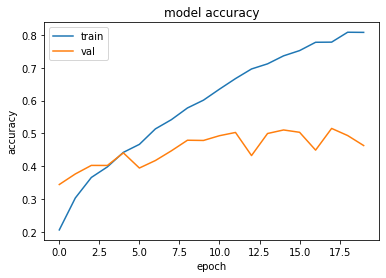

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6109265089035034 , and Val Acc happened to be 0.4406000077724457
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5152000188827515 and Val Loss happened to be  1.936983346939087
TestLoss:  1.5944160223007202  TestAcc: 0.4449999928474426
truck 0.758
frog 0.729
horse 0.697
ship 0.668
dog 0.578
automobile 0.347
deer 0.265
airplane 0.245
bird 0.104
cat 0.059


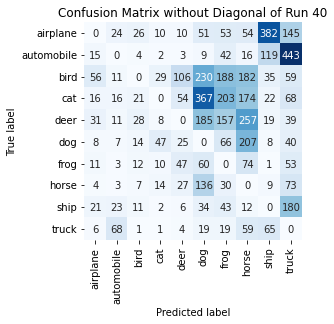

Summing down the rows, for Predictions of each Class that were wrong:  [ 168.  166.  124.  123.  282. 1091.  801. 1035.  660. 1100.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  106.0 times
Summing across the columns, for total number of that True Class misidentified:  [755. 653. 896. 941. 735. 422. 271. 303. 332. 242.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  257.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41 on Dataset E

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )


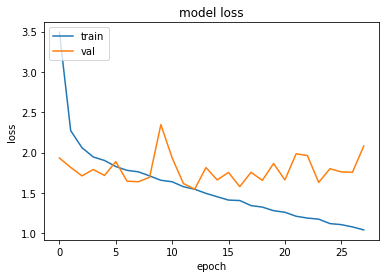

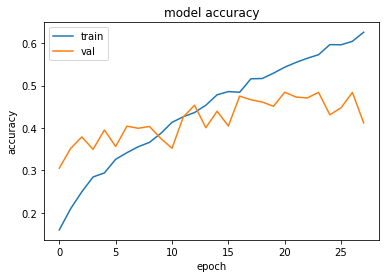

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.546094298362732 , and Val Acc happened to be 0.4535999894142151
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.48429998755455017 and Val Loss happened to be  1.6599255800247192
TestLoss:  1.5260511636734009  TestAcc: 0.45660001039505005
frog 0.855
ship 0.774
dog 0.758
automobile 0.523
truck 0.501
horse 0.454
deer 0.246
airplane 0.16
cat 0.154
bird 0.141


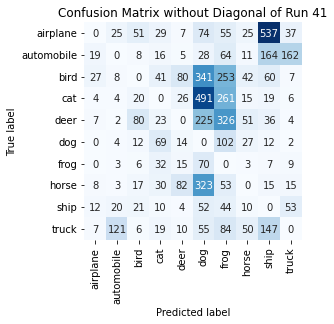

Summing down the rows, for Predictions of each Class that were wrong:  [  84.  190.  221.  269.  243. 1659. 1242.  234.  997.  295.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  82.0 times
Summing across the columns, for total number of that True Class misidentified:  [840. 477. 859. 846. 754. 242. 145. 546. 226. 499.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  326.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42 on Dataset E

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0

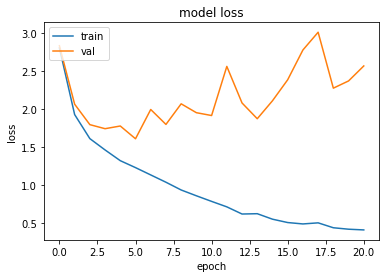

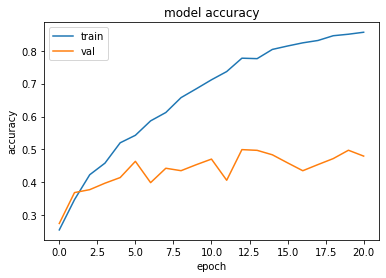

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6117875576019287 , and Val Acc happened to be 0.46389999985694885
Additionally, the best val acc epoch happened to be  12 when val acc was:  0.49950000643730164 and Val Loss happened to be  2.081815719604492
TestLoss:  1.6067993640899658  TestAcc: 0.4629000127315521
ship 0.744
horse 0.674
frog 0.643
truck 0.634
dog 0.59
automobile 0.451
deer 0.255
airplane 0.23
bird 0.214
cat 0.194


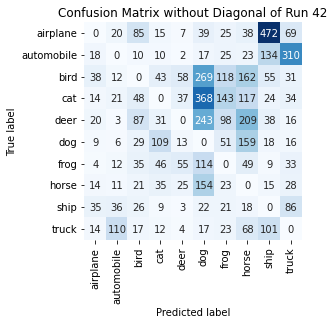

Summing down the rows, for Predictions of each Class that were wrong:  [ 166.  231.  358.  310.  204. 1243.  527.  843.  866.  623.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  58.0 times
Summing across the columns, for total number of that True Class misidentified:  [770. 549. 786. 806. 745. 410. 357. 326. 256. 366.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  243.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43 on Dataset E

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0

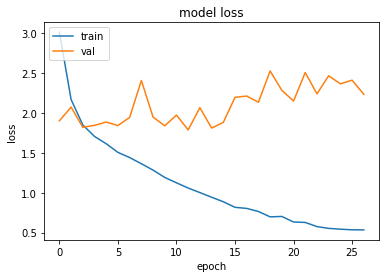

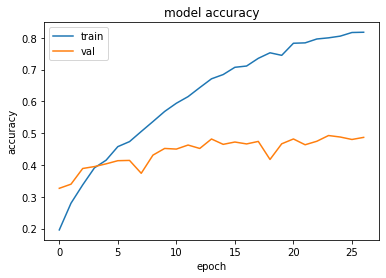

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.7859375476837158 , and Val Acc happened to be 0.4625999927520752
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.4925000071525574 and Val Loss happened to be  2.4642014503479004
TestLoss:  1.7594373226165771  TestAcc: 0.4731999933719635
frog 0.77
dog 0.697
ship 0.642
truck 0.634
horse 0.527
automobile 0.421
bird 0.328
airplane 0.295
deer 0.27
cat 0.148


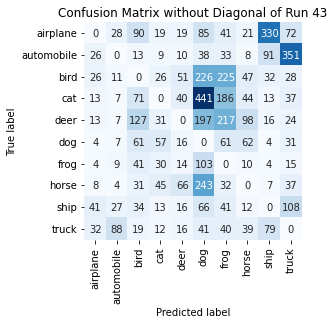

Summing down the rows, for Predictions of each Class that were wrong:  [ 167.  188.  487.  242.  248. 1440.  876.  341.  576.  703.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  66.0 times
Summing across the columns, for total number of that True Class misidentified:  [705. 579. 672. 852. 730. 303. 230. 473. 358. 366.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  217.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44 on Dataset E

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

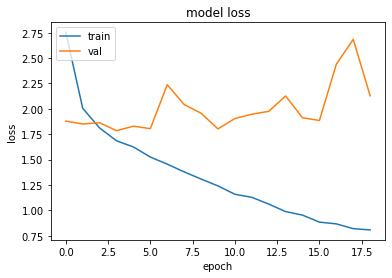

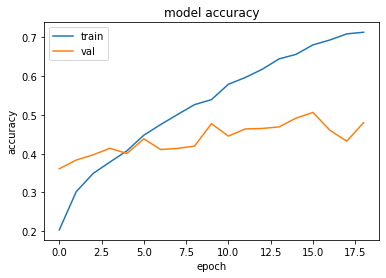

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.7842708826065063 , and Val Acc happened to be 0.4138999879360199
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5062000155448914 and Val Loss happened to be  1.88478422164917
TestLoss:  1.7811744213104248  TestAcc: 0.4133000075817108
ship 0.814
horse 0.661
dog 0.555
frog 0.491
truck 0.47
automobile 0.428
deer 0.242
airplane 0.206
bird 0.159
cat 0.107


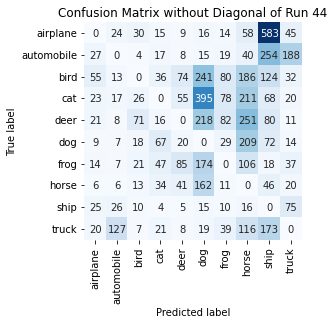

Summing down the rows, for Predictions of each Class that were wrong:  [ 200.  235.  200.  257.  305. 1255.  362. 1193. 1418.  442.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  85.0 times
Summing across the columns, for total number of that True Class misidentified:  [794. 572. 841. 893. 758. 445. 509. 339. 186. 530.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  251.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45 on Dataset E

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   (

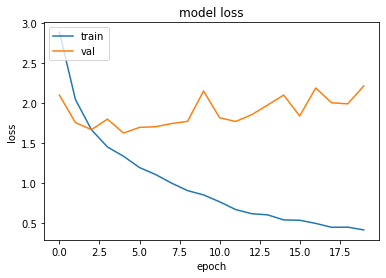

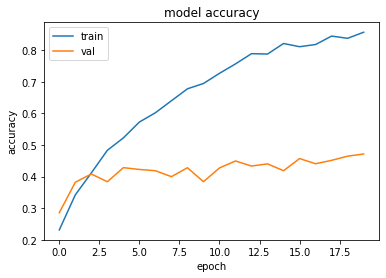

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6256673336029053 , and Val Acc happened to be 0.42800000309944153
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.47130000591278076 and Val Loss happened to be  2.213689088821411
TestLoss:  1.609435796737671  TestAcc: 0.43230000138282776
frog 0.847
ship 0.569
truck 0.49
dog 0.481
automobile 0.471
horse 0.43
deer 0.373
airplane 0.369
bird 0.155
cat 0.138


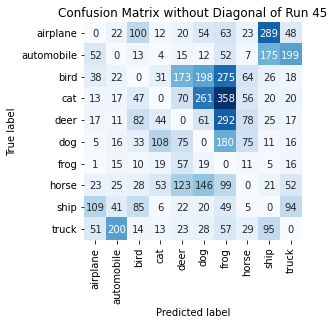

Summing down the rows, for Predictions of each Class that were wrong:  [ 309.  369.  412.  290.  578.  799. 1425.  348.  667.  480.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  173.0 times
Summing across the columns, for total number of that True Class misidentified:  [631. 529. 845. 862. 627. 519. 153. 570. 431. 510.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  292.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46 on Dataset E

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Z

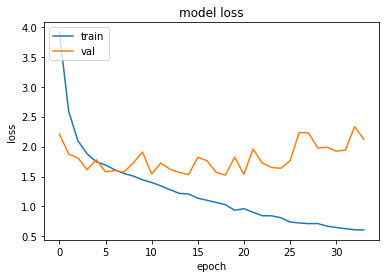

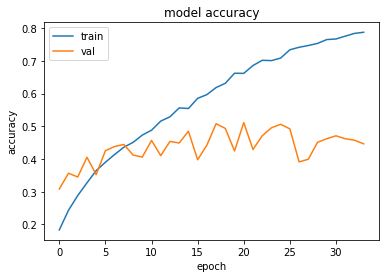

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.5230244398117065 , and Val Acc happened to be 0.4934999942779541
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5112000107765198 and Val Loss happened to be  1.5348941087722778
TestLoss:  1.506569743156433  TestAcc: 0.5052000284194946
truck 0.769
horse 0.704
frog 0.658
dog 0.657
ship 0.618
airplane 0.382
automobile 0.348
deer 0.333
bird 0.326
cat 0.257


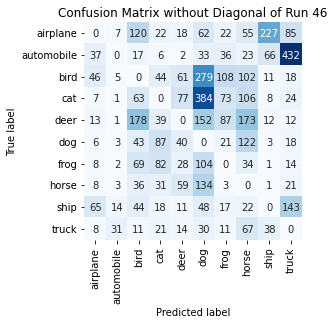

Summing down the rows, for Predictions of each Class that were wrong:  [ 198.   67.  581.  350.  310. 1226.  378.  704.  367.  767.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  77.0 times
Summing across the columns, for total number of that True Class misidentified:  [618. 652. 674. 743. 667. 343. 342. 296. 382. 231.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  178.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47 on Dataset E

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 

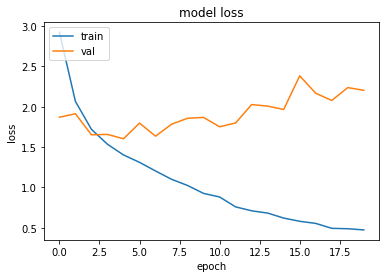

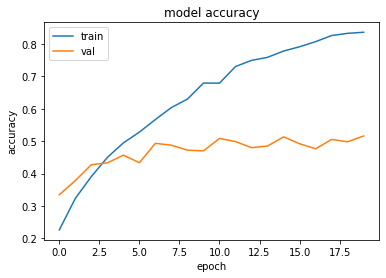

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6034283638000488 , and Val Acc happened to be 0.45660001039505005
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5157999992370605 and Val Loss happened to be  2.2039999961853027
TestLoss:  1.5888077020645142  TestAcc: 0.45329999923706055
ship 0.826
horse 0.74
truck 0.607
frog 0.553
deer 0.497
automobile 0.398
dog 0.343
airplane 0.258
cat 0.184
bird 0.127


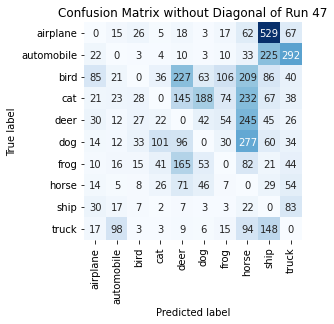

Summing down the rows, for Predictions of each Class that were wrong:  [ 243.  219.  150.  240.  748.  407.  316. 1256. 1210.  678.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  227.0 times
Summing across the columns, for total number of that True Class misidentified:  [742. 602. 873. 816. 503. 657. 447. 260. 174. 393.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  245.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48 on Dataset E

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

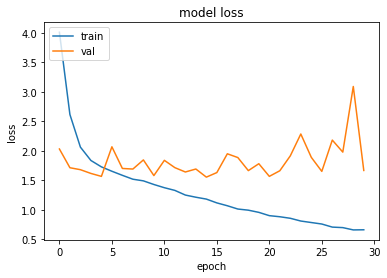

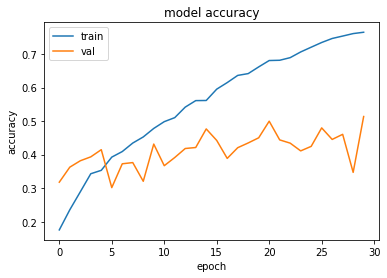

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.5541115999221802 , and Val Acc happened to be 0.4767000079154968
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.513700008392334 and Val Loss happened to be  1.6673434972763062
TestLoss:  1.543097972869873  TestAcc: 0.47909998893737793
truck 0.811
horse 0.782
ship 0.739
frog 0.613
dog 0.462
automobile 0.407
deer 0.336
airplane 0.272
bird 0.217
cat 0.152


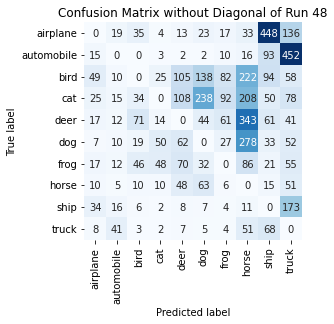

Summing down the rows, for Predictions of each Class that were wrong:  [ 182.  140.  224.  158.  423.  552.  303. 1248.  883. 1096.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  108.0 times
Summing across the columns, for total number of that True Class misidentified:  [728. 593. 783. 848. 664. 538. 387. 218. 261. 189.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  343.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49 on Dataset E

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

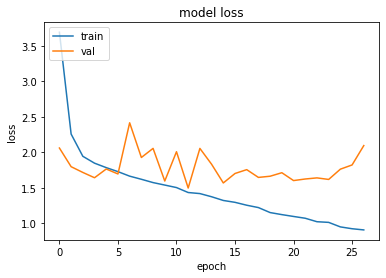

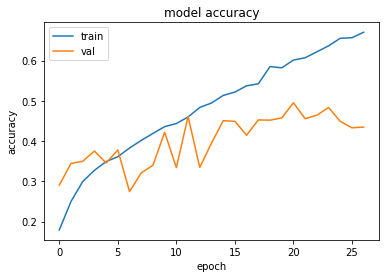

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.498260736465454 , and Val Acc happened to be 0.4611000120639801
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.4948999881744385 and Val Loss happened to be  1.6034495830535889
TestLoss:  1.4910796880722046  TestAcc: 0.46549999713897705
truck 0.803
ship 0.681
horse 0.641
frog 0.628
dog 0.59
deer 0.391
automobile 0.308
cat 0.278
airplane 0.217
bird 0.118


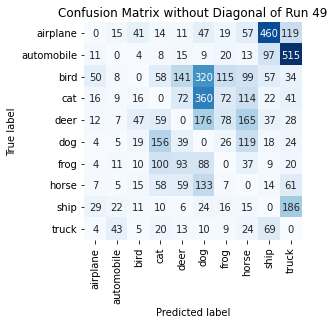

Summing down the rows, for Predictions of each Class that were wrong:  [ 137.  125.  168.  483.  449. 1167.  362.  643.  783. 1028.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  141.0 times
Summing across the columns, for total number of that True Class misidentified:  [783. 692. 882. 722. 609. 410. 372. 359. 319. 197.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  176.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50 on Dataset E

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )


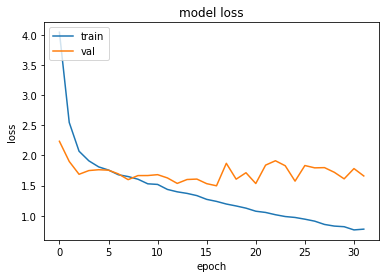

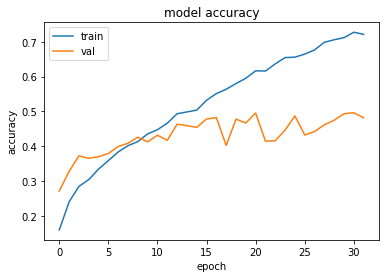

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.4954301118850708 , and Val Acc happened to be 0.48170000314712524
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.49570000171661377 and Val Loss happened to be  1.780907392501831
TestLoss:  1.4643288850784302  TestAcc: 0.4862000048160553
truck 0.71
frog 0.703
ship 0.645
horse 0.599
dog 0.595
deer 0.448
automobile 0.414
cat 0.307
bird 0.228
airplane 0.213


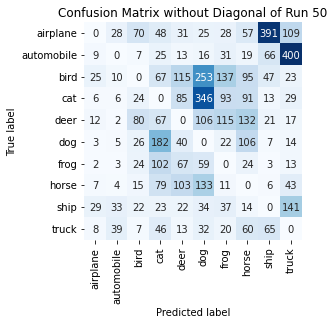

Summing down the rows, for Predictions of each Class that were wrong:  [ 101.  130.  275.  639.  489. 1004.  494.  598.  619.  789.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  115.0 times
Summing across the columns, for total number of that True Class misidentified:  [787. 586. 772. 693. 552. 405. 297. 401. 355. 290.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  132.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 18 November 2021 21:58:09  (subtract ~5-hours for local Hour), and file is called  runs_GroupE_final.pkl


In [80]:
run_through_runs(ds=trainE, ds_noalb=trainE_noalb, dstitle = "E", showpictures=False)

filename will be:  runs_GroupF .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset F

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5


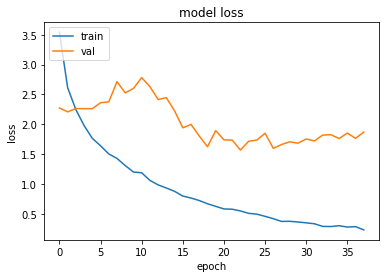

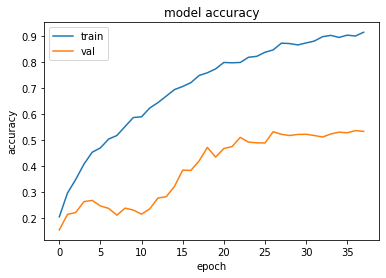

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  22 when  Val Loss was:  1.5694489479064941 , and Val Acc happened to be 0.5102999806404114
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5364999771118164 and Val Loss happened to be  1.7656381130218506
TestLoss:  1.5513643026351929  TestAcc: 0.5123999714851379
frog 0.776
ship 0.759
automobile 0.647
horse 0.529
dog 0.464
airplane 0.442
truck 0.435
bird 0.395
deer 0.395
cat 0.282


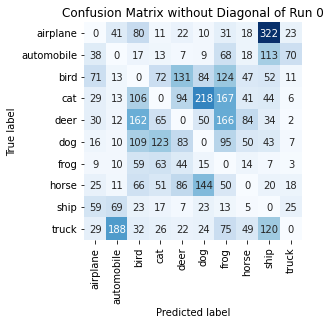

Summing down the rows, for Predictions of each Class that were wrong:  [306. 367. 654. 441. 496. 577. 789. 326. 755. 165.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  131.0 times
Summing across the columns, for total number of that True Class misidentified:  [558. 353. 605. 718. 605. 536. 224. 471. 241. 565.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  166.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1 on Dataset F

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright

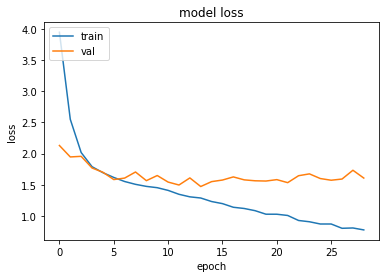

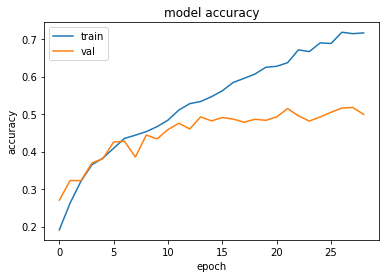

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.4732005596160889 , and Val Acc happened to be 0.4925000071525574
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5177000164985657 and Val Loss happened to be  1.7337679862976074
TestLoss:  1.4355709552764893  TestAcc: 0.4927000105381012
frog 0.74
automobile 0.695
horse 0.655
ship 0.584
truck 0.492
dog 0.43
airplane 0.398
deer 0.356
cat 0.355
bird 0.222


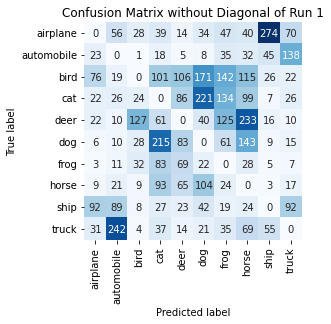

Summing down the rows, for Predictions of each Class that were wrong:  [284. 484. 261. 674. 465. 663. 622. 783. 440. 397.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  106.0 times
Summing across the columns, for total number of that True Class misidentified:  [602. 305. 778. 645. 644. 570. 260. 345. 416. 508.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  233.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2 on Dataset F

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2 , 0.2 )

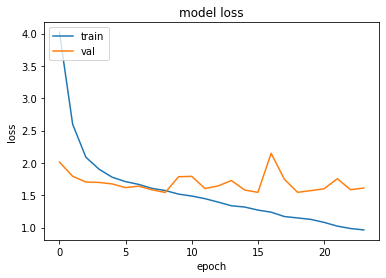

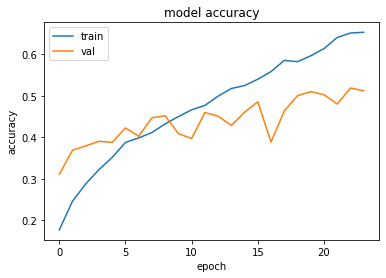

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.5419293642044067 , and Val Acc happened to be 0.4521999955177307
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.51910001039505 and Val Loss happened to be  1.5850999355316162
TestLoss:  1.5201337337493896  TestAcc: 0.4537999927997589
frog 0.819
ship 0.802
dog 0.63
horse 0.545
truck 0.484
automobile 0.462
airplane 0.28
bird 0.259
deer 0.212
cat 0.045


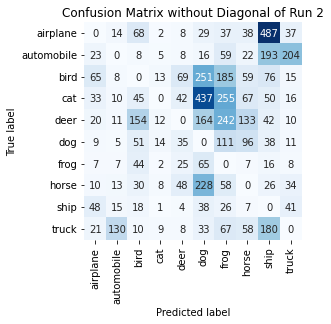

Summing down the rows, for Predictions of each Class that were wrong:  [ 236.  213.  428.   66.  247. 1261. 1040.  487. 1108.  376.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  69.0 times
Summing across the columns, for total number of that True Class misidentified:  [720. 538. 741. 955. 788. 370. 181. 455. 198. 516.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  242.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3 on Dataset F

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contras

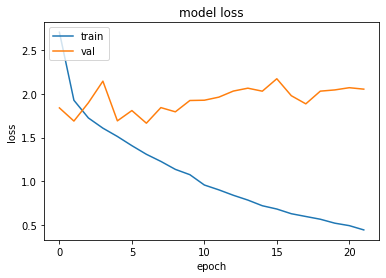

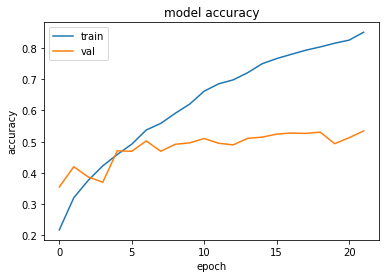

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.6645196676254272 , and Val Acc happened to be 0.5023999810218811
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5343999862670898 and Val Loss happened to be  2.0538933277130127
TestLoss:  1.641343355178833  TestAcc: 0.4964999854564667
frog 0.799
automobile 0.702
dog 0.671
ship 0.664
horse 0.598
truck 0.533
deer 0.354
airplane 0.3
bird 0.189
cat 0.155


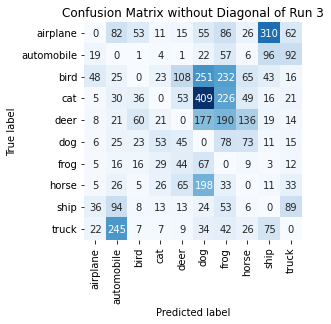

Summing down the rows, for Predictions of each Class that were wrong:  [ 154.  564.  209.  187.  353. 1237.  997.  396.  584.  354.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  108.0 times
Summing across the columns, for total number of that True Class misidentified:  [700. 298. 811. 845. 646. 329. 201. 402. 336. 467.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  190.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4 on Dataset F

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 ,

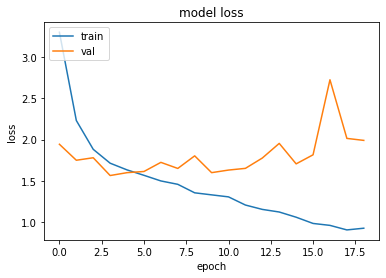

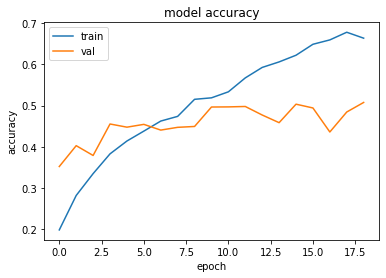

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.563531517982483 , and Val Acc happened to be 0.4553000032901764
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5076000094413757 and Val Loss happened to be  1.9893312454223633
TestLoss:  1.5402127504348755  TestAcc: 0.4507000148296356
frog 0.869
ship 0.605
automobile 0.576
horse 0.536
truck 0.514
airplane 0.464
dog 0.427
deer 0.195
bird 0.191
cat 0.13


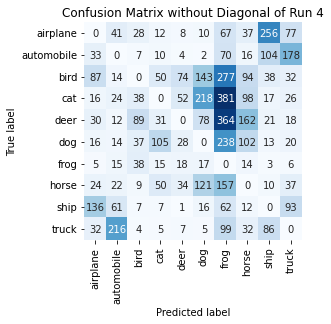

Summing down the rows, for Predictions of each Class that were wrong:  [ 379.  419.  257.  285.  226.  610. 1715.  567.  548.  487.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  74.0 times
Summing across the columns, for total number of that True Class misidentified:  [536. 424. 809. 870. 805. 573. 131. 464. 395. 486.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  364.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5 on Dataset F

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0

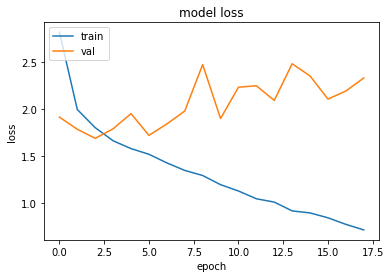

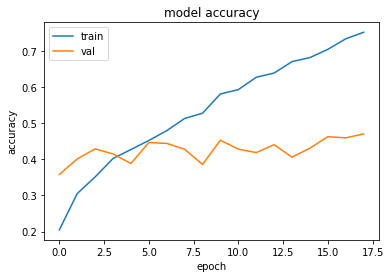

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.6854935884475708 , and Val Acc happened to be 0.4291999936103821
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.4706000089645386 and Val Loss happened to be  2.3267927169799805
TestLoss:  1.6426728963851929  TestAcc: 0.42800000309944153
truck 0.68
frog 0.659
horse 0.628
dog 0.543
ship 0.489
automobile 0.452
airplane 0.31
bird 0.207
deer 0.207
cat 0.105


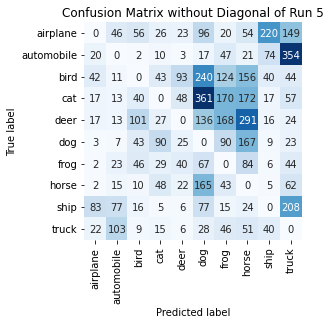

Summing down the rows, for Predictions of each Class that were wrong:  [ 208.  308.  323.  293.  266. 1187.  723. 1020.  427.  965.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  93.0 times
Summing across the columns, for total number of that True Class misidentified:  [690. 548. 793. 895. 793. 457. 341. 372. 511. 320.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  291.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6 on Dataset F

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contra

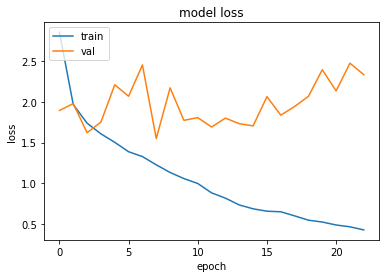

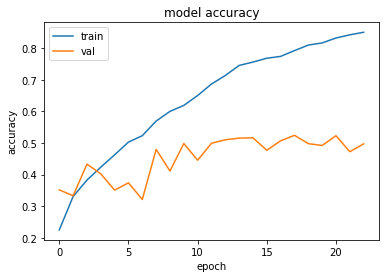

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.5499509572982788 , and Val Acc happened to be 0.4796000123023987
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5241000056266785 and Val Loss happened to be  1.9443050622940063
TestLoss:  1.5415819883346558  TestAcc: 0.47589999437332153
horse 0.723
ship 0.684
truck 0.679
dog 0.599
frog 0.479
automobile 0.457
deer 0.413
bird 0.335
airplane 0.248
cat 0.142


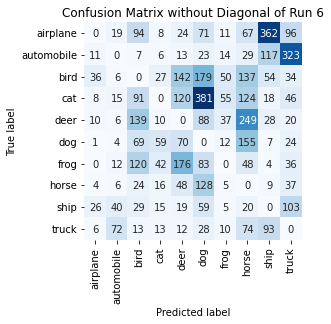

Summing down the rows, for Predictions of each Class that were wrong:  [ 102.  180.  586.  196.  624. 1040.  199.  903.  692.  719.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [752. 543. 665. 858. 587. 401. 521. 277. 316. 321.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  249.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7 on Dataset F

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Con

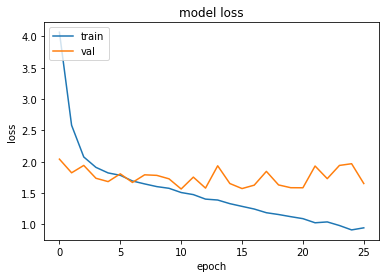

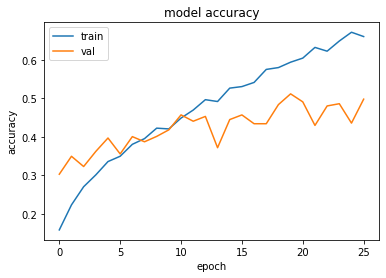

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.563864827156067 , and Val Acc happened to be 0.4571000039577484
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5116999745368958 and Val Loss happened to be  1.5844340324401855
TestLoss:  1.546162724494934  TestAcc: 0.4546000063419342
dog 0.746
ship 0.689
horse 0.687
automobile 0.566
truck 0.54
frog 0.538
airplane 0.303
deer 0.301
cat 0.102
bird 0.074


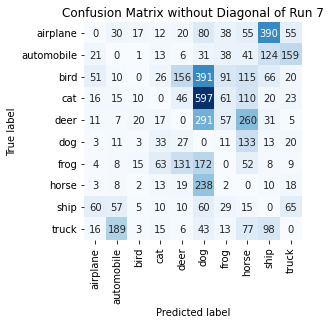

Summing down the rows, for Predictions of each Class that were wrong:  [ 185.  335.   76.  202.  421. 1903.  340.  858.  760.  374.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  156.0 times
Summing across the columns, for total number of that True Class misidentified:  [697. 434. 926. 898. 699. 254. 462. 313. 311. 460.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  291.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8 on Dataset F

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0

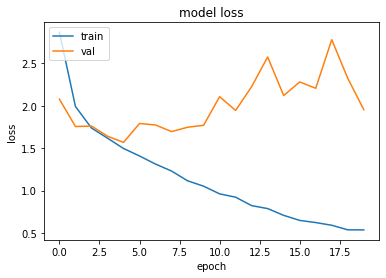

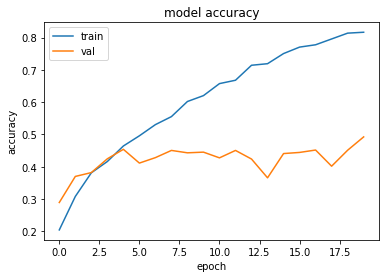

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.568410038948059 , and Val Acc happened to be 0.453900009393692
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.49239999055862427 and Val Loss happened to be  1.9549027681350708
TestLoss:  1.5472549200057983  TestAcc: 0.4546000063419342
truck 0.658
frog 0.655
dog 0.632
horse 0.62
ship 0.607
airplane 0.422
bird 0.407
automobile 0.367
deer 0.107
cat 0.071


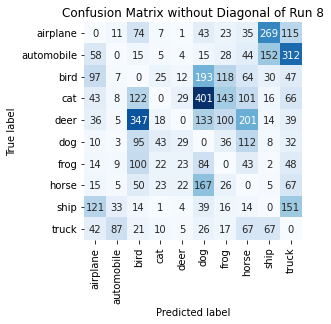

Summing down the rows, for Predictions of each Class that were wrong:  [ 436.  168.  838.  154.  129. 1101.  507.  681.  563.  877.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  29.0 times
Summing across the columns, for total number of that True Class misidentified:  [578. 633. 593. 929. 893. 368. 345. 380. 393. 342.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  347.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9 on Dataset F

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 

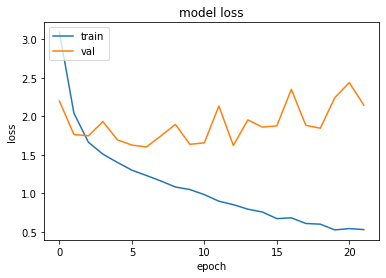

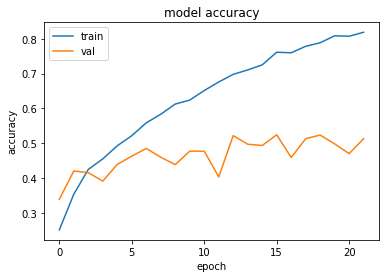

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.6027181148529053 , and Val Acc happened to be 0.48500001430511475
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5242000222206116 and Val Loss happened to be  1.8755614757537842
TestLoss:  1.5823791027069092  TestAcc: 0.4788999855518341
frog 0.822
dog 0.587
truck 0.574
ship 0.572
airplane 0.522
automobile 0.507
horse 0.433
bird 0.339
deer 0.237
cat 0.196


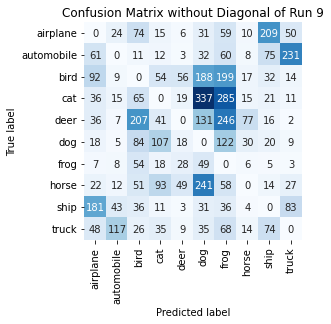

Summing down the rows, for Predictions of each Class that were wrong:  [ 501.  240.  608.  386.  191. 1075. 1133.  181.  466.  430.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  56.0 times
Summing across the columns, for total number of that True Class misidentified:  [478. 493. 661. 804. 763. 413. 178. 567. 428. 426.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  246.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10 on Dataset F

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

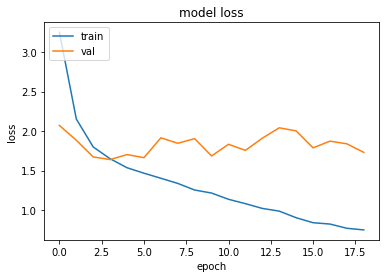

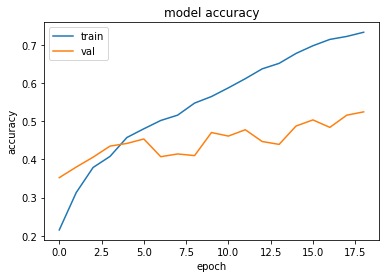

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6384400129318237 , and Val Acc happened to be 0.4350000023841858
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5248000025749207 and Val Loss happened to be  1.7294667959213257
TestLoss:  1.628093957901001  TestAcc: 0.43959999084472656
automobile 0.72
frog 0.632
truck 0.62
dog 0.598
horse 0.514
ship 0.493
airplane 0.311
deer 0.301
cat 0.13
bird 0.077


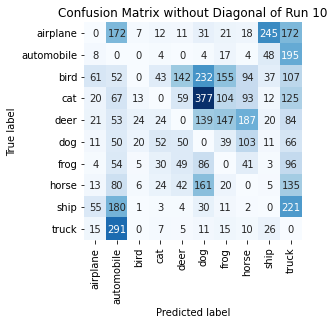

Summing down the rows, for Predictions of each Class that were wrong:  [ 208.  999.   76.  199.  362. 1071.  529.  552.  407. 1201.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  142.0 times
Summing across the columns, for total number of that True Class misidentified:  [689. 280. 923. 870. 699. 402. 368. 486. 507. 380.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  187.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11 on Dataset F

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

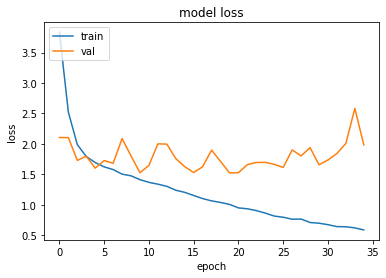

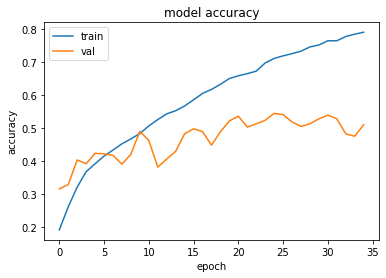

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.524245262145996 , and Val Acc happened to be 0.5214999914169312
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5442000031471252 and Val Loss happened to be  1.6645816564559937
TestLoss:  1.5087112188339233  TestAcc: 0.517799973487854
frog 0.721
dog 0.688
horse 0.667
truck 0.632
ship 0.594
automobile 0.539
airplane 0.467
bird 0.347
cat 0.311
deer 0.212


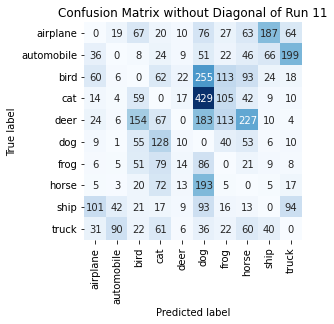

Summing down the rows, for Predictions of each Class that were wrong:  [ 286.  176.  457.  530.  110. 1402.  463.  618.  356.  424.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  22.0 times
Summing across the columns, for total number of that True Class misidentified:  [533. 461. 653. 689. 788. 312. 279. 333. 406. 368.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  227.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12 on Dataset F

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
Z

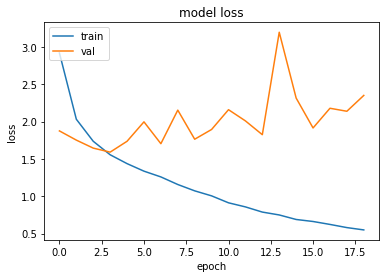

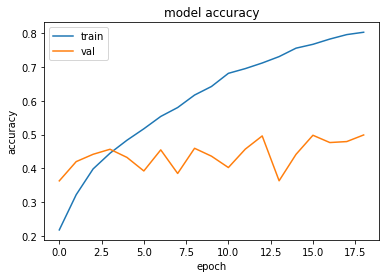

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.5903818607330322 , and Val Acc happened to be 0.4562999904155731
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.49869999289512634 and Val Loss happened to be  2.3495283126831055
TestLoss:  1.5813766717910767  TestAcc: 0.4505000114440918
truck 0.74
frog 0.675
ship 0.597
horse 0.572
dog 0.423
airplane 0.379
automobile 0.364
deer 0.35
cat 0.233
bird 0.172


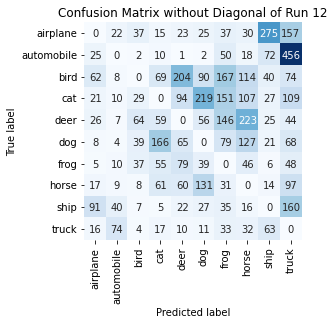

Summing down the rows, for Predictions of each Class that were wrong:  [ 271.  184.  227.  457.  558.  600.  729.  713.  543. 1213.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  204.0 times
Summing across the columns, for total number of that True Class misidentified:  [621. 636. 828. 767. 650. 577. 325. 428. 403. 260.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  223.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13 on Dataset F

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )


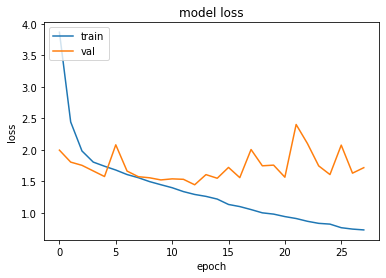

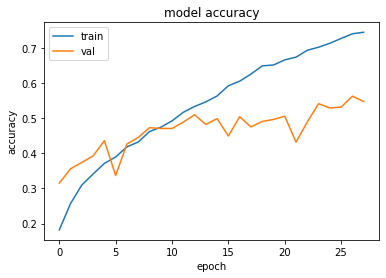

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4451308250427246 , and Val Acc happened to be 0.5094000101089478
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5620999932289124 and Val Loss happened to be  1.6294169425964355
TestLoss:  1.4362199306488037  TestAcc: 0.5042999982833862
frog 0.701
ship 0.692
automobile 0.63
truck 0.623
horse 0.621
dog 0.616
deer 0.465
airplane 0.298
bird 0.237
cat 0.16


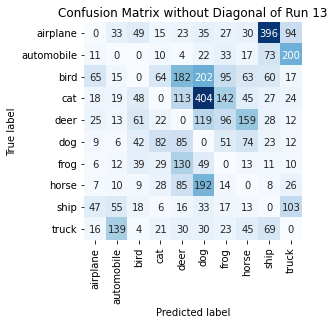

Summing down the rows, for Predictions of each Class that were wrong:  [ 204.  302.  270.  277.  668. 1086.  498.  459.  695.  498.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  182.0 times
Summing across the columns, for total number of that True Class misidentified:  [702. 370. 763. 840. 535. 384. 299. 379. 308. 377.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  159.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14 on Dataset F

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 

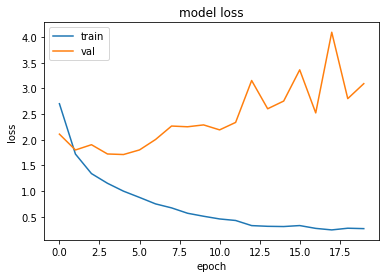

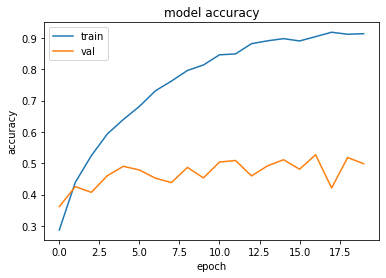

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.7113091945648193 , and Val Acc happened to be 0.4900999963283539
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5270000100135803 and Val Loss happened to be  2.522759437561035
TestLoss:  1.669171929359436  TestAcc: 0.48420000076293945
frog 0.724
ship 0.699
automobile 0.584
dog 0.534
horse 0.531
truck 0.508
airplane 0.435
deer 0.31
bird 0.289
cat 0.228


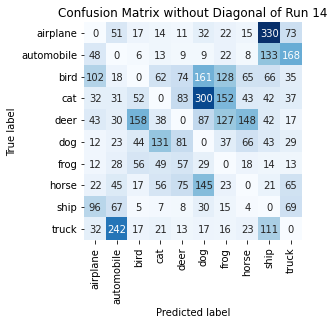

Summing down the rows, for Predictions of each Class that were wrong:  [399. 535. 372. 391. 411. 810. 542. 390. 802. 506.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  83.0 times
Summing across the columns, for total number of that True Class misidentified:  [565. 416. 711. 772. 690. 466. 276. 469. 301. 492.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  158.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15 on Dataset F

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )


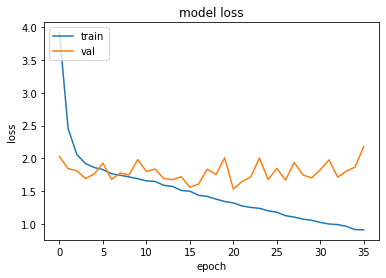

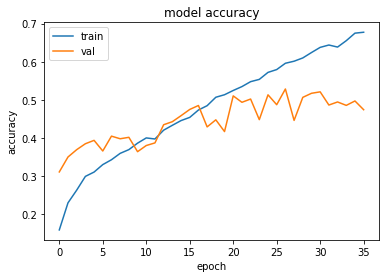

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  20 when  Val Loss was:  1.5321800708770752 , and Val Acc happened to be 0.5099999904632568
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5281000137329102 and Val Loss happened to be  1.6704343557357788
TestLoss:  1.4976657629013062  TestAcc: 0.5134999752044678
frog 0.754
automobile 0.683
dog 0.652
truck 0.549
ship 0.548
horse 0.543
airplane 0.466
deer 0.409
bird 0.273
cat 0.258


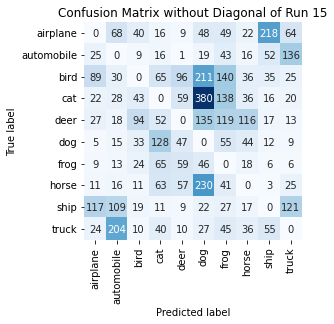

Summing down the rows, for Predictions of each Class that were wrong:  [ 329.  501.  283.  456.  347. 1118.  657.  341.  414.  419.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  96.0 times
Summing across the columns, for total number of that True Class misidentified:  [534. 317. 727. 742. 591. 348. 246. 457. 452. 451.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  135.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16 on Dataset F

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zoo

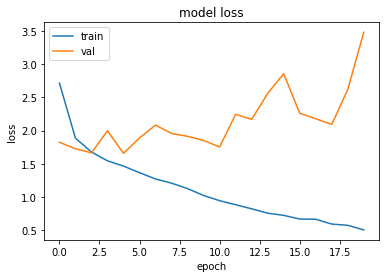

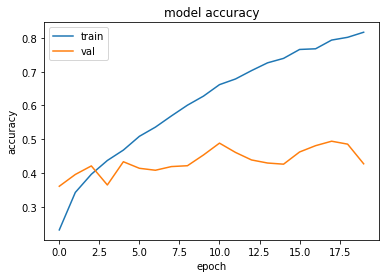

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6567527055740356 , and Val Acc happened to be 0.4332999885082245
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.49410000443458557 and Val Loss happened to be  2.0919201374053955
TestLoss:  1.637086272239685  TestAcc: 0.42800000309944153
frog 0.857
horse 0.585
truck 0.579
automobile 0.569
dog 0.44
ship 0.397
deer 0.34
airplane 0.244
cat 0.22
bird 0.049


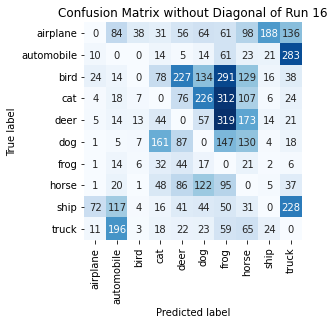

Summing down the rows, for Predictions of each Class that were wrong:  [ 129.  482.   79.  442.  644.  701. 1395.  777.  280.  791.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  227.0 times
Summing across the columns, for total number of that True Class misidentified:  [756. 431. 951. 780. 660. 560. 143. 415. 603. 421.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  319.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17 on Dataset F

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -

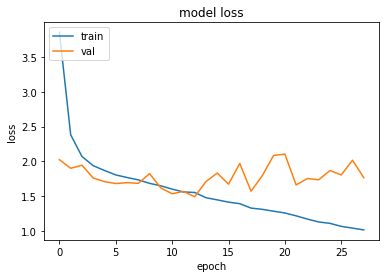

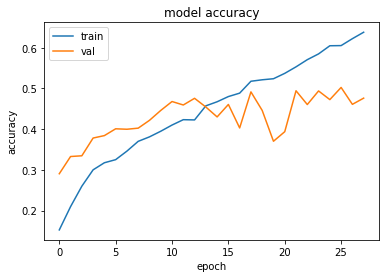

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4913012981414795 , and Val Acc happened to be 0.4756999909877777
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5023999810218811 and Val Loss happened to be  1.8047082424163818
TestLoss:  1.4573111534118652  TestAcc: 0.4706000089645386
truck 0.766
horse 0.75
frog 0.632
ship 0.612
dog 0.481
automobile 0.463
deer 0.456
airplane 0.31
bird 0.15
cat 0.086


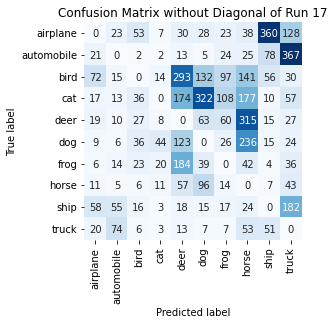

Summing down the rows, for Predictions of each Class that were wrong:  [ 233.  215.  205.  112.  905.  707.  376. 1051.  596.  894.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  293.0 times
Summing across the columns, for total number of that True Class misidentified:  [690. 537. 850. 914. 544. 519. 368. 250. 388. 234.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  315.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18 on Dataset F

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

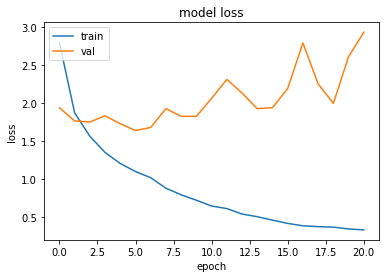

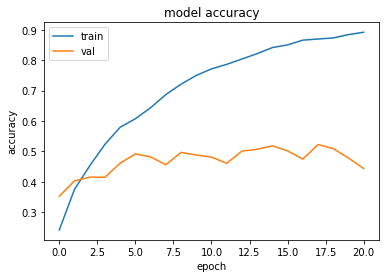

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6370573043823242 , and Val Acc happened to be 0.4918000102043152
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5224999785423279 and Val Loss happened to be  2.251530170440674
TestLoss:  1.6392375230789185  TestAcc: 0.48179998993873596
frog 0.744
ship 0.637
truck 0.591
dog 0.566
airplane 0.563
horse 0.527
automobile 0.478
bird 0.318
deer 0.201
cat 0.193


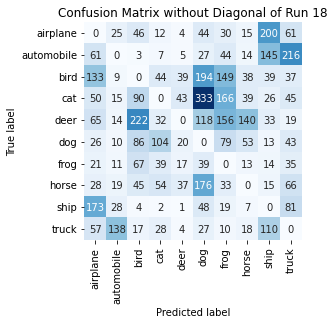

Summing down the rows, for Predictions of each Class that were wrong:  [ 614.  269.  580.  322.  170. 1006.  686.  337.  595.  603.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  43.0 times
Summing across the columns, for total number of that True Class misidentified:  [437. 522. 682. 807. 799. 434. 256. 473. 363. 409.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  222.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19 on Dataset F

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

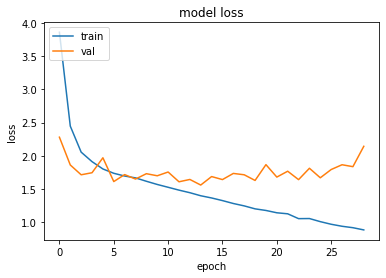

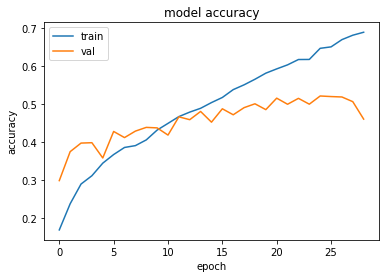

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.5582587718963623 , and Val Acc happened to be 0.48089998960494995
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5214999914169312 and Val Loss happened to be  1.6677552461624146
TestLoss:  1.5175729990005493  TestAcc: 0.4893999993801117
frog 0.693
automobile 0.64
truck 0.618
horse 0.615
dog 0.602
ship 0.437
deer 0.413
airplane 0.39
cat 0.361
bird 0.125


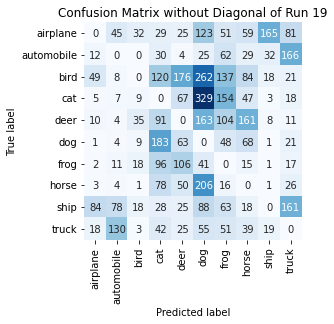

Summing down the rows, for Predictions of each Class that were wrong:  [ 184.  291.  125.  697.  541. 1292.  686.  520.  248.  522.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [610. 360. 875. 639. 587. 398. 307. 385. 563. 382.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  163.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20 on Dataset F

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

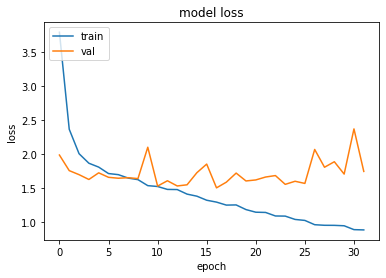

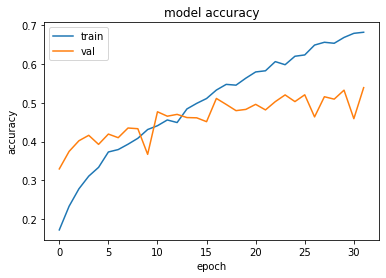

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  16 when  Val Loss was:  1.5081406831741333 , and Val Acc happened to be 0.5109999775886536
Additionally, the best val acc epoch happened to be  31 when val acc was:  0.5388000011444092 and Val Loss happened to be  1.7494460344314575
TestLoss:  1.4637185335159302  TestAcc: 0.5060999989509583
dog 0.692
automobile 0.683
frog 0.625
ship 0.611
horse 0.594
truck 0.587
deer 0.455
airplane 0.372
cat 0.237
bird 0.205


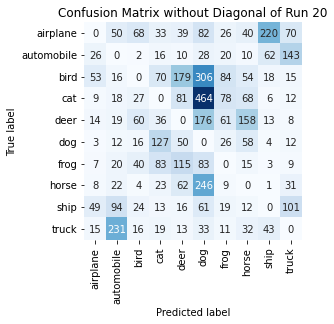

Summing down the rows, for Predictions of each Class that were wrong:  [ 184.  482.  257.  420.  565. 1479.  334.  447.  370.  401.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  179.0 times
Summing across the columns, for total number of that True Class misidentified:  [628. 317. 795. 763. 545. 308. 375. 406. 389. 413.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  176.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21 on Dataset F

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.

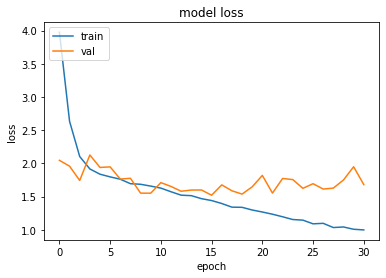

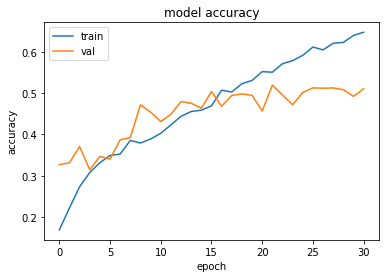

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.5200531482696533 , and Val Acc happened to be 0.5037999749183655
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5194000005722046 and Val Loss happened to be  1.5520050525665283
TestLoss:  1.4872688055038452  TestAcc: 0.5002999901771545
frog 0.786
automobile 0.752
truck 0.654
horse 0.546
deer 0.502
ship 0.502
dog 0.47
airplane 0.339
cat 0.31
bird 0.142


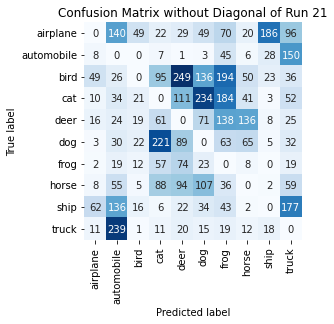

Summing down the rows, for Predictions of each Class that were wrong:  [169. 703. 145. 568. 689. 672. 792. 340. 273. 646.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  249.0 times
Summing across the columns, for total number of that True Class misidentified:  [661. 248. 858. 690. 498. 530. 214. 454. 498. 346.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  138.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22 on Dataset F

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.

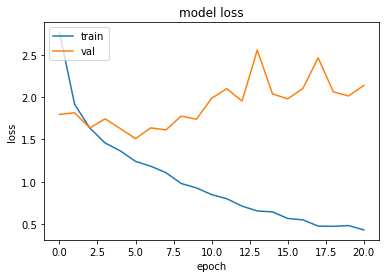

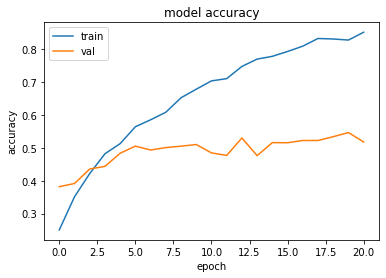

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5098644495010376 , and Val Acc happened to be 0.505299985408783
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5467000007629395 and Val Loss happened to be  2.015307664871216
TestLoss:  1.4651284217834473  TestAcc: 0.5055000185966492
frog 0.698
truck 0.697
horse 0.662
automobile 0.659
ship 0.551
airplane 0.433
dog 0.406
deer 0.358
bird 0.313
cat 0.278


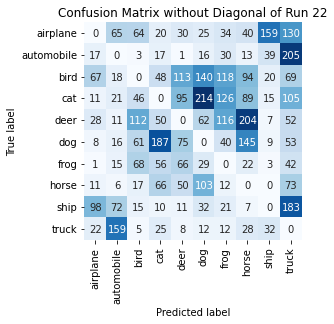

Summing down the rows, for Predictions of each Class that were wrong:  [263. 383. 391. 479. 449. 633. 509. 642. 284. 912.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  113.0 times
Summing across the columns, for total number of that True Class misidentified:  [567. 341. 687. 722. 642. 594. 302. 338. 449. 303.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  204.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23 on Dataset F

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

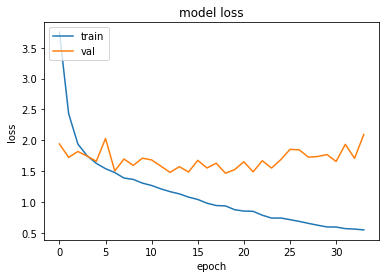

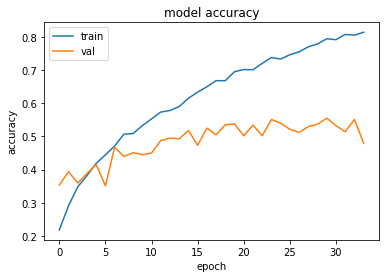

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.4655640125274658 , and Val Acc happened to be 0.5353000164031982
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5550000071525574 and Val Loss happened to be  1.7685173749923706
TestLoss:  1.4571503400802612  TestAcc: 0.5425000190734863
ship 0.811
horse 0.713
automobile 0.7
frog 0.678
dog 0.637
truck 0.567
airplane 0.417
deer 0.399
bird 0.266
cat 0.237


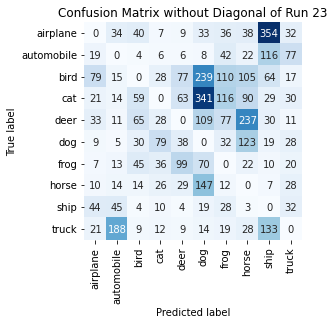

Summing down the rows, for Predictions of each Class that were wrong:  [243. 339. 270. 232. 334. 980. 472. 668. 762. 275.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  99.0 times
Summing across the columns, for total number of that True Class misidentified:  [583. 300. 734. 763. 601. 363. 322. 287. 189. 433.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  237.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24 on Dataset F

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0

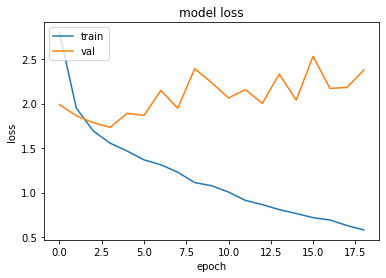

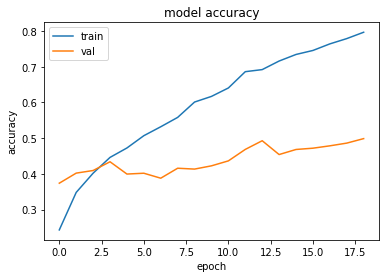

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.732267141342163 , and Val Acc happened to be 0.43380001187324524
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.4986000061035156 and Val Loss happened to be  2.3764185905456543
TestLoss:  1.6892894506454468  TestAcc: 0.43849998712539673
frog 0.862
truck 0.564
horse 0.555
automobile 0.526
ship 0.496
airplane 0.466
dog 0.367
deer 0.224
bird 0.21
cat 0.115


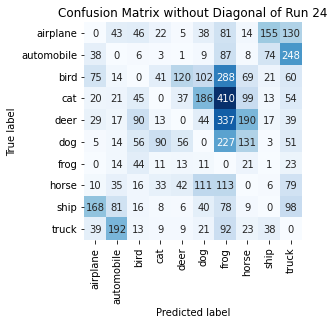

Summing down the rows, for Predictions of each Class that were wrong:  [ 384.  431.  332.  230.  289.  562. 1713.  564.  328.  782.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  120.0 times
Summing across the columns, for total number of that True Class misidentified:  [534. 474. 790. 885. 776. 633. 138. 445. 504. 436.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  337.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25 on Dataset F

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -

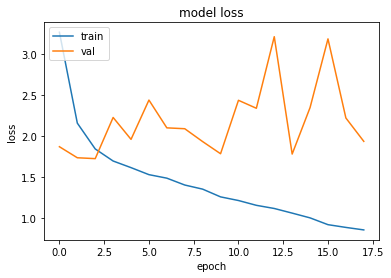

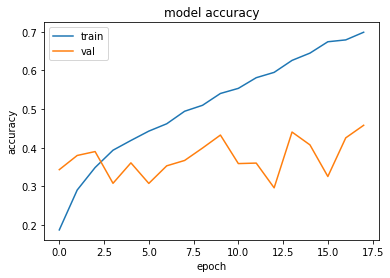

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7214930057525635 , and Val Acc happened to be 0.38989999890327454
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.4578999876976013 and Val Loss happened to be  1.9319978952407837
TestLoss:  1.7025482654571533  TestAcc: 0.38830000162124634
frog 0.88
truck 0.624
horse 0.543
dog 0.437
automobile 0.407
ship 0.336
airplane 0.283
deer 0.227
bird 0.074
cat 0.072


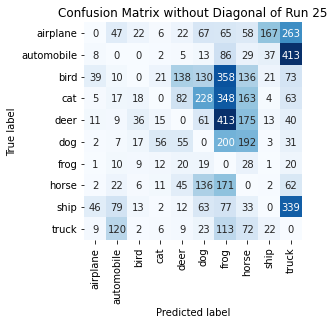

Summing down the rows, for Predictions of each Class that were wrong:  [ 123.  321.  123.  131.  388.  740. 1831.  886.  270. 1304.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  138.0 times
Summing across the columns, for total number of that True Class misidentified:  [717. 593. 926. 928. 773. 563. 120. 457. 664. 376.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  413.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26 on Dataset F

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0

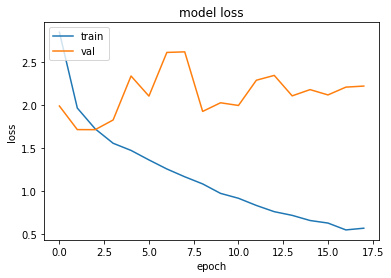

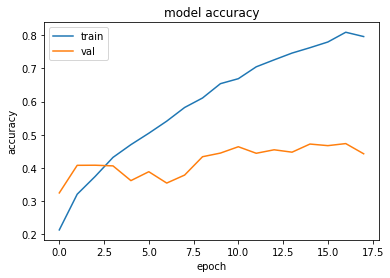

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7148089408874512 , and Val Acc happened to be 0.4083999991416931
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.47360000014305115 and Val Loss happened to be  2.207965850830078
TestLoss:  1.6763572692871094  TestAcc: 0.4154999852180481
horse 0.713
frog 0.701
truck 0.597
ship 0.471
automobile 0.451
deer 0.324
airplane 0.294
dog 0.287
bird 0.185
cat 0.132


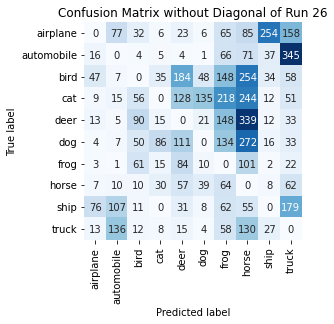

Summing down the rows, for Predictions of each Class that were wrong:  [ 188.  365.  326.  200.  637.  272.  963. 1551.  402.  941.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  184.0 times
Summing across the columns, for total number of that True Class misidentified:  [706. 549. 815. 868. 676. 713. 299. 287. 529. 403.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  339.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27 on Dataset F

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )


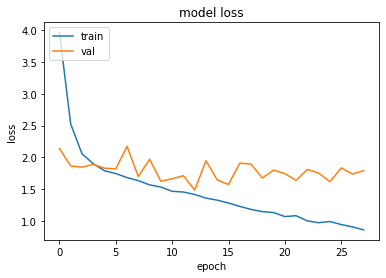

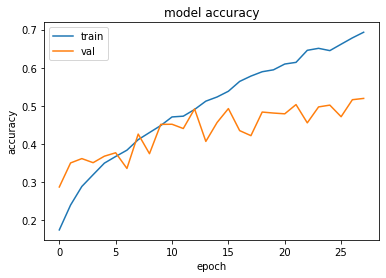

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4878911972045898 , and Val Acc happened to be 0.4918000102043152
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5194000005722046 and Val Loss happened to be  1.7936201095581055
TestLoss:  1.4723303318023682  TestAcc: 0.4846000075340271
frog 0.671
horse 0.63
truck 0.616
ship 0.596
dog 0.58
automobile 0.551
airplane 0.456
deer 0.406
cat 0.26
bird 0.08


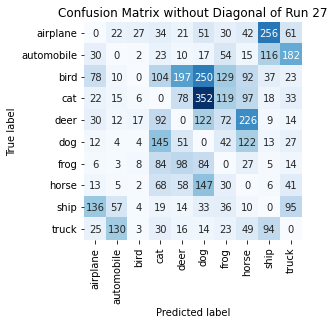

Summing down the rows, for Predictions of each Class that were wrong:  [ 352.  258.   73.  599.  543. 1070.  535.  680.  554.  490.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  197.0 times
Summing across the columns, for total number of that True Class misidentified:  [544. 449. 920. 740. 594. 420. 329. 370. 404. 384.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  226.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28 on Dataset F

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )


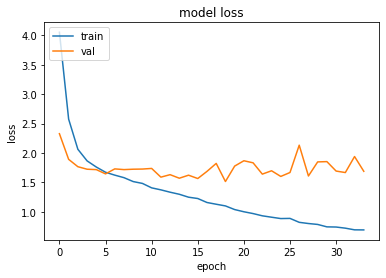

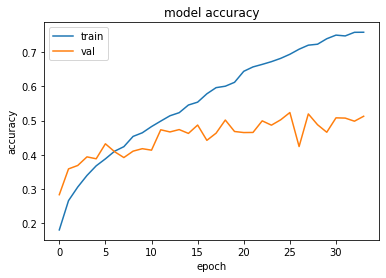

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  18 when  Val Loss was:  1.5141102075576782 , and Val Acc happened to be 0.5016999840736389
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5235999822616577 and Val Loss happened to be  1.6676691770553589
TestLoss:  1.486965298652649  TestAcc: 0.4975999891757965
ship 0.732
frog 0.706
truck 0.616
horse 0.593
automobile 0.538
deer 0.507
dog 0.476
bird 0.313
airplane 0.301
cat 0.194


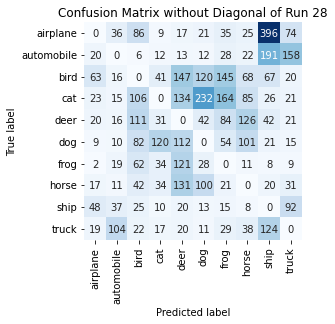

Summing down the rows, for Predictions of each Class that were wrong:  [221. 264. 542. 308. 715. 579. 575. 484. 895. 441.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [699. 462. 687. 806. 493. 524. 294. 407. 268. 384.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  126.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29 on Dataset F

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

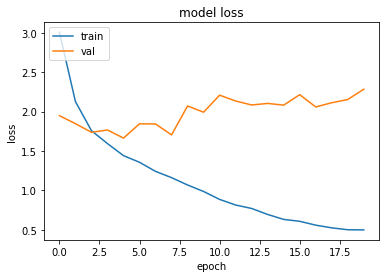

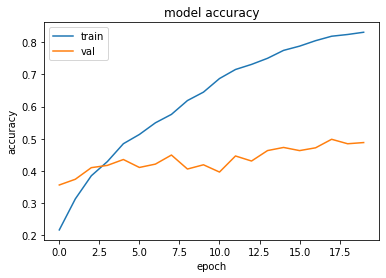

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.6635069847106934 , and Val Acc happened to be 0.43549999594688416
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.4984000027179718 and Val Loss happened to be  2.1115548610687256
TestLoss:  1.64974844455719  TestAcc: 0.4366999864578247
frog 0.67
ship 0.633
horse 0.605
dog 0.59
truck 0.502
automobile 0.422
deer 0.355
airplane 0.316
bird 0.181
cat 0.093


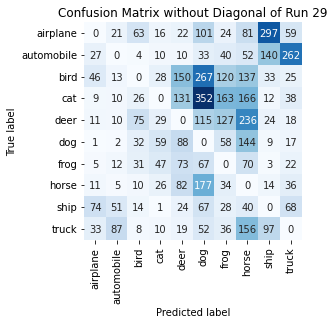

Summing down the rows, for Predictions of each Class that were wrong:  [ 217.  211.  263.  226.  599. 1231.  630. 1082.  629.  545.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  150.0 times
Summing across the columns, for total number of that True Class misidentified:  [684. 578. 819. 907. 645. 410. 330. 395. 367. 498.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  236.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30 on Dataset F

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

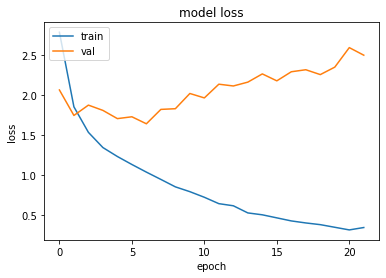

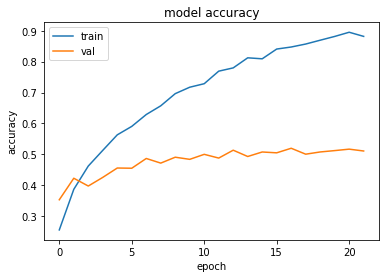

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.6427496671676636 , and Val Acc happened to be 0.48649999499320984
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.519599974155426 and Val Loss happened to be  2.293893337249756
TestLoss:  1.6252174377441406  TestAcc: 0.48899999260902405
frog 0.61
dog 0.603
ship 0.592
truck 0.589
airplane 0.581
horse 0.535
automobile 0.459
deer 0.383
bird 0.275
cat 0.263


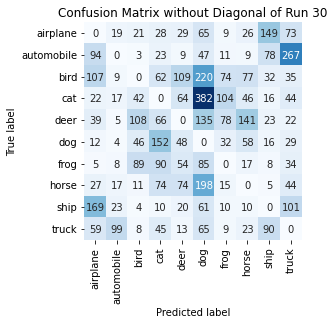

Summing down the rows, for Predictions of each Class that were wrong:  [ 534.  201.  332.  550.  420. 1258.  342.  407.  417.  649.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  109.0 times
Summing across the columns, for total number of that True Class misidentified:  [419. 541. 725. 737. 617. 397. 390. 465. 408. 411.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  141.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31 on Dataset F

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , 

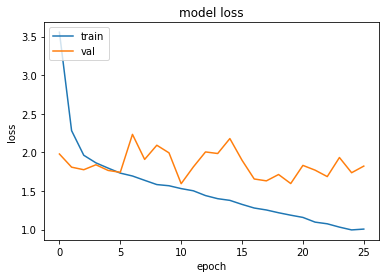

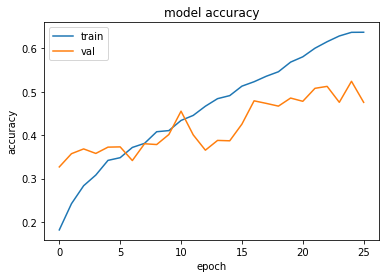

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.5935251712799072 , and Val Acc happened to be 0.4553000032901764
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5242000222206116 and Val Loss happened to be  1.735535740852356
TestLoss:  1.5689107179641724  TestAcc: 0.4580000042915344
frog 0.745
automobile 0.683
horse 0.676
ship 0.653
dog 0.62
truck 0.584
deer 0.221
bird 0.174
airplane 0.121
cat 0.103


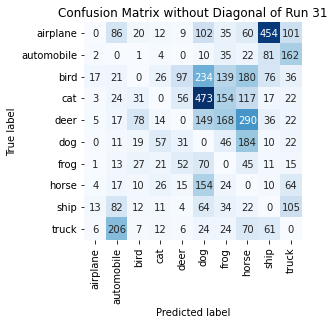

Summing down the rows, for Predictions of each Class that were wrong:  [  51.  477.  205.  183.  270. 1280.  659.  990.  756.  549.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  97.0 times
Summing across the columns, for total number of that True Class misidentified:  [879. 317. 826. 897. 779. 380. 255. 324. 347. 416.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  290.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32 on Dataset F

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Z

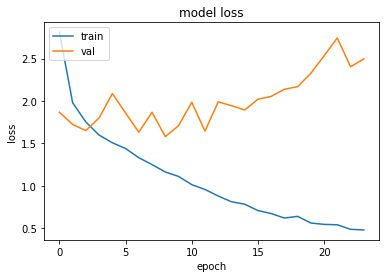

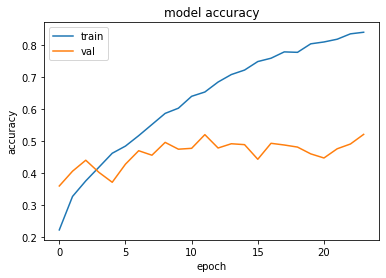

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.5796303749084473 , and Val Acc happened to be 0.49619999527931213
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5212000012397766 and Val Loss happened to be  2.4952476024627686
TestLoss:  1.5538289546966553  TestAcc: 0.49230000376701355
truck 0.698
ship 0.64
horse 0.609
frog 0.578
deer 0.57
dog 0.517
automobile 0.461
airplane 0.422
bird 0.252
cat 0.176


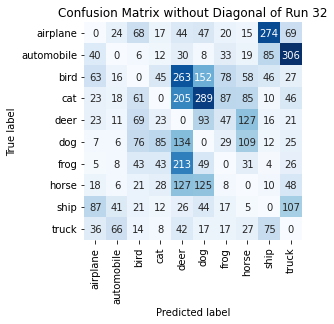

Summing down the rows, for Predictions of each Class that were wrong:  [ 302.  196.  379.  273. 1084.  824.  336.  476.  532.  675.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  263.0 times
Summing across the columns, for total number of that True Class misidentified:  [578. 539. 748. 824. 430. 483. 422. 391. 360. 302.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  127.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33 on Dataset F

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   

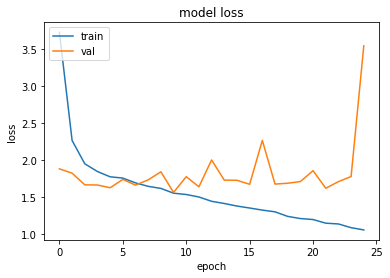

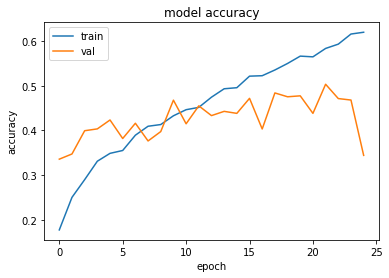

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.5673216581344604 , and Val Acc happened to be 0.4677000045776367
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5033000111579895 and Val Loss happened to be  1.6237123012542725
TestLoss:  1.528995156288147  TestAcc: 0.4702000021934509
ship 0.683
horse 0.644
frog 0.636
dog 0.626
automobile 0.568
truck 0.495
airplane 0.348
deer 0.281
bird 0.24
cat 0.181


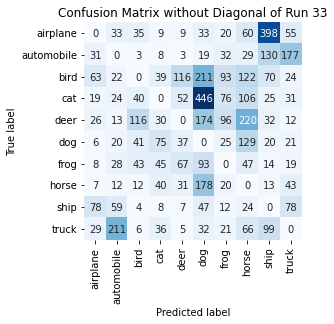

Summing down the rows, for Predictions of each Class that were wrong:  [ 267.  422.  300.  290.  327. 1233.  395.  803.  801.  460.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  116.0 times
Summing across the columns, for total number of that True Class misidentified:  [652. 432. 760. 819. 719. 374. 364. 356. 317. 505.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  220.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34 on Dataset F

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

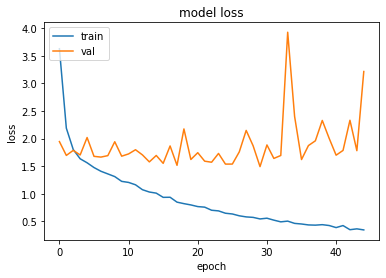

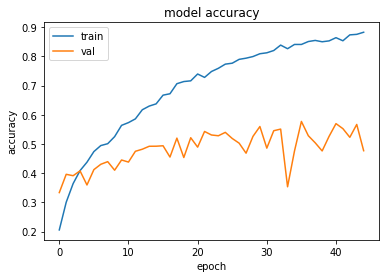

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.4934346675872803 , and Val Acc happened to be 0.5595999956130981
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5770000219345093 and Val Loss happened to be  1.6216214895248413
TestLoss:  1.4657388925552368  TestAcc: 0.5579000115394592
ship 0.744
dog 0.718
horse 0.717
truck 0.681
frog 0.677
automobile 0.676
bird 0.447
airplane 0.435
deer 0.277
cat 0.207


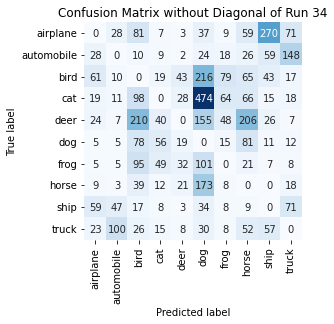

Summing down the rows, for Predictions of each Class that were wrong:  [ 233.  216.  654.  215.  159. 1244.  257.  585.  488.  370.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  43.0 times
Summing across the columns, for total number of that True Class misidentified:  [565. 324. 553. 793. 723. 282. 323. 283. 256. 319.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  210.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35 on Dataset F

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

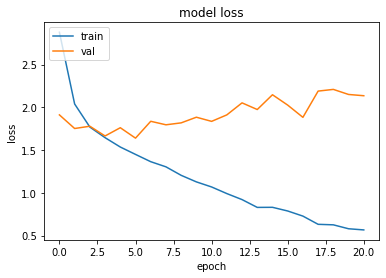

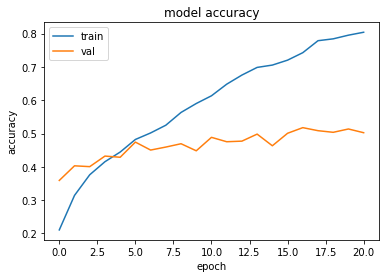

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.6398048400878906 , and Val Acc happened to be 0.47429999709129333
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5177000164985657 and Val Loss happened to be  1.8833712339401245
TestLoss:  1.5995410680770874  TestAcc: 0.46959999203681946
frog 0.797
truck 0.68
ship 0.574
horse 0.572
dog 0.565
airplane 0.437
automobile 0.398
deer 0.32
bird 0.251
cat 0.102


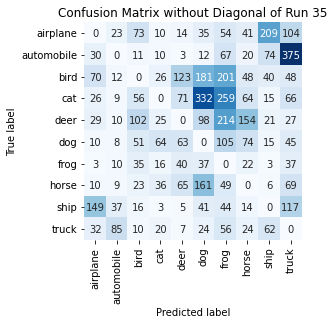

Summing down the rows, for Predictions of each Class that were wrong:  [ 359.  203.  377.  210.  391.  921. 1049.  461.  445.  888.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  123.0 times
Summing across the columns, for total number of that True Class misidentified:  [563. 602. 749. 898. 680. 435. 203. 428. 426. 320.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  214.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36 on Dataset F

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

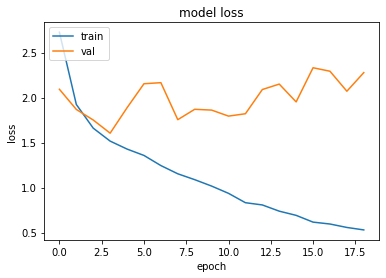

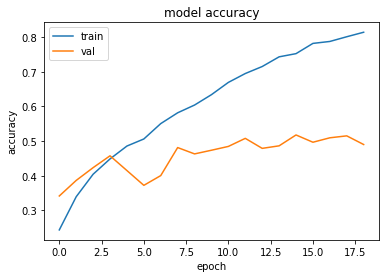

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6044303178787231 , and Val Acc happened to be 0.45739999413490295
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.5175999999046326 and Val Loss happened to be  1.951920747756958
TestLoss:  1.5782570838928223  TestAcc: 0.451200008392334
frog 0.65
truck 0.629
horse 0.601
automobile 0.597
ship 0.54
dog 0.481
deer 0.341
airplane 0.249
bird 0.243
cat 0.181


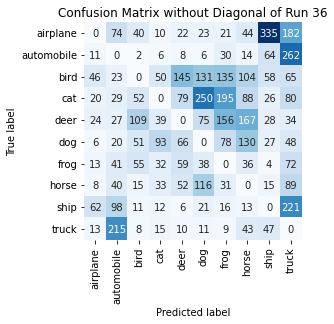

Summing down the rows, for Predictions of each Class that were wrong:  [ 203.  567.  343.  290.  447.  671.  671.  639.  604. 1053.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  145.0 times
Summing across the columns, for total number of that True Class misidentified:  [751. 403. 757. 819. 659. 519. 350. 399. 460. 371.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  167.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37 on Dataset F

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -

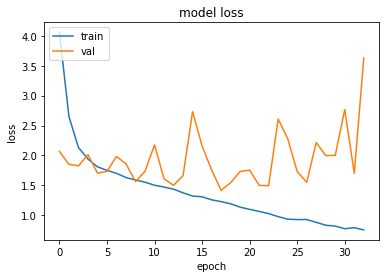

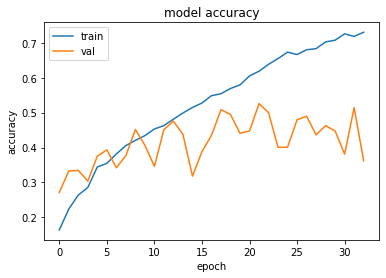

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.4144662618637085 , and Val Acc happened to be 0.508400022983551
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5256999731063843 and Val Loss happened to be  1.4974480867385864
TestLoss:  1.3746670484542847  TestAcc: 0.5130000114440918
dog 0.697
frog 0.697
automobile 0.655
ship 0.638
truck 0.577
horse 0.516
airplane 0.468
deer 0.423
cat 0.256
bird 0.203


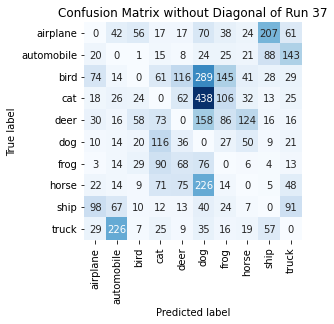

Summing down the rows, for Predictions of each Class that were wrong:  [ 304.  433.  214.  480.  404. 1356.  481.  324.  427.  447.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  116.0 times
Summing across the columns, for total number of that True Class misidentified:  [532. 345. 797. 744. 577. 303. 303. 484. 362. 423.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  158.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38 on Dataset F

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoom

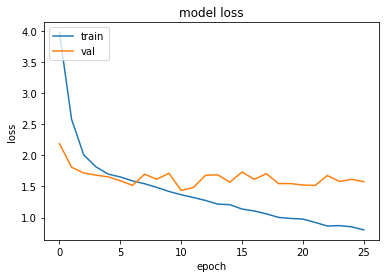

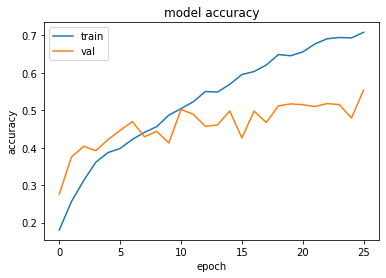

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.4358112812042236 , and Val Acc happened to be 0.5022000074386597
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5540000200271606 and Val Loss happened to be  1.5767104625701904
TestLoss:  1.404319167137146  TestAcc: 0.5048999786376953
horse 0.716
truck 0.708
automobile 0.691
frog 0.679
dog 0.618
ship 0.592
airplane 0.368
deer 0.331
bird 0.246
cat 0.1


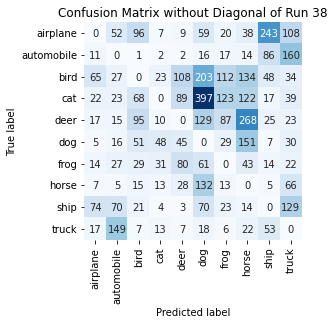

Summing down the rows, for Predictions of each Class that were wrong:  [ 232.  384.  383.  151.  371. 1085.  430.  806.  498.  611.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  108.0 times
Summing across the columns, for total number of that True Class misidentified:  [632. 309. 754. 900. 669. 382. 321. 284. 408. 292.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  268.0 times

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 

   Begin Run:  39 on Dataset F

 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

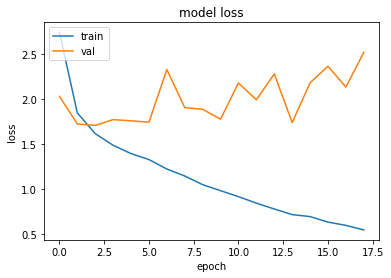

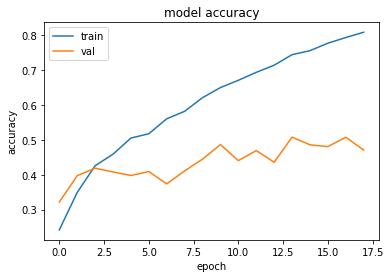

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7066853046417236 , and Val Acc happened to be 0.4185999929904938
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.5073999762535095 and Val Loss happened to be  1.7377525568008423
TestLoss:  1.6642755270004272  TestAcc: 0.42170000076293945
frog 0.791
dog 0.602
ship 0.508
truck 0.497
automobile 0.485
horse 0.482
airplane 0.303
deer 0.287
bird 0.144
cat 0.118


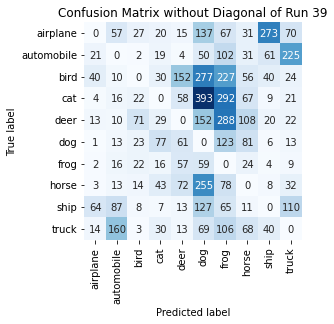

Summing down the rows, for Predictions of each Class that were wrong:  [ 162.  382.  192.  271.  445. 1519. 1348.  477.  461.  526.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  152.0 times
Summing across the columns, for total number of that True Class misidentified:  [697. 515. 856. 882. 713. 398. 209. 518. 492. 503.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  288.0 times

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 

   Begin Run:  40 on Dataset F

 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40 40  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

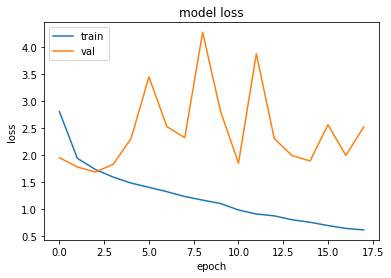

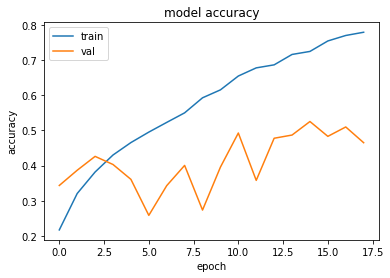

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.684890866279602 , and Val Acc happened to be 0.4260999858379364
Additionally, the best val acc epoch happened to be  14 when val acc was:  0.5253000259399414 and Val Loss happened to be  1.8909591436386108
TestLoss:  1.6390671730041504  TestAcc: 0.4287000000476837
frog 0.826
dog 0.587
ship 0.543
truck 0.54
horse 0.486
airplane 0.43
automobile 0.31
deer 0.261
bird 0.155
cat 0.149


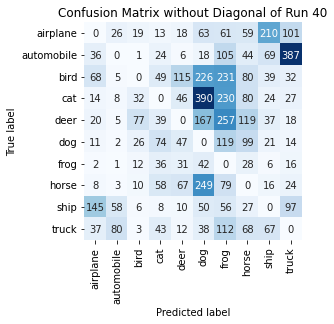

Summing down the rows, for Predictions of each Class that were wrong:  [ 341.  188.  186.  344.  352. 1243. 1250.  604.  489.  716.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  115.0 times
Summing across the columns, for total number of that True Class misidentified:  [570. 690. 845. 851. 739. 413. 174. 514. 457. 460.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  257.0 times

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 

   Begin Run:  41 on Dataset F

 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41 41  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Z

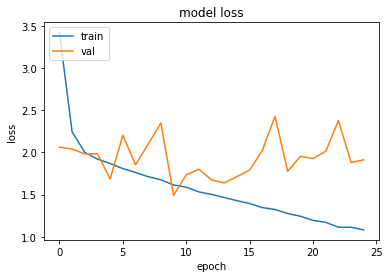

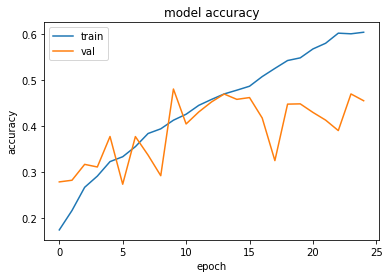

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.4914735555648804 , and Val Acc happened to be 0.48069998621940613
Additionally, the best val acc epoch happened to be  9 when val acc was:  0.48069998621940613 and Val Loss happened to be  1.4914735555648804
TestLoss:  1.4615057706832886  TestAcc: 0.48179998993873596
frog 0.749
truck 0.662
dog 0.641
ship 0.595
horse 0.562
automobile 0.524
airplane 0.37
deer 0.338
bird 0.278
cat 0.099


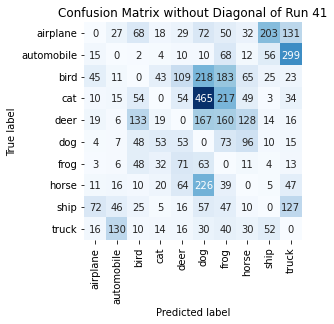

Summing down the rows, for Predictions of each Class that were wrong:  [ 195.  264.  398.  208.  422. 1308.  877.  433.  372.  705.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  109.0 times
Summing across the columns, for total number of that True Class misidentified:  [630. 476. 722. 901. 662. 359. 251. 438. 405. 338.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  167.0 times

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 

   Begin Run:  42 on Dataset F

 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42 42  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0

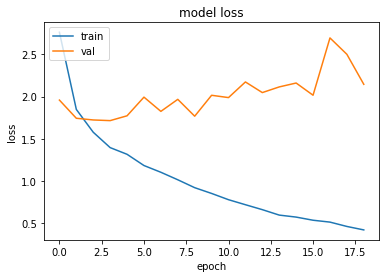

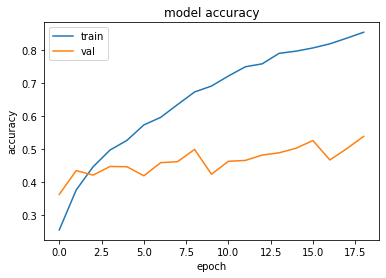

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.7150601148605347 , and Val Acc happened to be 0.446399986743927
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5378000140190125 and Val Loss happened to be  2.1451399326324463
TestLoss:  1.6929357051849365  TestAcc: 0.45089998841285706
frog 0.817
truck 0.727
ship 0.543
automobile 0.505
dog 0.501
horse 0.476
deer 0.427
airplane 0.237
cat 0.146
bird 0.13


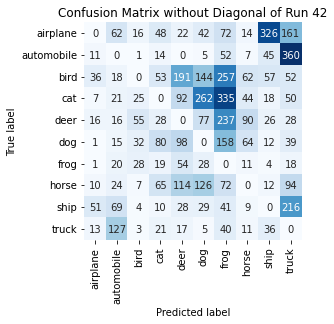

Summing down the rows, for Predictions of each Class that were wrong:  [ 146.  372.  171.  338.  616.  718. 1264.  312.  536. 1018.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  191.0 times
Summing across the columns, for total number of that True Class misidentified:  [763. 495. 870. 854. 573. 499. 183. 524. 457. 273.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  237.0 times

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 

   Begin Run:  43 on Dataset F

 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0

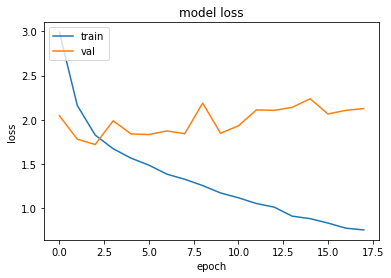

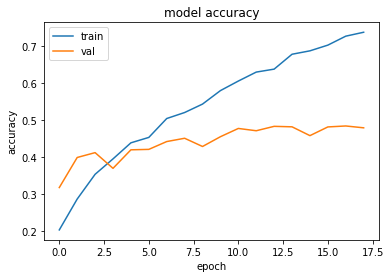

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.7205861806869507 , and Val Acc happened to be 0.41269999742507935
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.4846999943256378 and Val Loss happened to be  2.106931209564209
TestLoss:  1.6894668340682983  TestAcc: 0.42010000348091125
frog 0.738
truck 0.645
dog 0.556
horse 0.547
ship 0.432
automobile 0.391
airplane 0.317
cat 0.219
deer 0.217
bird 0.139


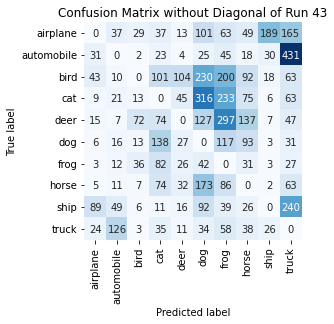

Summing down the rows, for Predictions of each Class that were wrong:  [ 225.  289.  181.  575.  278. 1140. 1138.  559.  284. 1130.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [683. 609. 861. 781. 783. 444. 262. 453. 568. 355.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  297.0 times

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 

   Begin Run:  44 on Dataset F

 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.16 , -0.16 )
Z

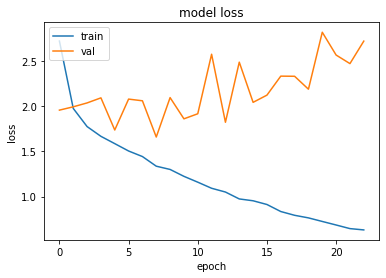

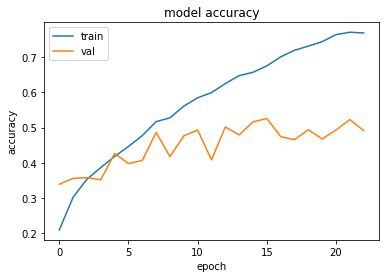

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.6601715087890625 , and Val Acc happened to be 0.4864000082015991
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5257999897003174 and Val Loss happened to be  2.1248133182525635
TestLoss:  1.6383111476898193  TestAcc: 0.4846000075340271
frog 0.727
truck 0.71
dog 0.605
horse 0.599
ship 0.488
airplane 0.448
automobile 0.425
deer 0.319
bird 0.292
cat 0.233


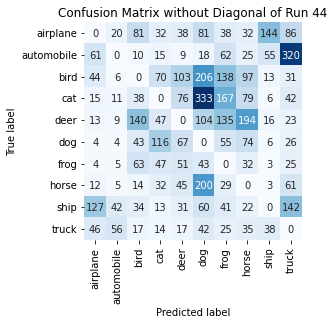

Summing down the rows, for Predictions of each Class that were wrong:  [ 326.  158.  440.  386.  437. 1087.  690.  590.  284.  756.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  103.0 times
Summing across the columns, for total number of that True Class misidentified:  [552. 575. 708. 767. 681. 395. 273. 401. 512. 290.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  194.0 times

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 

   Begin Run:  45 on Dataset F

 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   

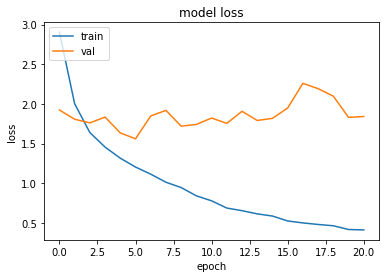

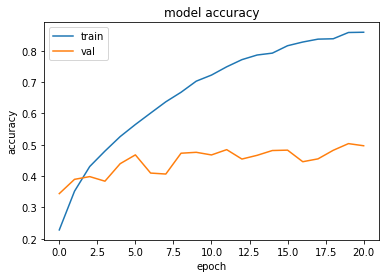

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.5605634450912476 , and Val Acc happened to be 0.4677000045776367
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.503600001335144 and Val Loss happened to be  1.8306177854537964
TestLoss:  1.531205654144287  TestAcc: 0.4699000120162964
truck 0.625
horse 0.603
frog 0.539
automobile 0.529
airplane 0.509
ship 0.47
deer 0.396
dog 0.385
cat 0.374
bird 0.269


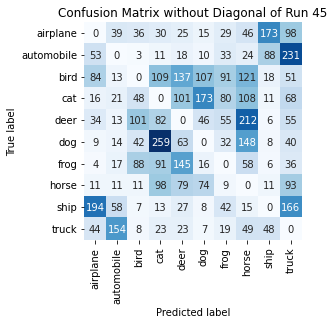

Summing down the rows, for Predictions of each Class that were wrong:  [449. 340. 344. 716. 618. 456. 390. 781. 369. 838.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  145.0 times
Summing across the columns, for total number of that True Class misidentified:  [491. 471. 731. 626. 604. 615. 461. 397. 530. 375.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  212.0 times

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 

   Begin Run:  46 on Dataset F

 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   

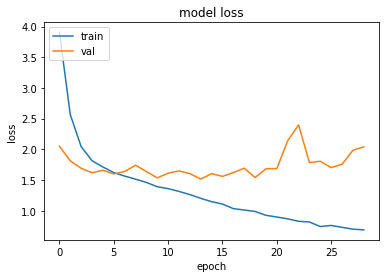

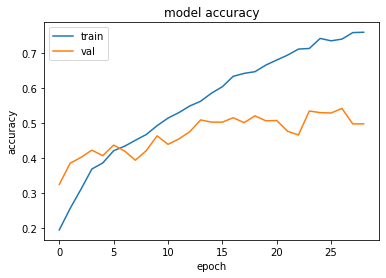

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.5160161256790161 , and Val Acc happened to be 0.508400022983551
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.541100025177002 and Val Loss happened to be  1.7573925256729126
TestLoss:  1.482971429824829  TestAcc: 0.5105999708175659
frog 0.796
horse 0.697
truck 0.697
ship 0.597
dog 0.505
airplane 0.47
automobile 0.437
deer 0.373
cat 0.322
bird 0.212


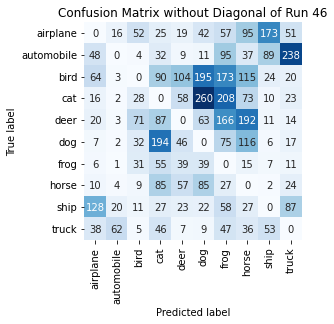

Summing down the rows, for Predictions of each Class that were wrong:  [337. 113. 243. 641. 362. 726. 906. 706. 375. 485.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [530. 563. 788. 678. 627. 495. 204. 303. 403. 303.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  192.0 times

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 

   Begin Run:  47 on Dataset F

 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47 47  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 

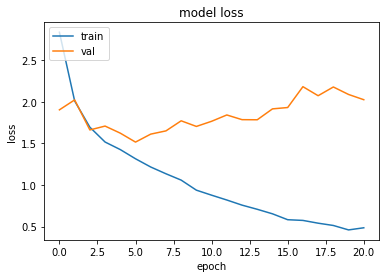

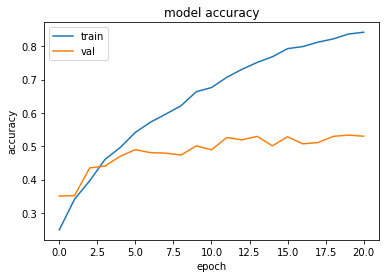

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.515411376953125 , and Val Acc happened to be 0.48969998955726624
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5333999991416931 and Val Loss happened to be  2.0881998538970947
TestLoss:  1.5034550428390503  TestAcc: 0.48510000109672546
truck 0.719
dog 0.678
ship 0.647
horse 0.62
frog 0.606
automobile 0.588
airplane 0.32
deer 0.289
bird 0.246
cat 0.138


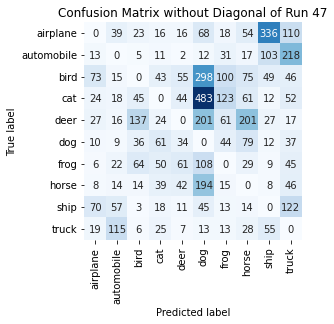

Summing down the rows, for Predictions of each Class that were wrong:  [ 250.  305.  333.  287.  272. 1422.  418.  558.  611.  693.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  61.0 times
Summing across the columns, for total number of that True Class misidentified:  [680. 412. 754. 862. 711. 322. 394. 380. 353. 281.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  201.0 times

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 

   Begin Run:  48 on Dataset F

 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48 48  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomI

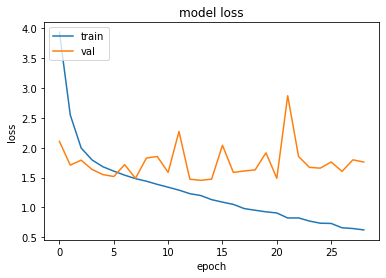

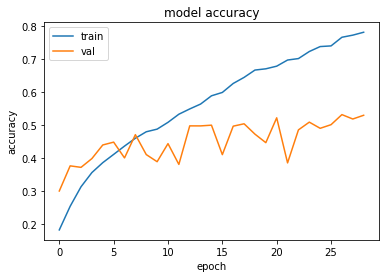

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.453122615814209 , and Val Acc happened to be 0.49779999256134033
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5320000052452087 and Val Loss happened to be  1.6026027202606201
TestLoss:  1.4301246404647827  TestAcc: 0.498199999332428
frog 0.772
horse 0.75
ship 0.728
automobile 0.66
dog 0.592
truck 0.543
airplane 0.378
bird 0.242
deer 0.197
cat 0.12


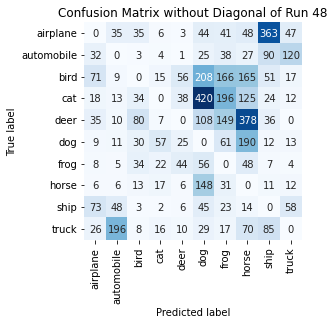

Summing down the rows, for Predictions of each Class that were wrong:  [ 278.  333.  240.  146.  189. 1083.  722. 1065.  679.  283.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  56.0 times
Summing across the columns, for total number of that True Class misidentified:  [622. 340. 758. 880. 803. 408. 228. 250. 272. 457.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  378.0 times

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 

   Begin Run:  49 on Dataset F

 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49 49  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zoo

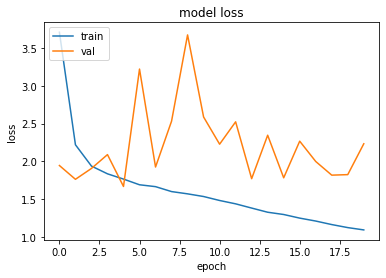

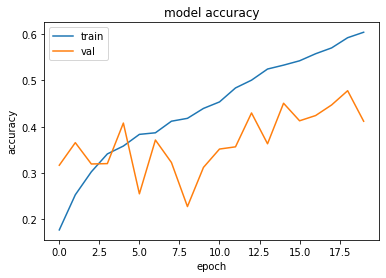

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.668228268623352 , and Val Acc happened to be 0.40779998898506165
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.47760000824928284 and Val Loss happened to be  1.8248099088668823
TestLoss:  1.6245754957199097  TestAcc: 0.40849998593330383
frog 0.807
truck 0.771
ship 0.553
horse 0.508
dog 0.483
deer 0.372
automobile 0.303
airplane 0.135
bird 0.101
cat 0.052


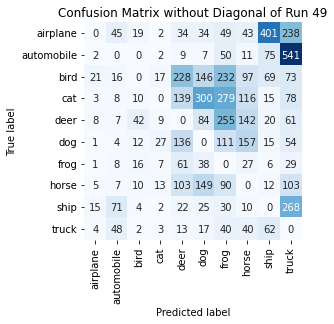

Summing down the rows, for Predictions of each Class that were wrong:  [  60.  214.  115.   82.  745.  800. 1136.  643.  675. 1445.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  228.0 times
Summing across the columns, for total number of that True Class misidentified:  [865. 697. 899. 948. 628. 517. 193. 492. 447. 229.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  255.0 times

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 

   Begin Run:  50 on Dataset F

 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50 50  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )

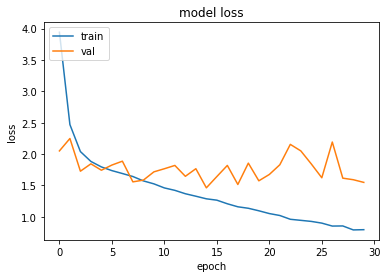

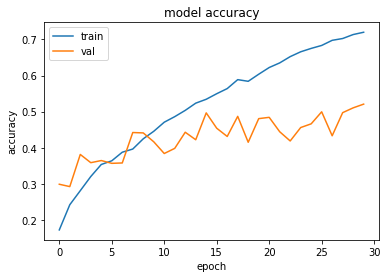

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.4624407291412354 , and Val Acc happened to be 0.49639999866485596
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5206999778747559 and Val Loss happened to be  1.5490179061889648
TestLoss:  1.4271955490112305  TestAcc: 0.5044000148773193
frog 0.728
horse 0.658
ship 0.621
automobile 0.609
dog 0.599
truck 0.555
deer 0.411
airplane 0.394
cat 0.257
bird 0.212


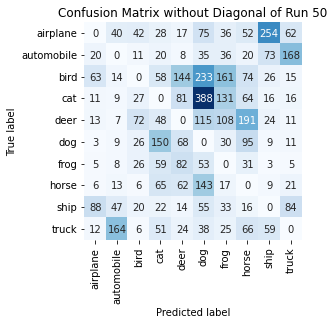

Summing down the rows, for Predictions of each Class that were wrong:  [ 221.  311.  236.  501.  500. 1135.  577.  609.  473.  393.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  144.0 times
Summing across the columns, for total number of that True Class misidentified:  [606. 391. 788. 743. 589. 401. 272. 342. 379. 445.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  191.0 times


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Final Download attempted :  Thu, 18 November 2021 23:13:50  (subtract ~5-hours for local Hour), and file is called  runs_GroupF_final.pkl


In [81]:
run_through_runs(ds=trainF, ds_noalb=trainF_noalb, dstitle = "F", showpictures=False)

filename will be:  runs_GroupG .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset G

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5


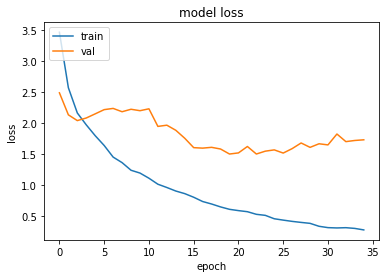

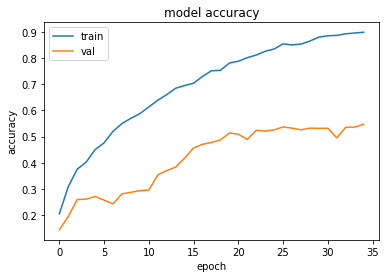

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  19 when  Val Loss was:  1.5009751319885254 , and Val Acc happened to be 0.5131999850273132
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5465999841690063 and Val Loss happened to be  1.7302416563034058
TestLoss:  1.4667662382125854  TestAcc: 0.5126000046730042
ship 0.78
frog 0.664
deer 0.602
automobile 0.539
airplane 0.519
truck 0.476
horse 0.442
dog 0.427
bird 0.349
cat 0.328


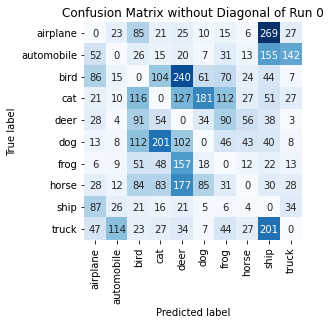

Summing down the rows, for Predictions of each Class that were wrong:  [368. 221. 609. 569. 903. 408. 445. 212. 850. 289.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  240.0 times
Summing across the columns, for total number of that True Class misidentified:  [481. 461. 651. 672. 398. 573. 336. 558. 220. 524.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  91.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1 on Dataset G

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:

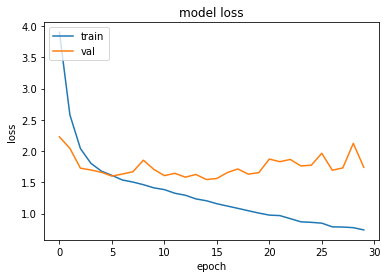

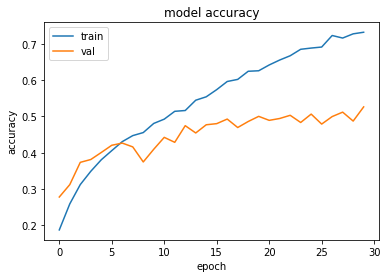

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  14 when  Val Loss was:  1.5457478761672974 , and Val Acc happened to be 0.4771000146865845
Additionally, the best val acc epoch happened to be  29 when val acc was:  0.5264000296592712 and Val Loss happened to be  1.7418453693389893
TestLoss:  1.5203129053115845  TestAcc: 0.4790000021457672
frog 0.773
dog 0.689
horse 0.573
truck 0.57
ship 0.551
automobile 0.54
airplane 0.428
deer 0.305
bird 0.228
cat 0.133


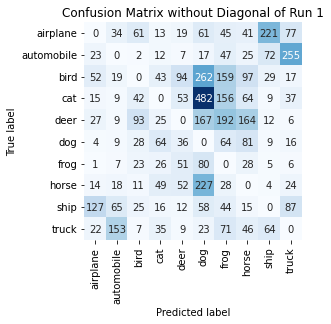

Summing down the rows, for Predictions of each Class that were wrong:  [ 285.  323.  292.  283.  333. 1377.  806.  561.  425.  525.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  94.0 times
Summing across the columns, for total number of that True Class misidentified:  [572. 460. 772. 867. 695. 311. 227. 427. 449. 430.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  192.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2 on Dataset G

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.2

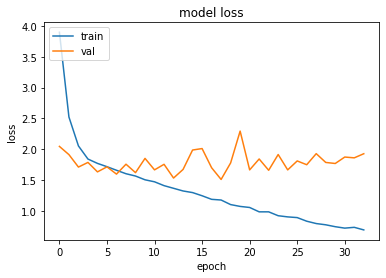

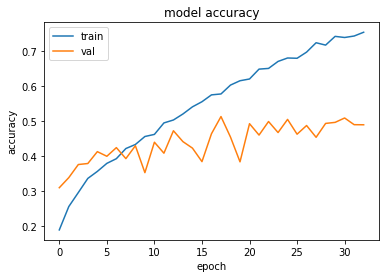

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.5104691982269287 , and Val Acc happened to be 0.5123999714851379
Additionally, the best val acc epoch happened to be  17 when val acc was:  0.5123999714851379 and Val Loss happened to be  1.5104691982269287
TestLoss:  1.4884144067764282  TestAcc: 0.5098000168800354
truck 0.714
horse 0.701
ship 0.691
frog 0.668
dog 0.598
automobile 0.523
airplane 0.441
deer 0.363
cat 0.207
bird 0.192


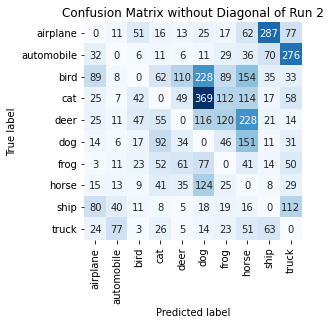

Summing down the rows, for Predictions of each Class that were wrong:  [307. 184. 209. 363. 318. 982. 480. 853. 526. 680.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  110.0 times
Summing across the columns, for total number of that True Class misidentified:  [559. 477. 808. 793. 637. 402. 332. 299. 309. 286.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  228.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3 on Dataset G

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Contrast: ( 0.2

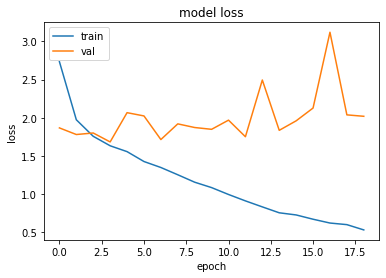

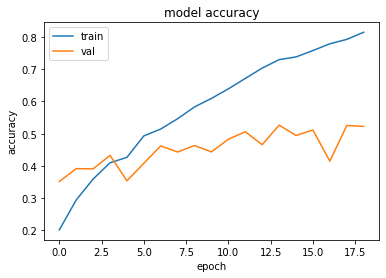

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6816250085830688 , and Val Acc happened to be 0.4327999949455261
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.5266000032424927 and Val Loss happened to be  1.833852767944336
TestLoss:  1.6622302532196045  TestAcc: 0.4323999881744385
frog 0.806
horse 0.676
automobile 0.674
truck 0.528
ship 0.49
dog 0.478
airplane 0.361
deer 0.152
cat 0.12
bird 0.039


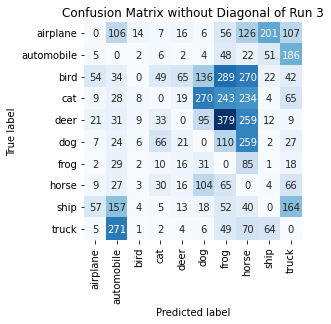

Summing down the rows, for Predictions of each Class that were wrong:  [ 169.  707.   49.  208.  172.  670. 1291. 1365.  361.  684.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  65.0 times
Summing across the columns, for total number of that True Class misidentified:  [639. 326. 961. 880. 848. 522. 194. 324. 510. 472.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  379.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4 on Dataset G

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 

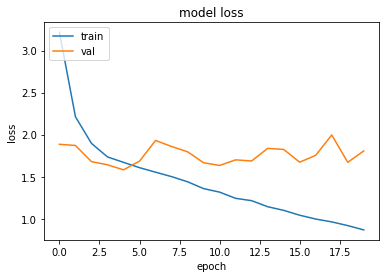

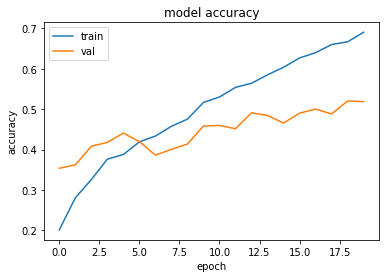

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  4 when  Val Loss was:  1.5812170505523682 , and Val Acc happened to be 0.4406999945640564
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5202000141143799 and Val Loss happened to be  1.6706167459487915
TestLoss:  1.565490484237671  TestAcc: 0.4447999894618988
frog 0.825
ship 0.577
dog 0.57
horse 0.556
truck 0.529
automobile 0.505
airplane 0.446
deer 0.243
cat 0.126
bird 0.071


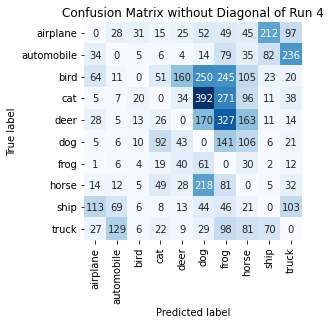

Summing down the rows, for Predictions of each Class that were wrong:  [ 291.  273.  100.  288.  356. 1230. 1337.  682.  422.  573.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  160.0 times
Summing across the columns, for total number of that True Class misidentified:  [554. 495. 929. 874. 757. 430. 175. 444. 423. 471.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  327.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5 on Dataset G

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 

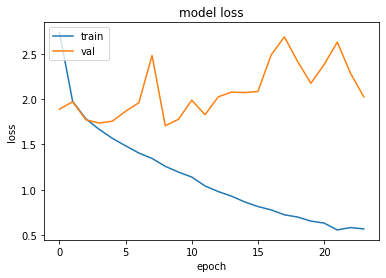

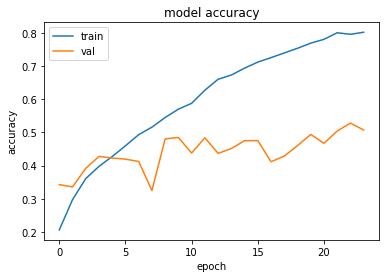

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.706147313117981 , and Val Acc happened to be 0.4805999994277954
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5282999873161316 and Val Loss happened to be  2.2844691276550293
TestLoss:  1.7022420167922974  TestAcc: 0.4742000102996826
frog 0.78
ship 0.69
truck 0.651
dog 0.618
horse 0.594
automobile 0.455
airplane 0.281
cat 0.263
deer 0.23
bird 0.18


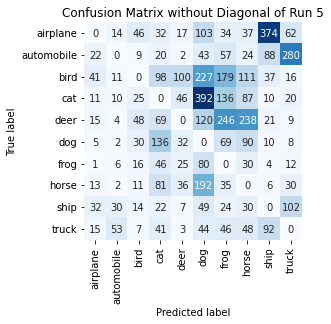

Summing down the rows, for Predictions of each Class that were wrong:  [ 155.  132.  206.  545.  268. 1250.  826.  695.  642.  539.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  100.0 times
Summing across the columns, for total number of that True Class misidentified:  [719. 545. 820. 737. 770. 382. 220. 406. 310. 349.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  246.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6 on Dataset G

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Contra

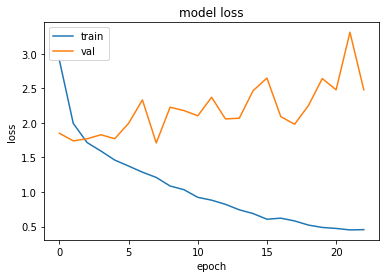

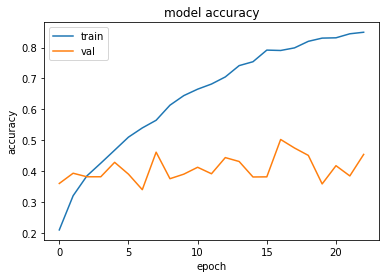

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  7 when  Val Loss was:  1.7103972434997559 , and Val Acc happened to be 0.46129998564720154
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5023999810218811 and Val Loss happened to be  2.0921006202697754
TestLoss:  1.6808960437774658  TestAcc: 0.46779999136924744
truck 0.734
horse 0.687
frog 0.627
dog 0.582
ship 0.545
automobile 0.47
cat 0.334
airplane 0.301
deer 0.288
bird 0.11


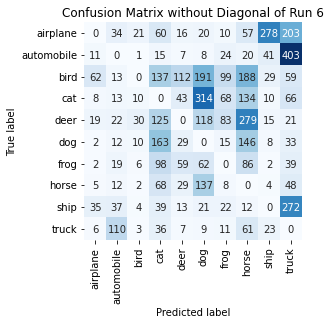

Summing down the rows, for Predictions of each Class that were wrong:  [ 150.  272.   87.  741.  315.  880.  340.  983.  410. 1144.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [699. 530. 890. 666. 712. 418. 373. 313. 455. 266.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  279.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7 on Dataset G

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Con

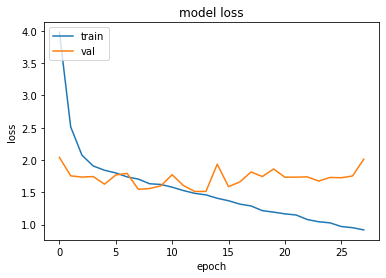

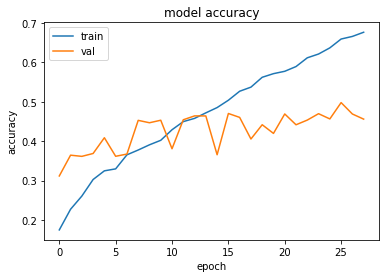

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.5127991437911987 , and Val Acc happened to be 0.4641000032424927
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.49779999256134033 and Val Loss happened to be  1.7254252433776855
TestLoss:  1.4876179695129395  TestAcc: 0.4650999903678894
dog 0.776
truck 0.717
ship 0.683
horse 0.594
frog 0.584
automobile 0.494
airplane 0.379
deer 0.189
bird 0.142
cat 0.093


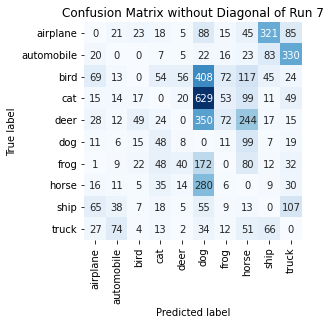

Summing down the rows, for Predictions of each Class that were wrong:  [ 252.  198.  142.  265.  155. 2038.  266.  771.  571.  691.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  56.0 times
Summing across the columns, for total number of that True Class misidentified:  [621. 506. 858. 907. 811. 224. 416. 406. 317. 283.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  350.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8 on Dataset G

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 

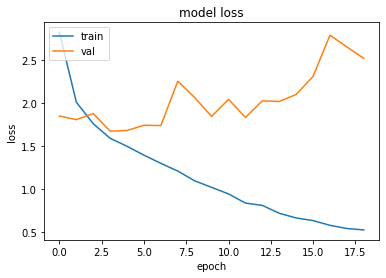

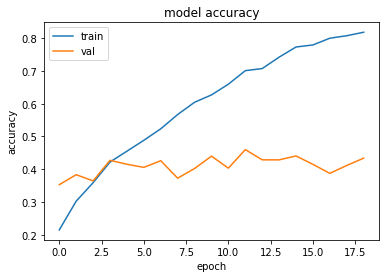

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.6699074506759644 , and Val Acc happened to be 0.42730000615119934
Additionally, the best val acc epoch happened to be  11 when val acc was:  0.46000000834465027 and Val Loss happened to be  1.829359769821167
TestLoss:  1.6501253843307495  TestAcc: 0.41850000619888306
frog 0.763
ship 0.674
truck 0.62
horse 0.564
dog 0.442
automobile 0.339
airplane 0.338
deer 0.18
bird 0.156
cat 0.109


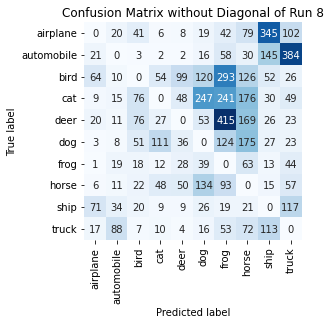

Summing down the rows, for Predictions of each Class that were wrong:  [ 212.  216.  314.  279.  284.  670. 1338.  911.  766.  825.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  99.0 times
Summing across the columns, for total number of that True Class misidentified:  [662. 661. 844. 891. 820. 558. 237. 436. 326. 380.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  415.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9 on Dataset G

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:    ( 0.05 , 

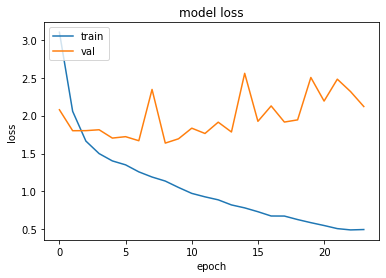

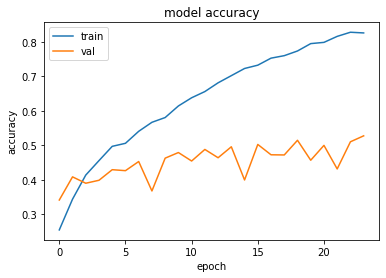

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  8 when  Val Loss was:  1.637509822845459 , and Val Acc happened to be 0.4629000127315521
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5277000069618225 and Val Loss happened to be  2.1198413372039795
TestLoss:  1.6302850246429443  TestAcc: 0.4650000035762787
frog 0.806
dog 0.627
truck 0.573
ship 0.531
horse 0.498
automobile 0.482
airplane 0.367
cat 0.335
deer 0.298
bird 0.133


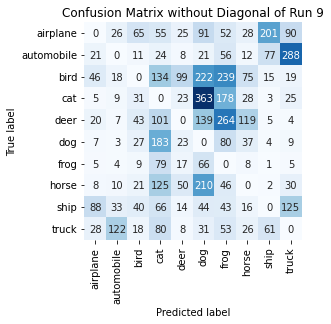

Summing down the rows, for Predictions of each Class that were wrong:  [ 228.  232.  265.  847.  267. 1187. 1011.  349.  369.  595.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  99.0 times
Summing across the columns, for total number of that True Class misidentified:  [633. 518. 867. 665. 702. 373. 194. 502. 469. 427.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  264.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10 on Dataset G

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 

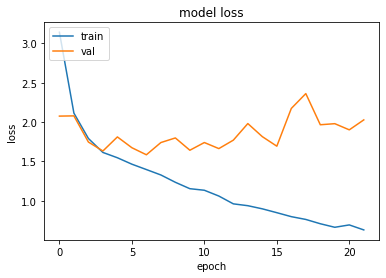

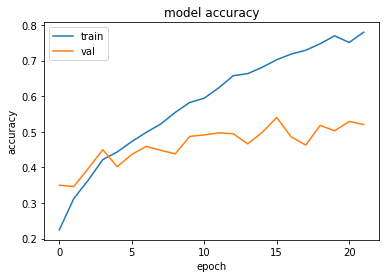

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.5851285457611084 , and Val Acc happened to be 0.45890000462532043
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5400999784469604 and Val Loss happened to be  1.6940850019454956
TestLoss:  1.5650248527526855  TestAcc: 0.4587000012397766
frog 0.777
horse 0.699
truck 0.619
dog 0.585
automobile 0.516
ship 0.447
airplane 0.441
cat 0.219
bird 0.151
deer 0.133


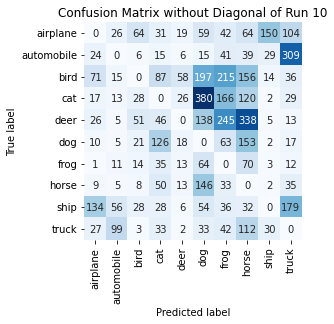

Summing down the rows, for Predictions of each Class that were wrong:  [ 319.  235.  223.  451.  161. 1086.  883. 1084.  237.  734.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  58.0 times
Summing across the columns, for total number of that True Class misidentified:  [559. 484. 849. 781. 867. 415. 223. 301. 553. 381.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  338.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11 on Dataset G

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:  

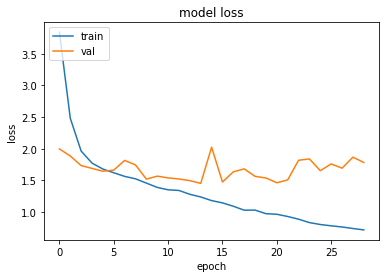

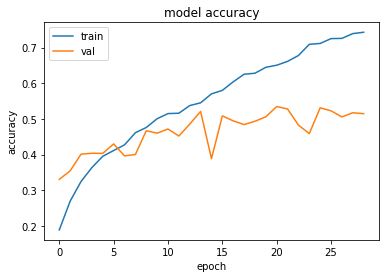

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.45378839969635 , and Val Acc happened to be 0.5210000276565552
Additionally, the best val acc epoch happened to be  20 when val acc was:  0.5347999930381775 and Val Loss happened to be  1.4637292623519897
TestLoss:  1.4190269708633423  TestAcc: 0.5202000141143799
frog 0.767
truck 0.746
horse 0.633
ship 0.626
dog 0.563
airplane 0.492
automobile 0.478
deer 0.399
bird 0.264
cat 0.234


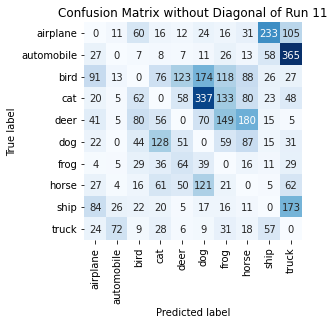

Summing down the rows, for Predictions of each Class that were wrong:  [340. 141. 329. 429. 376. 802. 569. 524. 443. 845.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  123.0 times
Summing across the columns, for total number of that True Class misidentified:  [508. 522. 736. 766. 601. 437. 233. 367. 374. 254.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  180.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12 on Dataset G

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   

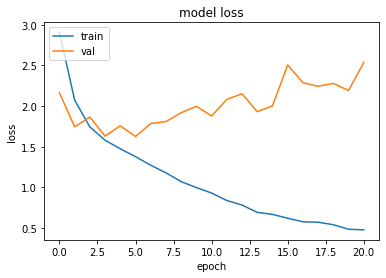

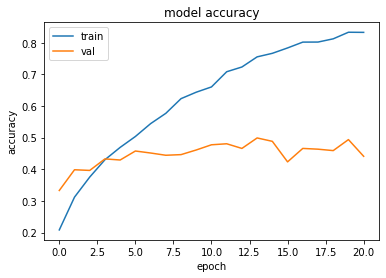

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  5 when  Val Loss was:  1.625609040260315 , and Val Acc happened to be 0.4577000141143799
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.49900001287460327 and Val Loss happened to be  1.9307941198349
TestLoss:  1.6245169639587402  TestAcc: 0.454800009727478
frog 0.86
ship 0.76
automobile 0.566
dog 0.493
horse 0.451
truck 0.433
airplane 0.43
bird 0.234
deer 0.175
cat 0.146


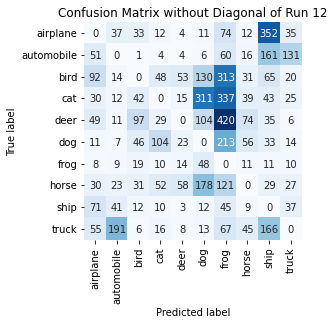

Summing down the rows, for Predictions of each Class that were wrong:  [ 397.  345.  287.  285.  182.  813. 1650.  293.  895.  305.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  58.0 times
Summing across the columns, for total number of that True Class misidentified:  [570. 434. 766. 854. 825. 507. 140. 549. 240. 567.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  420.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13 on Dataset G

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 , -0.08 )
Zo

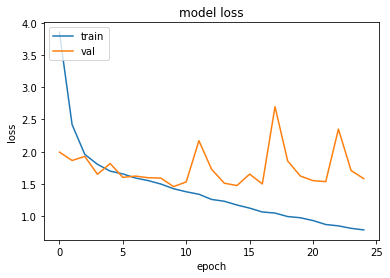

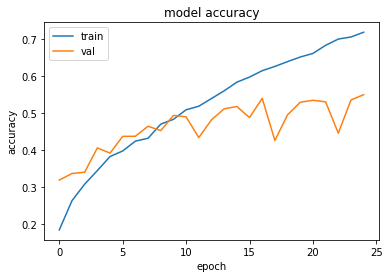

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.457578182220459 , and Val Acc happened to be 0.49480000138282776
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5508999824523926 and Val Loss happened to be  1.5814560651779175
TestLoss:  1.4361791610717773  TestAcc: 0.49079999327659607
ship 0.75
frog 0.746
truck 0.685
horse 0.624
dog 0.591
automobile 0.564
deer 0.351
airplane 0.212
cat 0.203
bird 0.182


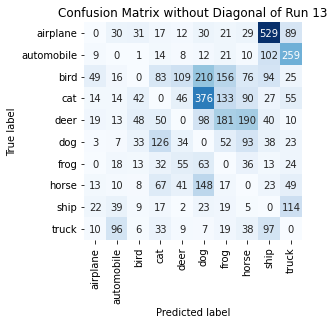

Summing down the rows, for Predictions of each Class that were wrong:  [139. 243. 191. 439. 316. 967. 619. 567. 963. 648.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  109.0 times
Summing across the columns, for total number of that True Class misidentified:  [788. 436. 818. 797. 649. 409. 254. 376. 250. 315.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  190.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14 on Dataset G

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

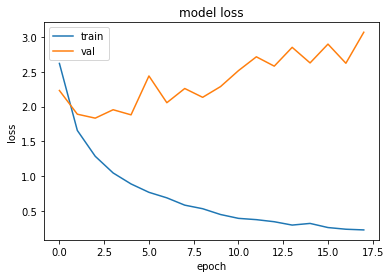

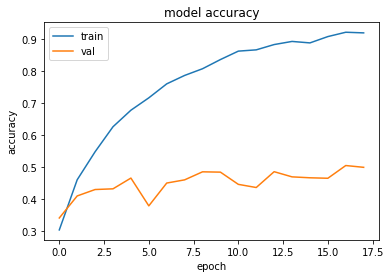

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  2 when  Val Loss was:  1.8336390256881714 , and Val Acc happened to be 0.4296000003814697
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.504800021648407 and Val Loss happened to be  2.6217081546783447
TestLoss:  1.8089431524276733  TestAcc: 0.4325000047683716
horse 0.733
frog 0.709
ship 0.544
truck 0.519
dog 0.506
airplane 0.334
automobile 0.307
cat 0.271
deer 0.253
bird 0.149


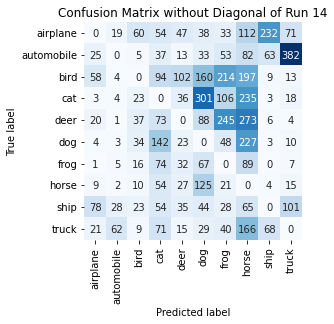

Summing down the rows, for Predictions of each Class that were wrong:  [ 219.  128.  217.  653.  330.  885.  788. 1446.  388.  621.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  102.0 times
Summing across the columns, for total number of that True Class misidentified:  [666. 693. 851. 729. 747. 494. 291. 267. 456. 481.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  273.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15 on Dataset G

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.1

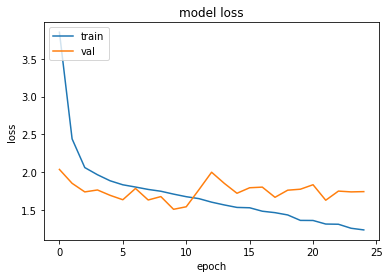

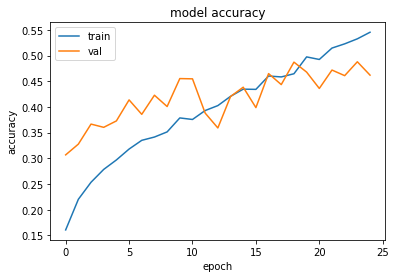

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.5103905200958252 , and Val Acc happened to be 0.4551999866962433
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.4878999888896942 and Val Loss happened to be  1.740572452545166
TestLoss:  1.4948967695236206  TestAcc: 0.4553999900817871
frog 0.801
ship 0.707
dog 0.619
truck 0.579
automobile 0.567
horse 0.551
bird 0.272
airplane 0.269
deer 0.135
cat 0.054


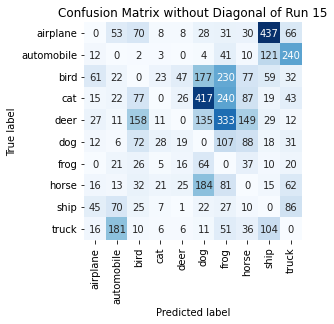

Summing down the rows, for Predictions of each Class that were wrong:  [ 204.  399.  472.  112.  148. 1042. 1141.  524.  812.  592.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  47.0 times
Summing across the columns, for total number of that True Class misidentified:  [731. 433. 728. 946. 865. 381. 199. 449. 293. 421.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  333.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16 on Dataset G

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

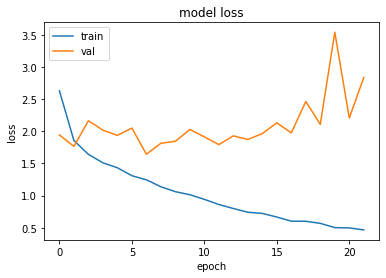

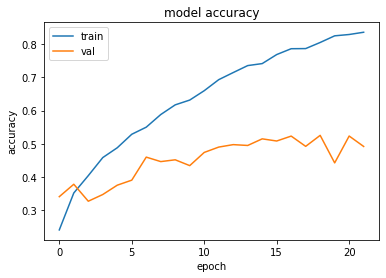

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.6438043117523193 , and Val Acc happened to be 0.45980000495910645
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.5253000259399414 and Val Loss happened to be  2.1093852519989014
TestLoss:  1.626042127609253  TestAcc: 0.4625999927520752
truck 0.751
dog 0.702
ship 0.624
frog 0.539
horse 0.482
automobile 0.446
airplane 0.345
deer 0.337
cat 0.251
bird 0.149


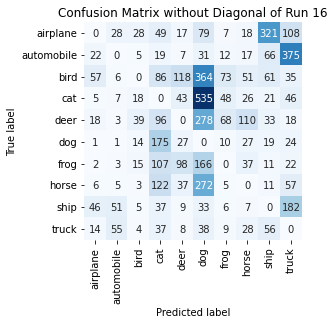

Summing down the rows, for Predictions of each Class that were wrong:  [ 171.  159.  131.  728.  364. 1796.  238.  321.  599.  867.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  118.0 times
Summing across the columns, for total number of that True Class misidentified:  [655. 554. 851. 749. 663. 298. 461. 518. 376. 249.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  278.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17 on Dataset G

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0

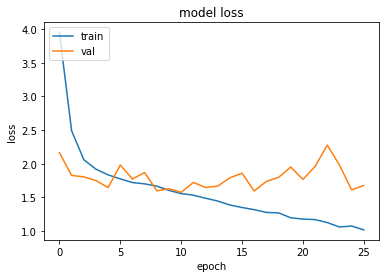

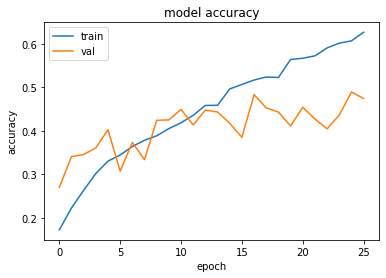

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.5753307342529297 , and Val Acc happened to be 0.4494999945163727
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.4896000027656555 and Val Loss happened to be  1.6109634637832642
TestLoss:  1.5518691539764404  TestAcc: 0.4465000033378601
dog 0.702
frog 0.688
ship 0.632
truck 0.615
horse 0.602
automobile 0.518
airplane 0.327
cat 0.187
deer 0.131
bird 0.063


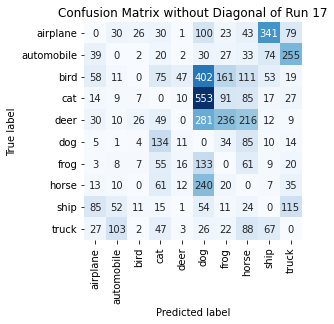

Summing down the rows, for Predictions of each Class that were wrong:  [ 274.  234.   85.  486.  103. 1819.  625.  746.  590.  573.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  47.0 times
Summing across the columns, for total number of that True Class misidentified:  [673. 482. 937. 813. 869. 298. 312. 398. 368. 385.]
For example, the model misclassified true 4's (deer) as label   5 dog  a total of  281.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18 on Dataset G

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   (

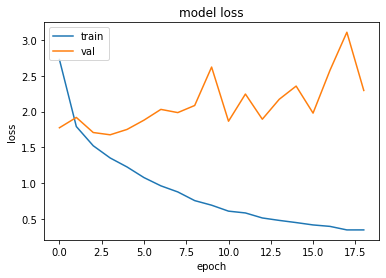

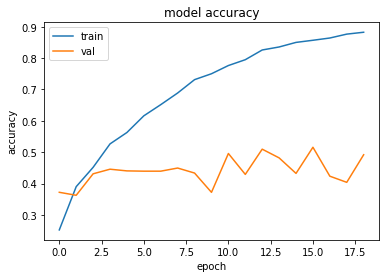

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  3 when  Val Loss was:  1.675455093383789 , and Val Acc happened to be 0.4456999897956848
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5156999826431274 and Val Loss happened to be  1.9791761636734009
TestLoss:  1.6697150468826294  TestAcc: 0.447299987077713
frog 0.782
ship 0.658
automobile 0.657
truck 0.619
horse 0.577
dog 0.515
airplane 0.226
cat 0.205
deer 0.168
bird 0.066


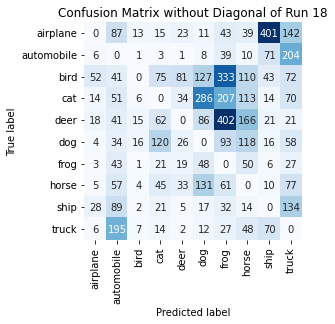

Summing down the rows, for Predictions of each Class that were wrong:  [ 136.  638.   65.  376.  224.  726. 1237.  668.  652.  805.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  81.0 times
Summing across the columns, for total number of that True Class misidentified:  [774. 343. 934. 795. 832. 485. 218. 423. 342. 381.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  402.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19 on Dataset G

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
Zo

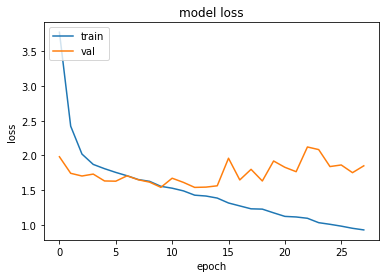

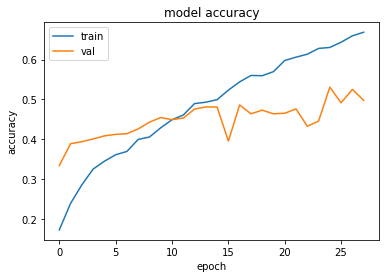

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.5377261638641357 , and Val Acc happened to be 0.4754999876022339
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5306000113487244 and Val Loss happened to be  1.8385357856750488
TestLoss:  1.4960113763809204  TestAcc: 0.48159998655319214
truck 0.795
ship 0.704
horse 0.65
frog 0.575
dog 0.484
deer 0.421
automobile 0.37
cat 0.299
bird 0.28
airplane 0.238


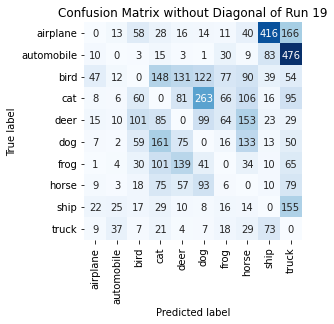

Summing down the rows, for Predictions of each Class that were wrong:  [ 128.  112.  353.  663.  516.  648.  304.  608.  683. 1169.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  139.0 times
Summing across the columns, for total number of that True Class misidentified:  [762. 630. 720. 701. 579. 516. 425. 350. 296. 205.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  153.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20 on Dataset G

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

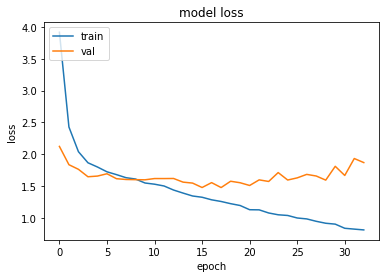

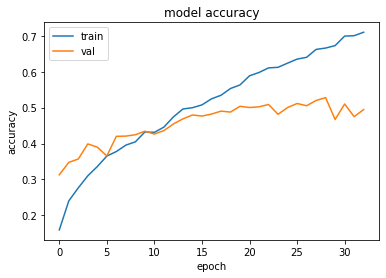

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  17 when  Val Loss was:  1.4760472774505615 , and Val Acc happened to be 0.490200012922287
Additionally, the best val acc epoch happened to be  28 when val acc was:  0.5277000069618225 and Val Loss happened to be  1.5928263664245605
TestLoss:  1.4435452222824097  TestAcc: 0.4966000020503998
horse 0.718
truck 0.7
ship 0.657
frog 0.633
dog 0.564
automobile 0.556
airplane 0.409
bird 0.34
deer 0.286
cat 0.103


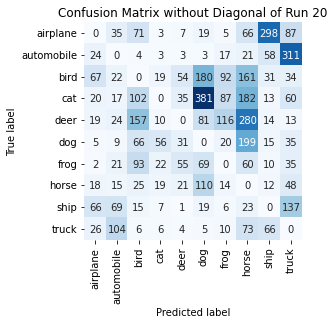

Summing down the rows, for Predictions of each Class that were wrong:  [ 247.  316.  539.  145.  211.  867.  367. 1065.  517.  760.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  55.0 times
Summing across the columns, for total number of that True Class misidentified:  [591. 444. 660. 897. 714. 436. 367. 282. 343. 300.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  280.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21 on Dataset G

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0

In [ ]:
run_through_runs(ds=trainG, ds_noalb=trainG_noalb, dstitle = "G", showpictures=False)

In [ ]:
# need to continue from run 21 on for G
# run_through_runs(ds=trainG, ds_noalb=trainG_noalb, dstitle = "G", showpictures=False)

In [1]:
run_through_runs(ds=trainH, ds_noalb=trainH_noalb, dstitle = "H", showpictures=False)

NameError: ignored

## 4.2:  Groups of two: AB, CD, EF, GH, 

Merged Groups of 2 
1. Group1_A_B
2. Group2_C_D
3. Group3_E_F
4. Group4_G_H

then later.. 

Merged Groups of 4
1. Group1_a_b_c_d
2. Group2_e_f_g_h

and finally

1. Group_all



In [ ]:
# trainA_noalb + trainB_noalb
# combine datasets I believe I need to add trainA_noalb, and trainB_noalb or just trainA+trainB and then send through no_augmentations...

# pretty_display_of_dataset(trainAB, "AB", opttext="trainAB pictures") # works


# ~~~~~~~~~~ No Augment Versions: ~~~~~~~~~~~~~~~~~~~~~~
trainAB_noalb = make_noalb(trainAB, "AB")           # just testing AB now

 
# Uncomment when ready to run
trainCD_noalb = make_noalb(trainCD, "CD")
trainEF_noalb = make_noalb(trainEF, "EF")
trainGH_noalb = make_noalb(trainGH, "GH")

# # ---  Larger Groups of Four Single Groups ---
 

# # ~~~~~~~~~~ No Augment Versions: ~~~~~~~~~~~~~~~~~~~~~~
trainABCD_noalb = make_noalb(trainABCD, "ABCD")
trainEFGH_noalb = make_noalb(trainEFGH, "EFGH")

# # --- Largest Groups of Eight single Groups ---
trainALL = trainABCD.concatenate(trainEFGH, "ABCDEFGH")
trainALL_noalb = make_noalb(trainALL, "ABCDEFGH")
# groupnum=2
# new_trainX_batch = 10*groupnum  # to ensure you get all 10 categories  
# tot_new_trainX =   5000*groupnum # should be 250*10*2 = 5000  #for FIRST groups but not COMBINED GROUP RUNS = 10000
    

# pretty_display_of_dataset(trainAB_noalb, "AB_noalb") #works
# trainAB_alb = augment_data(dataset = trainAB, process= process_data, dataset_text = "Augmented Dataset", )
# new_trainAB = zip_2_sets(tuple_of_2_subsets_to_zip=(trainAB_noalb, trainAB_alb), opttext="NoAlb+Alb")
# new_trainAB_batched_shuffle = minibatch_shuffle_unbatch_cache_prefetch_bigbatch(new_trainAB, batch=new_trainX_batch, groupnum=2, SEED = 42)
# print(new_trainAB_batched_shuffle)  #prints 500.. batches of 10?
# count_images(new_trainAB_batched_shuffle)
# run_through_runs(ds=trainAB, ds_noalb=trainAB_noalb, dstitle = "TrainAB", groupnum = 2, showpictures=True, troubleshooting=True) #stops at batch2
# view_40_images(new_trainAB_batched_shuffle)
# view_40_images(make_unbatched(new_trainAB_batched_shuffle))  ##WORKS
# pretty_display_of_dataset(ds = make_unbatched(new_trainAB_batched_shuffle), dstitle="trainAB", opttext= str(("newTrainX batched and shuffled using groupnum=") + str(groupnum)), troubleshooting=True) 



In [ ]:
# hasattr(trainAB, '_input_dataset')

# hasattr(trainA, '_input_dataset._input_dataset') 

AB, CD

In [ ]:
trainX_list = (trainAB, trainCD)
trainXnoalb_list  = (trainAB_noalb, trainCD_noalb)
trainXtitle_list = ("AB", "CD")
showpictures_list= (False, False)

for trainX, trainX_noalb, trainXtitle, pictures in zip(trainX_list, trainXnoalb_list, trainXtitle_list, showpictures_list):
  run_through_runs(ds=trainX, ds_noalb=trainX_noalb, dstitle = trainXtitle, groupnum=2, showpictures=pictures, troubleshooting=False)

EF, GH

In [ ]:
trainX_list = (trainEF, trainGH)
trainXnoalb_list  = (trainEF_noalb, trainGH_noalb)
trainXtitle_list = ("EF", "GH")
showpictures_list= (False, False)

for trainX, trainX_noalb, trainXtitle, pictures in zip(trainX_list, trainXnoalb_list, trainXtitle_list, showpictures_list):
  run_through_runs(ds=trainX, ds_noalb=trainX_noalb, dstitle = trainXtitle,  groupnum=2, showpictures=pictures, troubleshooting=False)

ABCD, EFGH

In [ ]:
trainX_list = (trainABCD, trainEFGH)
trainXnoalb_list  = (trainABCD_noalb, trainEFGH_noalb)
trainXtitle_list = ("ABCD", "EFGH")
showpictures_list= (False, False)

for trainX, trainX_noalb, trainXtitle, pictures in zip(trainX_list, trainXnoalb_list, trainXtitle_list, showpictures_list):
  run_through_runs(ds=trainX, ds_noalb=trainX_noalb, dstitle = trainXtitle,  groupnum=4, showpictures=pictures, troubleshooting=False)

trainABCDEFGH

In [ ]:
run_through_runs(ds=trainABCDEFGH, ds_noalb=trainABCDEFGH_noalb, dstitle = "trainABCDEFGH",  groupnum=8, showpictures=False, troubleshooting=False)

So far in my effort to concatenate groupA and groupB and run it through the model, it's taken at least 20 minutes to just count the number of images in each class, display the images, and another 5 minutes to run Run0 through the CNN.   At ~25 minutes per run it would take about ~1275 minutes per Group.  There are 7 more groups, that's 8925 minutes, or 148 hours.  Obviously I cant display images for each run or that would take forever.  At 33 minutes I'm not even done running Run 1.

Looking for a faster way to count the dataset, SO, user says \\
`ds.map(lambda x: 1, num_parallel_calls=tf.data.experimental.AUTOTUNE).reduce(tf.constant(0), lambda x,_: x+1) `

In [ ]:
# ds.map(lambda x: 1, num_parallel_calls=AUTOTUNE).reduce(tf.constant(0), lambda x: 1)

## Time Required: 10 hours



In [ ]:
stop_testing = time.time()
print((stop_testing - tic) , "secs to  run everything start to end, or... ")
print((stop_testing - tic)/60, "minutes ... or ")
print((stop_testing - tic)/3600, "hours ")



---



# 5. Post-Test: Process Results

After the 51 runs for the single groups have been run, its time to load the results into JMP to Fit the Definitive Screening Design and find which Main Effects have the most compeling effect.   

* I need to get my pickle files unloaded into a dataframe to put in a CSV.

* I had unintentionally created an effect that was captured by my blocking variable (early October?), but have since fixed it.  Original results here -- "[GroupA_Test1](https://github.com/RachelRamirez/CIFAR-10/blob/main/CollectionofTests/Test1GroupA.ipynb)" 



---



as of 11/11/21 its  ** ~9 hours** to run   9 Groups with 51 Runs, at about 45 epochs each.  If I ran it again with GroupA (10th GRoup) it would probably be about 10.5 hours total to this point.  Also note that is just training and capturing results, not diplaying any images thru augmentations, as displaying images and counting the number in each batch is extremely time consuming.  I think it makes one experimental run take at least 20 minutes, so  20times longer overall.



---



In [ ]:
# import pickle
# import numpy as np
# import csv
# # what does a flattened confuion matrix look like 


# #define a list of the pickle files
# list_of_pickle_file_names = ['runs_GroupB_final.pkl', 
#                              'runs_GroupC_final.pkl', 
#                              'runs_GroupD_final.pkl', 
#                              'runs_GroupE_final.pkl', 
#                              'runs_GroupF_final.pkl', 
#                              'runs_GroupG_final.pkl', 
#                              'runs_GroupH_final.pkl',] 
#                             #  'runs_GroupI_final.pkl', 
#                             #  'runs_GroupJ_final.pkl']

# list_of_group_names = ("B", "C", "D", "E", "F", "G", "H")    #, "I", "J")

 
 
# ds = {}

# #for enumerate () zip the 9 pickle files:
# for Z, pkl, in zip(list_of_group_names, list_of_pickle_file_names): #list_of_unpickled_names):
  
#   with open(pkl, 'rb') as fid:
#      print("dataset", Z, " loaded from", pkl)
#      ds[Z] = pickle.load(fid)
 

# #To reference a Group say ds["Letter"][RunInt]["Metric"]
# # The problem was i didnt have a I or J file with runs, nor some runs with 0
# # ds["B"][23]["CM_norm"]
# # ds["C"][23]["CM_norm"]

# ds['B'][0]["CM"]  # the first array of ds["B"][1]["CM"] is [551,  29,  37,  23,  45,  23,  37,  18, 199,  38],
# ds['B'][1]["CM"]  # the first array of ds["B"][1]["CM"] is [602,  54,  54,  19,  18,  17,  23,  19, 148,  46],

# #can i just replace it Group , and each run, with this function? It'd be ice if i could map it.. versus a for loop of doomr
# rows = []
# for i in (list_of_group_names):
#   for run in range(1,51):             #<!!---------------- ------ change back to 0 once you have and/or end with 51
#     cm = (ds[i][run]["CM"]).flatten(order="C")
#     cm = cm.flatten()
#     cm_norm = (ds[i][run]["CM_norm"]).flatten(order="C")
#     cm_norm = cm_norm.flatten()
#     # print("new", cm_flat_new)
#     row = [i, run,  ds[i][run]["TestAccuracy"],  ds[i][run]["TestLoss"], cm, cm_norm]
#     rows.append(row)


# df_Groups = pd.DataFrame(rows, columns=["Group", "Run", "TestAccuracy", "TestLoss", "CM", "CM_norm"])

# df = df_Groups

# CM_arr = np.array(df.loc[:,"CM"].to_list()) # this takes all rows in column "CM"
# CM_df = pd.DataFrame(CM_arr) #350 rows 100 columns
# CM_df = CM_df.reset_index(drop=True)
# new_df = pd.concat([df_Groups, CM_df ], axis=1)

# CM_norm_arr = np.array(df.loc[:,"CM_norm"].to_list()) # this takes all rows in column "CM"
# CM_norm_df = pd.DataFrame(CM_norm_arr) #350 rows 100 columns
# CM_norm_df = CM_norm_df.reset_index(drop=True)

# # Place the DataFrames side by side
# # horizontal_stack = pd.concat([survey_sub, survey_sub_last10], axis=1)

# new_df = pd.concat([new_df, CM_norm_df ], axis=1)
# new_df.to_csv('test.csv')




 
 